# Library

In [1]:
import os
import obspy
import mycode as mc
from obspy import read, read_inventory
from obspy import UTCDateTime as utc
from obspy.core.trace import Trace, Stats, _get_function_from_entry_point
from obspy.core.stream import Stream
from obspy.core.util import AttribDict

from obspy.signal import PPSD, filter
from obspy.signal.trigger import classic_sta_lta_py, recursive_sta_lta_py, coincidence_trigger, trigger_onset
from obspy.signal.util import util_geo_km, next_pow_2
from obspy.signal.array_analysis import *
from obspy.imaging.spectrogram import _nearest_pow_2
from obspy.imaging.cm import obspy_sequential

from obspy.core.utcdatetime import UTCDateTime

import time
import datetime as dt
from datetime import datetime, timezone

import matplotlib.pyplot as plt
from matplotlib import mlab
import matplotlib.cm as cm
from matplotlib.pyplot import figure, show, rc

from matplotlib.colorbar import ColorbarBase
from matplotlib.colors import Normalize
import matplotlib.dates as mdates
from matplotlib.dates import num2date, datestr2num, date2num

import numpy as np
from numpy.linalg import svd
import math
import pandas as pd 

import ctypes as C
import warnings



# **Southwest Event**

In [2]:
data_sw = pd.read_excel(r'data_event.xlsx', 
                     sheet_name="SW", converters={'TIme':int},
                     convert_float=False, dtype='str')
data_sw

,Time,Duration,Direction
0,2021-01-19T17:59:00.000000Z,210.0,SW
1,2021-01-19T22:12:30.000000Z,200.0,SW
2,2021-01-19T22:34:50.000000Z,135.0,SW
3,2021-01-07T01:02:26.350000Z,154.0,SW
4,2021-01-26T13:16:58.000000Z,141.0,SW
5,2021-01-26T16:29:12.000000Z,158.0,SW


In [3]:
time_sw = data_sw['Time'].tolist()
duration_sw = data_sw['Duration'].tolist()
direction_sw = data_sw['Direction'].tolist()

In [4]:
# TIME FOR EVENT 019
time0 = utc(time_sw[0])
time1 = utc(time_sw[1])
time2 = utc(time_sw[2])

# DURATION
time00 = int(float(duration_sw[0]))
time01 = int(float(duration_sw[1]))
time02 = int(float(duration_sw[2]))

## 1 | (2021-01-19 | 17:59:00) | SW

In [5]:
chID = 'ENZ'
direction = 'SW'
path = 'data/'+direction

st=read(path+"/VG.*"+".D.20*"+".MSEED", type='MSEED')

st = st.sort()

In [6]:
time_s = time0
time_e = time_s + time00
print('duration:', time00)

st0 = st.copy()
st0 = st0.trim(starttime=time_s, endtime=time_e)
st0

duration: 210


26 Trace(s) in Stream:

VG.MEGRA.00.HHE | 2021-01-19T17:59:00.000000Z - 2021-01-19T18:02:30.000000Z | 100.0 Hz, 21001 samples
...
(24 other traces)
...
VG.MEPAS.00.HHZ | 2021-01-19T17:59:00.000000Z - 2021-01-19T18:02:30.000000Z | 100.0 Hz, 21001 samples

[Use "print(Stream.__str__(extended=True))" to print all Traces]

### MEPAS

In [49]:
# input data after trim
station = 'mepas'
mepas = st0.select(station=station)
inv = 'inv/' + station + '.xml'

inv = read_inventory(inv)

mepas = mepas.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False
                              )
mepas

3 Trace(s) in Stream:
VG.MEPAS.00.HHE | 2021-01-19T17:59:00.000000Z - 2021-01-19T18:02:30.000000Z | 100.0 Hz, 21001 samples
VG.MEPAS.00.HHN | 2021-01-19T17:59:00.000000Z - 2021-01-19T18:02:30.000000Z | 100.0 Hz, 21001 samples
VG.MEPAS.00.HHZ | 2021-01-19T17:59:00.000000Z - 2021-01-19T18:02:30.000000Z | 100.0 Hz, 21001 samples

In [50]:
# input coordinates
for i in range(len(mepas)):
    mepas[i].stats.coordinates = AttribDict({'latitude':-7.535567,
                                             'longitude':110.449185,
                                             'elevation':2679})

### MELAB

In [51]:
station = 'melab'
melab = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

melab = melab.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False
                              )
melab

3 Trace(s) in Stream:
VG.MELAB.00.HHE | 2021-01-19T17:59:00.000000Z - 2021-01-19T18:02:30.000000Z | 100.0 Hz, 21001 samples
VG.MELAB.00.HHN | 2021-01-19T17:59:00.000000Z - 2021-01-19T18:02:30.000000Z | 100.0 Hz, 21001 samples
VG.MELAB.00.HHZ | 2021-01-19T17:59:00.000000Z - 2021-01-19T18:02:30.000000Z | 100.0 Hz, 21001 samples

In [52]:
for i in range(len(melab)):
    melab[i].stats.coordinates = AttribDict({'latitude':-7.557044,
                                         'longitude':110.445038,
                                         'elevation':1730})

### MEJRO ❗

In [53]:
station = 'mejro'
mejro = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

mejro = mejro.remove_response(inventory=inv,
                              output='VEL',
                              plot=False
                              )

In [54]:
mejro = mejro._cleanup()
mejro

3 Trace(s) in Stream:
VG.MEJRO.00.HHE | 2021-01-19T17:59:00.000000Z - 2021-01-19T18:02:30.000000Z | 100.0 Hz, 21001 samples
VG.MEJRO.00.HHN | 2021-01-19T17:59:00.000000Z - 2021-01-19T18:02:30.000000Z | 100.0 Hz, 21001 samples
VG.MEJRO.00.HHZ | 2021-01-19T17:59:00.000000Z - 2021-01-19T18:02:30.000000Z | 100.0 Hz, 21001 samples

In [55]:
for i in range(len(mejro)):
    mejro[i].stats.coordinates = AttribDict({'latitude':-7.555357,
                                         'longitude':110.419287,
                                         'elevation':1335})

### MEGRA ❗

In [56]:
station = 'megra'
megra = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

megra = megra.remove_response(inventory=inv, 
                              output='VEL',
                              plot=False
                              )

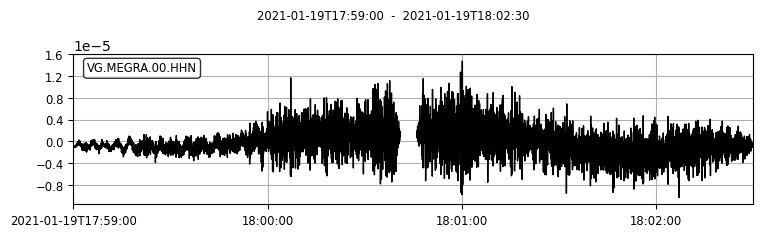

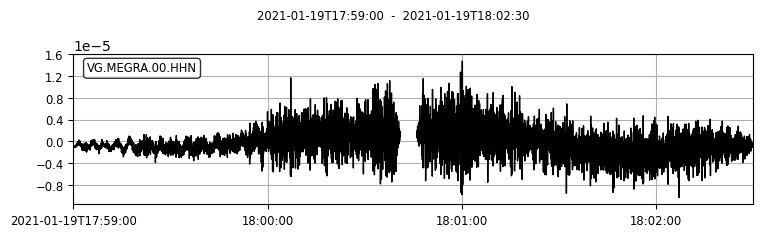

In [57]:
megra.select(component='N').plot()

In [58]:
megra_hhn = megra.select(component='N')
megra_hhn = megra_hhn.merge(method=1, interpolation_samples=-1, fill_value='interpolate')

for tr in megra.select(component='N'):
    megra.remove(tr)
megra = megra + megra_hhn
megra = megra.sort()
megra

3 Trace(s) in Stream:
VG.MEGRA.00.HHE | 2021-01-19T17:59:00.000000Z - 2021-01-19T18:02:30.000000Z | 100.0 Hz, 21001 samples
VG.MEGRA.00.HHN | 2021-01-19T17:59:00.000000Z - 2021-01-19T18:02:30.000000Z | 100.0 Hz, 21001 samples
VG.MEGRA.00.HHZ | 2021-01-19T17:59:00.000000Z - 2021-01-19T18:02:30.000000Z | 100.0 Hz, 21001 samples

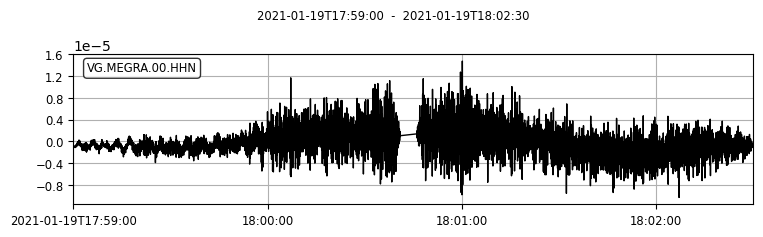

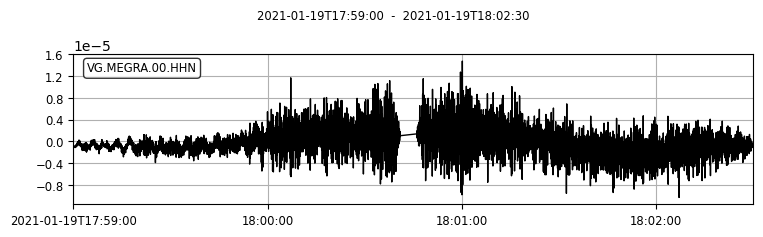

In [59]:
megra[1].plot()

In [60]:
for i in range(len(megra)):
    megra[i].stats.coordinates = AttribDict({'latitude':-7.52163,
                                         'longitude':110.45149,
                                         'elevation':2045})

### Station Network

In [19]:
mepas_net = mepas.select(component='Z').copy()
melab_net = melab.select(component='Z').copy()
mejro_net = mejro.select(component='Z').copy()
megra_net = megra.select(component='Z').copy()

st_net = mepas_net+melab_net+mejro_net+megra_net


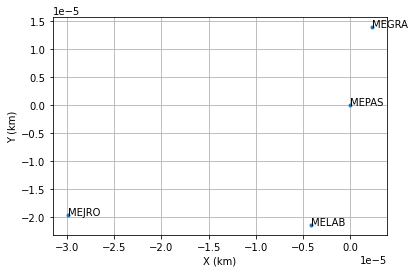

In [20]:
st_net
X, stn = mc.get_array_coords(st_net, 'MEPAS')
mc.plot_array_coords(X, stn, units='km')

### Signal Analysis

#### Spectrogram Before Filter

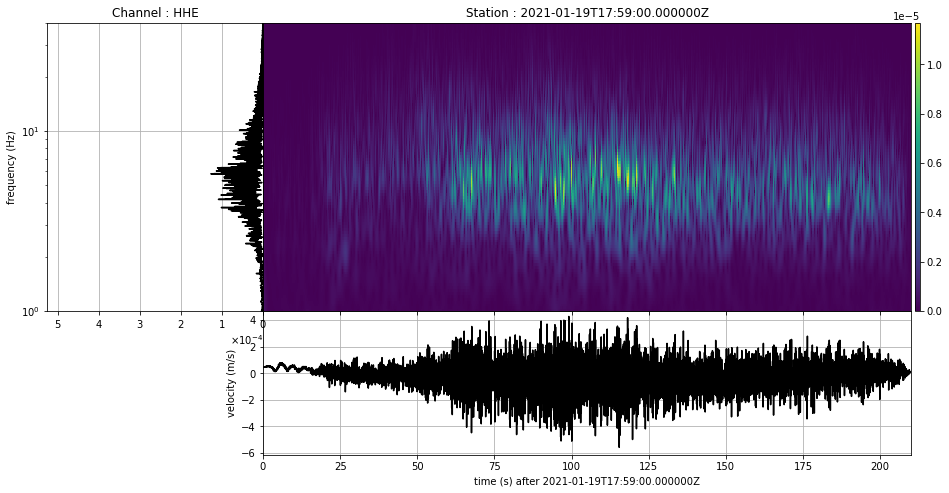

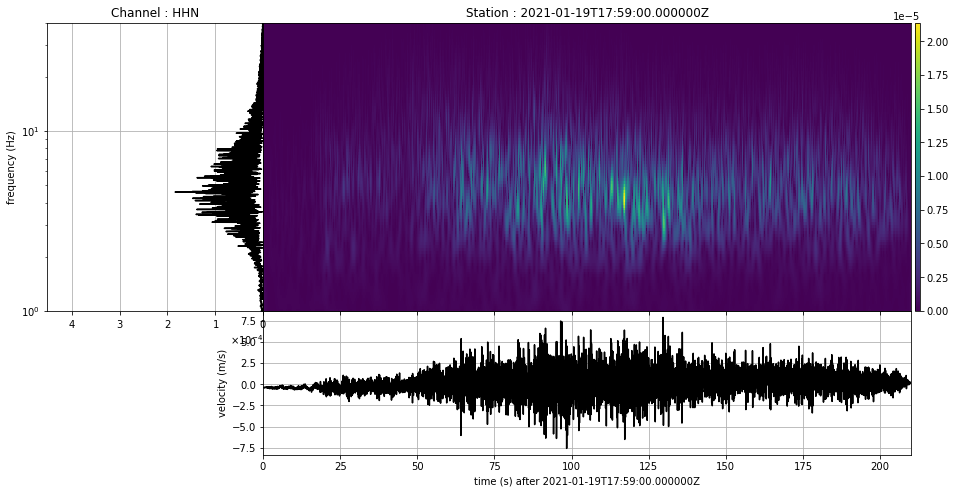

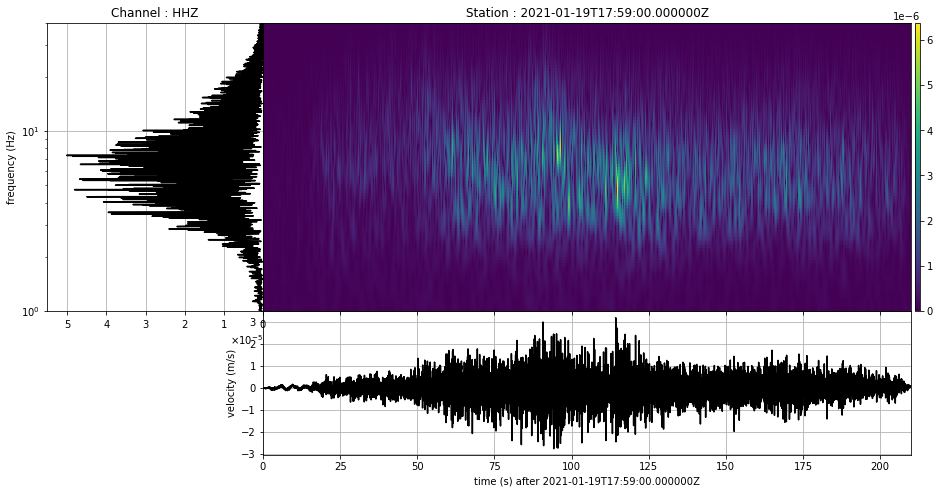

In [21]:
# MEPAS
for i in range(len(mepas)):
    mc.plot_tfr(
    mepas[i].data, 
    tr=mepas[i],
    fmin=1.0,
    fmax=40.0,
    dt=mepas[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

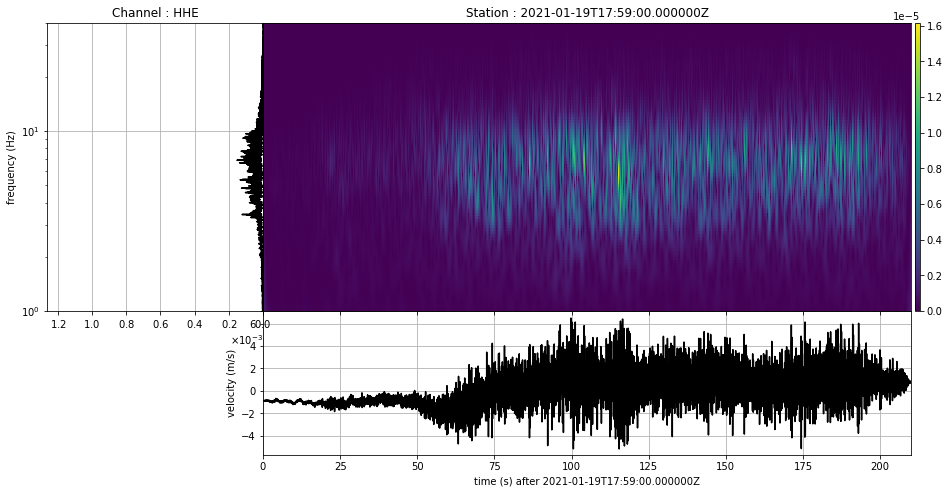

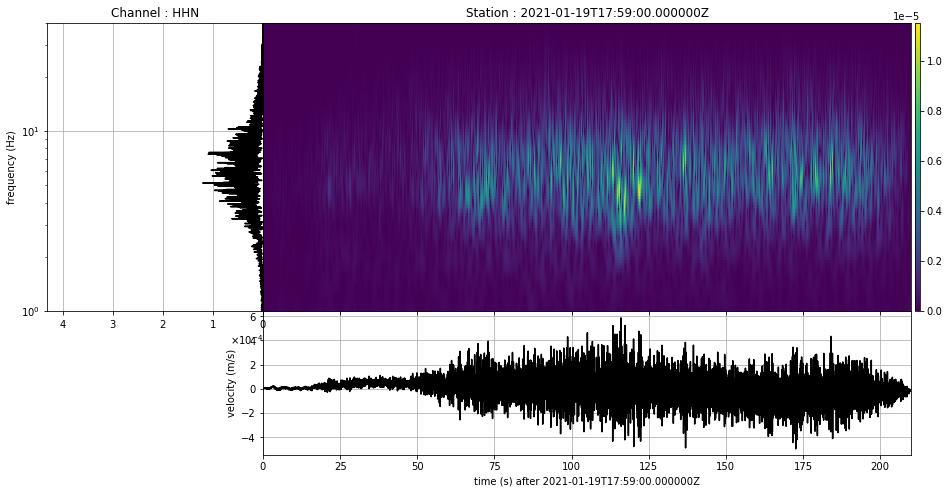

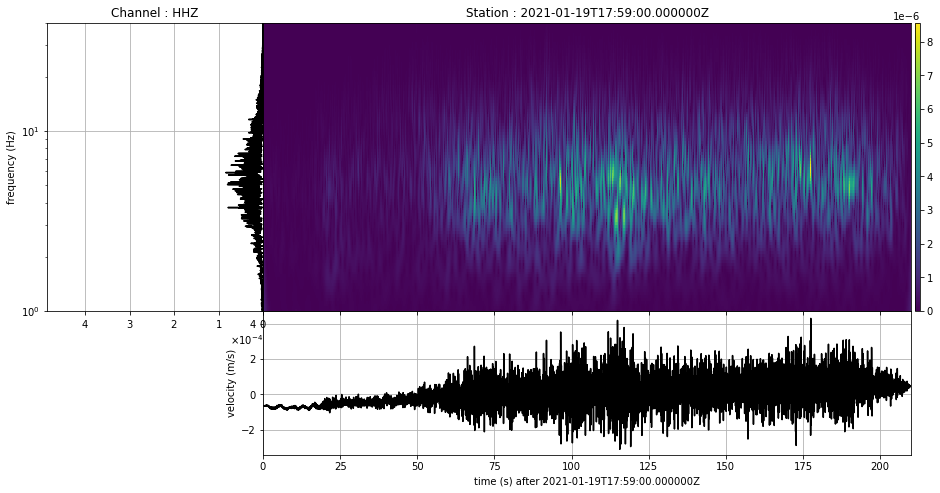

In [22]:
# MELAB
for i in range(len(melab)):
    mc.plot_tfr(
    melab[i].data, 
    tr=melab[i],
    fmin=1.0,
    fmax=40.0,
    dt=melab[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

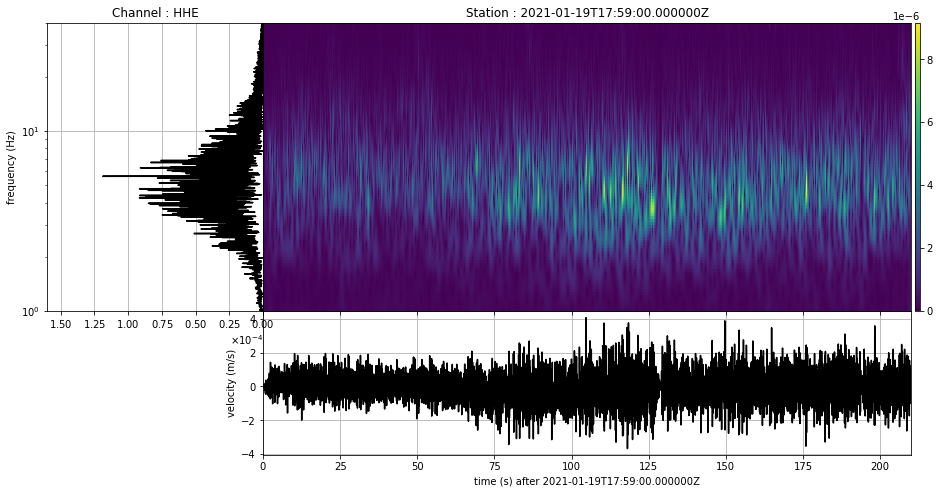

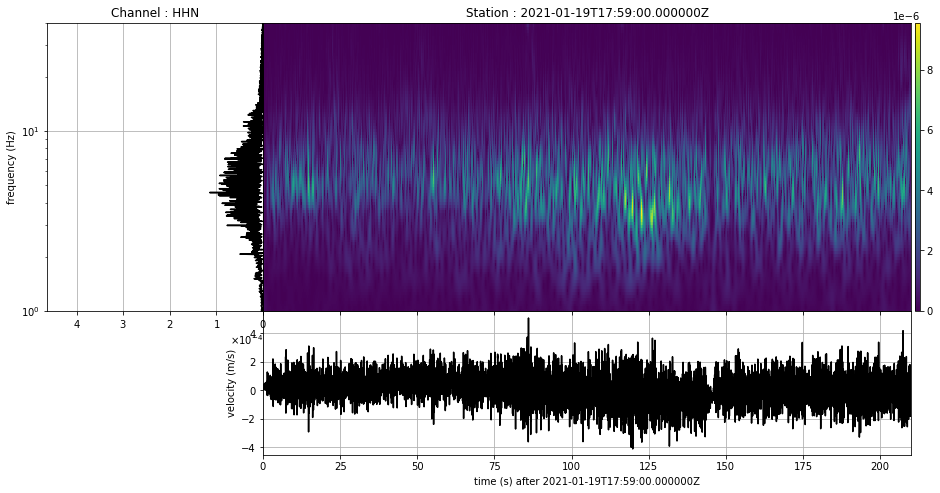

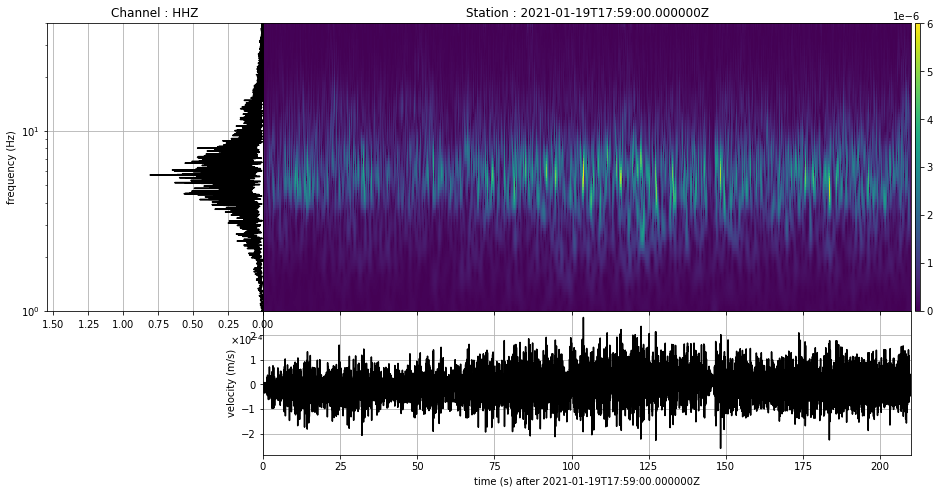

In [23]:
# MEJRO
for i in range(len(mejro)):
    mc.plot_tfr(
    mejro[i].data, 
    tr=mejro[i],
    fmin=1.0,
    fmax=40.0,
    dt=mejro[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

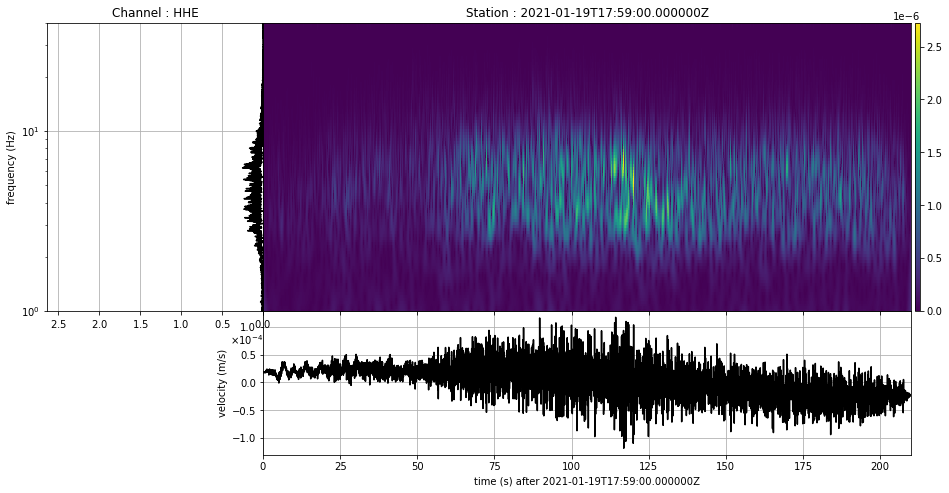

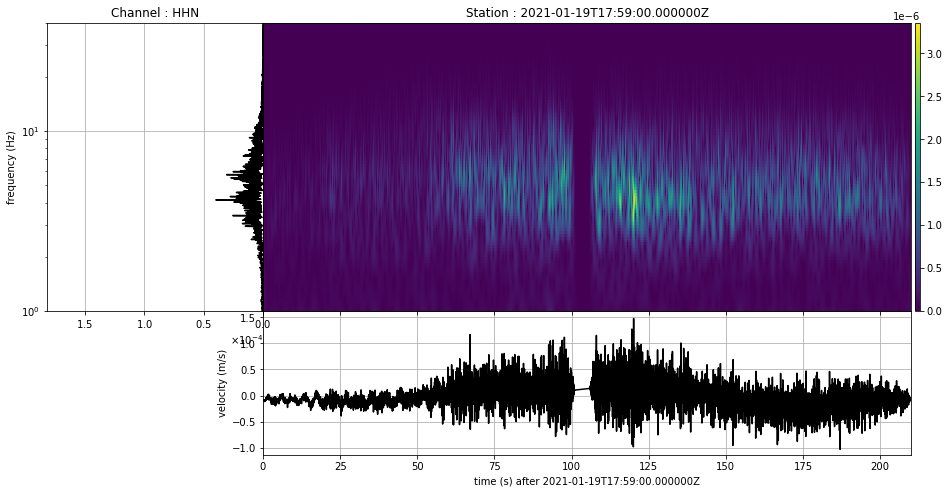

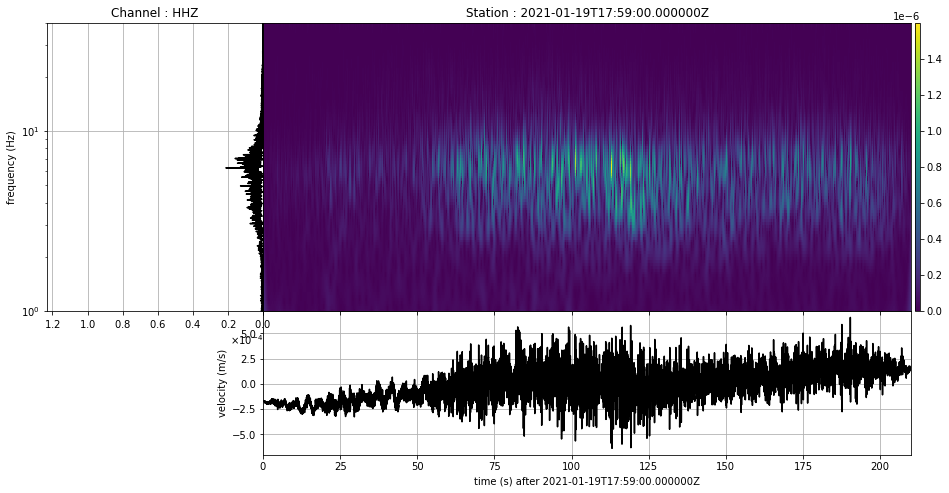

In [24]:
# MEGRA
for i in range(len(megra)):
    mc.plot_tfr(
    megra[i].data, 
    tr=megra[i],
    fmin=1.0,
    fmax=40.0,
    dt=megra[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

#### Data Filter

In [61]:
mepas = mepas.filter('bandpass', freqmin = 1.0, freqmax=12.0)
melab = melab.filter('bandpass', freqmin = 1.0, freqmax=12.0)
mejro = mejro.filter('bandpass', freqmin = 1.0, freqmax=12.0)
megra = megra.filter('bandpass', freqmin = 1.0, freqmax=12.0)

#### Spectrogram After Filter

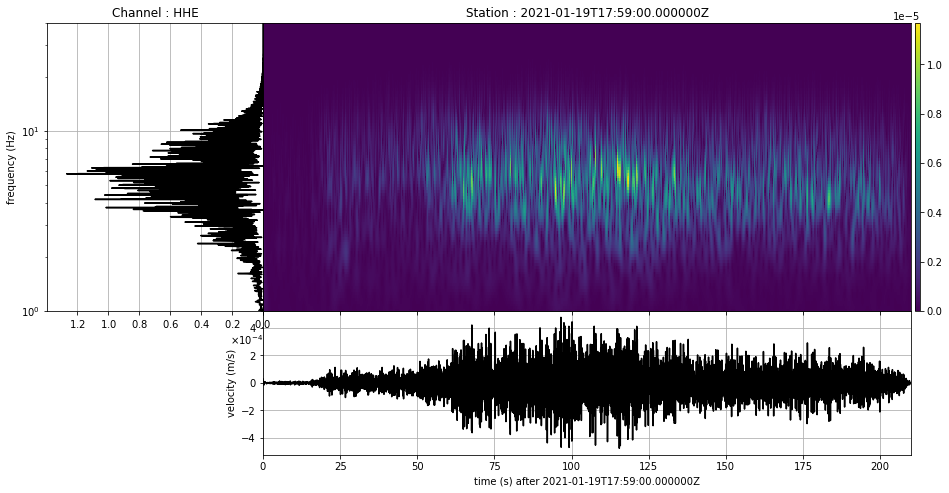

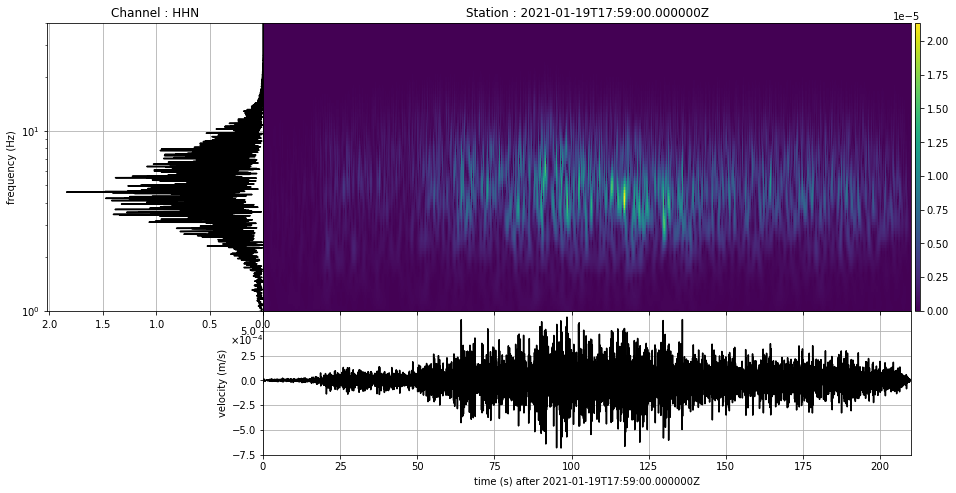

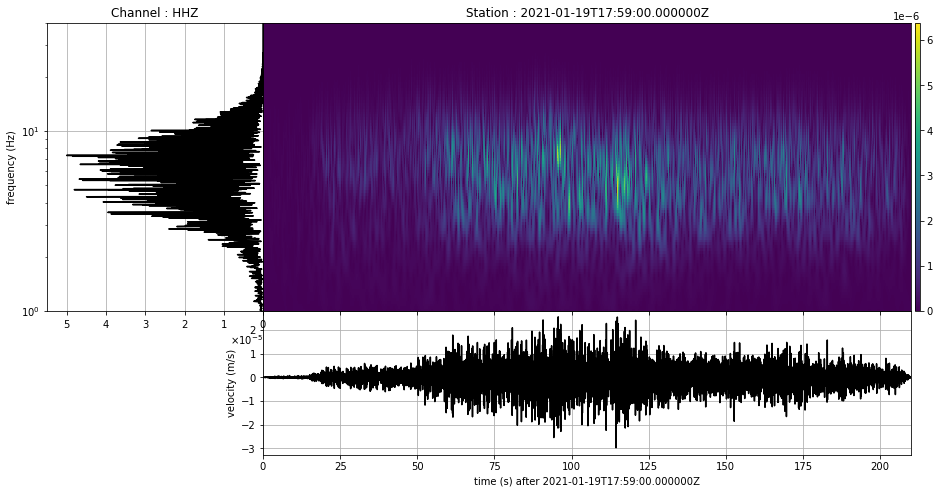

In [26]:
# MEPAS
for i in range(len(mepas)):
    mc.plot_tfr(
    mepas[i].data, 
    tr=mepas[i],
    fmin=1.0,
    fmax=40.0,
    dt=mepas[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

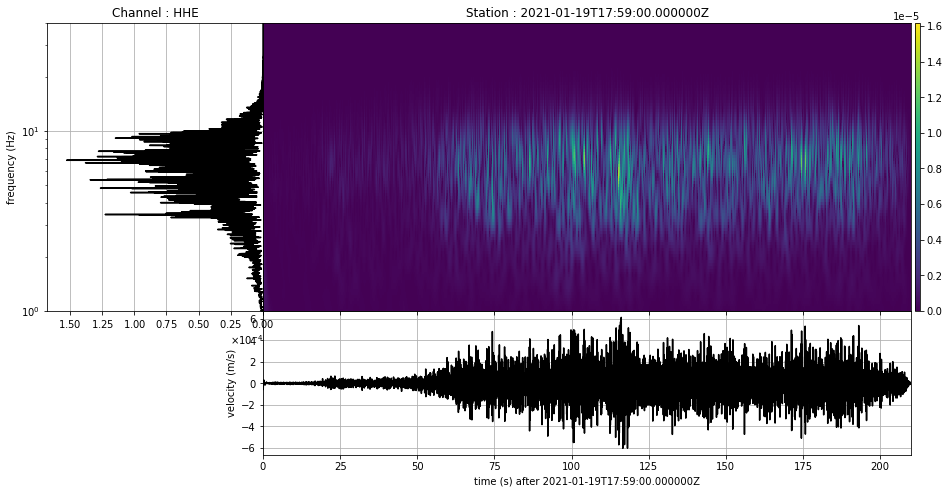

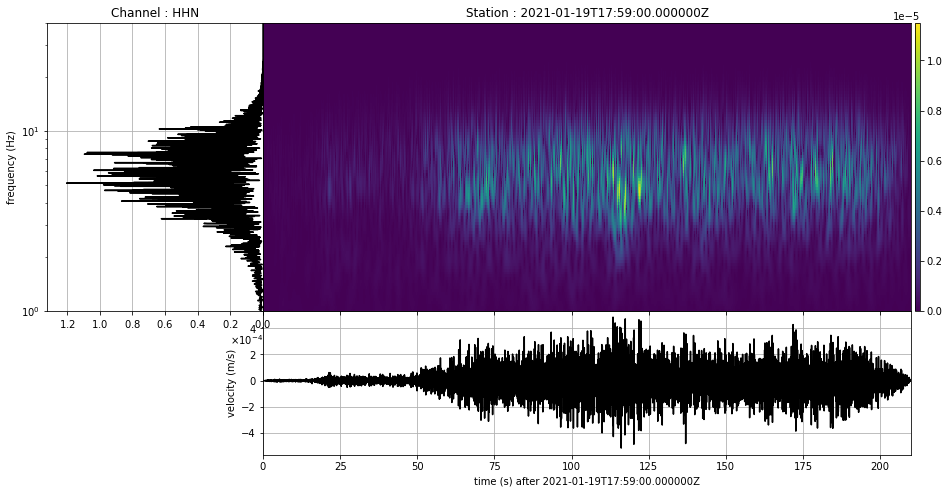

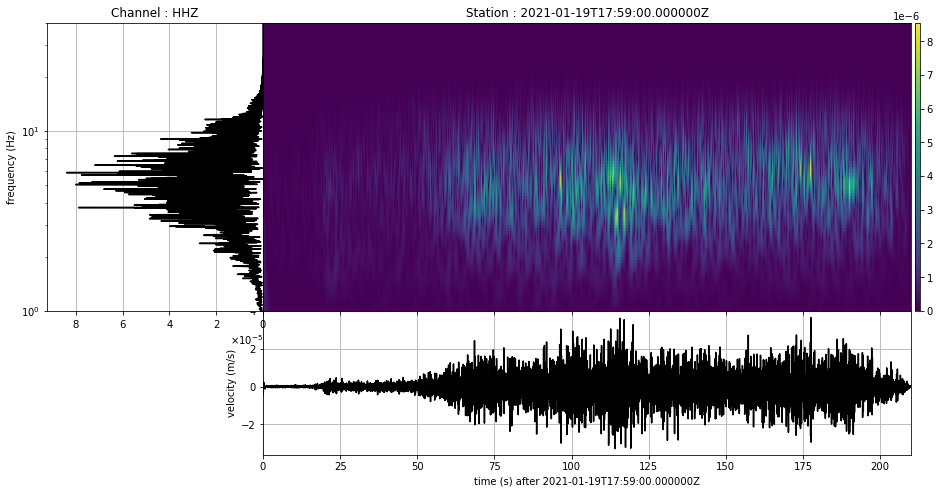

In [27]:
# MELAB
for i in range(len(melab)):
    mc.plot_tfr(
    melab[i].data, 
    tr=melab[i],
    fmin=1.0,
    fmax=40.0,
    dt=melab[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

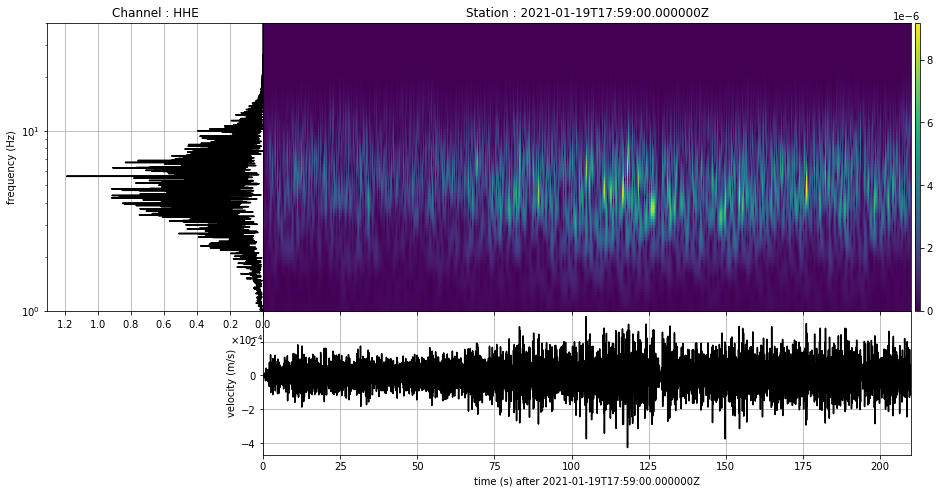

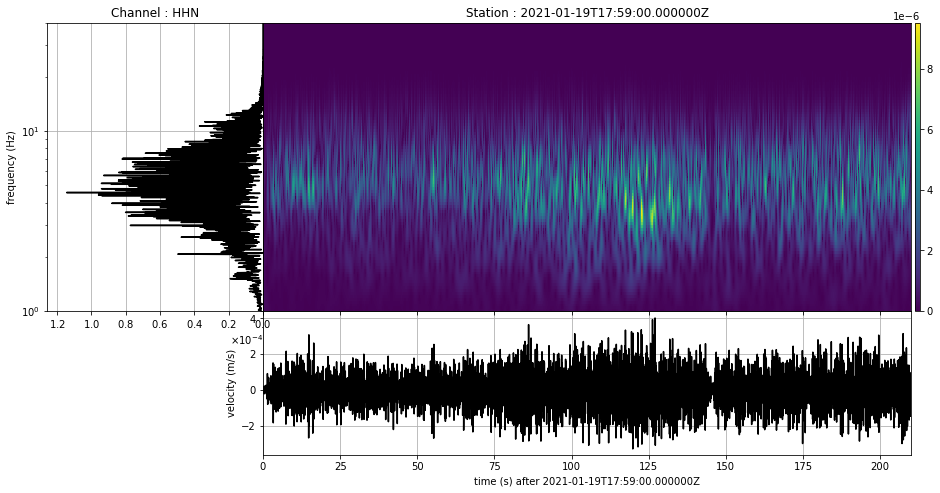

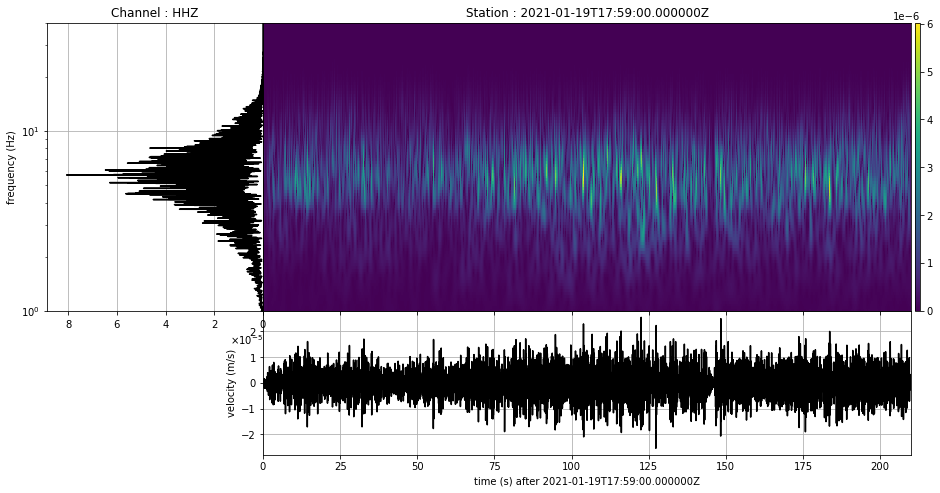

In [28]:
# MEJRO
for i in range(len(mejro)):
    mc.plot_tfr(
    mejro[i].data, 
    tr=mejro[i],
    fmin=1.0,
    fmax=40.0,
    dt=mejro[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

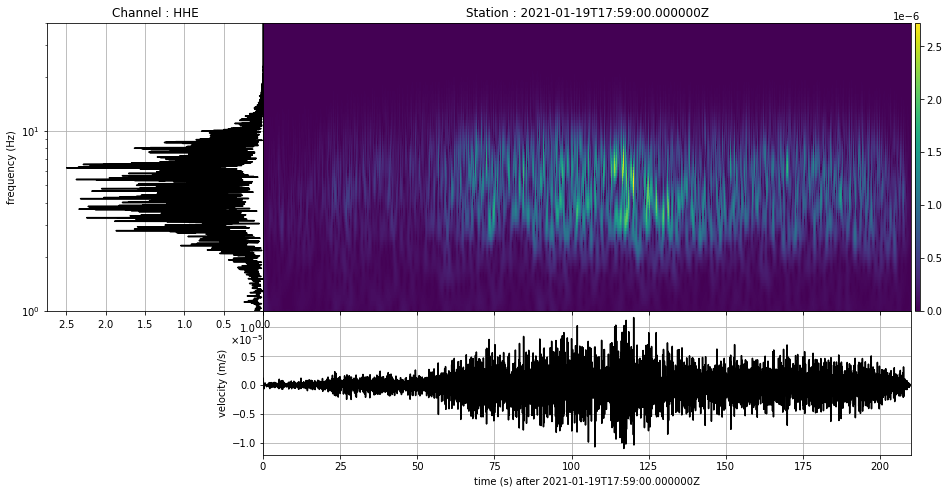

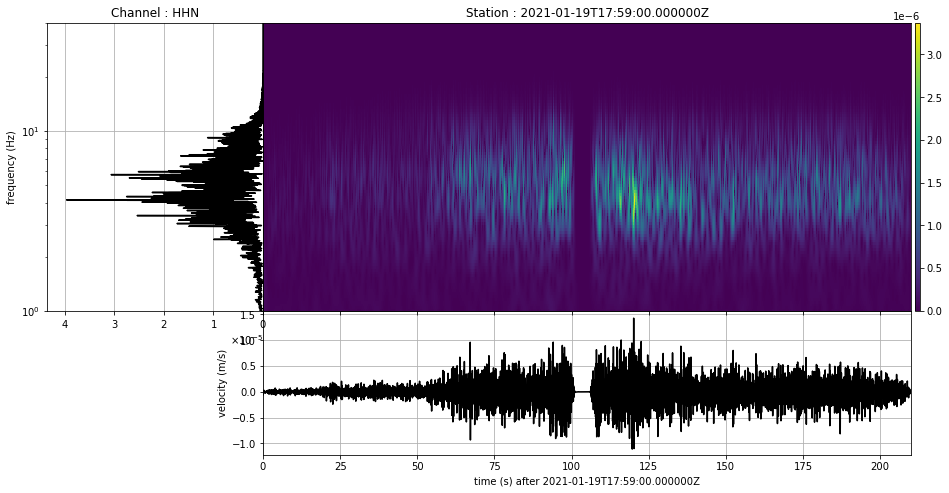

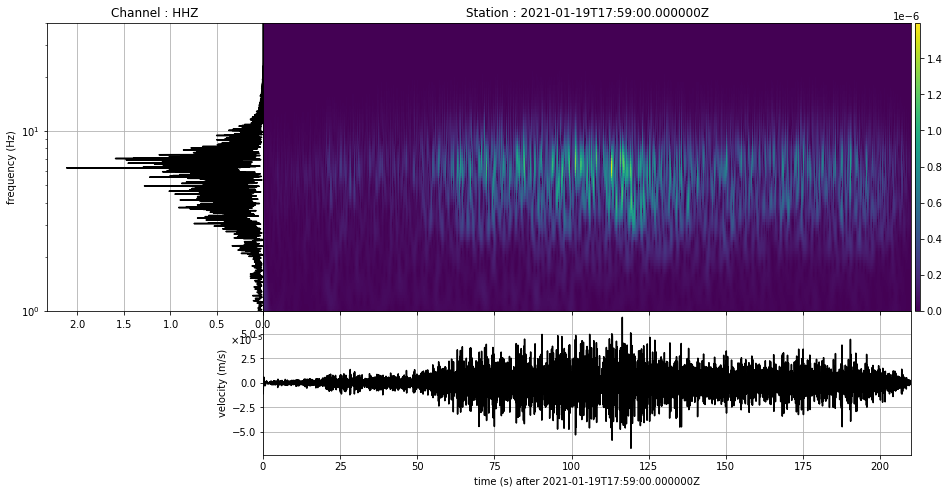

In [29]:
# MEGRA
for i in range(len(megra)):
    mc.plot_tfr(
    megra[i].data, 
    tr=megra[i],
    fmin=1.0,
    fmax=40.0,
    dt=megra[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

### Particle Motion

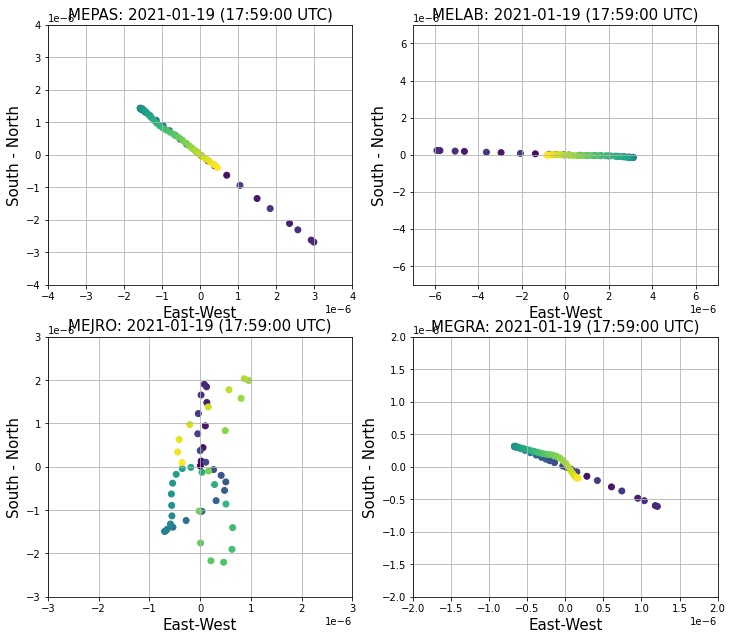

In [62]:
# trimming and plotting particle motion
mepas_pm = mepas.copy()
melab_pm = melab.copy()
mejro_pm = mejro.copy()
megra_pm = megra.copy()

st_pm = mepas_pm+melab_pm+mejro_pm+megra_pm

start = st_pm[0].stats.starttime
end_pm = start + 0.5
st_pm = st_pm.trim(starttime=start, endtime=end_pm)

for tr in st_pm.select(channel='HHZ'):
  st_pm.remove(tr)

mepas_pm = st_pm.select(station = 'mepas')
mepas_ctime = np.array(mepas_pm[0].times())
melab_pm = st_pm.select(station = 'melab')
melab_ctime = np.array(melab_pm[0].times())
mejro_pm = st_pm.select(station = 'mejro')
mejro_ctime = np.array(mejro_pm[0].times())
megra_pm = st_pm.select(station = 'megra')
megra_ctime = np.array(megra_pm[0].times())

lim = 0.000007

fig = plt.figure(figsize=(12, 22))
ax=fig.add_subplot(421)
ax.set_title('MEPAS: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax.set_xlabel('East-West', fontsize = 15)
ax.set_ylabel('South - North', fontsize = 15)
ax.set_xlim(-0.000004, 0.000004)
ax.set_ylim(-0.000004, 0.000004)
ax.scatter(mepas_pm[0].data, mepas_pm[1].data, marker='o', c=mepas_ctime)

ax1=fig.add_subplot(422)
ax1.set_title('MELAB: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax1.set_xlabel('East-West', fontsize = 15)
ax1.set_ylabel('South - North', fontsize = 15)
ax1.set_xlim(-lim, lim)
ax1.set_ylim(-lim, lim)
ax1.scatter(melab_pm[0].data, melab_pm[1].data, marker='o', c=melab_ctime)

ax2=fig.add_subplot(423)
ax2.set_title('MEJRO: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax2.set_xlabel('East-West', fontsize = 15)
ax2.set_ylabel('South - North', fontsize = 15)
ax2.set_xlim(-0.000003, 0.000003)
ax2.set_ylim(-0.000003, 0.000003)
ax2.scatter(mejro_pm[0].data, mejro_pm[1].data, marker='o', c=mejro_ctime)

ax3=fig.add_subplot(424)
ax3.set_title('MEGRA: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax3.set_xlabel('East-West', fontsize = 15)
ax3.set_ylabel('South - North', fontsize = 15)
ax3.set_xlim(-0.000002, 0.000002)
ax3.set_ylim(-0.000002, 0.000002)
ax3.scatter(megra_pm[0].data, megra_pm[1].data, marker='o', c=megra_ctime)

ax.grid()
ax1.grid()
ax2.grid()
ax3.grid()


plt.savefig('Particle Motion - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white', transparent=False)
ax = plt.gca


### Beamforming ⭕

In [63]:
mepas_fk = mepas.copy()
melab_fk = melab.copy()
mejro_fk = mejro.copy()
megra_fk = megra.copy()


st_ = mepas_fk+melab_fk+mejro_fk+megra_fk
st_fk = st_.copy()
st_fk = st_fk.select(channel='HHZ')

In [64]:
# input parameter
fmin = 1.0
fmax = 12.0
slw = 3.0
sl_s = 1.0
win_len = 3.0
win_frac = 0.5

start = []
for i in range(len(st_fk)):
    start.append(st_fk[i].stats.starttime)
end = []
for i in range(len(st_fk)):
    end.append(st_fk[i].stats.endtime)

t0 = max(start)
t1 = min(end)

st_fk = st_fk.trim(t0, t1)

start = st_fk[0].stats.starttime
end = st_fk[0].stats.endtime

kwargs = dict(
    # slowness grid (x,y) and slow step
    sll_x=-slw, slm_x=slw, sll_y=-slw, slm_y=slw, sl_s=sl_s,
    #sliding window
    win_len=win_len, win_frac=win_frac,
    # frequency for bandpass
    frqlow=fmin, frqhigh=fmax, prewhiten=0,
    # semblance
    semb_thres=-1e9, vel_thres=-1e9,
    stime=start, etime=end, method=0)

out = array_processing(stream=st_fk, verbose=False, **kwargs)
# return = timestamp, realtive relpow, abs relpow, baz, slowness

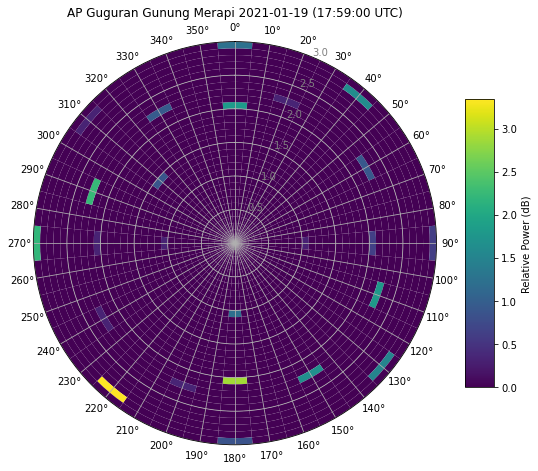

In [65]:
# plotting array

cmap = obspy_sequential
#adjust BAZ into range 0 - 360 degree
t, rel_power, abs_power, baz, slow = out.T
baz[baz<0.0] += 360

df3 = pd.DataFrame({"Time":t, "Backazimuth":baz, "Slowness":slow, 
                    "Relative Power":rel_power
                    
                    })

N=36
N2=30
abins = np.arange(N+1) *360./N
sbins = np.linspace(0, 3, N2+1)

# sum relative power in bins
hist, baz_edges, sl_edges = \
    np.histogram2d(baz, slow, bins=[abins, sbins], weights=rel_power)

# get radians
baz_edges = np.radians(baz_edges)


# polar diagram
fig = plt.figure(figsize=(8,8))
cax = fig.add_axes([0.85, 0.2, 0.05, 0.5])
ax = fig.add_axes([0.10, 0.1, 0.70, 0.70], polar=True)
ax.set_theta_direction(-1)
ax.set_theta_zero_location('N')

dh = abs(sl_edges[1]-sl_edges[0])
dw = abs(baz_edges[1]-baz_edges[0])

for i, row in enumerate(hist):
    bars = ax.bar((i*dw) * np.ones(N2),
                   height=dh*np.ones(N2),
                   width=dw, bottom=dh*np.arange(N2),
                   color=cmap(row/hist.max()))
    
ax.set_xticks(np.linspace(0, 2*np.pi, 36, endpoint=False))
ax.set_title('AP Guguran Gunung Merapi %s' %(start.strftime('%Y-%m-%d (%H:%M:%S UTC)'),))

# slowness limit
ax.set_ylim(0,3)
[i.set_color('grey') for i in ax.get_yticklabels()]
ColorbarBase(cax, cmap=cmap, norm=Normalize(vmin=hist.min(), vmax=hist.max()), label='Relative Power (dB)')

plt.savefig('Polar Plot - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white')
plt.show()

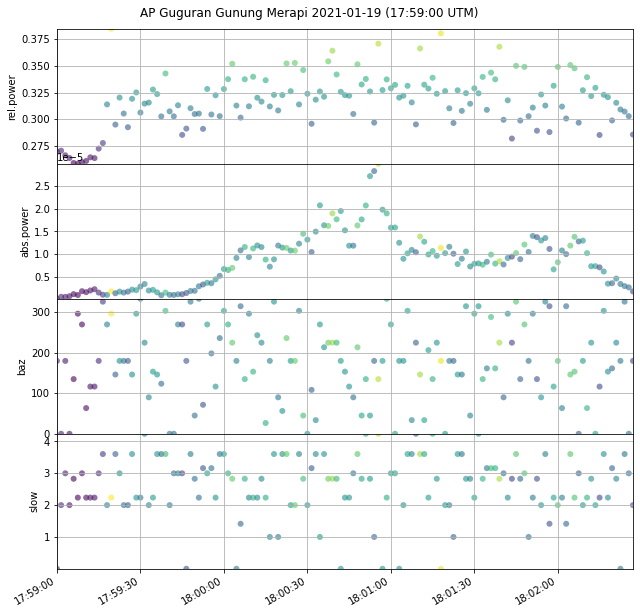

In [35]:
# plot
labels = ['rel.power', 'abs.power', 'baz', 'slow']
xlocator = mdates.AutoDateLocator()
fig = plt.figure(figsize=(10,10))
for i, lab in enumerate(labels):
    ax = fig.add_subplot(4, 1, i + 1)
    ax.scatter(out[:, 0], out[:, i + 1], c=out[:, 1], alpha=0.6,
               edgecolors='none', cmap=obspy_sequential)
    ax.set_ylabel(lab)
    ax.set_xlim(out[0, 0], out[-1, 0])
    ax.set_ylim(out[:, i + 1].min(), out[:, i + 1].max())
    ax.xaxis.set_major_locator(xlocator)
    ax.xaxis.set_major_formatter(mdates.AutoDateFormatter(xlocator))
    ax.grid()


fig.suptitle('AP Guguran Gunung Merapi %s' % (start.strftime('%Y-%m-%d (%H:%M:%S UTC)'), ))
fig.autofmt_xdate()
fig.subplots_adjust(left=0.15, top=0.95, right=0.95, bottom=0.2, hspace=0)
plt.savefig('Plot - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white')
plt.show()

## 2 | (2021-01-19 | 22:12:30) | SW

In [66]:
chID = 'ENZ'
direction = 'SW'
path = 'data/'+direction

st=read(path+"/VG.*"+".D.20*"+".MSEED", type='MSEED')

st = st.sort()

In [67]:
time_s = time1
time_e = time_s + time01
print('duration:', time01)

st0 = st.copy()
st0 = st0.trim(starttime=time_s, endtime=time_e)

duration: 200


### MEPAS

In [68]:
station = 'mepas'
mepas = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

mepas = mepas.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
mepas

3 Trace(s) in Stream:
VG.MEPAS.00.HHE | 2021-01-19T22:12:30.000000Z - 2021-01-19T22:15:50.000000Z | 100.0 Hz, 20001 samples
VG.MEPAS.00.HHN | 2021-01-19T22:12:30.000000Z - 2021-01-19T22:15:50.000000Z | 100.0 Hz, 20001 samples
VG.MEPAS.00.HHZ | 2021-01-19T22:12:30.000000Z - 2021-01-19T22:15:50.000000Z | 100.0 Hz, 20001 samples

In [69]:
for i in range(len(mepas)):
    mepas[i].stats.coordinates = AttribDict({'latitude':-7.535567,
                                             'longitude':110.449185,
                                             'elevation':2679})

### MELAB

In [70]:
station = 'melab'
melab = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

melab = melab.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
melab

3 Trace(s) in Stream:
VG.MELAB.00.HHE | 2021-01-19T22:12:30.000000Z - 2021-01-19T22:15:50.000000Z | 100.0 Hz, 20001 samples
VG.MELAB.00.HHN | 2021-01-19T22:12:30.000000Z - 2021-01-19T22:15:50.000000Z | 100.0 Hz, 20001 samples
VG.MELAB.00.HHZ | 2021-01-19T22:12:30.000000Z - 2021-01-19T22:15:50.000000Z | 100.0 Hz, 20001 samples

In [71]:
for i in range(len(melab)):
    melab[i].stats.coordinates = AttribDict({'latitude':-7.557044,
                                         'longitude':110.445038,
                                         'elevation':1730})

### MEJRO ❗

In [72]:
station = 'mejro'
mejro = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

mejro = mejro.remove_response(inventory=inv, 
                              output='VEL',
                              plot=False)


In [73]:
mejro = mejro._cleanup()
mejro

3 Trace(s) in Stream:
VG.MEJRO.00.HHE | 2021-01-19T22:12:30.000000Z - 2021-01-19T22:15:50.000000Z | 100.0 Hz, 20001 samples
VG.MEJRO.00.HHN | 2021-01-19T22:12:30.000000Z - 2021-01-19T22:15:50.000000Z | 100.0 Hz, 20001 samples
VG.MEJRO.00.HHZ | 2021-01-19T22:12:30.000000Z - 2021-01-19T22:15:50.000000Z | 100.0 Hz, 20001 samples

In [74]:
for i in range(len(mejro)):
    mejro[i].stats.coordinates = AttribDict({'latitude':-7.555357,
                                         'longitude':110.419287,
                                         'elevation':1335})

### MEGRA

In [75]:
station = 'megra'
megra = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

megra = megra.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
megra

3 Trace(s) in Stream:
VG.MEGRA.00.HHE | 2021-01-19T22:12:30.000000Z - 2021-01-19T22:15:50.000000Z | 100.0 Hz, 20001 samples
VG.MEGRA.00.HHN | 2021-01-19T22:12:30.000000Z - 2021-01-19T22:15:50.000000Z | 100.0 Hz, 20001 samples
VG.MEGRA.00.HHZ | 2021-01-19T22:12:30.000000Z - 2021-01-19T22:15:50.000000Z | 100.0 Hz, 20001 samples

In [76]:
for i in range(len(megra)):
    megra[i].stats.coordinates = AttribDict({'latitude':-7.52163,
                                         'longitude':110.45149,
                                         'elevation':2045})

### Signal Analysis

#### Spectrogram Before Filter

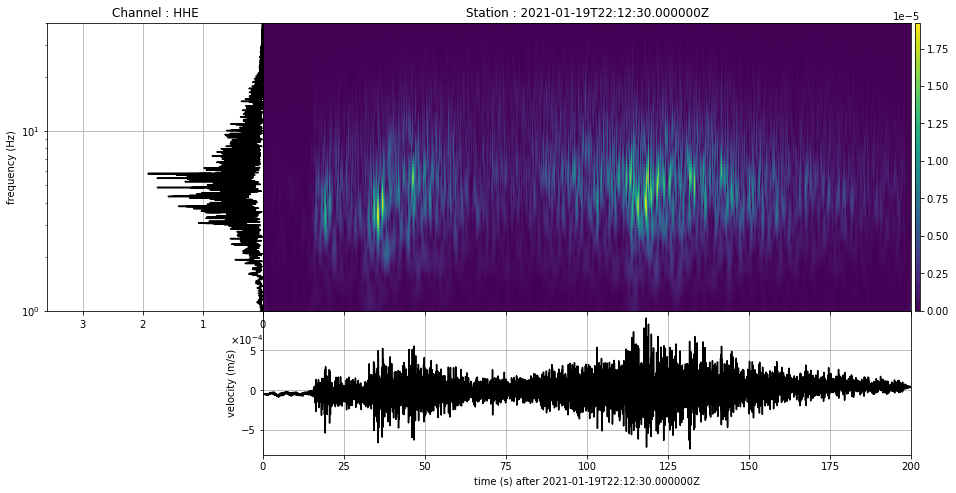

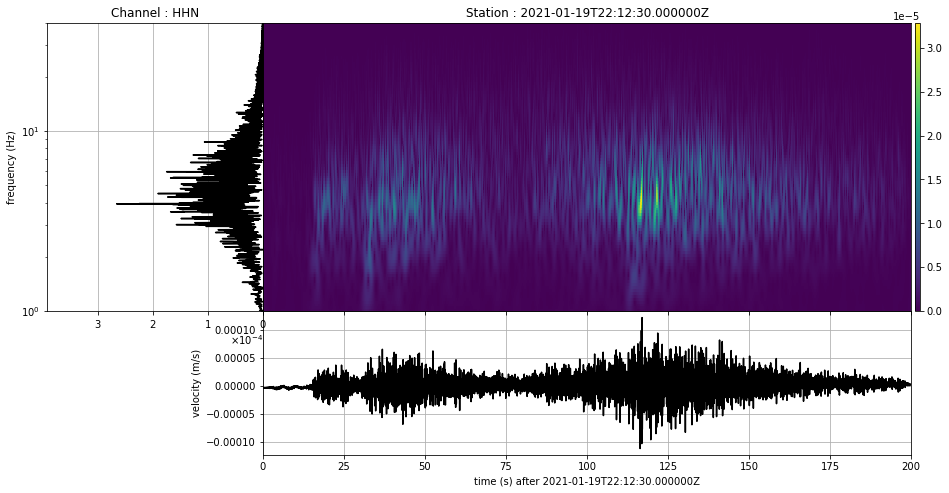

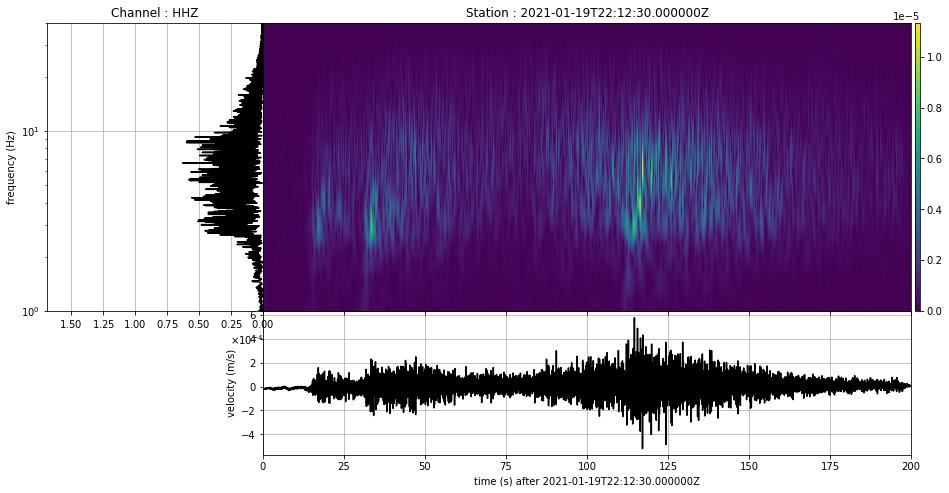

In [47]:
# MEPAS
for i in range(len(mepas)):
    mc.plot_tfr(
    mepas[i].data, 
    tr=mepas[i],
    fmin=1.0,
    fmax=40.0,
    dt=mepas[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

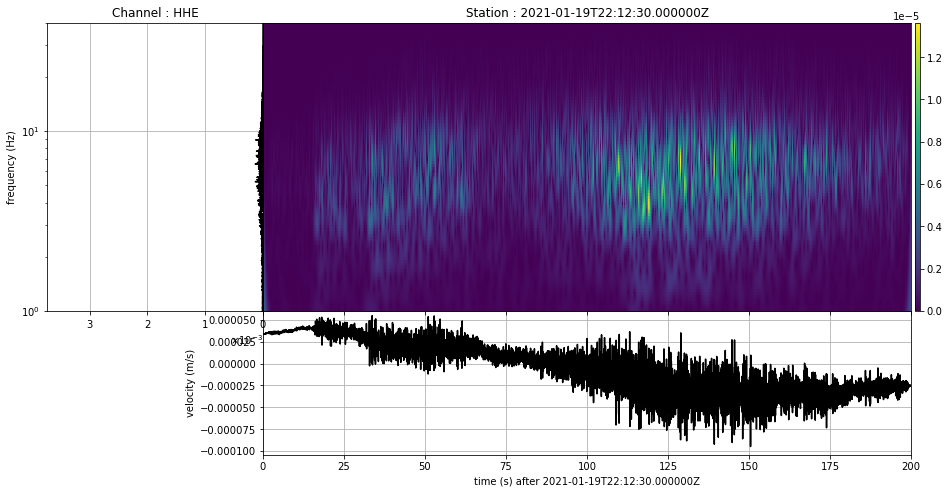

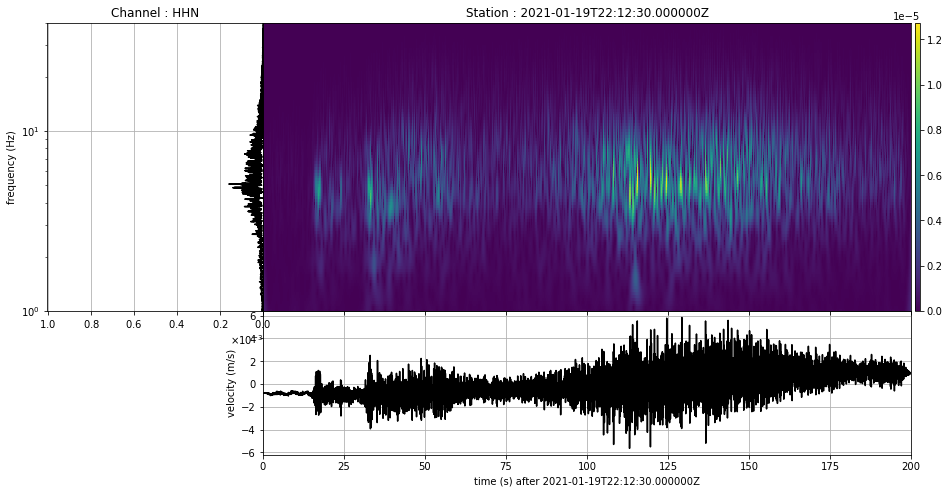

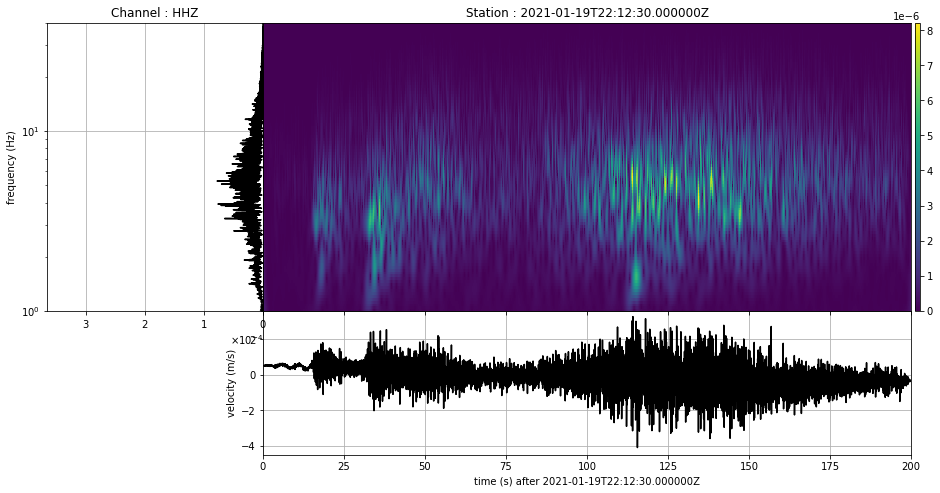

In [48]:
# MELAB
for i in range(len(melab)):
    mc.plot_tfr(
    melab[i].data, 
    tr=melab[i],
    fmin=1.0,
    fmax=40.0,
    dt=melab[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

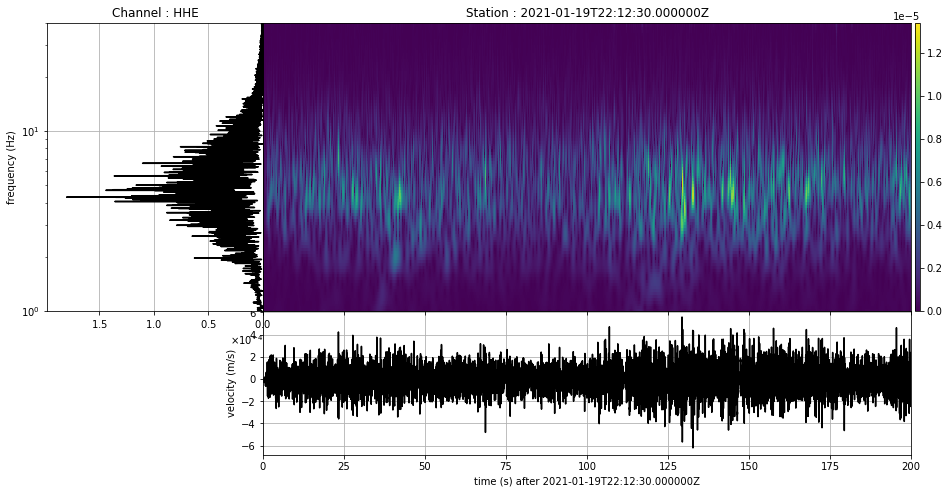

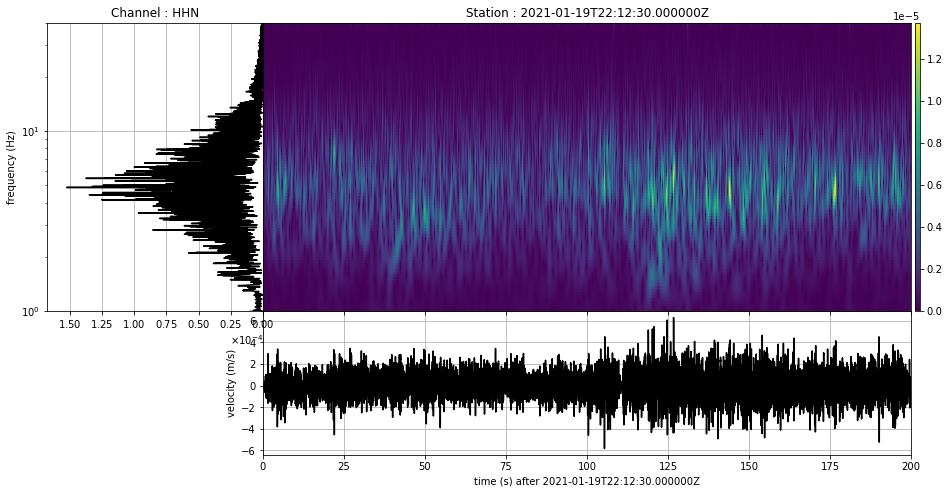

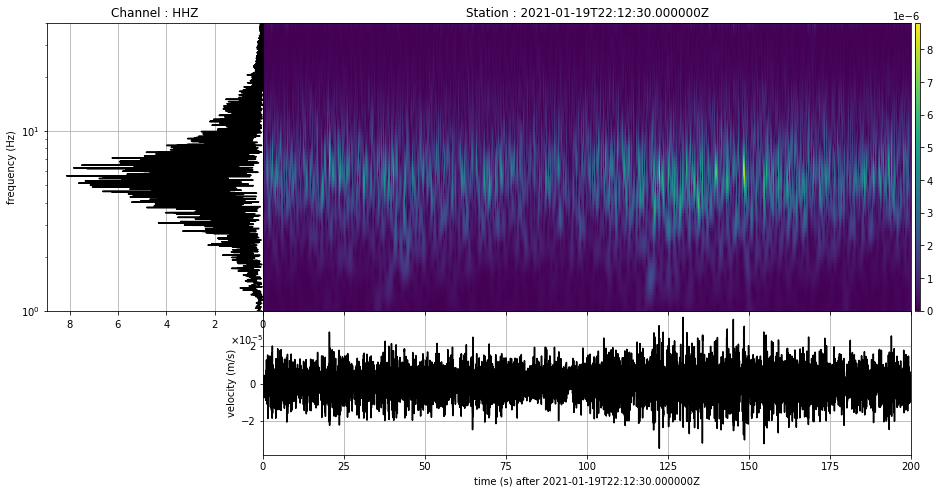

In [49]:
# MEJRO
for i in range(len(mejro)):
    mc.plot_tfr(
    mejro[i].data, 
    tr=mejro[i],
    fmin=1.0,
    fmax=40.0,
    dt=mejro[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

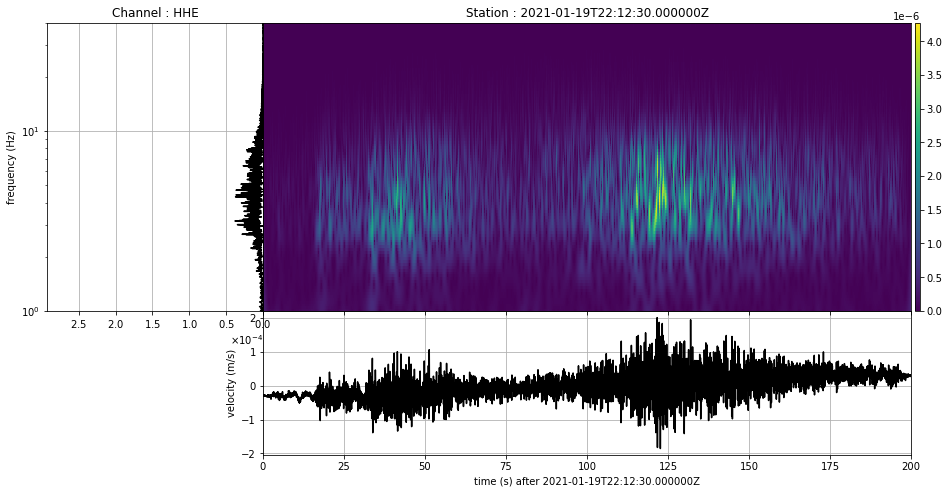

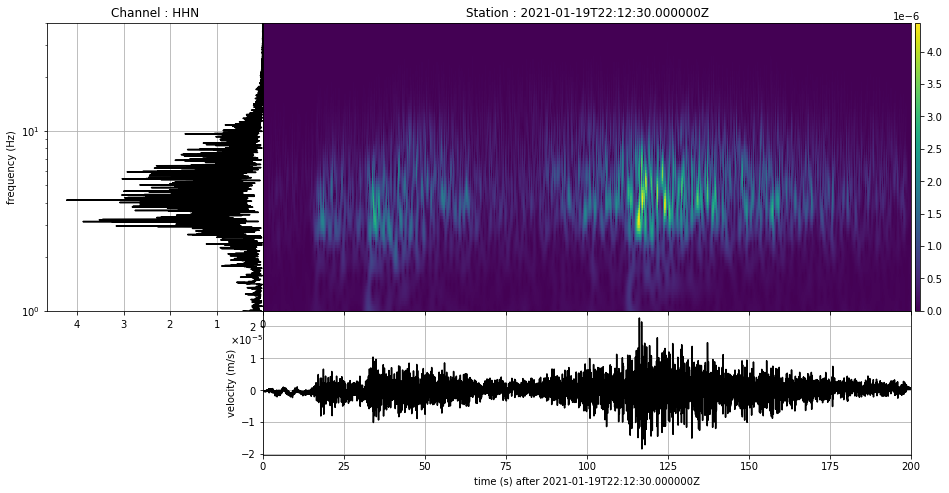

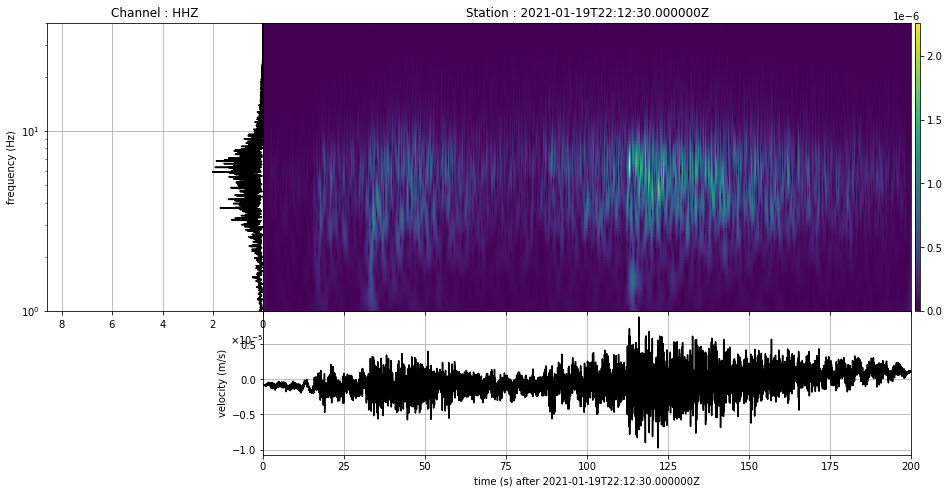

In [50]:
# MEGRA
for i in range(len(megra)):
    mc.plot_tfr(
    megra[i].data, 
    tr=megra[i],
    fmin=1.0,
    fmax=40.0,
    dt=megra[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

#### Data Filter

In [77]:
mepas = mepas.filter('bandpass', freqmin = 1.0, freqmax=12.0)
melab = melab.filter('bandpass', freqmin = 1.0, freqmax=12.0)
mejro = mejro.filter('bandpass', freqmin = 1.0, freqmax=12.0)
megra = megra.filter('bandpass', freqmin = 1.0, freqmax=12.0)

#### Spectrogram After Filter

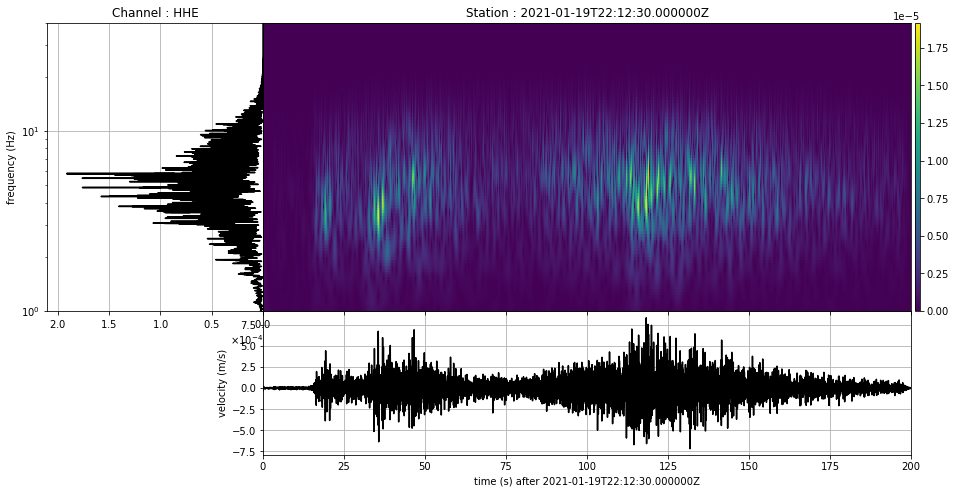

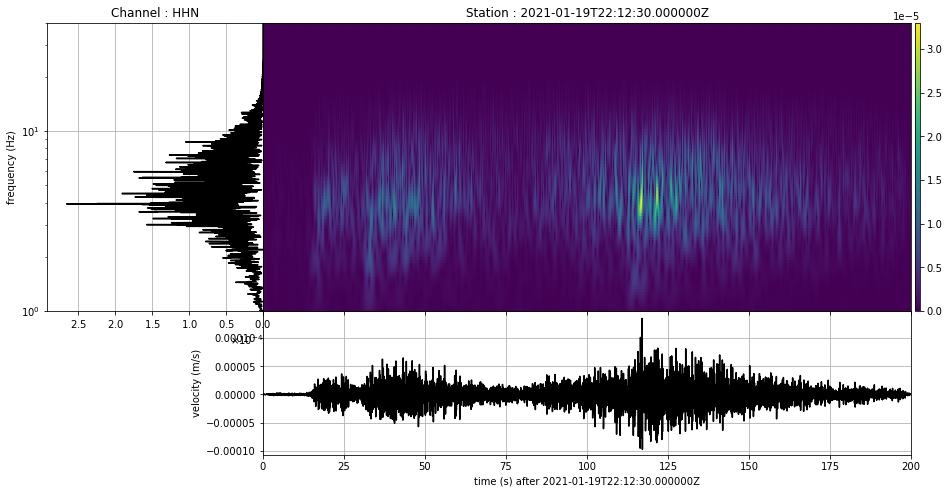

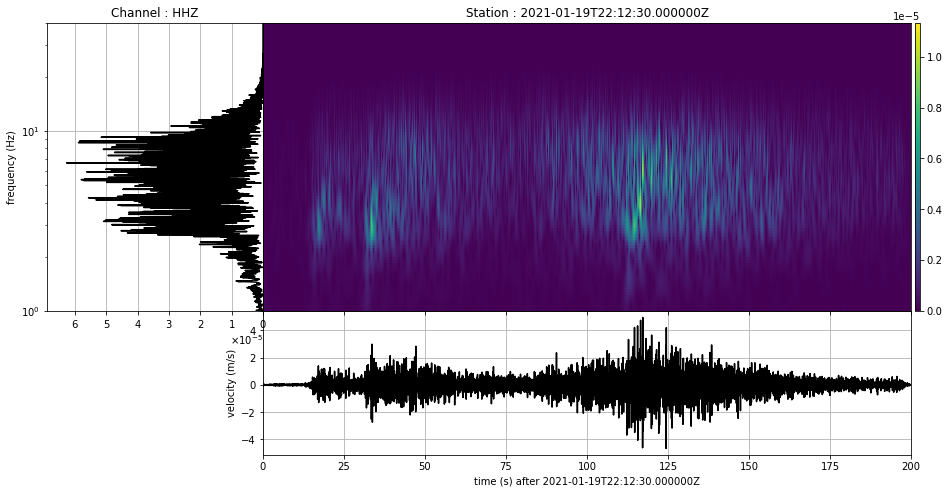

In [52]:
# MEPAS
for i in range(len(mepas)):
    mc.plot_tfr(
    mepas[i].data, 
    tr=mepas[i],
    fmin=1.0,
    fmax=40.0,
    dt=mepas[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

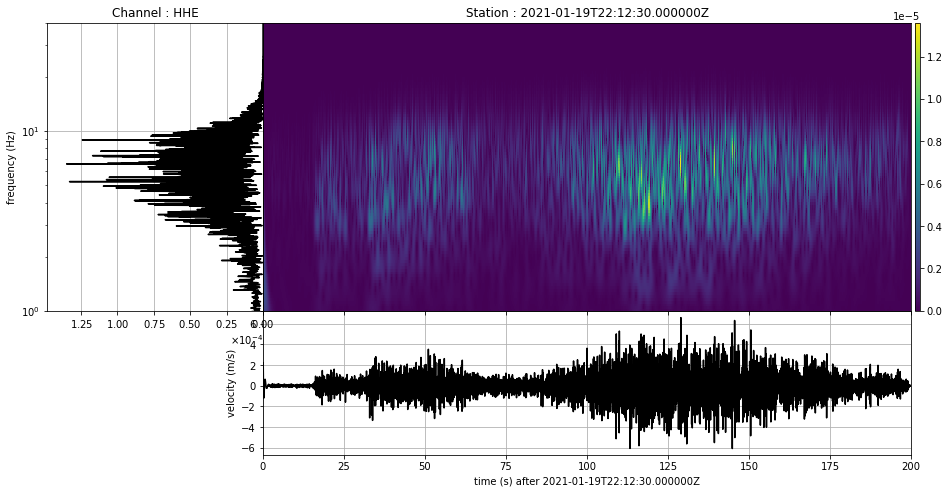

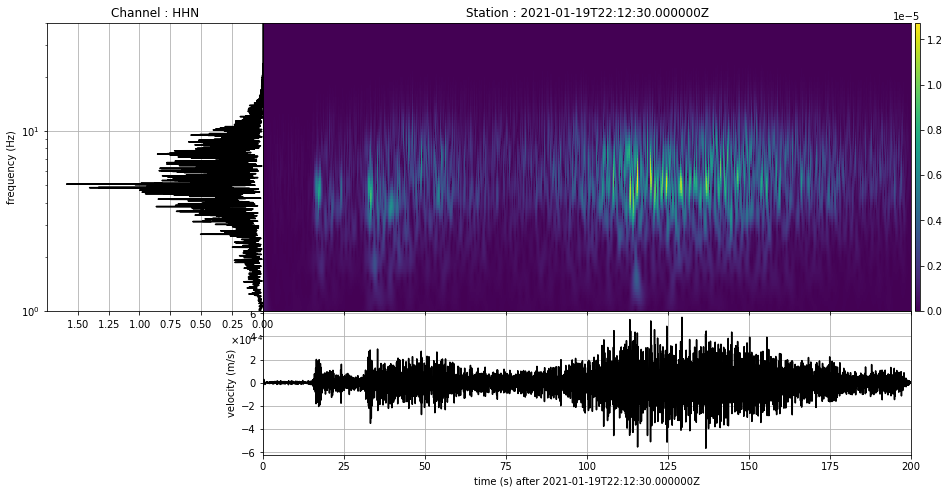

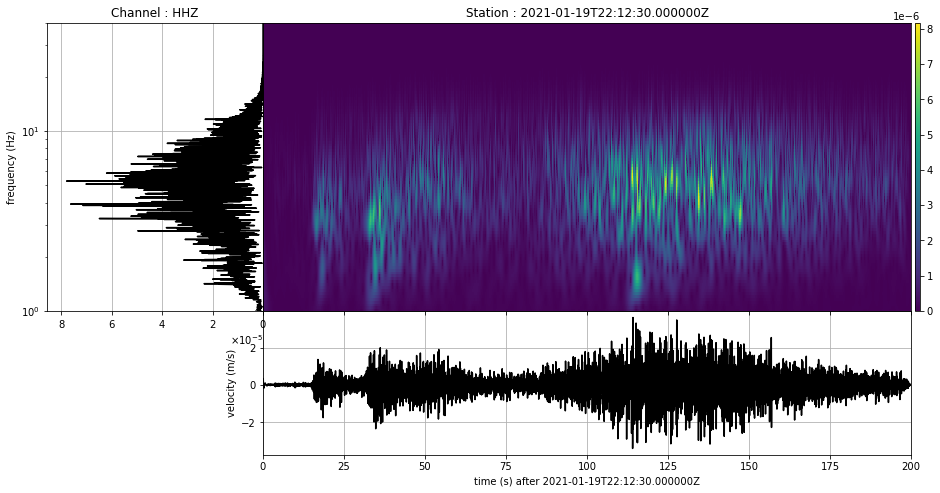

In [53]:
# MELAB
for i in range(len(melab)):
    mc.plot_tfr(
    melab[i].data, 
    tr=melab[i],
    fmin=1.0,
    fmax=40.0,
    dt=melab[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

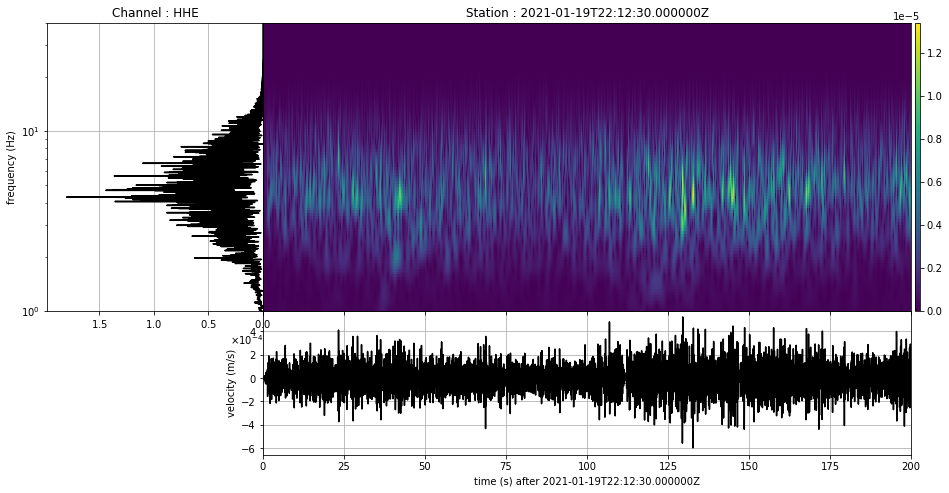

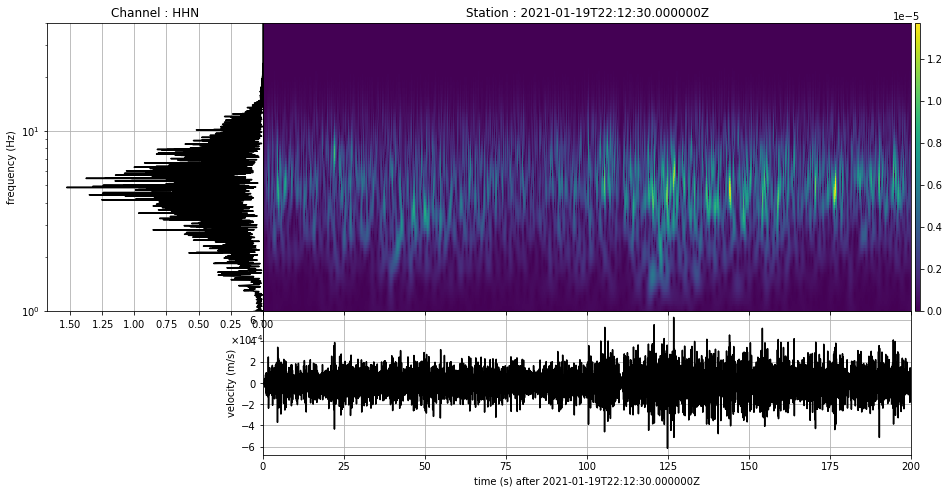

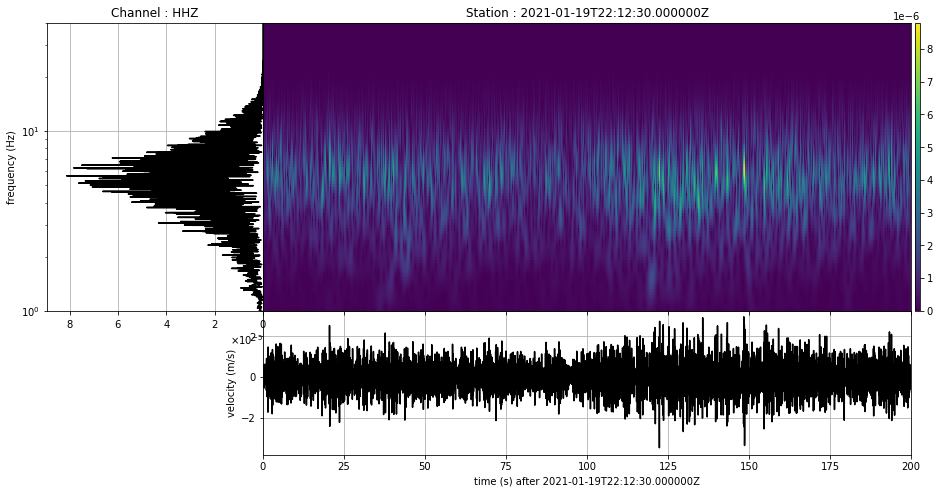

In [54]:
# MEJRO
for i in range(len(mejro)):
    mc.plot_tfr(
    mejro[i].data, 
    tr=mejro[i],
    fmin=1.0,
    fmax=40.0,
    dt=mejro[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

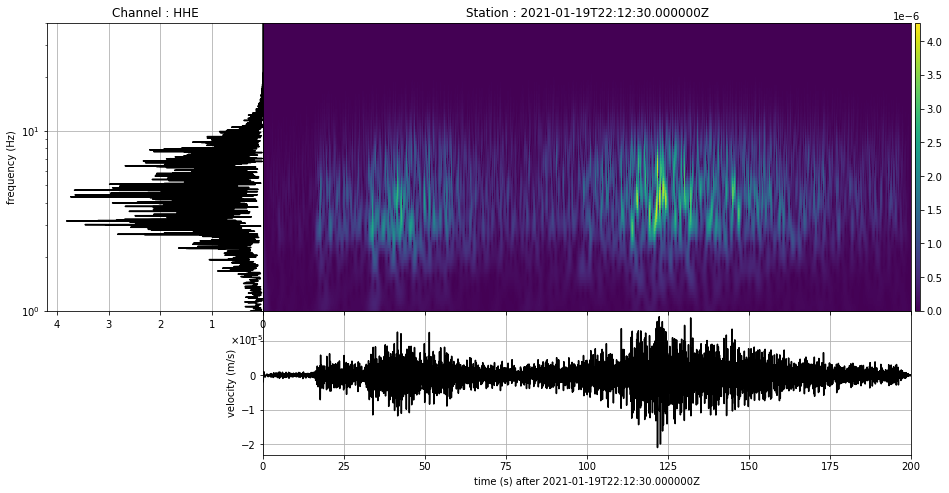

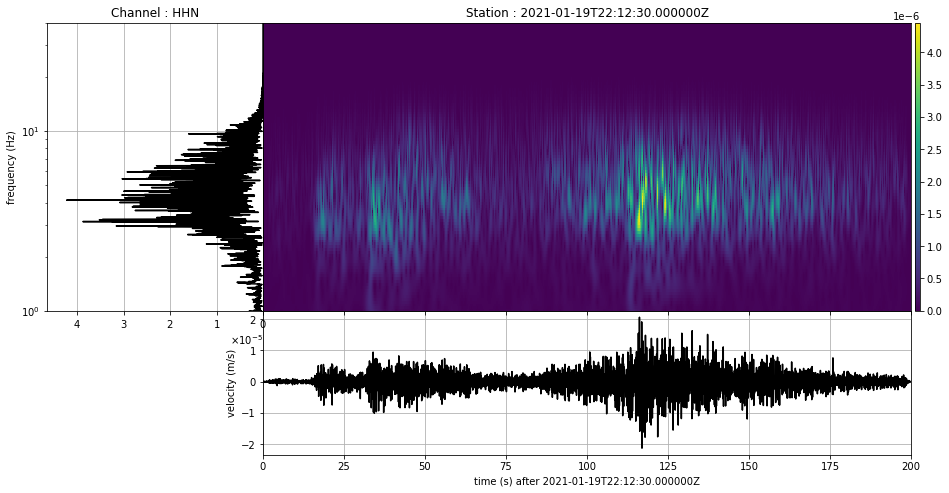

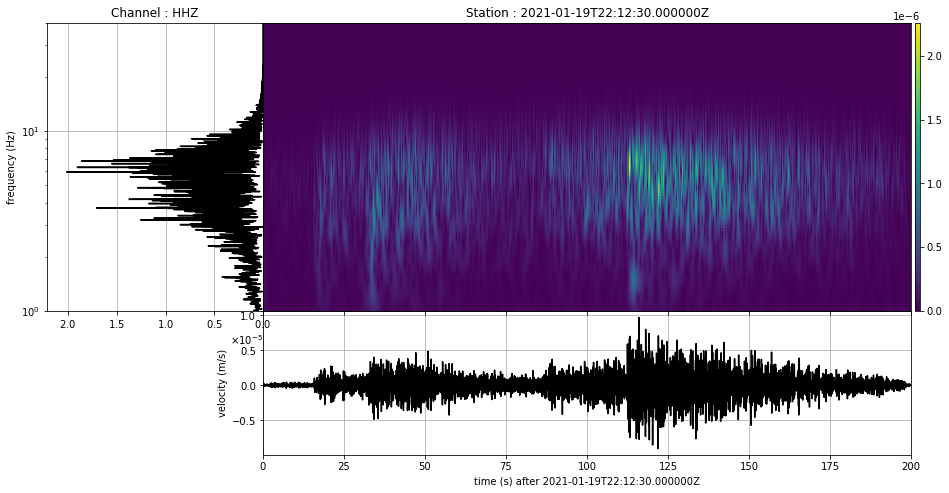

In [55]:
# MEGRA
for i in range(len(megra)):
    mc.plot_tfr(
    megra[i].data, 
    tr=megra[i],
    fmin=1.0,
    fmax=40.0,
    dt=megra[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

### Particle Motion

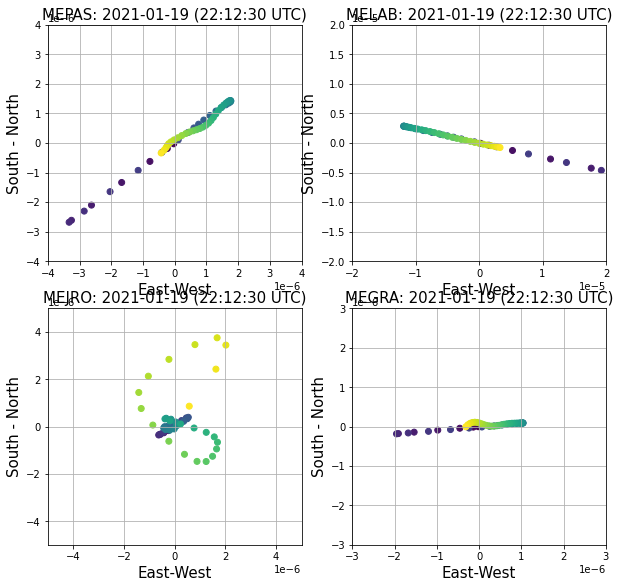

In [78]:
mepas_pm = mepas.copy()
melab_pm = melab.copy()
mejro_pm = mejro.copy()
megra_pm = megra.copy()

st_pm = mepas_pm+melab_pm+mejro_pm+megra_pm

start = st_pm[0].stats.starttime
end_pm = start + 0.5
st_pm = st_pm.trim(starttime=start, endtime=end_pm)

for tr in st_pm.select(channel='HHZ'):
  st_pm.remove(tr)

mepas_pm = st_pm.select(station = 'mepas')
mepas_ctime = np.array(mepas_pm[0].times())
melab_pm = st_pm.select(station = 'melab')
melab_ctime = np.array(melab_pm[0].times())
mejro_pm = st_pm.select(station = 'mejro')
mejro_ctime = np.array(mejro_pm[0].times())
megra_pm = st_pm.select(station = 'megra')
megra_ctime = np.array(megra_pm[0].times())

lim = 0.00002

fig = plt.figure(figsize=(10, 20))
ax=fig.add_subplot(421)
ax.set_title('MEPAS: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax.set_xlabel('East-West', fontsize = 15)
ax.set_ylabel('South - North', fontsize = 15)
ax.set_xlim(-0.000004, 0.000004)
ax.set_ylim(-0.000004, 0.000004)
ax.scatter(mepas_pm[0].data, mepas_pm[1].data, marker='o', c=mepas_ctime)

ax1=fig.add_subplot(422)
ax1.set_title('MELAB: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax1.set_xlabel('East-West', fontsize = 15)
ax1.set_ylabel('South - North', fontsize = 15)
ax1.set_xlim(-lim, lim)
ax1.set_ylim(-lim, lim)
ax1.scatter(melab_pm[0].data, melab_pm[1].data, marker='o', c=melab_ctime)

ax2=fig.add_subplot(423)
ax2.set_title('MEJRO: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax2.set_xlabel('East-West', fontsize = 15)
ax2.set_ylabel('South - North', fontsize = 15)
ax2.set_xlim(-0.000005, 0.000005)
ax2.set_ylim(-0.000005, 0.000005)
ax2.scatter(mejro_pm[0].data, mejro_pm[1].data, marker='o', c=mejro_ctime)

ax3=fig.add_subplot(424)
ax3.set_title('MEGRA: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax3.set_xlabel('East-West', fontsize = 15)
ax3.set_ylabel('South - North', fontsize = 15)
ax3.set_xlim(-0.000003, 0.000003)
ax3.set_ylim(-0.000003, 0.000003)
ax3.scatter(megra_pm[0].data, megra_pm[1].data, marker='o', c=megra_ctime)

ax.grid()
ax1.grid()
ax2.grid()
ax3.grid()

plt.savefig('Particle Motion - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white', transparent=False)
ax = plt.gca


### Beamforming 

In [79]:
mepas_fk = mepas.copy()
melab_fk = melab.copy()
mejro_fk = mejro.copy()
megra_fk = megra.copy()


st_ = mepas_fk+melab_fk+megra_fk
st_fk = st_.copy()
st_fk = st_fk.select(channel='HHZ')

In [80]:
# input parameter
fmin = 1.0
fmax = 12.0
slw = 3.0
sl_s = 1.0
win_len = 3.0
win_frac = 0.5

start = []
for i in range(len(st_fk)):
    start.append(st_fk[i].stats.starttime)
end = []
for i in range(len(st_fk)):
    end.append(st_fk[i].stats.endtime)

t0 = max(start)
t1 = min(end)

st_fk = st_fk.trim(t0, t1)

start = st_fk[0].stats.starttime
end = st_fk[0].stats.endtime

kwargs = dict(
    # slowness grid (x,y) and slow step
    sll_x=-slw, slm_x=slw, sll_y=-slw, slm_y=slw, sl_s=sl_s,
    #sliding window
    win_len=win_len, win_frac=win_frac,
    # frequency for bandpass
    frqlow=fmin, frqhigh=fmax, prewhiten=0,
    # semblance
    semb_thres=-1e9, vel_thres=-1e9,
    stime=start, etime=end, method=0)

out = array_processing(stream=st_fk, **kwargs)
# return = timestamp, realtive relpow, abs relpow, baz, slowness

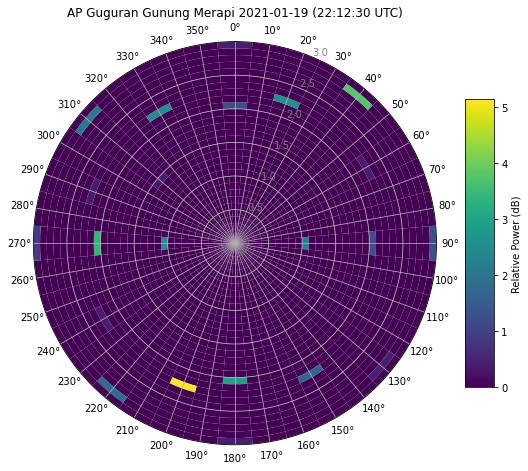

In [81]:
# plotting array

cmap = obspy_sequential
#adjust BAZ into range 0 - 360 degree
t, rel_power, abs_power, baz, slow = out.T
baz[baz<0.0] += 360

df3 = pd.DataFrame({"Time":t, "Backazimuth":baz, "Slowness":slow, 
                    "Relative Power":rel_power
                    
                    })

N=36
N2=30
abins = np.arange(N+1) *360./N
sbins = np.linspace(0, 3, N2+1)

# sum relative power in bins
hist, baz_edges, sl_edges = \
    np.histogram2d(baz, slow, bins=[abins, sbins], weights=rel_power)

# get radians
baz_edges = np.radians(baz_edges)


# polar diagram
fig = plt.figure(figsize=(8,8))
cax = fig.add_axes([0.85, 0.2, 0.05, 0.5])
ax = fig.add_axes([0.10, 0.1, 0.70, 0.70], polar=True)
ax.set_theta_direction(-1)
ax.set_theta_zero_location('N')

dh = abs(sl_edges[1]-sl_edges[0])
dw = abs(baz_edges[1]-baz_edges[0])

for i, row in enumerate(hist):
    bars = ax.bar((i*dw) * np.ones(N2),
                   height=dh*np.ones(N2),
                   width=dw, bottom=dh*np.arange(N2),
                   color=cmap(row/hist.max()))
    
ax.set_xticks(np.linspace(0, 2*np.pi, 36, endpoint=False))
ax.set_title('AP Guguran Gunung Merapi %s' %(start.strftime('%Y-%m-%d (%H:%M:%S UTC)'),))

# slowness limit
ax.set_ylim(0,3)
[i.set_color('grey') for i in ax.get_yticklabels()]
ColorbarBase(cax, cmap=cmap, norm=Normalize(vmin=hist.min(), vmax=hist.max()), label='Relative Power (dB)')

plt.savefig('Polar Plot - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white')
plt.show()

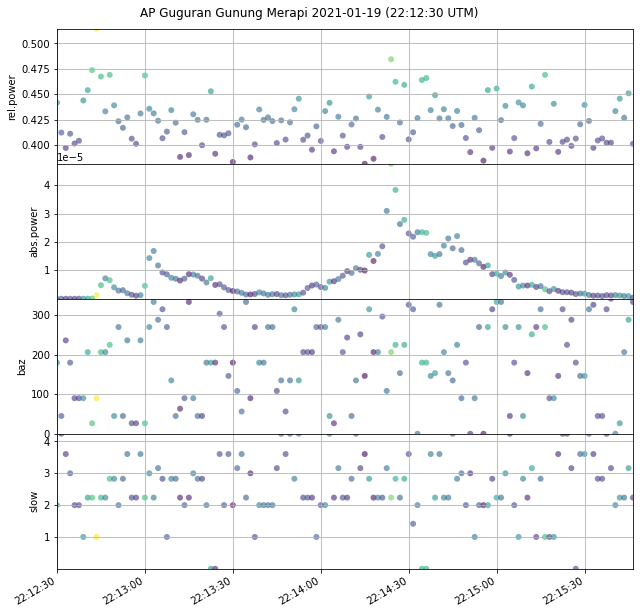

In [60]:
# plot
labels = ['rel.power', 'abs.power', 'baz', 'slow']
xlocator = mdates.AutoDateLocator()
fig = plt.figure(figsize=(10,10))
for i, lab in enumerate(labels):
    ax = fig.add_subplot(4, 1, i + 1)
    ax.scatter(out[:, 0], out[:, i + 1], c=out[:, 1], alpha=0.6,
               edgecolors='none', cmap=obspy_sequential)
    ax.set_ylabel(lab)
    ax.set_xlim(out[0, 0], out[-1, 0])
    ax.set_ylim(out[:, i + 1].min(), out[:, i + 1].max())
    ax.xaxis.set_major_locator(xlocator)
    ax.xaxis.set_major_formatter(mdates.AutoDateFormatter(xlocator))
    ax.grid()

fig.suptitle('AP Guguran Gunung Merapi %s' % (start.strftime('%Y-%m-%d (%H:%M:%S UTC)'), ))
fig.autofmt_xdate()
fig.subplots_adjust(left=0.15, top=0.95, right=0.95, bottom=0.2, hspace=0)
plt.savefig('Plot - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white')
plt.show()

## 3 | (2021-01-19 | 22:34:50) | SW

In [82]:
chID = 'ENZ'
direction = 'SW'
path = 'data/'+direction

st=read(path+"/VG.*"+".D.20*"+".MSEED", type='MSEED')

st = st.sort()


In [83]:
time_s = time2
time_e = time_s + time02
print('duration:', time02)

st0 = st.copy()
st0 = st0.trim(starttime=time_s, endtime=time_e)

duration: 135


### MEPAS

In [84]:
station = 'mepas'
mepas = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

mepas = mepas.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
mepas

3 Trace(s) in Stream:
VG.MEPAS.00.HHE | 2021-01-19T22:34:50.000000Z - 2021-01-19T22:37:05.000000Z | 100.0 Hz, 13501 samples
VG.MEPAS.00.HHN | 2021-01-19T22:34:50.000000Z - 2021-01-19T22:37:05.000000Z | 100.0 Hz, 13501 samples
VG.MEPAS.00.HHZ | 2021-01-19T22:34:50.000000Z - 2021-01-19T22:37:05.000000Z | 100.0 Hz, 13501 samples

In [85]:
for i in range(len(mepas)):
    mepas[i].stats.coordinates = AttribDict({'latitude':-7.535567,
                                             'longitude':110.449185,
                                             'elevation':2679})

### MELAB

In [86]:
station = 'melab'
melab = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

melab = melab.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
melab

3 Trace(s) in Stream:
VG.MELAB.00.HHE | 2021-01-19T22:34:50.000000Z - 2021-01-19T22:37:05.000000Z | 100.0 Hz, 13501 samples
VG.MELAB.00.HHN | 2021-01-19T22:34:50.000000Z - 2021-01-19T22:37:05.000000Z | 100.0 Hz, 13501 samples
VG.MELAB.00.HHZ | 2021-01-19T22:34:50.000000Z - 2021-01-19T22:37:05.000000Z | 100.0 Hz, 13501 samples

In [87]:
for i in range(len(melab)):
    melab[i].stats.coordinates = AttribDict({'latitude':-7.557044,
                                         'longitude':110.445038,
                                         'elevation':1730})

### MEJRO


In [88]:
station = 'mejro'
mejro = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

mejro = mejro.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
mejro

3 Trace(s) in Stream:
VG.MEJRO.00.HHE | 2021-01-19T22:34:50.000000Z - 2021-01-19T22:37:05.000000Z | 100.0 Hz, 13501 samples
VG.MEJRO.00.HHN | 2021-01-19T22:34:50.000000Z - 2021-01-19T22:37:05.000000Z | 100.0 Hz, 13501 samples
VG.MEJRO.00.HHZ | 2021-01-19T22:34:50.000000Z - 2021-01-19T22:37:05.000000Z | 100.0 Hz, 13501 samples

In [89]:
for i in range(len(mejro)):
    mejro[i].stats.coordinates = AttribDict({'latitude':-7.555357,
                                         'longitude':110.419287,
                                         'elevation':1335})

### MEGRA

In [90]:
station = 'megra'
megra = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

megra = megra.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
megra

3 Trace(s) in Stream:
VG.MEGRA.00.HHE | 2021-01-19T22:34:50.000000Z - 2021-01-19T22:37:05.000000Z | 100.0 Hz, 13501 samples
VG.MEGRA.00.HHN | 2021-01-19T22:34:50.000000Z - 2021-01-19T22:37:05.000000Z | 100.0 Hz, 13501 samples
VG.MEGRA.00.HHZ | 2021-01-19T22:34:50.000000Z - 2021-01-19T22:37:05.000000Z | 100.0 Hz, 13501 samples

In [91]:
for i in range(len(megra)):
    megra[i].stats.coordinates = AttribDict({'latitude':-7.52163,
                                         'longitude':110.45149,
                                         'elevation':2045})

### Signal Analysis

#### Spectrogram Before Filter

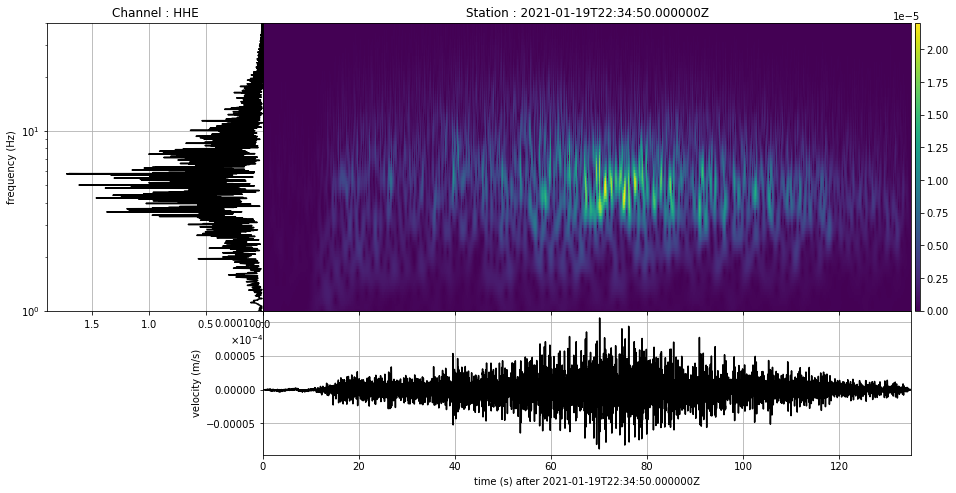

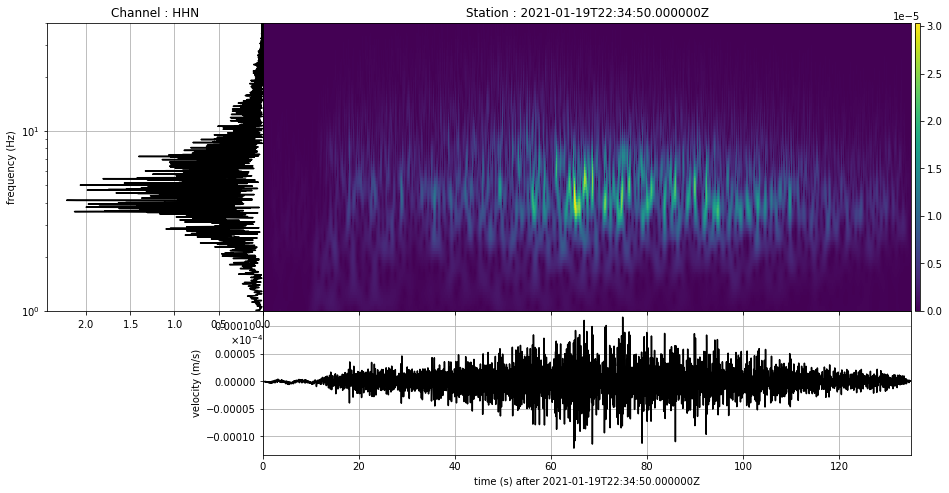

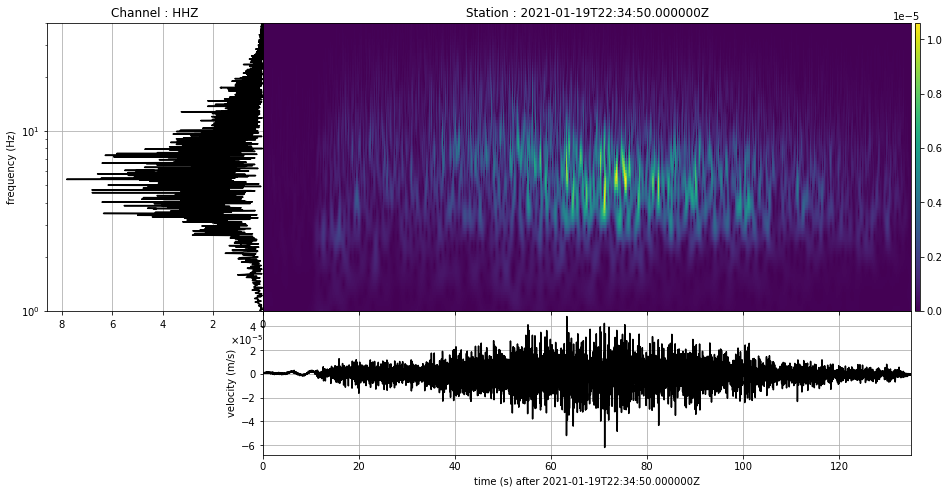

In [132]:
# MEPAS
for i in range(len(mepas)):
    mc.plot_tfr(
    mepas[i].data, 
    tr=mepas[i],
    fmin=1.0,
    fmax=40.0,
    dt=mepas[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

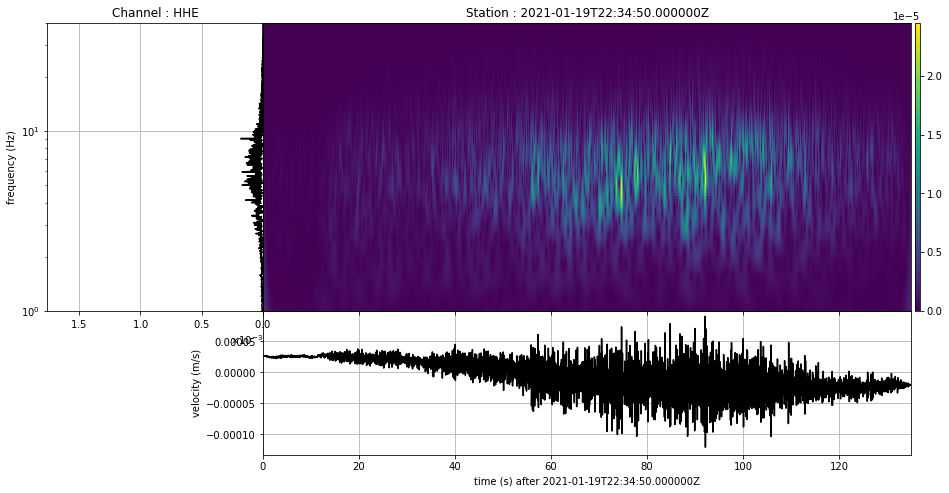

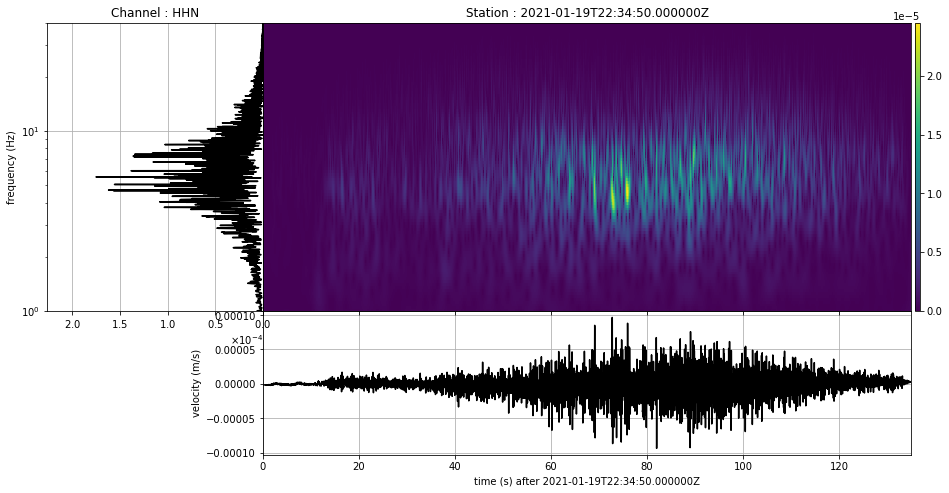

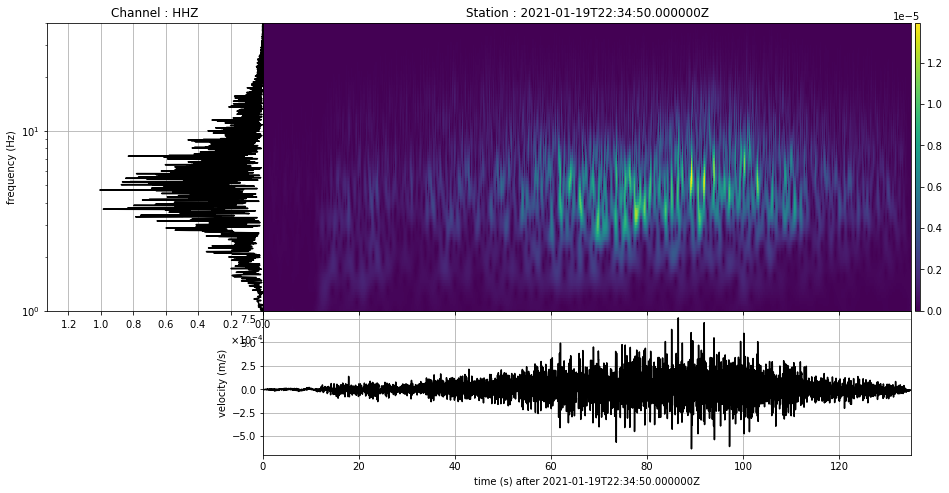

In [ ]:
# MELAB
for i in range(len(melab)):
    mc.plot_tfr(
    melab[i].data, 
    tr=melab[i],
    fmin=1.0,
    fmax=40.0,
    dt=melab[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

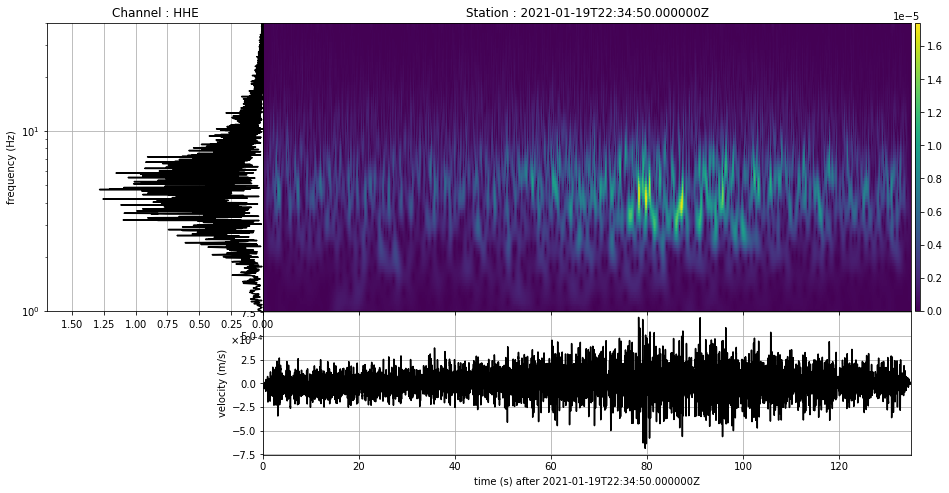

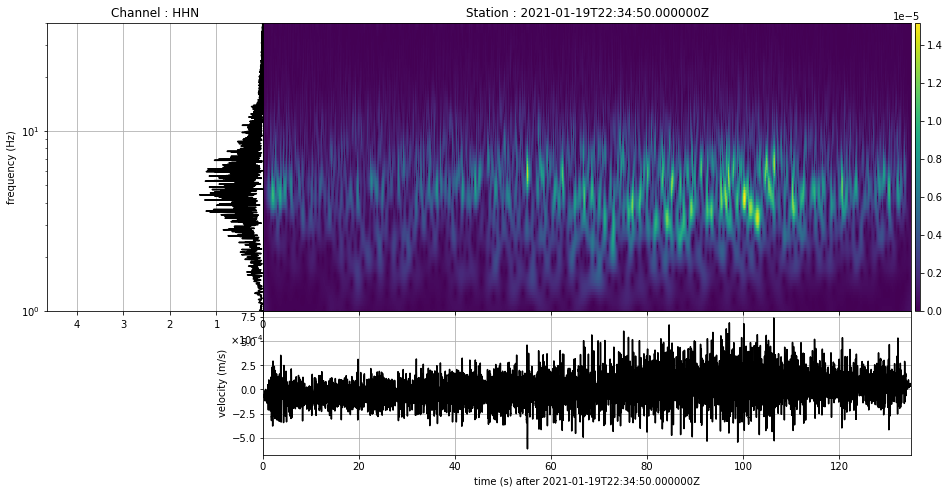

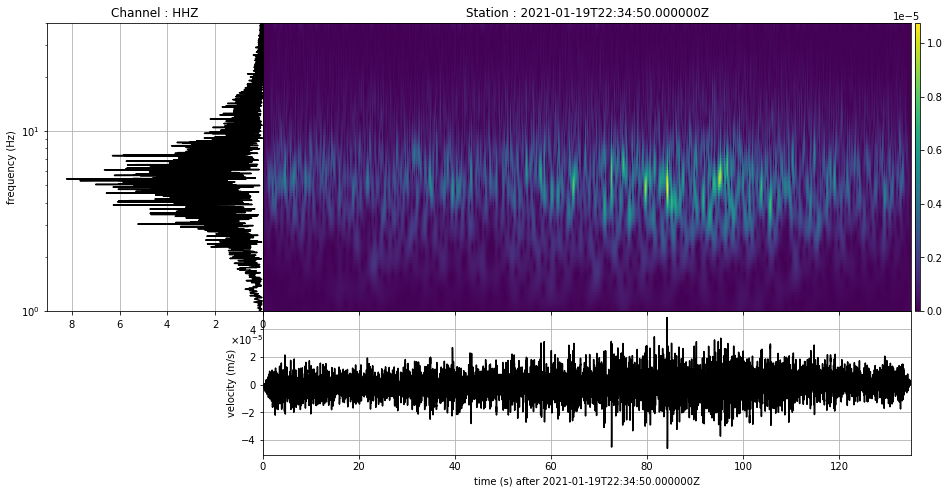

In [ ]:
# MEJRO
for i in range(len(mejro)):
    mc.plot_tfr(
    mejro[i].data, 
    tr=mejro[i],
    fmin=1.0,
    fmax=40.0,
    dt=mejro[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

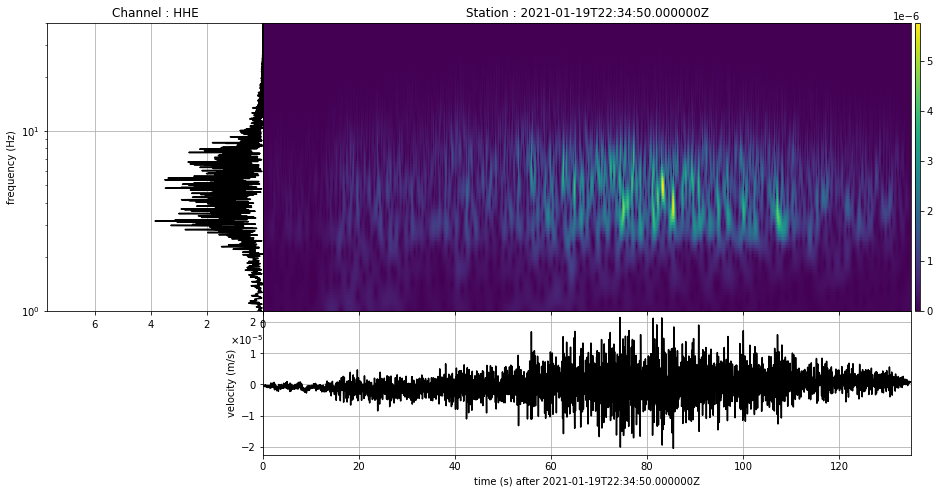

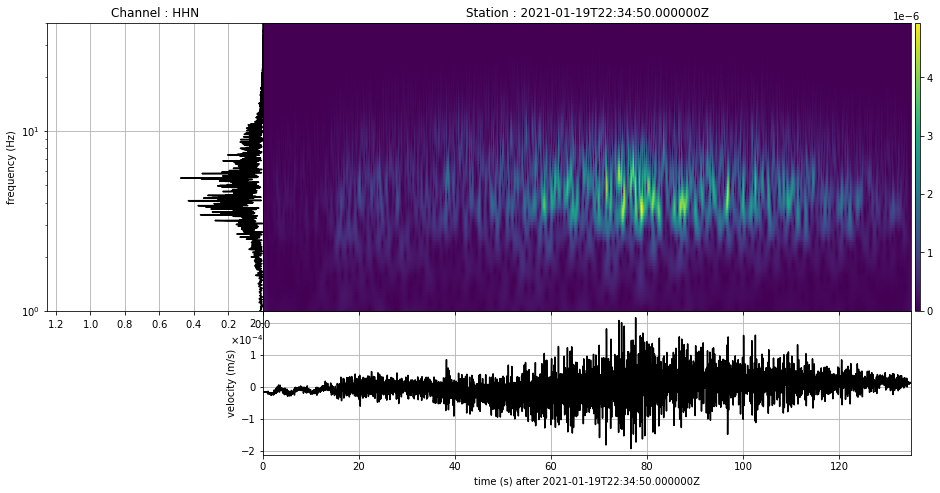

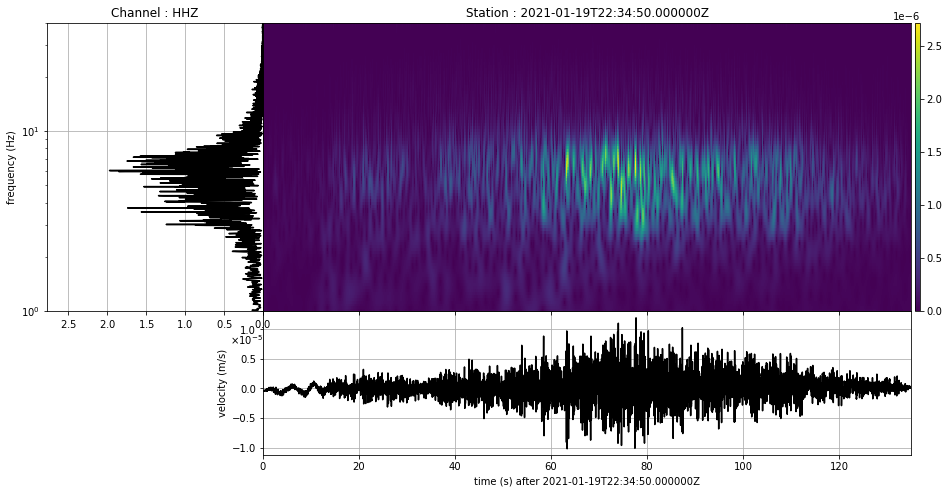

In [ ]:
# MEGRA
for i in range(len(megra)):
    mc.plot_tfr(
    megra[i].data, 
    tr=megra[i],
    fmin=1.0,
    fmax=40.0,
    dt=megra[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

#### Data Filter

In [92]:
mepas = mepas.filter('bandpass', freqmin = 1.0, freqmax=12.0)
melab = melab.filter('bandpass', freqmin = 1.0, freqmax=12.0)
mejro = mejro.filter('bandpass', freqmin = 1.0, freqmax=12.0)
megra = megra.filter('bandpass', freqmin = 1.0, freqmax=12.0)

#### Spectrogram After Filter

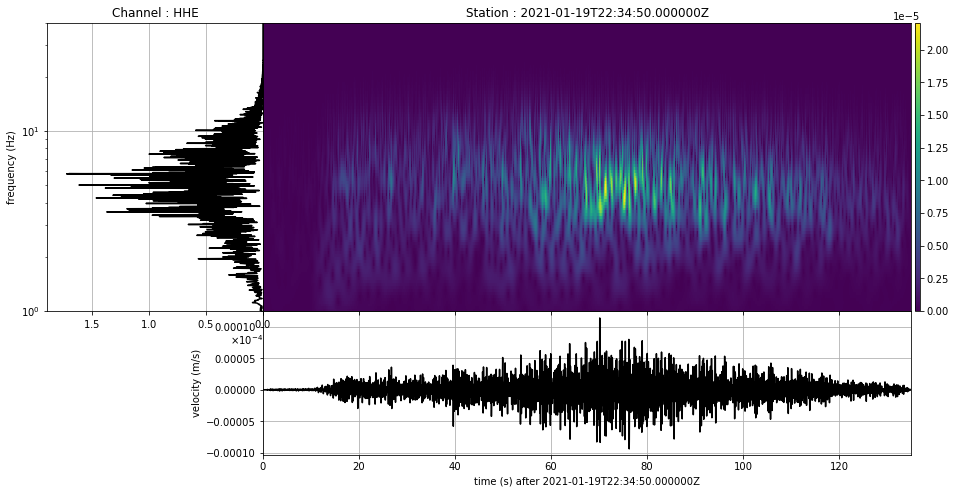

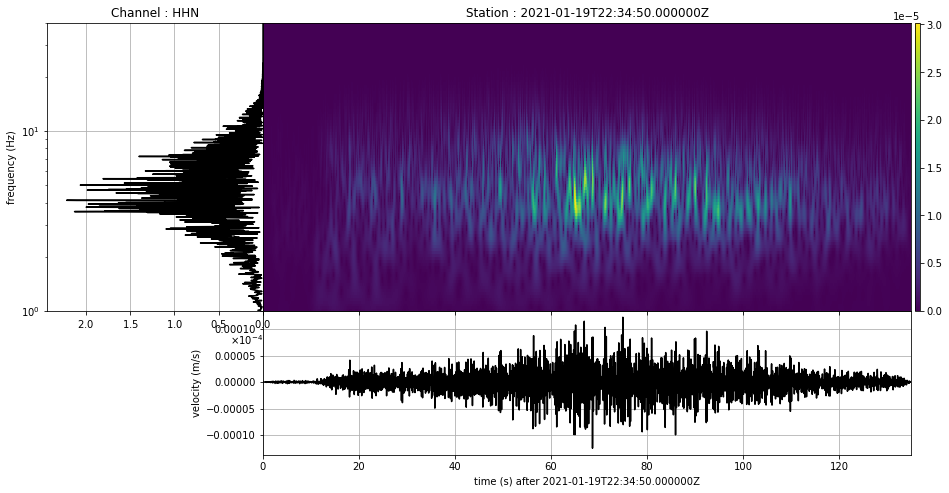

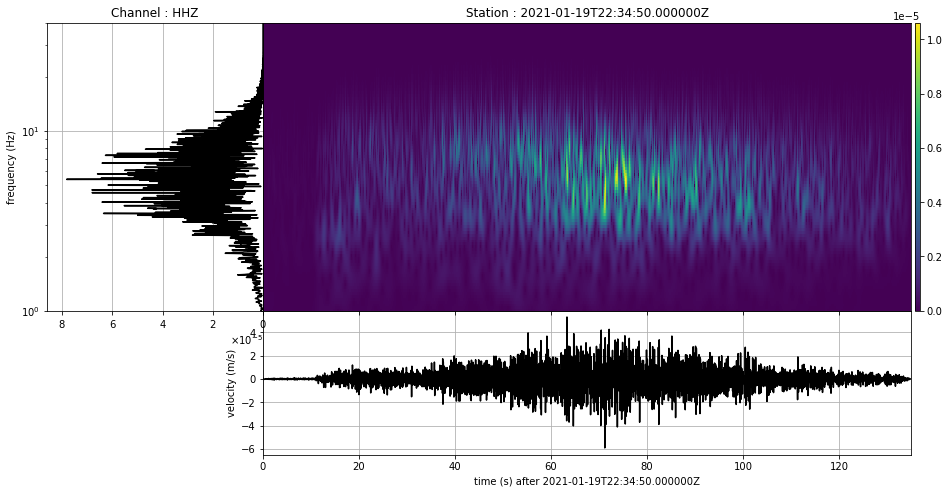

In [ ]:
# MEPAS
for i in range(len(mepas)):
    mc.plot_tfr(
    mepas[i].data, 
    tr=mepas[i],
    fmin=1.0,
    fmax=40.0,
    dt=mepas[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

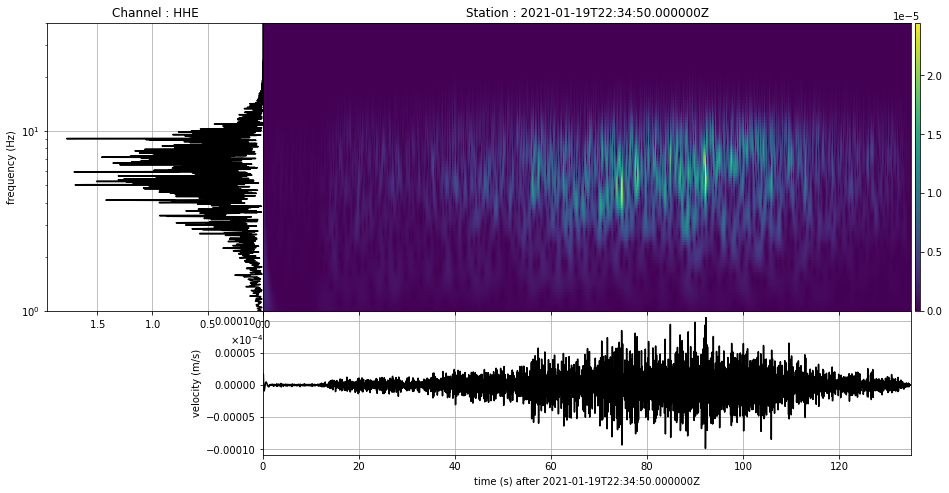

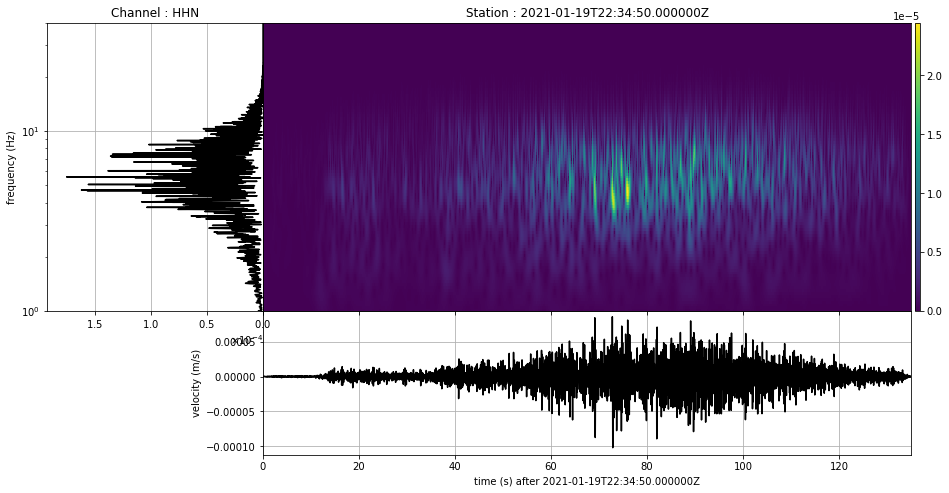

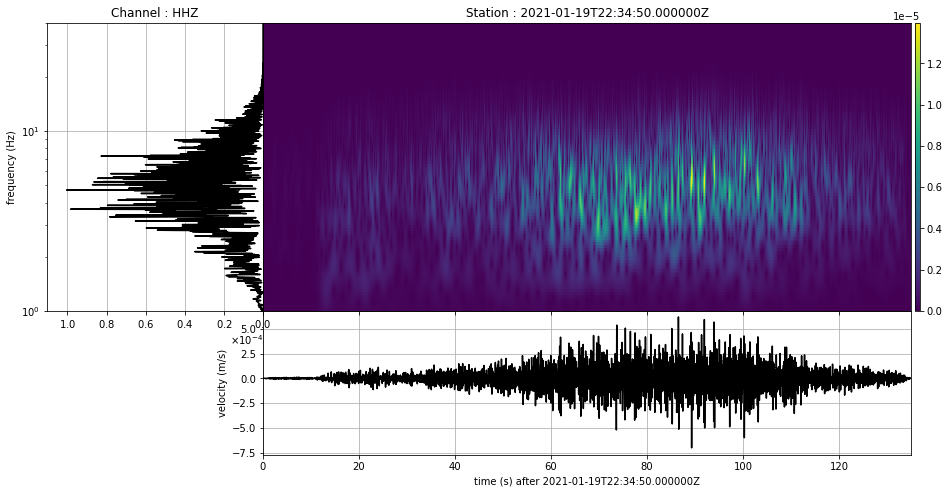

In [ ]:
# MELAB
for i in range(len(melab)):
    mc.plot_tfr(
    melab[i].data, 
    tr=melab[i],
    fmin=1.0,
    fmax=40.0,
    dt=melab[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

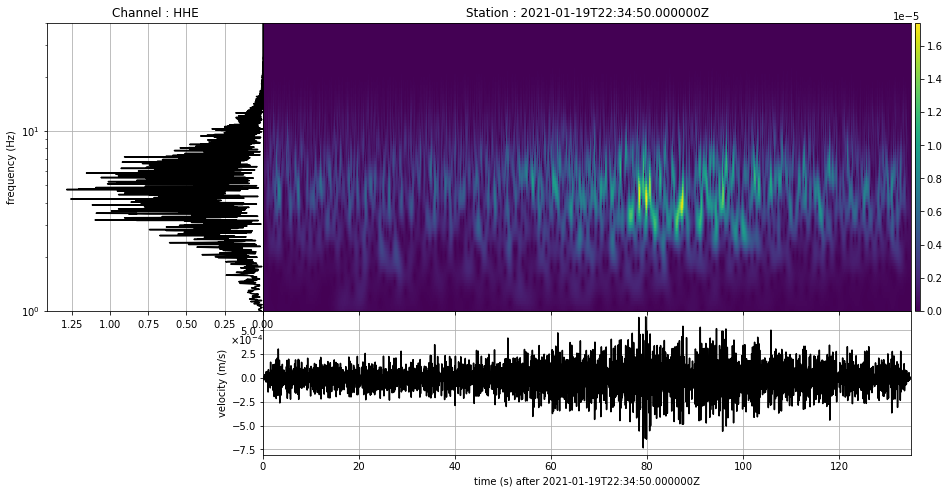

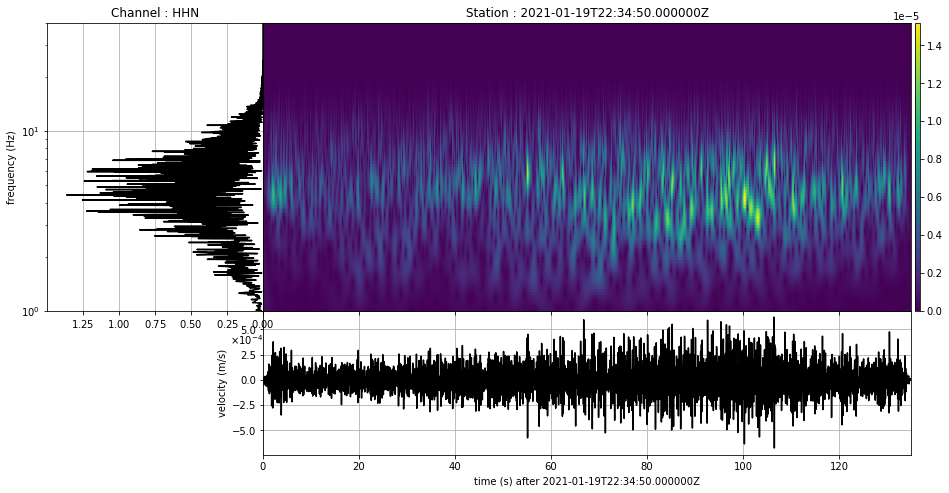

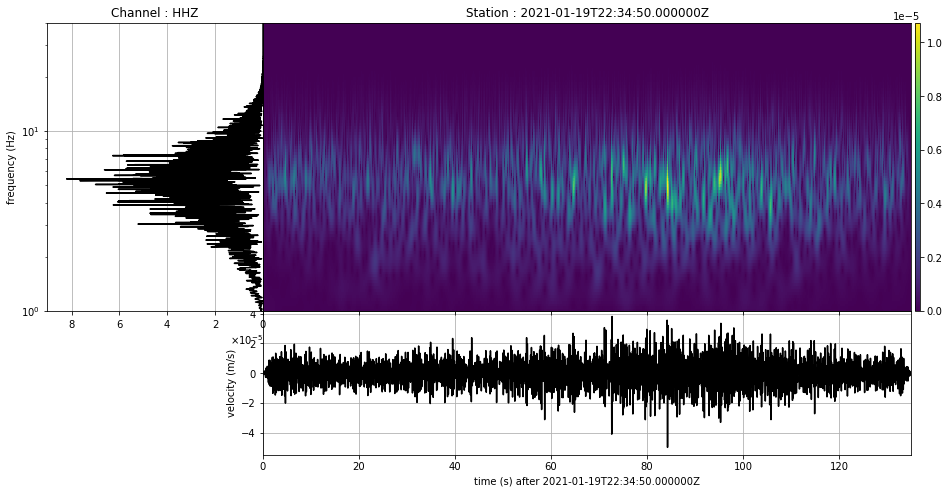

In [ ]:
# MEJRO
for i in range(len(mejro)):
    mc.plot_tfr(
    mejro[i].data, 
    tr=mejro[i],
    fmin=1.0,
    fmax=40.0,
    dt=mejro[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

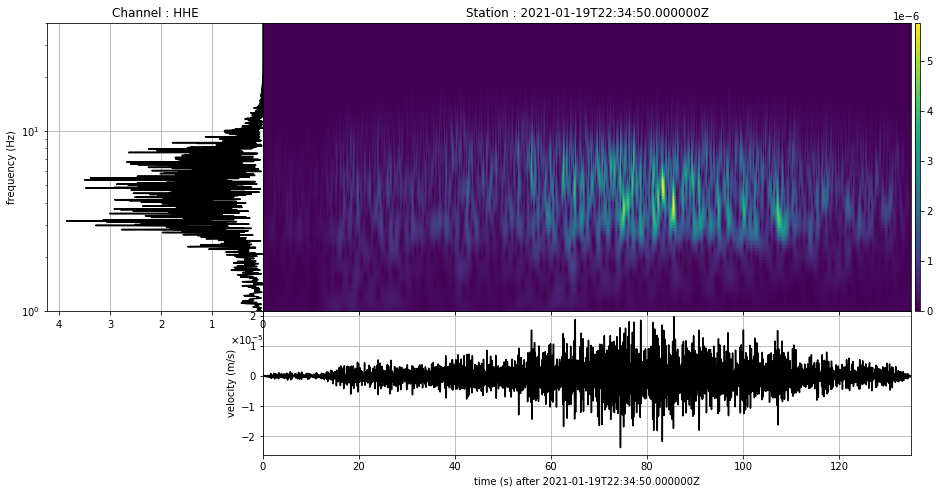

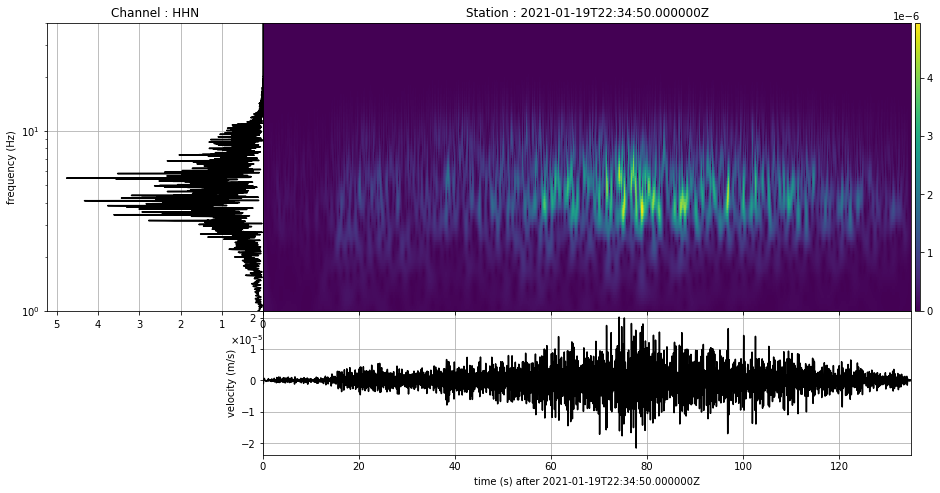

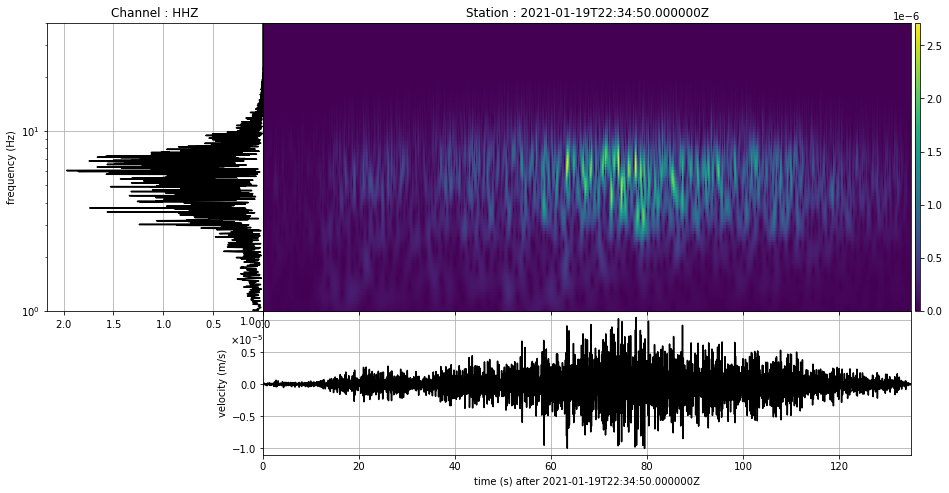

In [ ]:
# MEGRA
for i in range(len(megra)):
    mc.plot_tfr(
    megra[i].data, 
    tr=megra[i],
    fmin=1.0,
    fmax=40.0,
    dt=megra[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

### Particle Motion

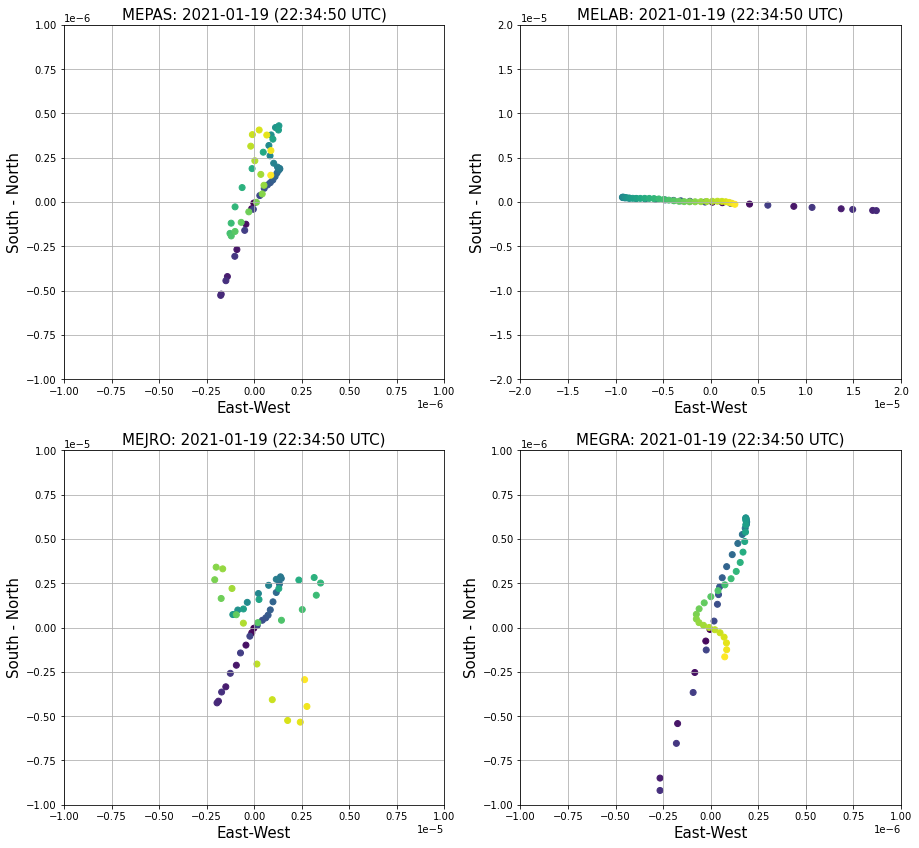

In [93]:
mepas_pm = mepas.copy()
melab_pm = melab.copy()
mejro_pm = mejro.copy()
megra_pm = megra.copy()

st_pm = mepas_pm+melab_pm+mejro_pm+megra_pm

start = st_pm[0].stats.starttime
end_pm = start + 0.5
st_pm = st_pm.trim(starttime=start, endtime=end_pm)

for tr in st_pm.select(channel='HHZ'):
  st_pm.remove(tr)

mepas_pm = st_pm.select(station = 'mepas')
mepas_ctime = np.array(mepas_pm[0].times())
melab_pm = st_pm.select(station = 'melab')
melab_ctime = np.array(melab_pm[0].times())
mejro_pm = st_pm.select(station = 'mejro')
mejro_ctime = np.array(mejro_pm[0].times())
megra_pm = st_pm.select(station = 'megra')
megra_ctime = np.array(megra_pm[0].times())

lim = 0.000001

fig = plt.figure(figsize=(15, 30))
ax=fig.add_subplot(421)
ax.set_title('MEPAS: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax.set_xlabel('East-West', fontsize = 15)
ax.set_ylabel('South - North', fontsize = 15)
ax.set_xlim(-lim, lim)
ax.set_ylim(-lim, lim)
ax.scatter(mepas_pm[0].data, mepas_pm[1].data, marker='o', c=mepas_ctime)

ax1=fig.add_subplot(422)
ax1.set_title('MELAB: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax1.set_xlabel('East-West', fontsize = 15)
ax1.set_ylabel('South - North', fontsize = 15)
ax1.set_xlim(-0.00002, 0.00002)
ax1.set_ylim(-0.00002, 0.00002)
ax1.scatter(melab_pm[0].data, melab_pm[1].data, marker='o', c=melab_ctime)

ax2=fig.add_subplot(423)
ax2.set_title('MEJRO: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax2.set_xlabel('East-West', fontsize = 15)
ax2.set_ylabel('South - North', fontsize = 15)
ax2.set_xlim(-0.00001, 0.00001)
ax2.set_ylim(-0.00001, 0.00001)
ax2.scatter(mejro_pm[0].data, mejro_pm[1].data, marker='o', c=mejro_ctime)

ax3=fig.add_subplot(424)
ax3.set_title('MEGRA: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax3.set_xlabel('East-West', fontsize = 15)
ax3.set_ylabel('South - North', fontsize = 15)
ax3.set_xlim(-lim, lim)
ax3.set_ylim(-lim, lim)
ax3.scatter(megra_pm[0].data, megra_pm[1].data, marker='o', c=megra_ctime)

ax.grid()
ax1.grid()
ax2.grid()
ax3.grid()

plt.savefig('Particle Motion - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white', transparent=False)
ax = plt.gca


### Beamforming 

In [94]:
mepas_fk = mepas.copy()
melab_fk = melab.copy()
mejro_fk = mejro.copy()
megra_fk = megra.copy()


st_ = mepas_fk+melab_fk+megra_fk
st_fk = st_.copy()
st_fk = st_fk.select(channel='HHZ')

In [95]:
fmin = 1.0
fmax = 12.0
slw = 3.0
sl_s = 1.0
win_len = 3.0
win_frac = 0.5

start = []
for i in range(len(st_fk)):
    start.append(st_fk[i].stats.starttime)
end = []
for i in range(len(st_fk)):
    end.append(st_fk[i].stats.endtime)

t0 = max(start)
t1 = min(end)

st_fk = st_fk.trim(t0, t1)

start = st_fk[0].stats.starttime
end = st_fk[0].stats.endtime

kwargs = dict(
    # slowness grid (x,y) and slow step
    sll_x=-slw, slm_x=slw, sll_y=-slw, slm_y=slw, sl_s=sl_s,
    #sliding window
    win_len=win_len, win_frac=win_frac,
    # frequency for bandpass
    frqlow=fmin, frqhigh=fmax, prewhiten=0,
    # semblance
    semb_thres=-1e9, vel_thres=-1e9,
    stime=start, etime=end, method=0)

out = array_processing(stream=st_fk, **kwargs)


# return = timestamp, realtive relpow, abs relpow, baz, slowness

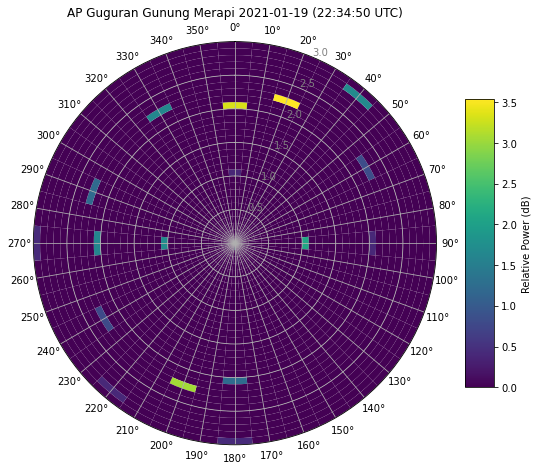

In [96]:
# plotting array

cmap = obspy_sequential
#adjust BAZ into range 0 - 360 degree
t, rel_power, abs_power, baz, slow = out.T
baz[baz<0.0] += 360

df3 = pd.DataFrame({"Time":t, "Backazimuth":baz, "Slowness":slow, 
                    "Relative Power":rel_power
                    
                    })

N=36
N2=30
abins = np.arange(N+1) *360./N
sbins = np.linspace(0, 3, N2+1)

# sum relative power in bins
hist, baz_edges, sl_edges = \
    np.histogram2d(baz, slow, bins=[abins, sbins], weights=rel_power)

# get radians
baz_edges = np.radians(baz_edges)


# polar diagram
fig = plt.figure(figsize=(8,8))
cax = fig.add_axes([0.85, 0.2, 0.05, 0.5])
ax = fig.add_axes([0.10, 0.1, 0.70, 0.70], polar=True)
ax.set_theta_direction(-1)
ax.set_theta_zero_location('N')

dh = abs(sl_edges[1]-sl_edges[0])
dw = abs(baz_edges[1]-baz_edges[0])

for i, row in enumerate(hist):
    bars = ax.bar((i*dw) * np.ones(N2),
                   height=dh*np.ones(N2),
                   width=dw, bottom=dh*np.arange(N2),
                   color=cmap(row/hist.max()))
    
ax.set_xticks(np.linspace(0, 2*np.pi, 36, endpoint=False))
ax.set_title('AP Guguran Gunung Merapi %s' %(start.strftime('%Y-%m-%d (%H:%M:%S UTC)'),))

# slowness limit
ax.set_ylim(0,3)
[i.set_color('grey') for i in ax.get_yticklabels()]
ColorbarBase(cax, cmap=cmap, norm=Normalize(vmin=hist.min(), vmax=hist.max()), label='Relative Power (dB)')

plt.savefig('Polar Plot - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white')
plt.show()

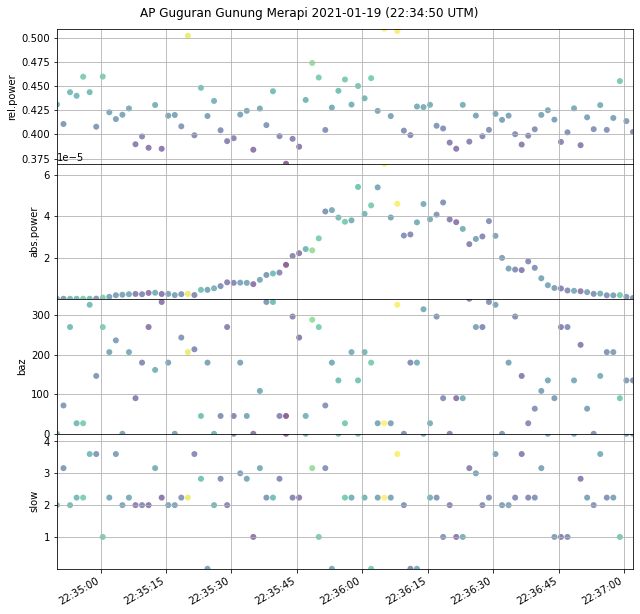

In [156]:
# plot
labels = ['rel.power', 'abs.power', 'baz', 'slow']
xlocator = mdates.AutoDateLocator()
fig = plt.figure(figsize=(10,10))
for i, lab in enumerate(labels):
    ax = fig.add_subplot(4, 1, i + 1)
    ax.scatter(out[:, 0], out[:, i + 1], c=out[:, 1], alpha=0.6,
               edgecolors='none', cmap=obspy_sequential)
    ax.set_ylabel(lab)
    ax.set_xlim(out[0, 0], out[-1, 0])
    ax.set_ylim(out[:, i + 1].min(), out[:, i + 1].max())
    ax.xaxis.set_major_locator(xlocator)
    ax.xaxis.set_major_formatter(mdates.AutoDateFormatter(xlocator))
    ax.grid()

fig.suptitle('AP Guguran Gunung Merapi %s' % (start.strftime('%Y-%m-%d (%H:%M:%S UTC)'), ))
fig.autofmt_xdate()
fig.subplots_adjust(left=0.15, top=0.95, right=0.95, bottom=0.2, hspace=0)

plt.savefig('Plot - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white')
plt.show()

## 4 | (2021-01-07| | 01:02:25) | SW

In [97]:
direction = 'SW'
event = '2021-01-07(01.02.25)'
data_type = 'MSEED'
path = 'data/'+direction+'/'+event

st = read(path+'.'+data_type)
st = st.sort()
st0 = st.copy()

### MEPAS

In [98]:
station = 'mepas'
mepas = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

mepas = mepas.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
mepas

3 Trace(s) in Stream:
VG.MEPAS.00.HHE | 2021-01-07T01:02:24.060000Z - 2021-01-07T01:05:21.560000Z | 100.0 Hz, 17751 samples
VG.MEPAS.00.HHN | 2021-01-07T01:02:24.210000Z - 2021-01-07T01:05:23.070000Z | 100.0 Hz, 17887 samples
VG.MEPAS.00.HHZ | 2021-01-07T01:02:25.490000Z - 2021-01-07T01:05:21.160000Z | 100.0 Hz, 17568 samples

In [99]:
for i in range(len(mepas)):
    mepas[i].stats.coordinates = AttribDict({'latitude':-7.535567,
                                             'longitude':110.449185,
                                             'elevation':2679})

### MELAB

In [100]:
station = 'melab'
melab = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

melab = melab.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
melab

3 Trace(s) in Stream:
VG.MELAB.00.HHE | 2021-01-07T01:02:26.540000Z - 2021-01-07T01:05:21.250000Z | 100.0 Hz, 17472 samples
VG.MELAB.00.HHN | 2021-01-07T01:02:26.380000Z - 2021-01-07T01:05:22.930000Z | 100.0 Hz, 17656 samples
VG.MELAB.00.HHZ | 2021-01-07T01:02:23.600000Z - 2021-01-07T01:05:23.060000Z | 100.0 Hz, 17947 samples

In [101]:
for i in range(len(melab)):
    melab[i].stats.coordinates = AttribDict({'latitude':-7.557044,
                                         'longitude':110.445038,
                                         'elevation':1730})

### MEJRO


In [102]:
station = 'mejro'
mejro = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

mejro = mejro.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
mejro

3 Trace(s) in Stream:
VG.MEJRO.00.HHE | 2021-01-07T01:02:24.940000Z - 2021-01-07T01:05:22.670000Z | 100.0 Hz, 17774 samples
VG.MEJRO.00.HHN | 2021-01-07T01:02:26.520000Z - 2021-01-07T01:05:22.030000Z | 100.0 Hz, 17552 samples
VG.MEJRO.00.HHZ | 2021-01-07T01:02:26.350000Z - 2021-01-07T01:05:21.450000Z | 100.0 Hz, 17511 samples

In [103]:
for i in range(len(mejro)):
    mejro[i].stats.coordinates = AttribDict({'latitude':-7.555357,
                                         'longitude':110.419287,
                                         'elevation':1335})

### MEGRA

In [104]:
station = 'megra'
megra = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

megra = megra.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
megra

3 Trace(s) in Stream:
VG.MEGRA.00.HHE | 2021-01-07T01:02:26.290000Z - 2021-01-07T01:05:22.550000Z | 100.0 Hz, 17627 samples
VG.MEGRA.00.HHN | 2021-01-07T01:02:24.320000Z - 2021-01-07T01:05:21.890000Z | 100.0 Hz, 17758 samples
VG.MEGRA.00.HHZ | 2021-01-07T01:02:23.710000Z - 2021-01-07T01:05:22.730000Z | 100.0 Hz, 17903 samples

In [105]:
for i in range(len(megra)):
    megra[i].stats.coordinates = AttribDict({'latitude':-7.52163,
                                         'longitude':110.45149,
                                         'elevation':2045})

### Signal Analysis

#### Spectrogram Before Filter

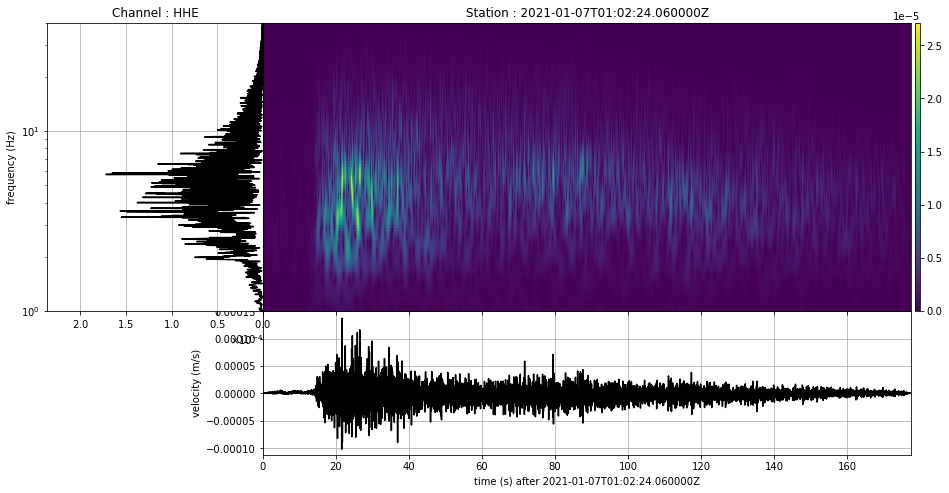

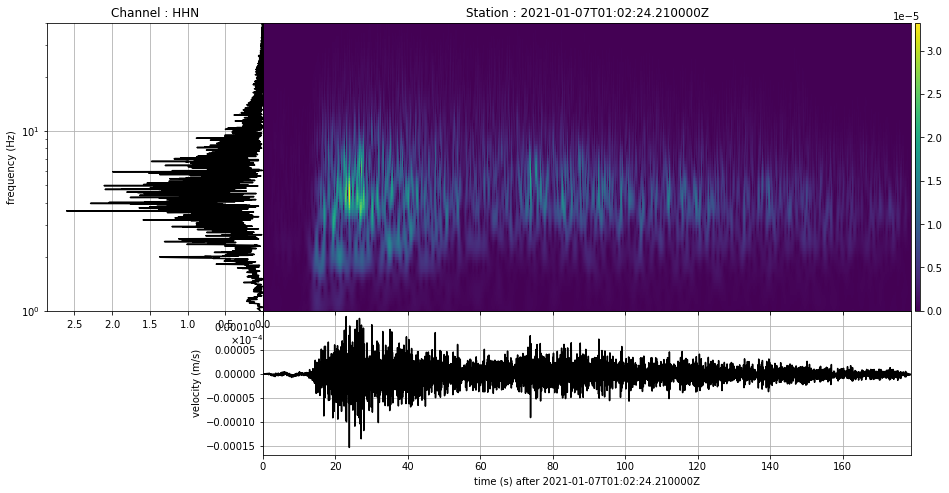

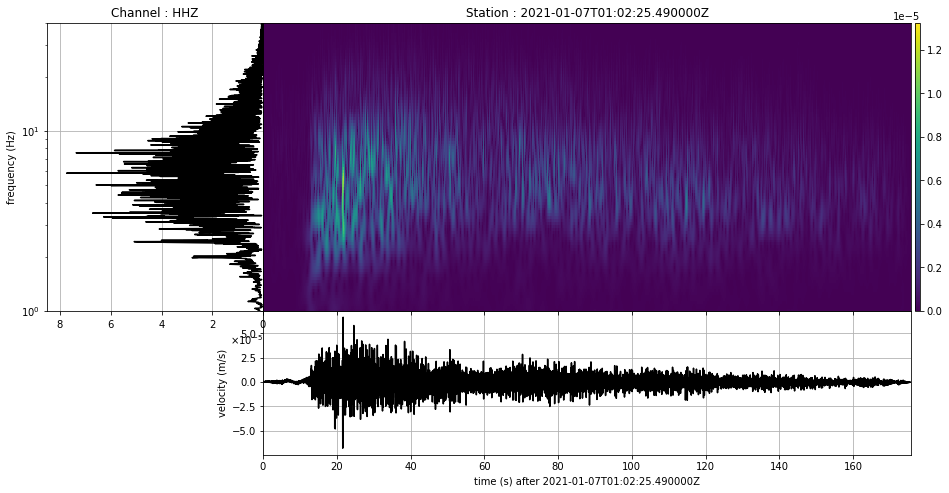

In [166]:
# MEPAS
for i in range(len(mepas)):
    mc.plot_tfr(
    mepas[i].data, 
    tr=mepas[i],
    fmin=1.0,
    fmax=40.0,
    dt=mepas[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

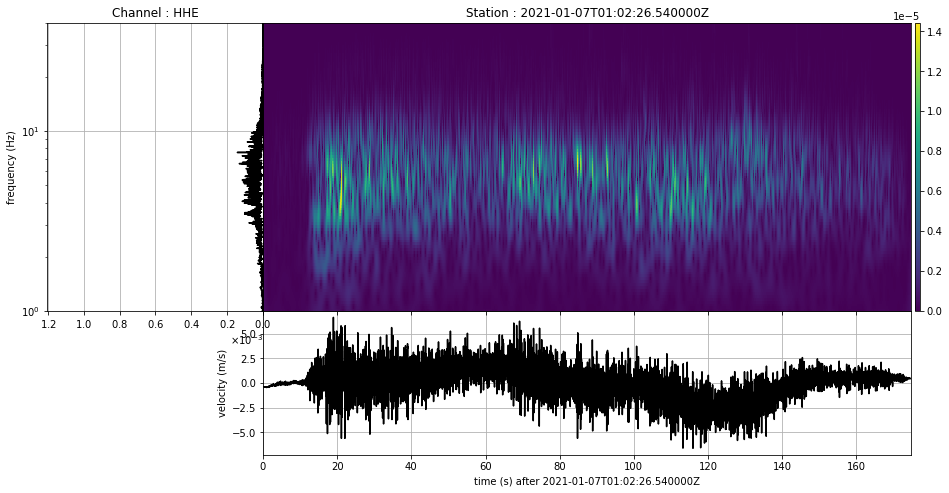

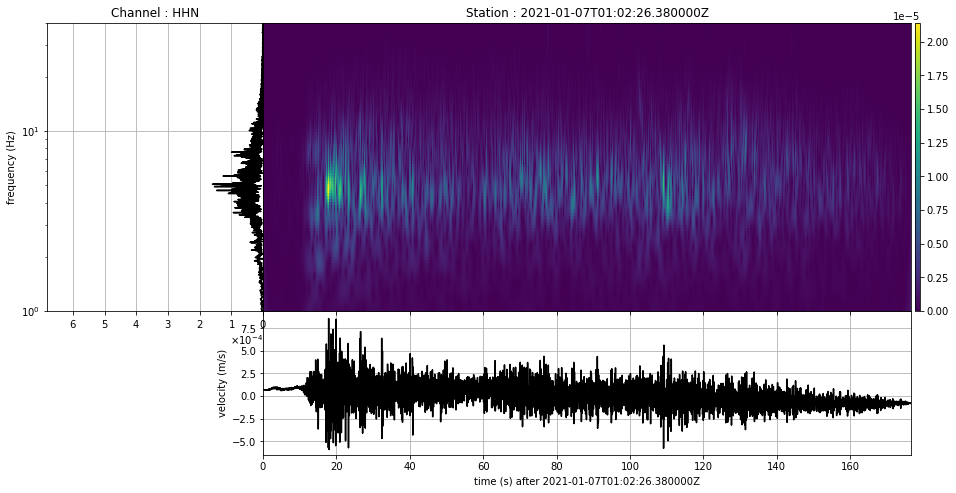

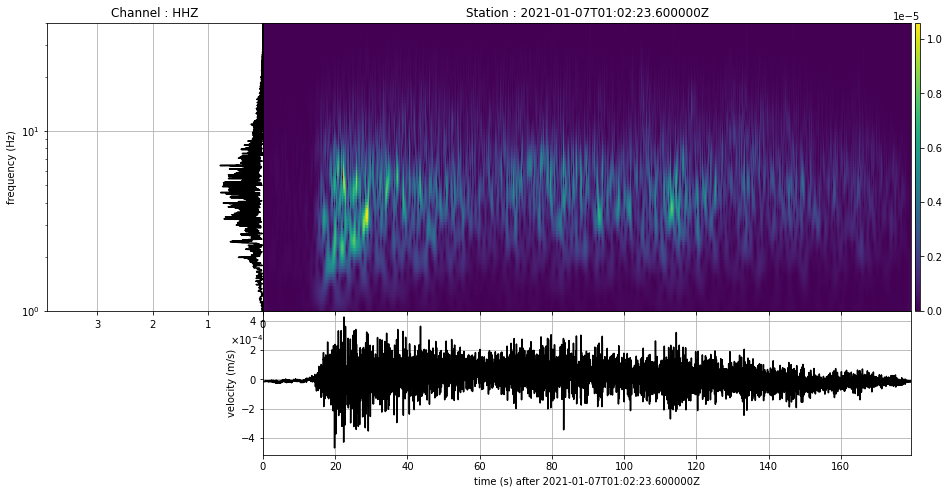

In [167]:
# MELAB
for i in range(len(melab)):
    mc.plot_tfr(
    melab[i].data, 
    tr=melab[i],
    fmin=1.0,
    fmax=40.0,
    dt=melab[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

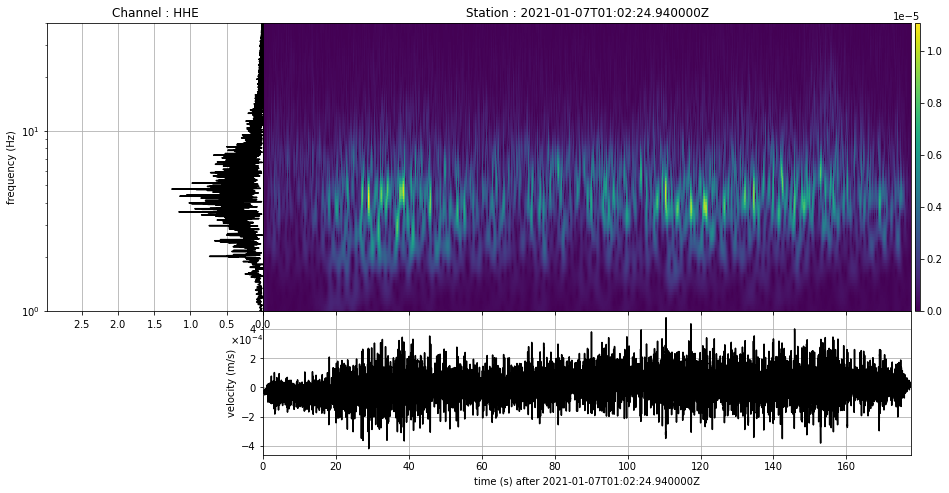

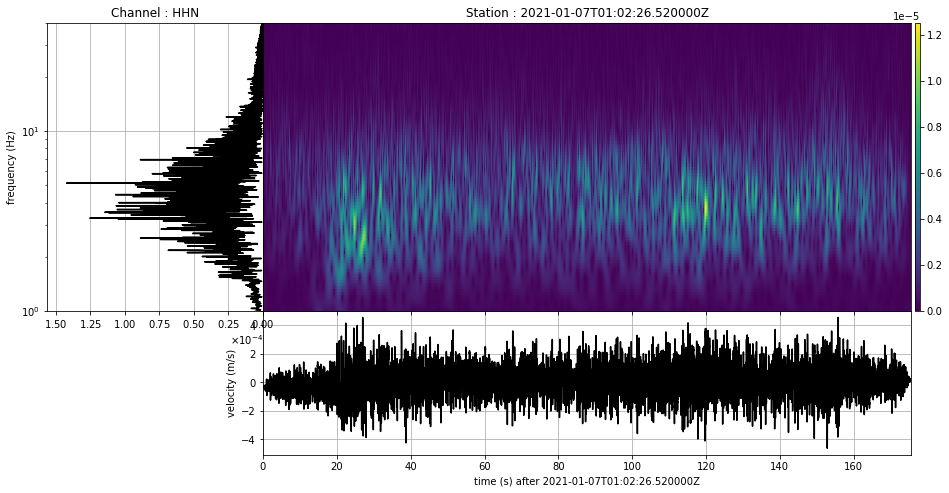

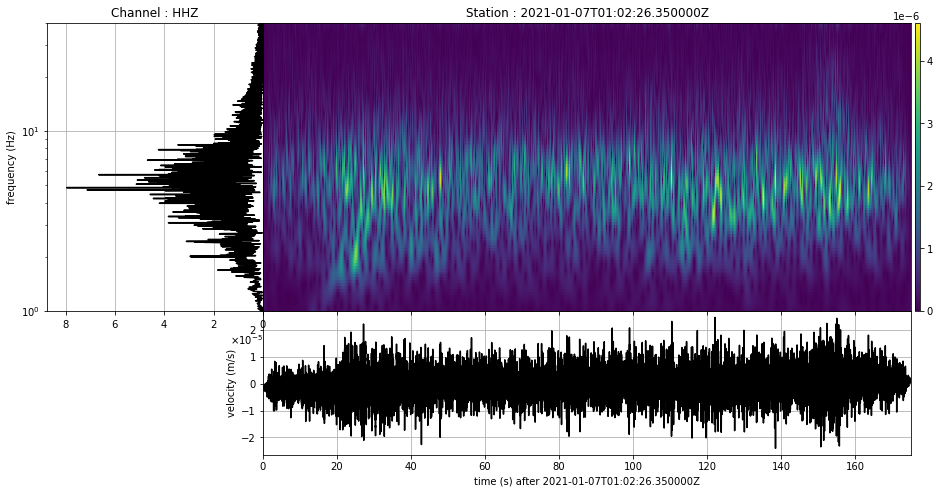

In [168]:
# MEJRO
for i in range(len(mejro)):
    mc.plot_tfr(
    mejro[i].data, 
    tr=mejro[i],
    fmin=1.0,
    fmax=40.0,
    dt=mejro[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

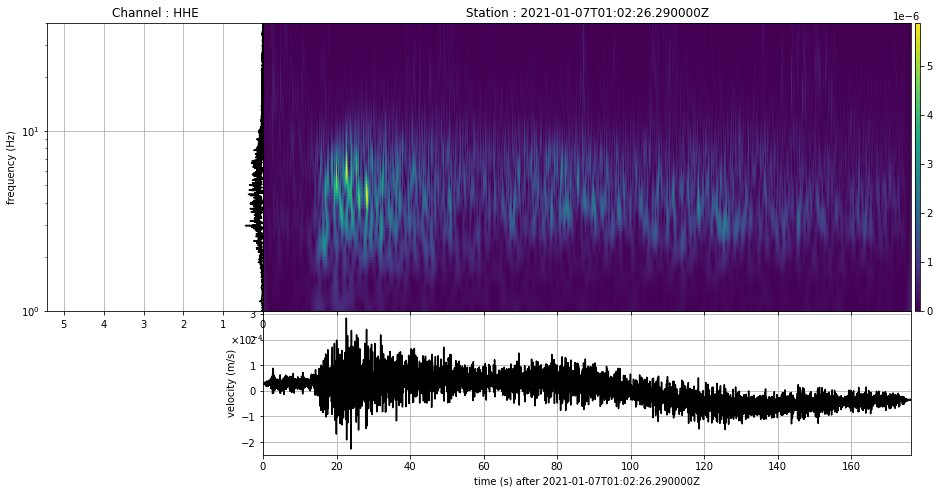

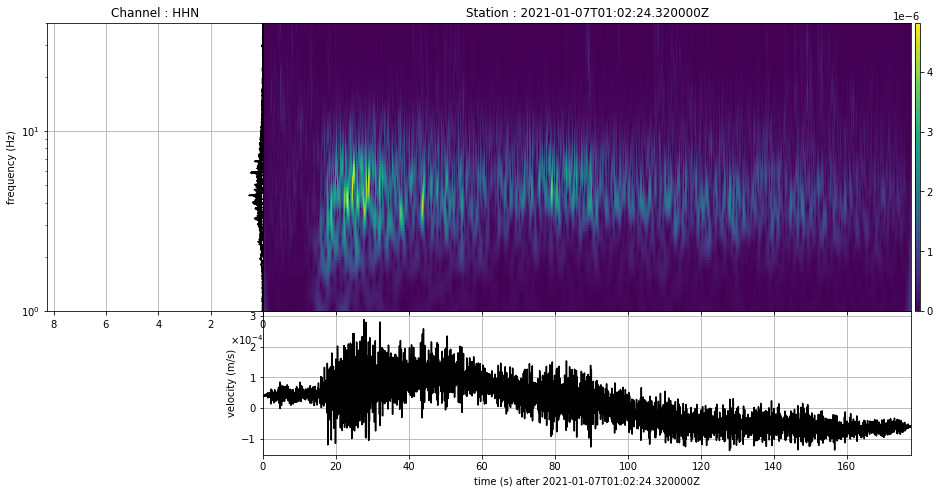

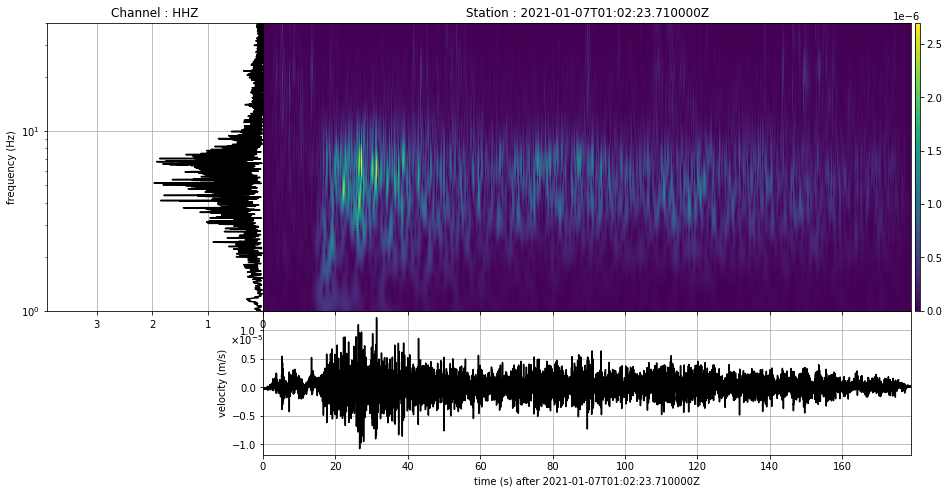

In [170]:
# MEGRA
for i in range(len(megra)):
    mc.plot_tfr(
    megra[i].data, 
    tr=megra[i],
    fmin=1.0,
    fmax=40.0,
    dt=megra[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

#### Data Filter

In [106]:
mepas = mepas.filter('bandpass', freqmin = 1.0, freqmax=12.0)
melab = melab.filter('bandpass', freqmin = 1.0, freqmax=12.0)
mejro = mejro.filter('bandpass', freqmin = 1.0, freqmax=12.0)
megra = megra.filter('bandpass', freqmin = 1.0, freqmax=12.0)

#### Spectrogram After Filter

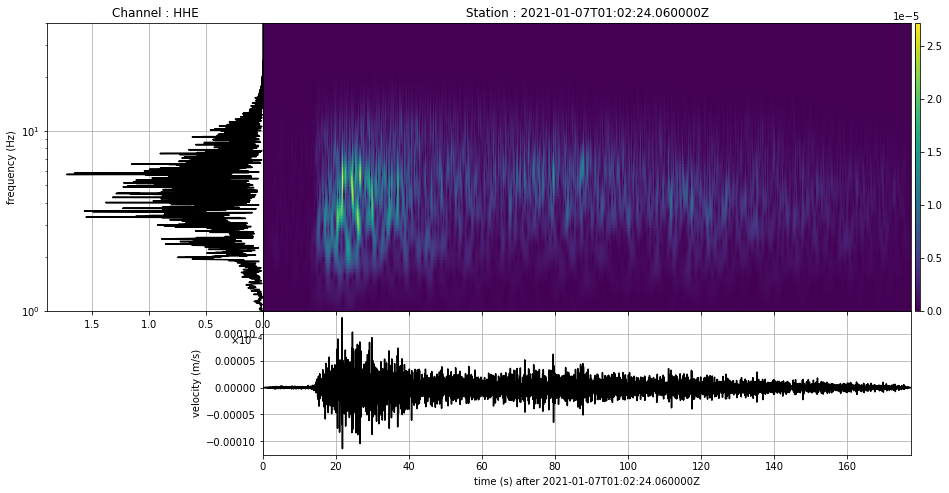

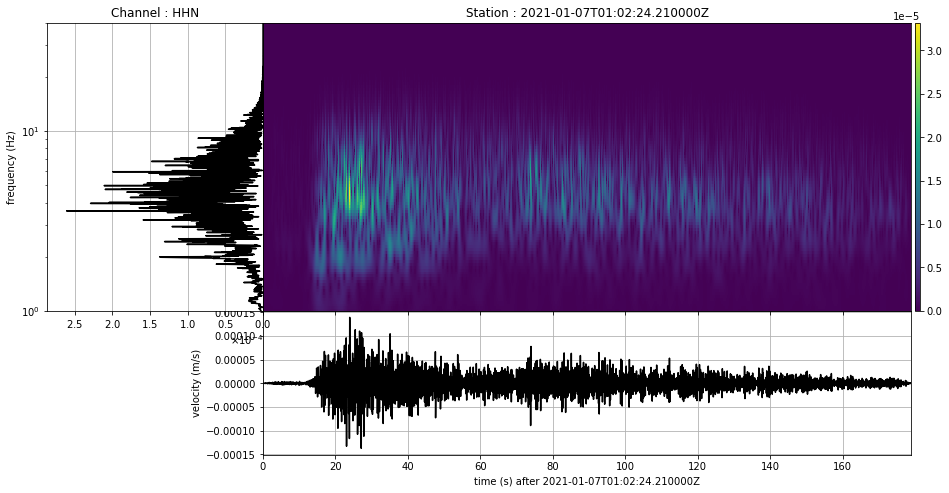

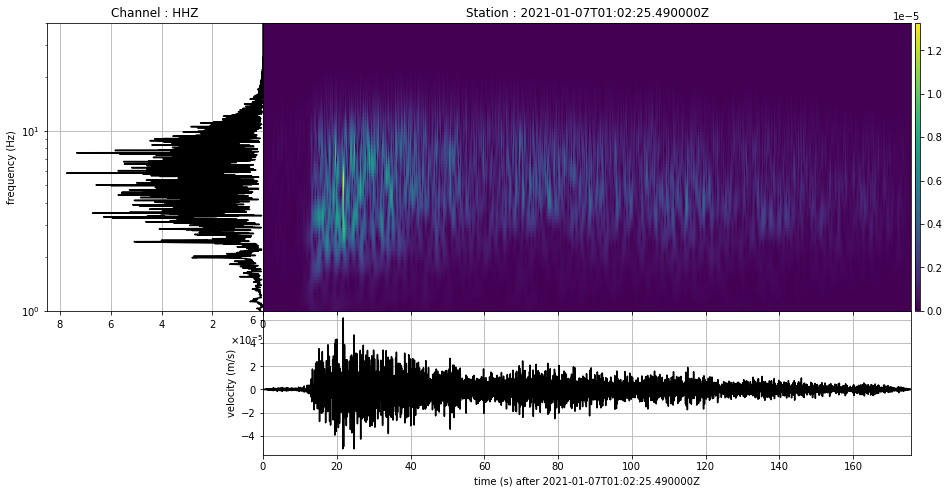

In [ ]:
# MEPAS
for i in range(len(mepas)):
    mc.plot_tfr(
    mepas[i].data, 
    tr=mepas[i],
    fmin=1.0,
    fmax=40.0,
    dt=mepas[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

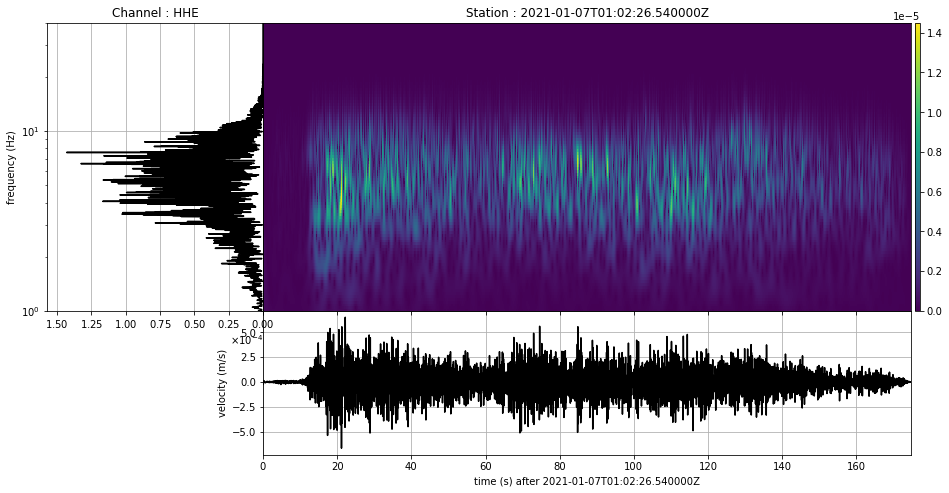

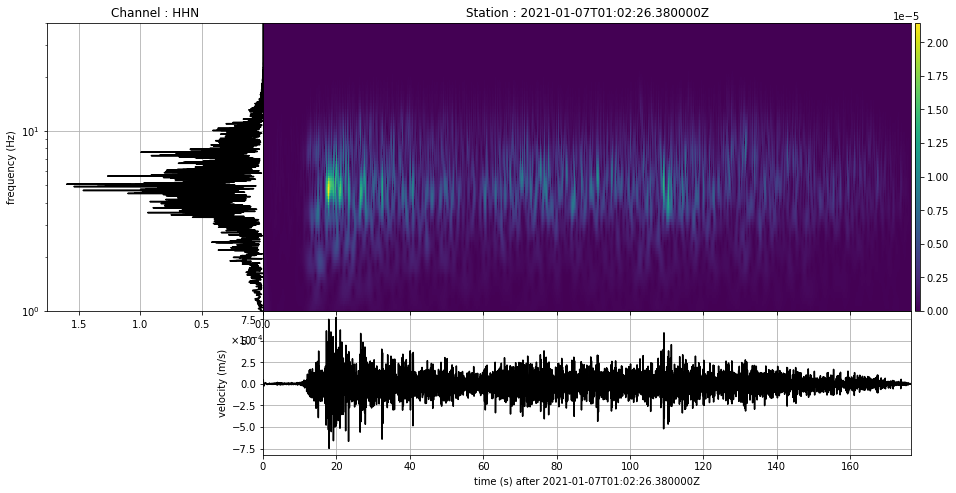

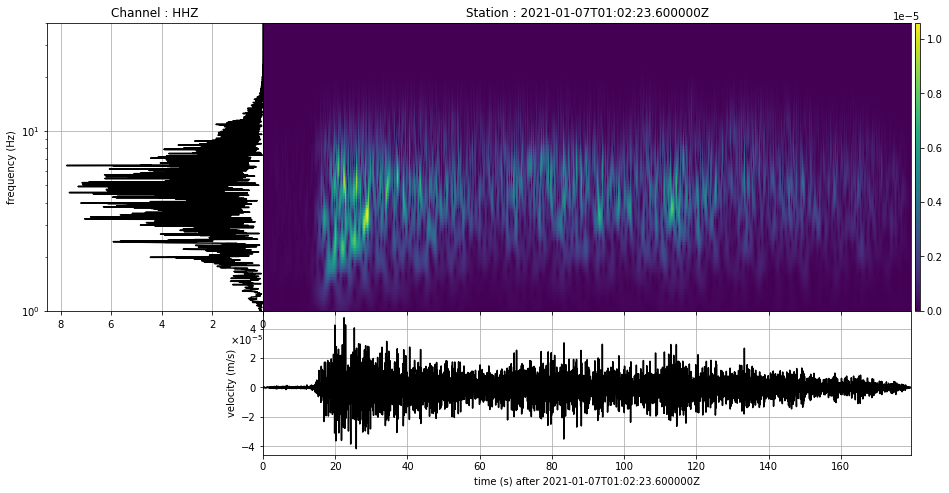

In [ ]:
# MELAB
for i in range(len(melab)):
    mc.plot_tfr(
    melab[i].data, 
    tr=melab[i],
    fmin=1.0,
    fmax=40.0,
    dt=melab[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

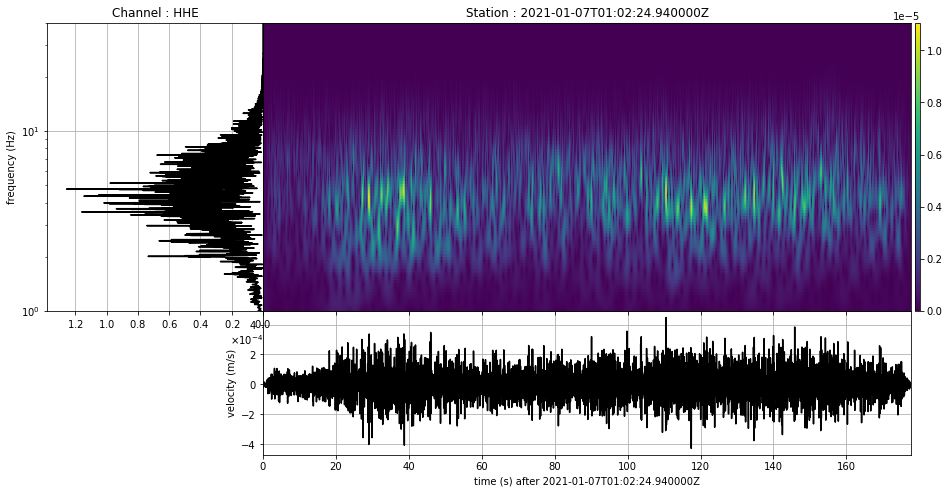

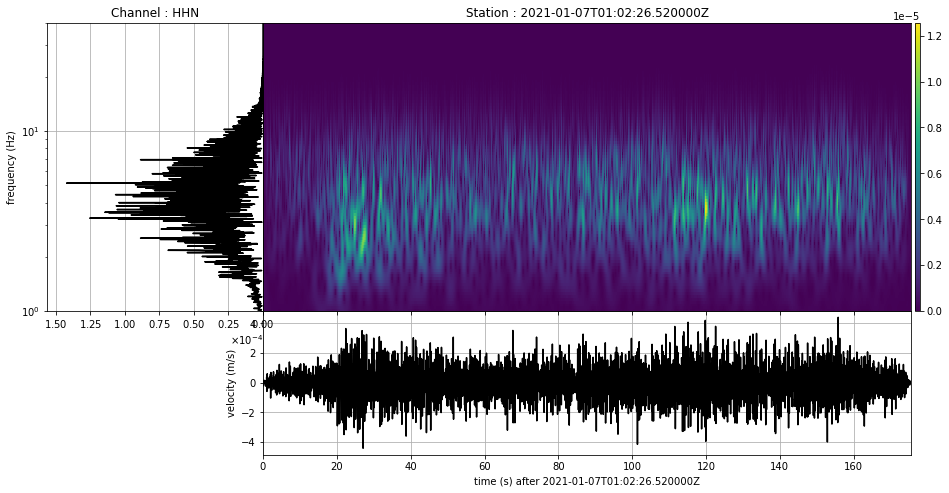

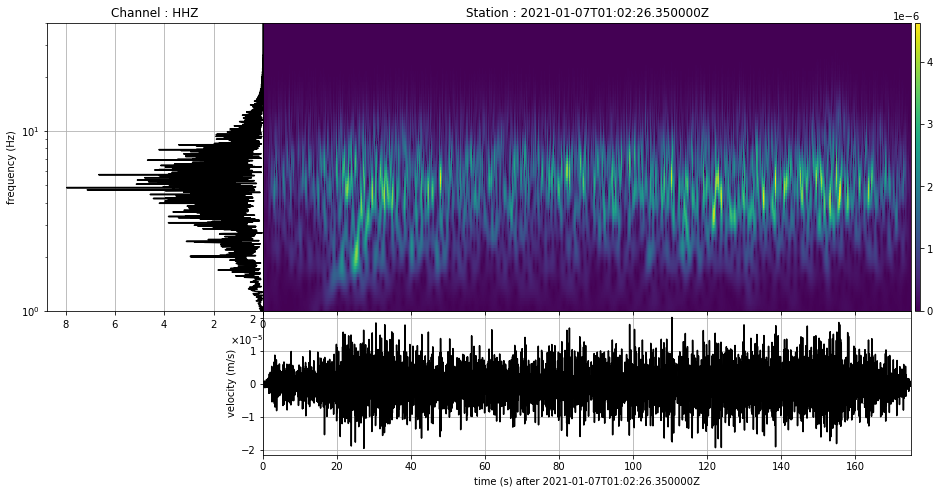

In [ ]:
# MEJRO
for i in range(len(mejro)):
    mc.plot_tfr(
    mejro[i].data, 
    tr=mejro[i],
    fmin=1.0,
    fmax=40.0,
    dt=mejro[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

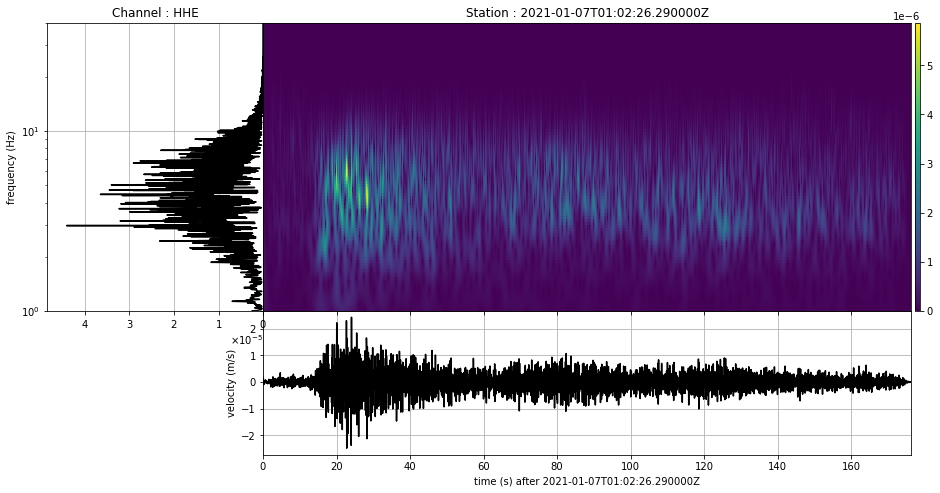

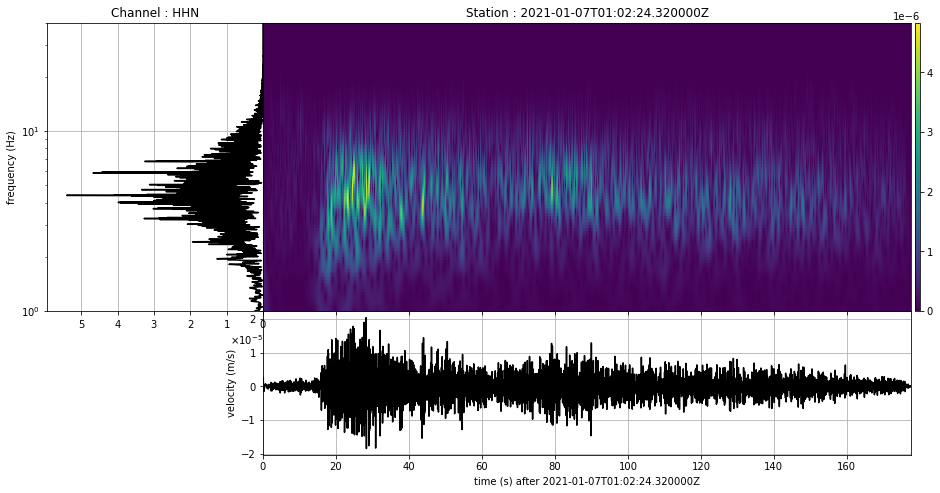

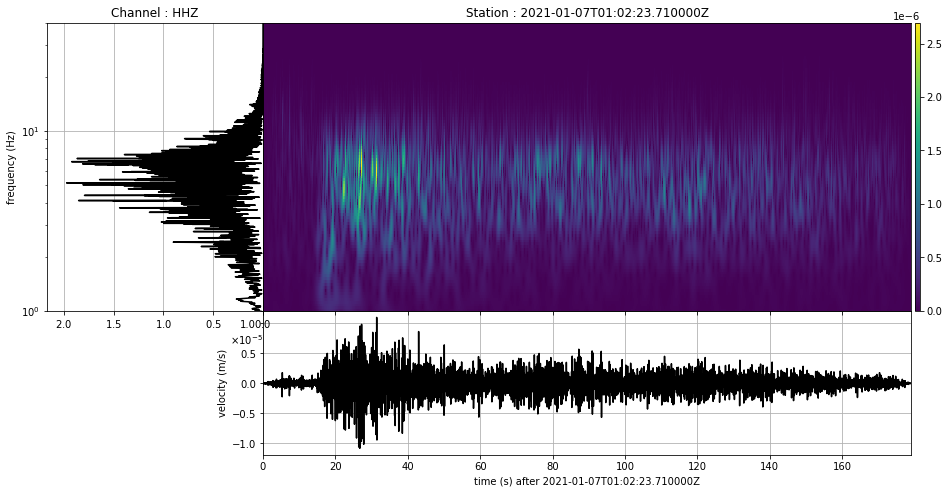

In [ ]:
# MEGRA
for i in range(len(megra)):
    mc.plot_tfr(
    megra[i].data, 
    tr=megra[i],
    fmin=1.0,
    fmax=40.0,
    dt=megra[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

### Particle Motion

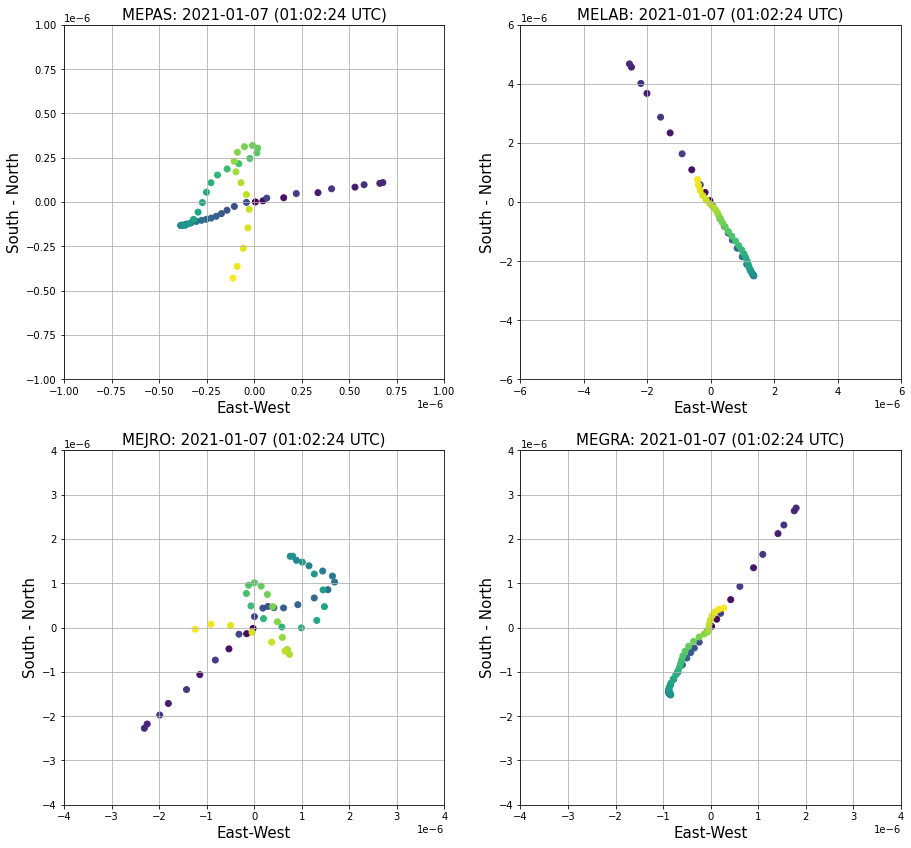

In [107]:
mepas_pm = mepas.copy()
melab_pm = melab.copy()
mejro_pm = mejro.copy()
megra_pm = megra.copy()

st_pm = mepas_pm+melab_pm+mejro_pm+megra_pm
for i in range(len(st_pm)):
  st_pm[i].trim(starttime=st_pm[i].stats.starttime, endtime=st_pm[i].stats.starttime+0.5)
for tr in st_pm.select(channel='HHZ'):
  st_pm.remove(tr)

start = mepas_pm[0].stats.starttime

mepas_pm = st_pm.select(station = 'mepas')
mepas_ctime = np.array(mepas_pm[0].times())
melab_pm = st_pm.select(station = 'melab')
melab_ctime = np.array(melab_pm[0].times())
mejro_pm = st_pm.select(station = 'mejro')
mejro_ctime = np.array(mejro_pm[0].times())
megra_pm = st_pm.select(station = 'megra')
megra_ctime = np.array(megra_pm[0].times())

lim = 0.000004

fig = plt.figure(figsize=(15, 30))
ax=fig.add_subplot(421)
ax.set_title('MEPAS: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax.set_xlabel('East-West', fontsize = 15)
ax.set_ylabel('South - North', fontsize = 15)
ax.set_xlim(-0.000001, 0.000001)
ax.set_ylim(-0.000001, 0.000001)
ax.scatter(mepas_pm[0].data, mepas_pm[1].data, marker='o', c=mepas_ctime)

ax1=fig.add_subplot(422)
ax1.set_title('MELAB: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax1.set_xlabel('East-West', fontsize = 15)
ax1.set_ylabel('South - North', fontsize = 15)
ax1.set_xlim(-0.000006, 0.000006)
ax1.set_ylim(-0.000006, 0.000006)
ax1.scatter(melab_pm[0].data, melab_pm[1].data, marker='o', c=melab_ctime)

ax2=fig.add_subplot(423)
ax2.set_title('MEJRO: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax2.set_xlabel('East-West', fontsize = 15)
ax2.set_ylabel('South - North', fontsize = 15)
ax2.set_xlim(-lim, lim)
ax2.set_ylim(-lim, lim)
ax2.scatter(mejro_pm[0].data, mejro_pm[1].data, marker='o', c=mejro_ctime)

ax3=fig.add_subplot(424)
ax3.set_title('MEGRA: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax3.set_xlabel('East-West', fontsize = 15)
ax3.set_ylabel('South - North', fontsize = 15)
ax3.set_xlim(-lim, lim)
ax3.set_ylim(-lim, lim)
ax3.scatter(megra_pm[0].data, megra_pm[1].data, marker='o', c=megra_ctime)

ax.grid()
ax1.grid()
ax2.grid()
ax3.grid()

plt.savefig('Particle Motion - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white', transparent=False)
ax = plt.gca


### Beamforming ⭕

In [108]:
mepas_fk = mepas.copy()
melab_fk = melab.copy()
mejro_fk = mejro.copy()
megra_fk = megra.copy()

st_ = mepas_fk+melab_fk+mejro_fk+megra_fk
st_fk = st_.copy()
st_fk = st_fk.select(channel='HHZ')

In [109]:
fmin = 1.0
fmax = 12.0
slw = 3.0
sl_s = 1.0
win_len = 3.0
win_frac = 0.5

start = []
for i in range(len(st_fk)):
    start.append(st_fk[i].stats.starttime)
end = []
for i in range(len(st_fk)):
    end.append(st_fk[i].stats.endtime)

t0 = max(start)
t1 = min(end)

st_fk = st_fk.trim(t0, t1)

start = st_fk[0].stats.starttime
end = st_fk[0].stats.endtime

kwargs = dict(
    # slowness grid (x,y) and slow step
    sll_x=-slw, slm_x=slw, sll_y=-slw, slm_y=slw, sl_s=sl_s,
    #sliding window
    win_len=win_len, win_frac=win_frac,
    # frequency for bandpass
    frqlow=fmin, frqhigh=fmax, prewhiten=0,
    # semblance
    semb_thres=-1e9, vel_thres=-1e9,
    stime=start, etime=end, method=0)

out = array_processing(stream=st_fk, verbose=False, **kwargs)


# return = timestamp, realtive relpow, abs relpow, baz, slowness

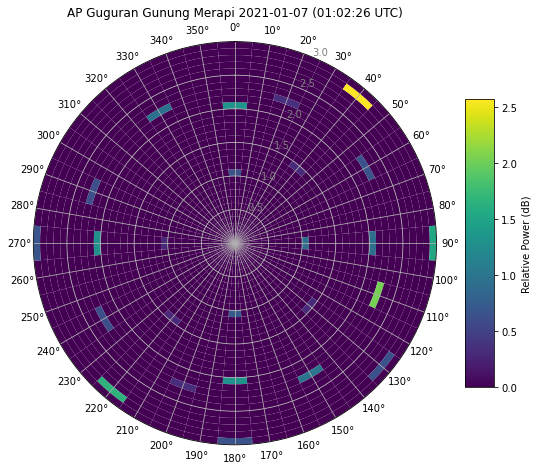

In [110]:
# plotting array

cmap = obspy_sequential

#adjust BAZ into range 0 - 360 degree
t, rel_power, abs_power, baz, slow = out.T
baz[baz<0.0] += 360

df1 = pd.DataFrame({"Time":t, "Backazimuth":baz, "Slowness":slow, 
                    "Relative Power":rel_power
                    
                    })

N=36
N2=30
abins = np.arange(N+1) *360./N
sbins = np.linspace(0, 3, N2+1)

# sum relative power in bins
hist, baz_edges, sl_edges = \
    np.histogram2d(baz, slow, bins=[abins, sbins], weights=rel_power)

# get radians
baz_edges = np.radians(baz_edges)


# polar diagram
fig = plt.figure(figsize=(8,8))
cax = fig.add_axes([0.85, 0.2, 0.05, 0.5])
ax = fig.add_axes([0.10, 0.1, 0.70, 0.70], polar=True)
ax.set_theta_direction(-1)
ax.set_theta_zero_location('N')

dh = abs(sl_edges[1]-sl_edges[0])
dw = abs(baz_edges[1]-baz_edges[0])

for i, row in enumerate(hist):
    bars = ax.bar((i*dw) * np.ones(N2),
                   height=dh*np.ones(N2),
                   width=dw, bottom=dh*np.arange(N2),
                   color=cmap(row/hist.max()))
    
ax.set_xticks(np.linspace(0, 2*np.pi, 36, endpoint=False))
ax.set_title('AP Guguran Gunung Merapi %s' %(start.strftime('%Y-%m-%d (%H:%M:%S UTC)'),))

# slowness limit
ax.set_ylim(0,3)
[i.set_color('grey') for i in ax.get_yticklabels()]
ColorbarBase(cax, cmap=cmap, norm=Normalize(vmin=hist.min(), vmax=hist.max()), label='Relative Power (dB)')

plt.savefig('Polar Plot - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white')
plt.show()

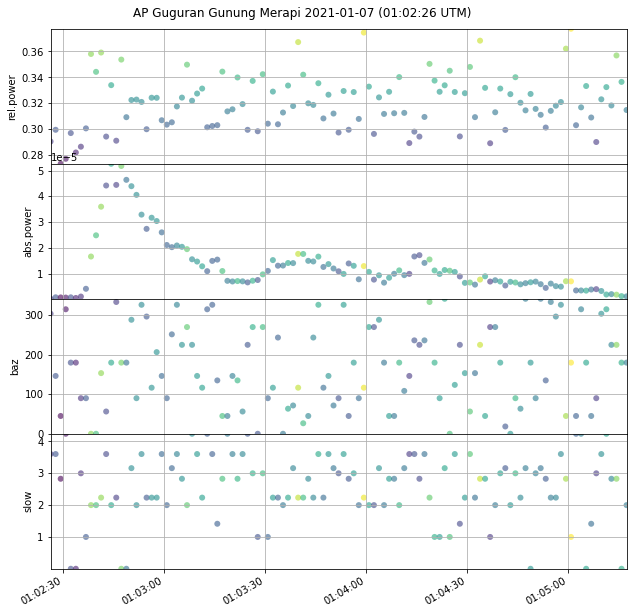

In [ ]:
# plot
labels = ['rel.power', 'abs.power', 'baz', 'slow']
xlocator = mdates.AutoDateLocator()
fig = plt.figure(figsize=(10,10))
for i, lab in enumerate(labels):
    ax = fig.add_subplot(4, 1, i + 1)
    ax.scatter(out[:, 0], out[:, i + 1], c=out[:, 1], alpha=0.6,
               edgecolors='none', cmap=obspy_sequential)
    ax.set_ylabel(lab)
    ax.set_xlim(out[0, 0], out[-1, 0])
    ax.set_ylim(out[:, i + 1].min(), out[:, i + 1].max())
    ax.xaxis.set_major_locator(xlocator)
    ax.xaxis.set_major_formatter(mdates.AutoDateFormatter(xlocator))
    ax.grid()
    
fig.suptitle('AP Guguran Gunung Merapi %s' % (start.strftime('%Y-%m-%d (%H:%M:%S UTC)'), ))
fig.autofmt_xdate()
fig.subplots_adjust(left=0.15, top=0.95, right=0.95, bottom=0.2, hspace=0)

plt.savefig('Plot - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white')
plt.show()

## 5 | (2021-01-26| | 13:16:58) | SW

In [111]:
direction = 'SW'
event = '2021-01-26(13.16.58)'
data_type = 'MSEED'
path = 'data/'+direction+'/'+event

st = read(path+'.'+data_type)
st = st.sort()
st0 = st.copy()


### MEPAS

In [112]:
station = 'mepas'
mepas = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

mepas = mepas.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
mepas

3 Trace(s) in Stream:
VG.MEPAS.00.HHE | 2021-01-26T13:16:57.050000Z - 2021-01-26T13:19:38.190000Z | 100.0 Hz, 16115 samples
VG.MEPAS.00.HHN | 2021-01-26T13:16:56.740000Z - 2021-01-26T13:19:39.790000Z | 100.0 Hz, 16306 samples
VG.MEPAS.00.HHZ | 2021-01-26T13:16:56.310000Z - 2021-01-26T13:19:40.110000Z | 100.0 Hz, 16381 samples

In [113]:
for i in range(len(mepas)):
    mepas[i].stats.coordinates = AttribDict({'latitude':-7.535567,
                                             'longitude':110.449185,
                                             'elevation':2679})

### MELAB ❗

In [114]:
station = 'melab'
melab = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

melab = melab.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
melab

7 Trace(s) in Stream:
VG.MELAB.00.HHE | 2021-01-26T13:16:55.690000Z - 2021-01-26T13:18:06.990000Z | 100.0 Hz, 7131 samples
VG.MELAB.00.HHE | 2021-01-26T13:18:12.000000Z - 2021-01-26T13:19:38.430000Z | 100.0 Hz, 8644 samples
VG.MELAB.00.HHN | 2021-01-26T13:16:57.410000Z - 2021-01-26T13:19:39.990000Z | 100.0 Hz, 16259 samples
VG.MELAB.00.HHZ | 2021-01-26T13:16:57.750000Z - 2021-01-26T13:17:56.990000Z | 100.0 Hz, 5925 samples
VG.MELAB.00.HHZ | 2021-01-26T13:17:57.000000Z - 2021-01-26T13:18:06.990000Z | 100.0 Hz, 1000 samples
VG.MELAB.00.HHZ | 2021-01-26T13:18:07.000000Z - 2021-01-26T13:18:11.990000Z | 100.0 Hz, 500 samples
VG.MELAB.00.HHZ | 2021-01-26T13:18:12.000000Z - 2021-01-26T13:19:38.450000Z | 100.0 Hz, 8646 samples

In [115]:
melab_hhe = melab.select(component='E')
melab_hhe = melab_hhe.merge(method=1, interpolation_samples=-1, fill_value='interpolate')

for tr in melab.select(component='E'):
    melab.remove(tr)
melab = melab + melab_hhe
melab = (melab.sort())._cleanup()
melab

3 Trace(s) in Stream:
VG.MELAB.00.HHE | 2021-01-26T13:16:55.690000Z - 2021-01-26T13:19:38.430000Z | 100.0 Hz, 16275 samples
VG.MELAB.00.HHN | 2021-01-26T13:16:57.410000Z - 2021-01-26T13:19:39.990000Z | 100.0 Hz, 16259 samples
VG.MELAB.00.HHZ | 2021-01-26T13:16:57.750000Z - 2021-01-26T13:19:38.450000Z | 100.0 Hz, 16071 samples

In [116]:
for i in range(len(melab)):
    melab[i].stats.coordinates = AttribDict({'latitude':-7.557044,
                                         'longitude':110.445038,
                                         'elevation':1730})

### MEJRO


In [117]:
station = 'mejro'
mejro = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

mejro = mejro.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
mejro

3 Trace(s) in Stream:
VG.MEJRO.00.HHE | 2021-01-26T13:16:56.790000Z - 2021-01-26T13:19:38.760000Z | 100.0 Hz, 16198 samples
VG.MEJRO.00.HHN | 2021-01-26T13:16:57.430000Z - 2021-01-26T13:19:39.000000Z | 100.0 Hz, 16158 samples
VG.MEJRO.00.HHZ | 2021-01-26T13:16:56.550000Z - 2021-01-26T13:19:39.890000Z | 100.0 Hz, 16335 samples

In [118]:
for i in range(len(mejro)):
    mejro[i].stats.coordinates = AttribDict({'latitude':-7.555357,
                                         'longitude':110.419287,
                                         'elevation':1335})

### MEGRA

In [119]:
station = 'megra'
megra = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

megra = megra.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
megra

3 Trace(s) in Stream:
VG.MEGRA.00.HHE | 2021-01-26T13:16:55.060000Z - 2021-01-26T13:19:38.680000Z | 100.0 Hz, 16363 samples
VG.MEGRA.00.HHN | 2021-01-26T13:16:55.120000Z - 2021-01-26T13:19:39.150000Z | 100.0 Hz, 16404 samples
VG.MEGRA.00.HHZ | 2021-01-26T13:16:57.310000Z - 2021-01-26T13:19:39.010000Z | 100.0 Hz, 16171 samples

In [120]:
for i in range(len(megra)):
    megra[i].stats.coordinates = AttribDict({'latitude':-7.52163,
                                         'longitude':110.45149,
                                         'elevation':2045})

### Signal Analysis

#### Spectrogram Before Filter

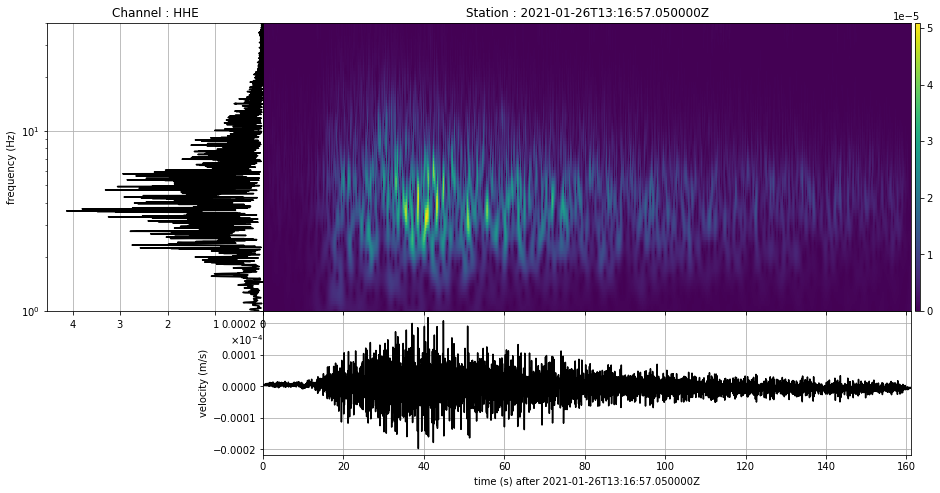

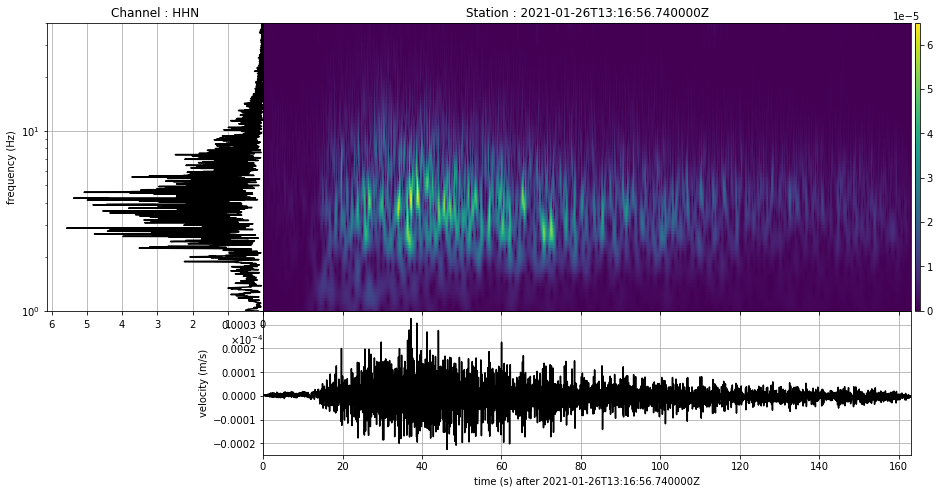

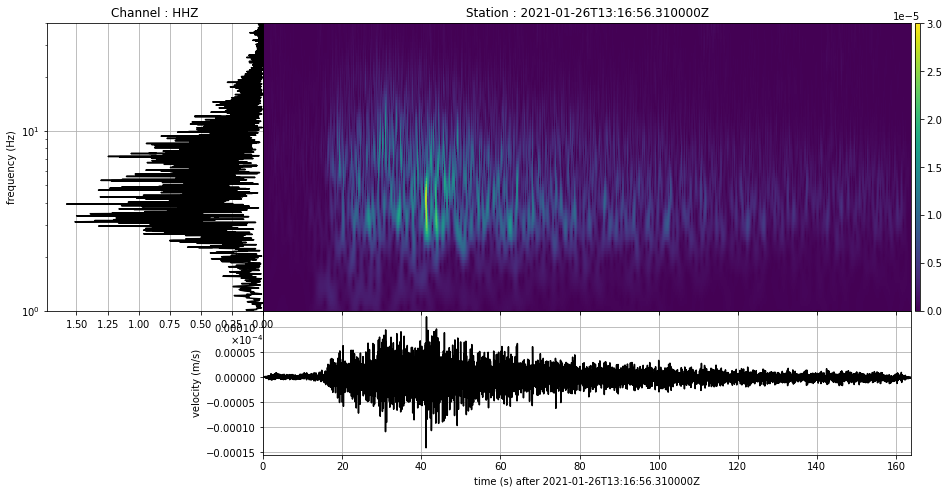

In [ ]:
# MEPAS
for i in range(len(mepas)):
    mc.plot_tfr(
    mepas[i].data, 
    tr=mepas[i],
    fmin=1.0,
    fmax=40.0,
    dt=mepas[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

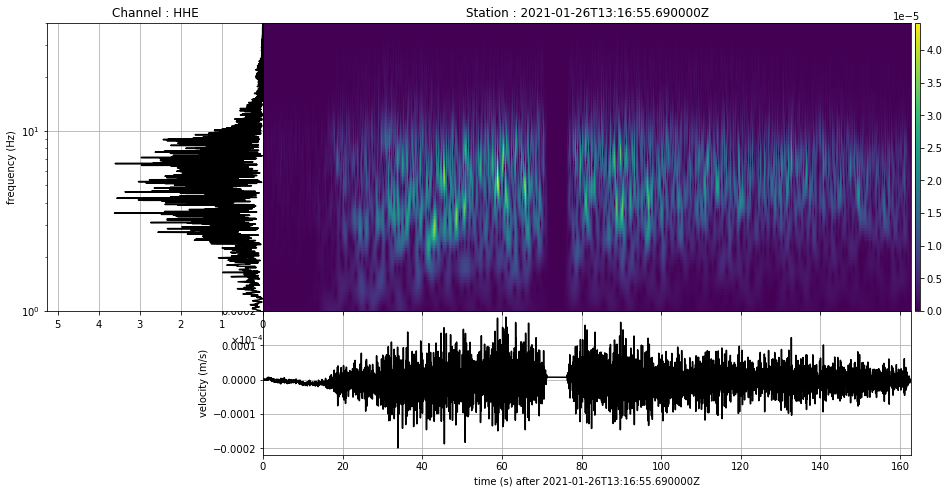

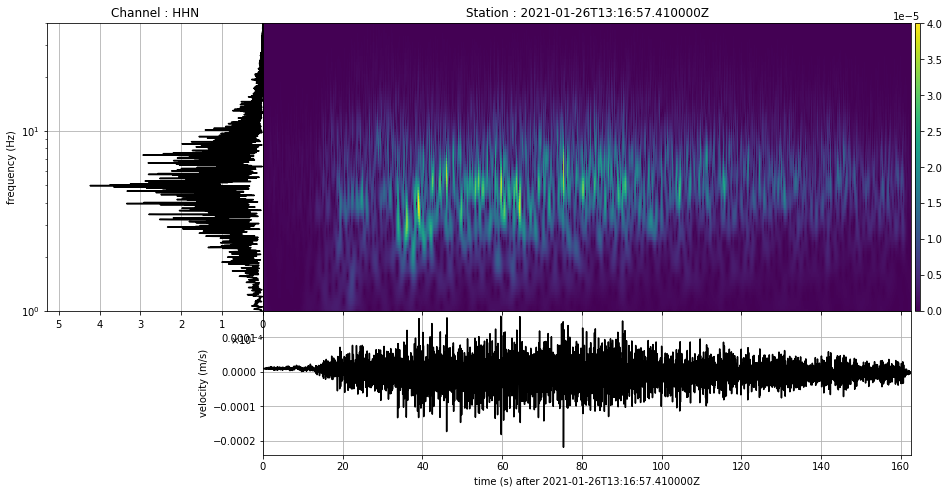

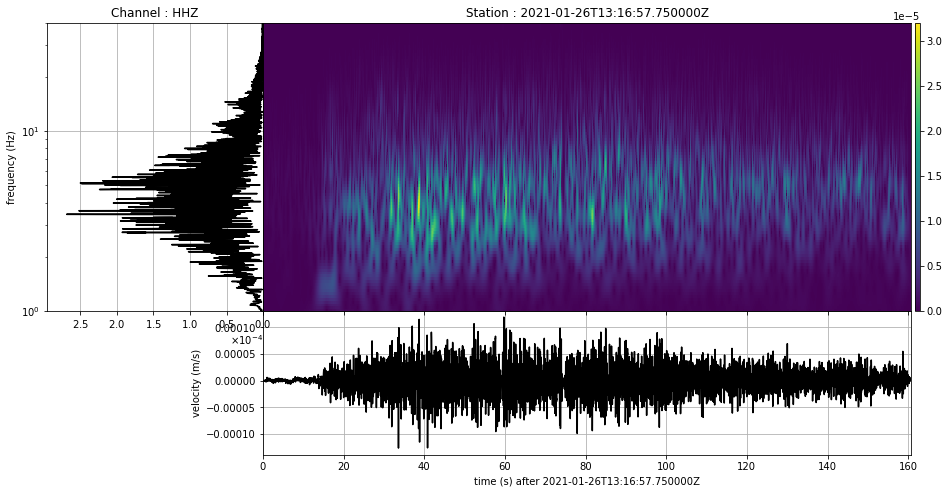

In [ ]:
# MELAB
for i in range(len(melab)):
    mc.plot_tfr(
    melab[i].data, 
    tr=melab[i],
    fmin=1.0,
    fmax=40.0,
    dt=melab[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

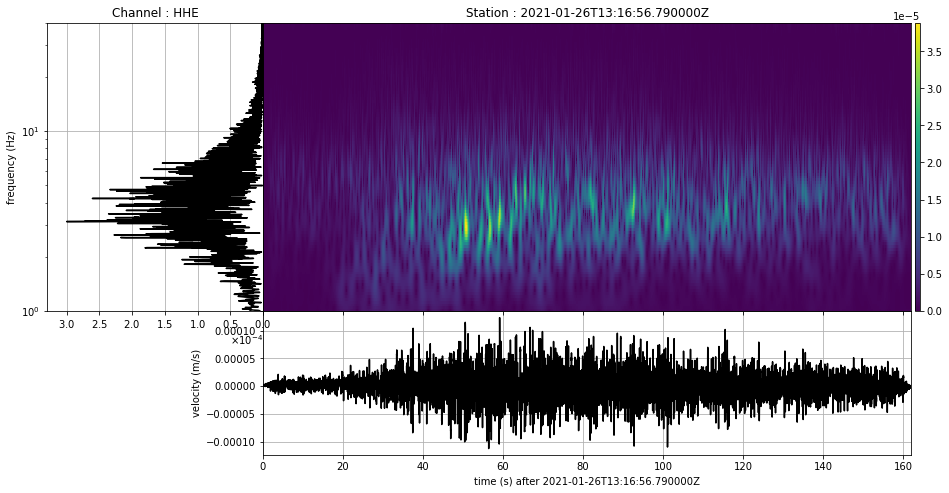

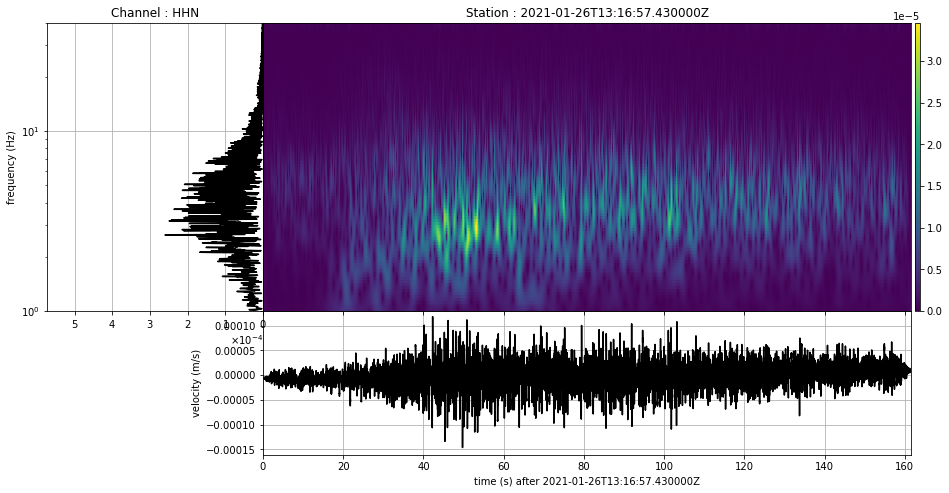

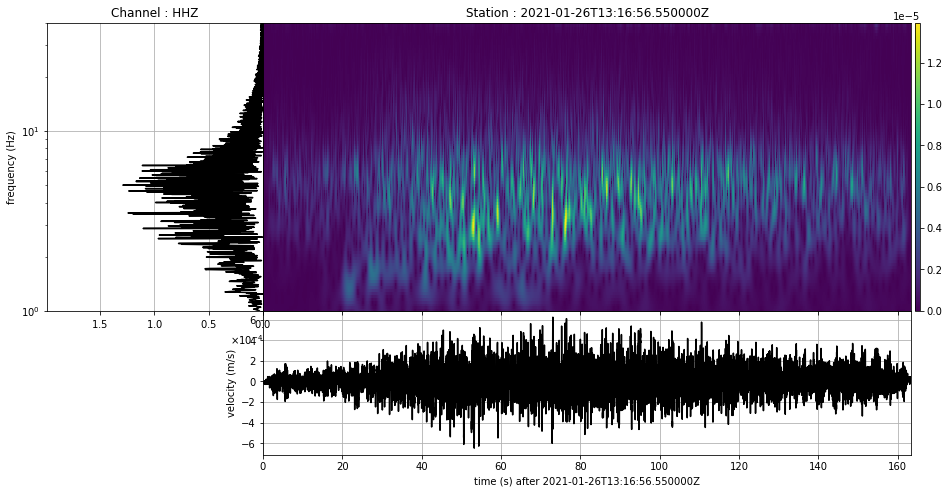

In [ ]:
# MEJRO
for i in range(len(mejro)):
    mc.plot_tfr(
    mejro[i].data, 
    tr=mejro[i],
    fmin=1.0,
    fmax=40.0,
    dt=mejro[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

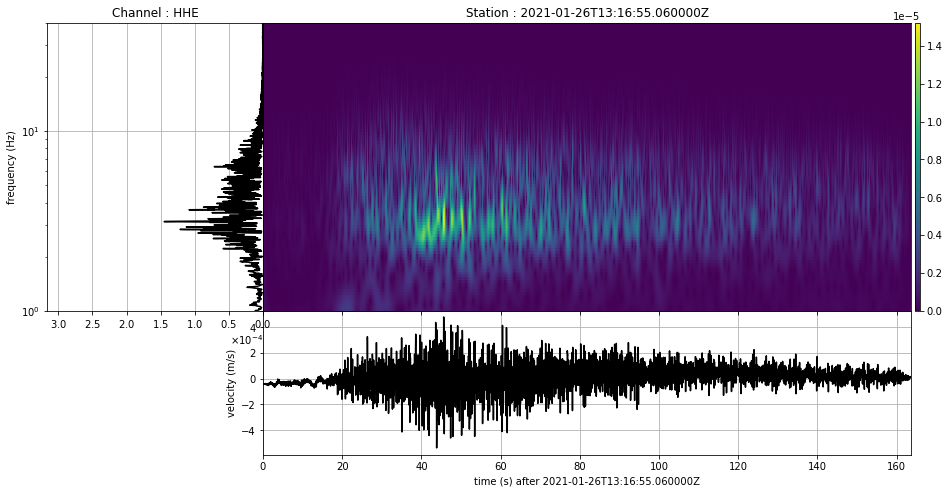

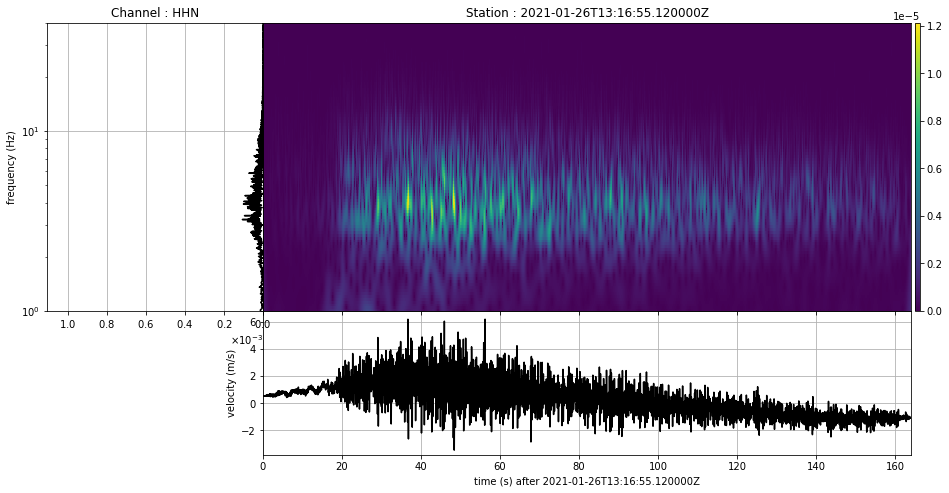

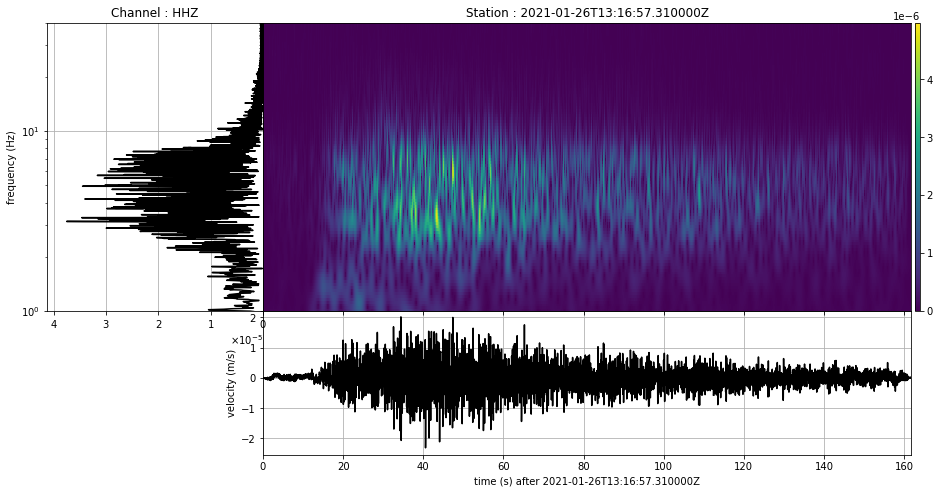

In [ ]:
# MEGRA
for i in range(len(megra)):
    mc.plot_tfr(
    megra[i].data, 
    tr=megra[i],
    fmin=1.0,
    fmax=40.0,
    dt=megra[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

#### Data Filter

In [121]:
mepas = mepas.filter('bandpass', freqmin = 1.0, freqmax=12.0)
melab = melab.filter('bandpass', freqmin = 1.0, freqmax=12.0)
mejro = mejro.filter('bandpass', freqmin = 1.0, freqmax=12.0)
megra = megra.filter('bandpass', freqmin = 1.0, freqmax=12.0)

#### Spectrogram After Filter

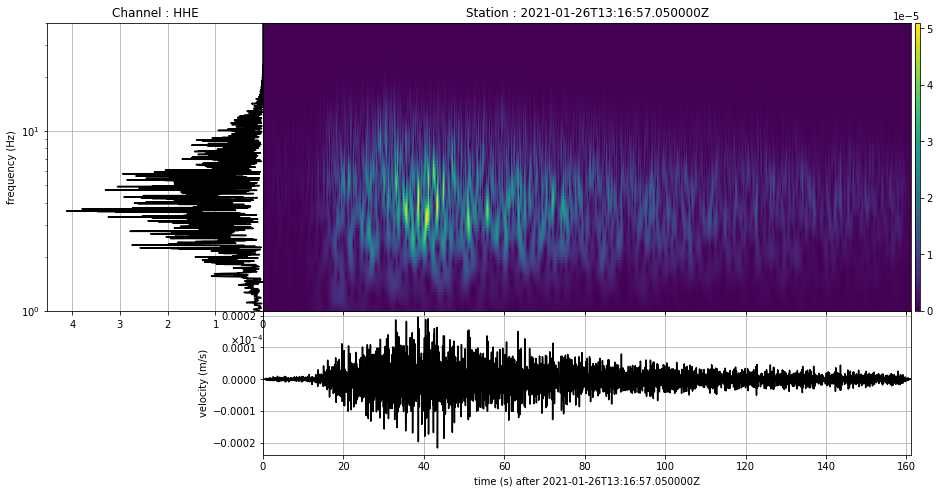

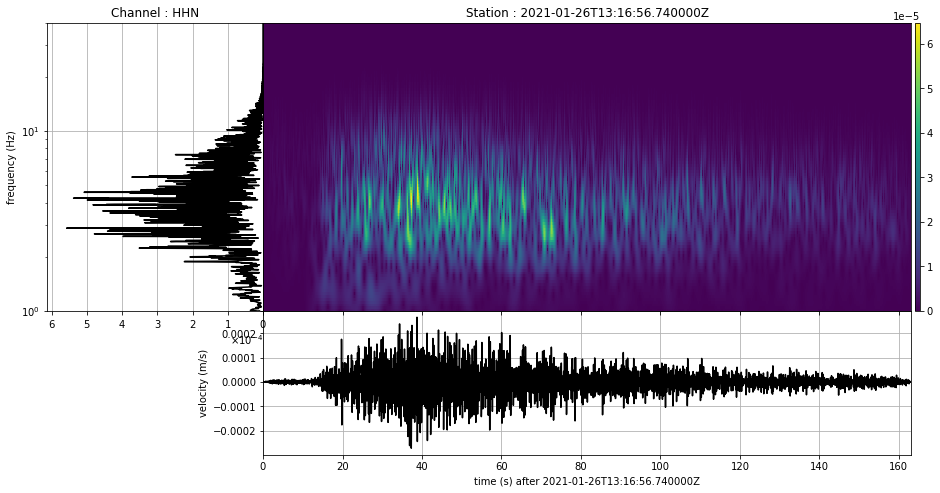

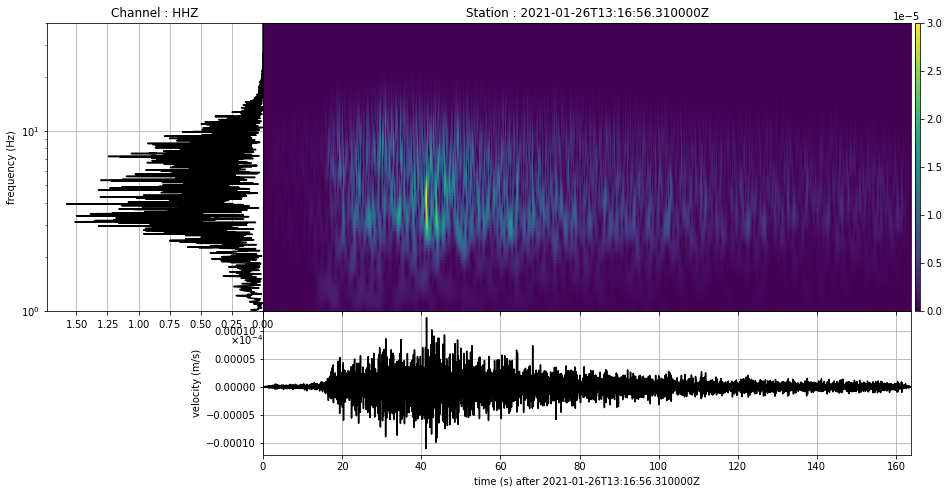

In [ ]:
# MEPAS
for i in range(len(mepas)):
    mc.plot_tfr(
    mepas[i].data, 
    tr=mepas[i],
    fmin=1.0,
    fmax=40.0,
    dt=mepas[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

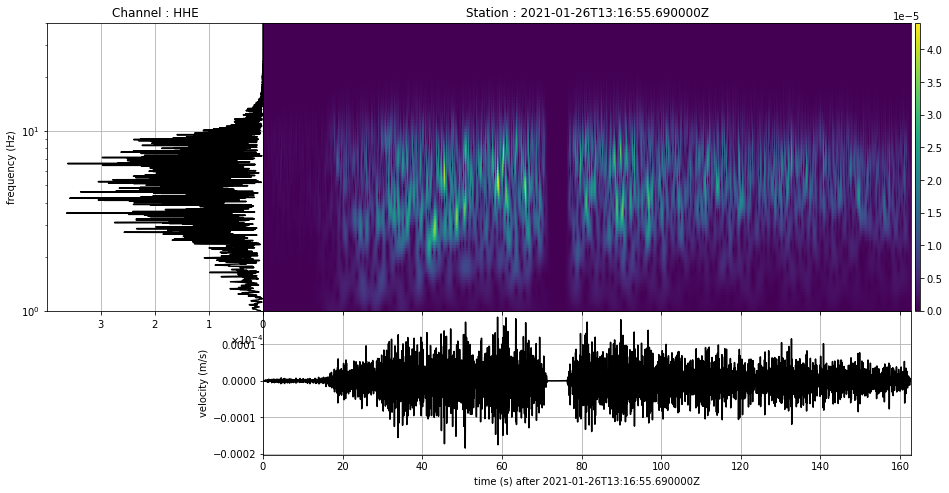

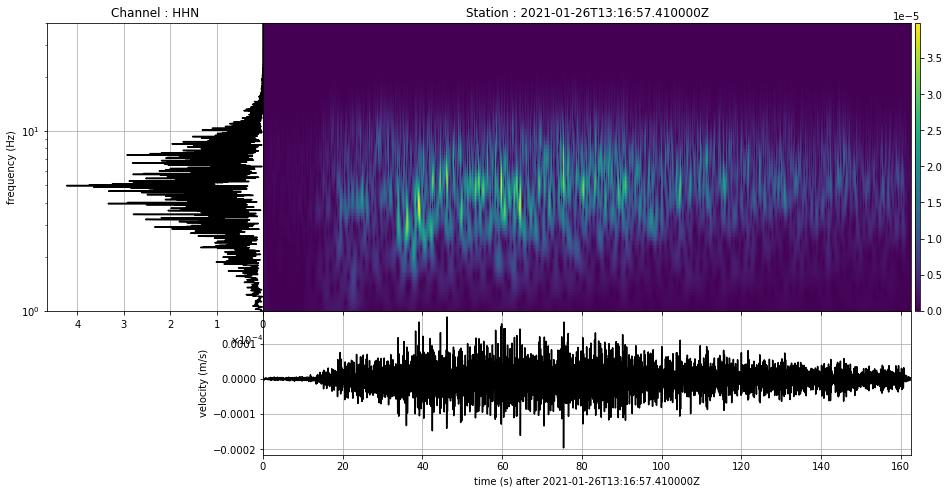

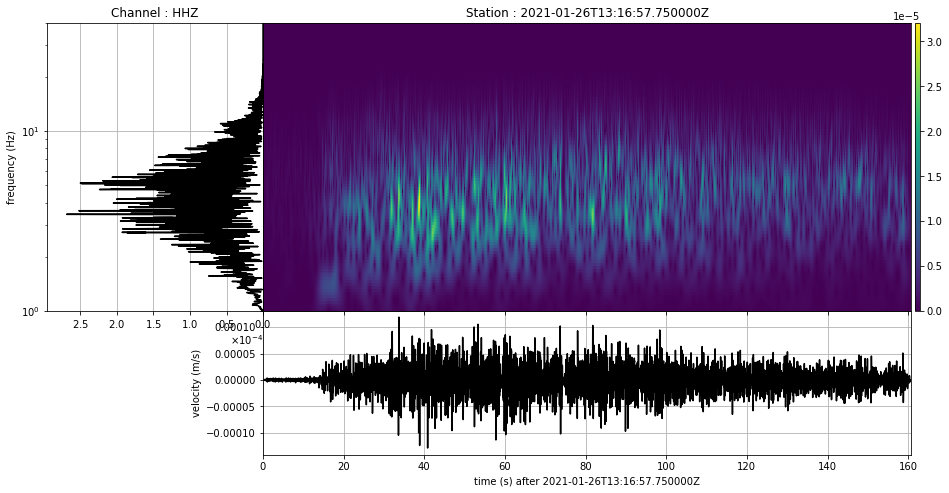

In [ ]:
# MELAB
for i in range(len(melab)):
    mc.plot_tfr(
    melab[i].data, 
    tr=melab[i],
    fmin=1.0,
    fmax=40.0,
    dt=melab[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

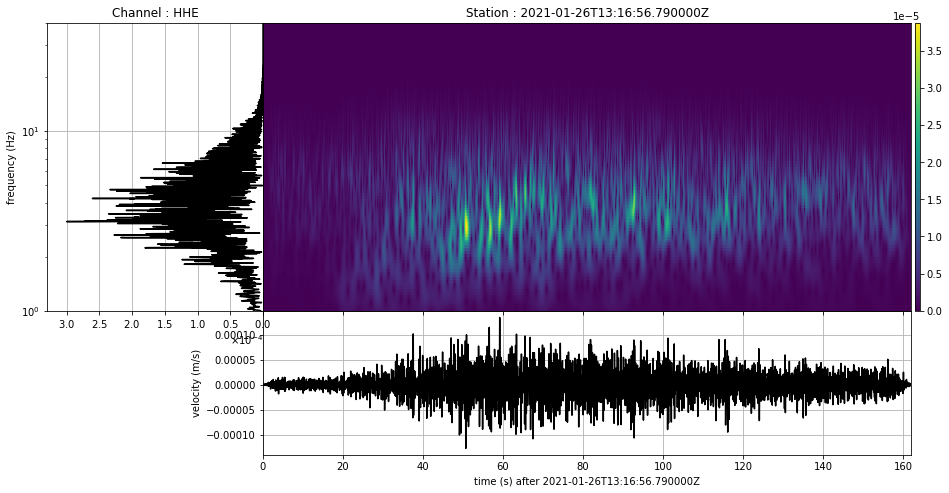

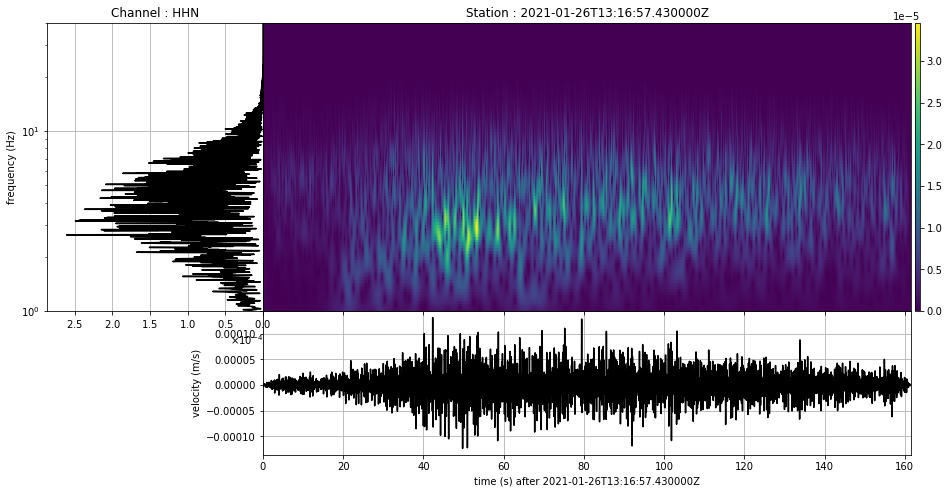

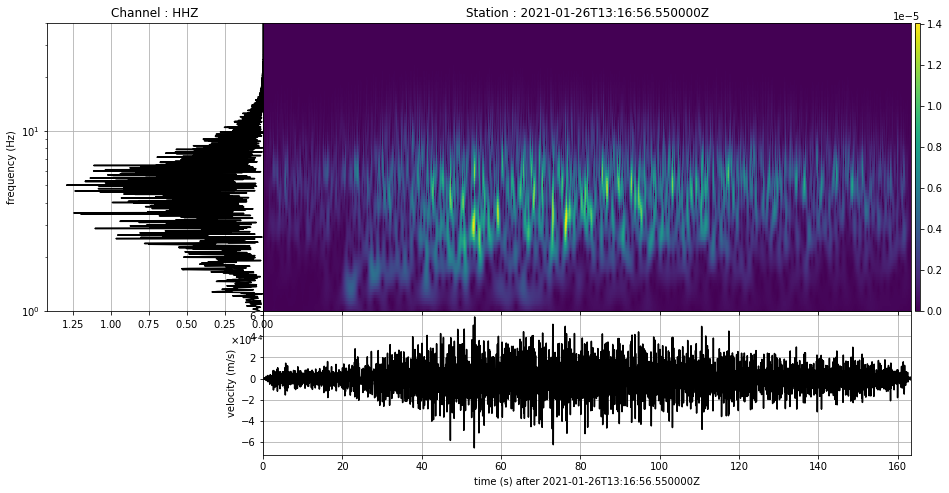

In [ ]:
# MEJRO
for i in range(len(mejro)):
    mc.plot_tfr(
    mejro[i].data, 
    tr=mejro[i],
    fmin=1.0,
    fmax=40.0,
    dt=mejro[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

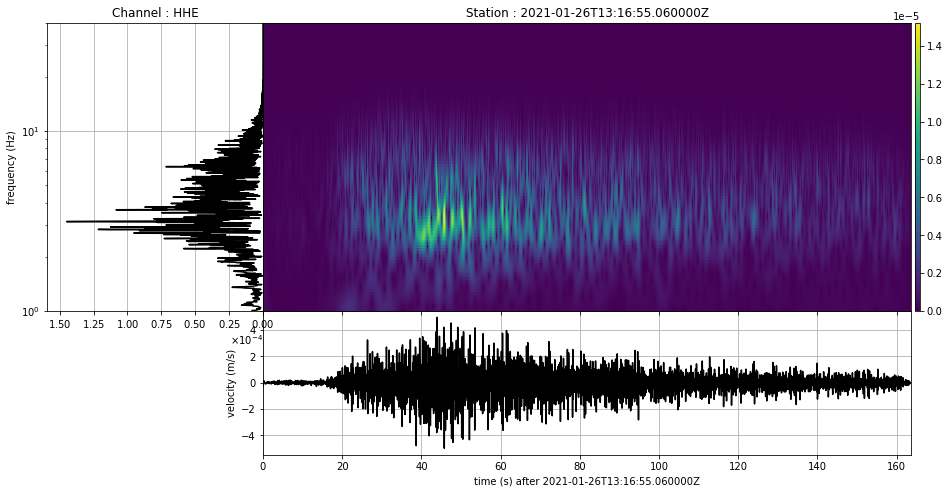

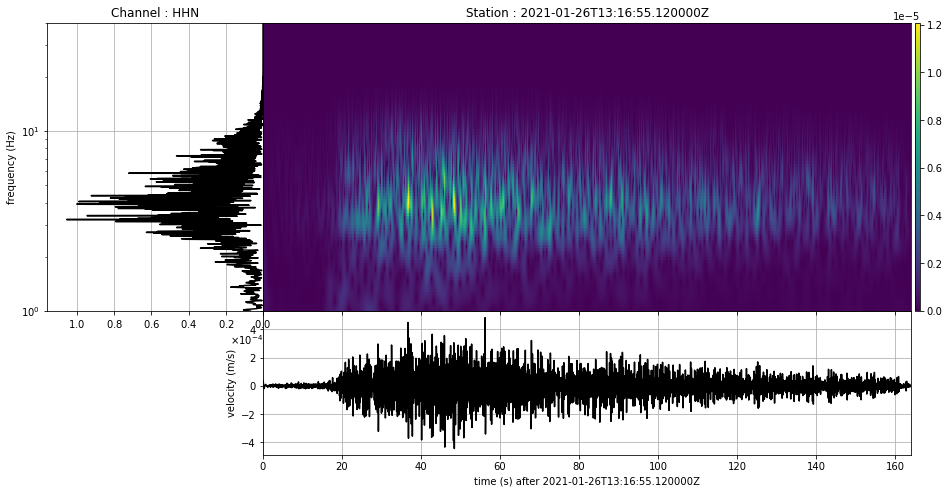

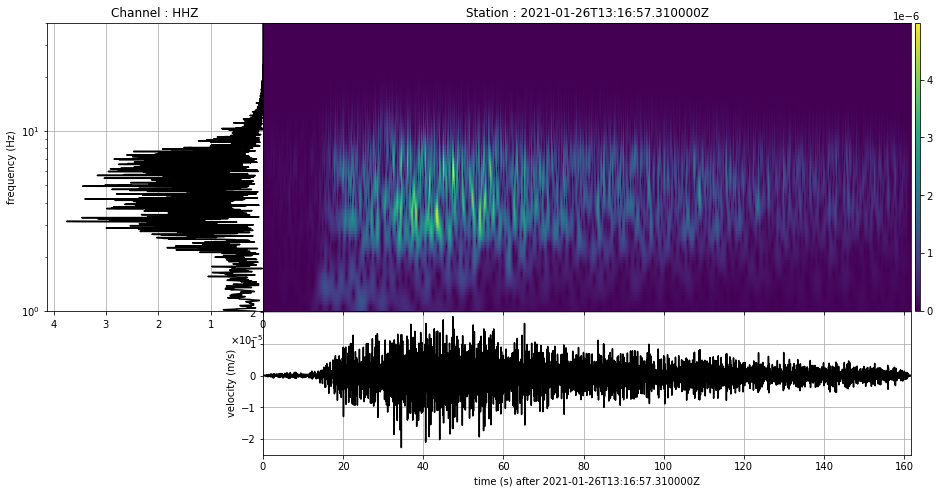

In [ ]:
# MEGRA
for i in range(len(megra)):
    mc.plot_tfr(
    megra[i].data, 
    tr=megra[i],
    fmin=1.0,
    fmax=40.0,
    dt=megra[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

### Particle Motion

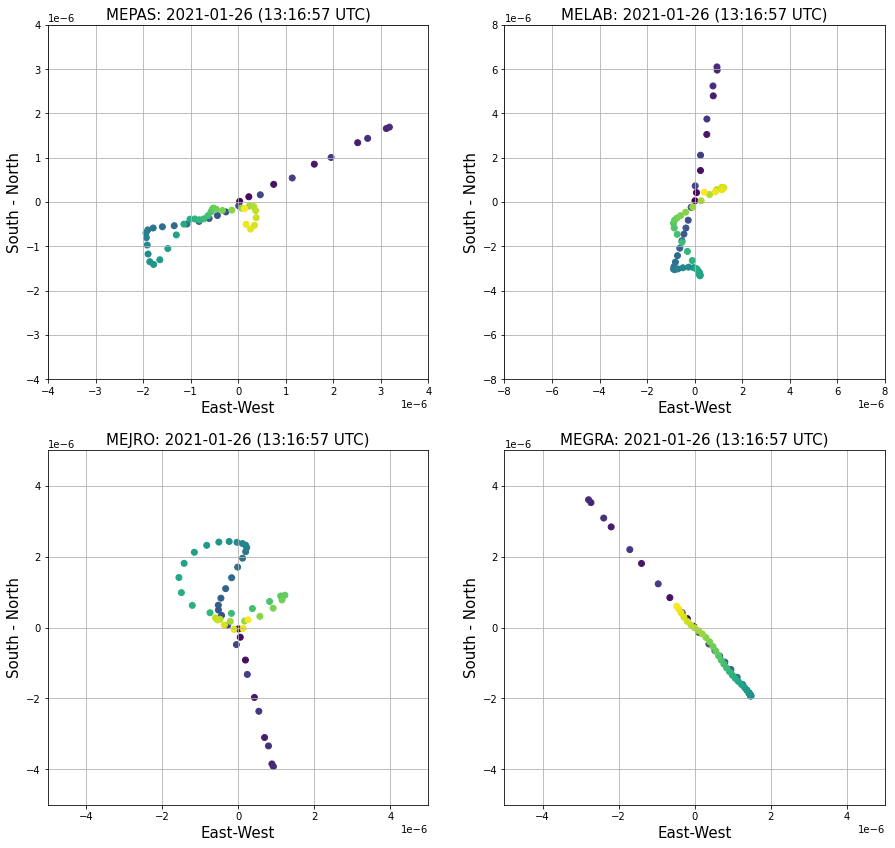

In [122]:
mepas_pm = mepas.copy()
melab_pm = melab.copy()
mejro_pm = mejro.copy()
megra_pm = megra.copy()

st_pm = mepas_pm+melab_pm+mejro_pm+megra_pm
for i in range(len(st_pm)):
  st_pm[i].trim(starttime=st_pm[i].stats.starttime, endtime=st_pm[i].stats.starttime+0.5)
for tr in st_pm.select(channel='HHZ'):
  st_pm.remove(tr)

start = mepas_pm[0].stats.starttime


mepas_pm = st_pm.select(station = 'mepas')
mepas_ctime = np.array(mepas_pm[0].times())
melab_pm = st_pm.select(station = 'melab')
melab_ctime = np.array(melab_pm[0].times())
mejro_pm = st_pm.select(station = 'mejro')
mejro_ctime = np.array(mejro_pm[0].times())
megra_pm = st_pm.select(station = 'megra')
megra_ctime = np.array(megra_pm[0].times())

lim = 0.000008

fig = plt.figure(figsize=(15, 30))
ax=fig.add_subplot(421)
ax.set_title('MEPAS: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax.set_xlabel('East-West', fontsize = 15)
ax.set_ylabel('South - North', fontsize = 15)
ax.set_xlim(-0.000004, 0.000004)
ax.set_ylim(-0.000004, 0.000004)
ax.scatter(mepas_pm[0].data, mepas_pm[1].data, marker='o', c=mepas_ctime)

ax1=fig.add_subplot(422)
ax1.set_title('MELAB: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax1.set_xlabel('East-West', fontsize = 15)
ax1.set_ylabel('South - North', fontsize = 15)
ax1.set_xlim(-lim, lim)
ax1.set_ylim(-lim, lim)
ax1.scatter(melab_pm[0].data, melab_pm[1].data, marker='o', c=melab_ctime)

ax2=fig.add_subplot(423)
ax2.set_title('MEJRO: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax2.set_xlabel('East-West', fontsize = 15)
ax2.set_ylabel('South - North', fontsize = 15)
ax2.set_xlim(-0.000005, 0.000005)
ax2.set_ylim(-0.000005, 0.000005)
ax2.scatter(mejro_pm[0].data, mejro_pm[1].data, marker='o', c=mejro_ctime)

ax3=fig.add_subplot(424)
ax3.set_title('MEGRA: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax3.set_xlabel('East-West', fontsize = 15)
ax3.set_ylabel('South - North', fontsize = 15)
ax3.set_xlim(-0.000005, 0.000005)
ax3.set_ylim(-0.000005, 0.000005)
ax3.scatter(megra_pm[0].data, megra_pm[1].data, marker='o', c=megra_ctime)

ax.grid()
ax1.grid()
ax2.grid()
ax3.grid()

plt.savefig('Particle Motion - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white', transparent=False)
ax = plt.gca


### Beamforming ⭕

In [123]:
mepas_fk = mepas.copy()
melab_fk = melab.copy()
mejro_fk = mejro.copy()
megra_fk = megra.copy()



st_ = mepas_fk+melab_fk+mejro_fk+megra_fk
st_fk = st_.copy()
st_fk = st_fk.select(channel='HHZ')

In [124]:
fmin = 1.0
fmax = 12.0
slw = 3.0
sl_s = 1.0
win_len = 3.0
win_frac = 0.5

start = []
for i in range(len(st_fk)):
    start.append(st_fk[i].stats.starttime)
end = []
for i in range(len(st_fk)):
    end.append(st_fk[i].stats.endtime)

t0 = max(start)
t1 = min(end)

st_fk = st_fk.trim(t0, t1)

start = st_fk[0].stats.starttime
end = st_fk[0].stats.endtime

kwargs = dict(
    # slowness grid (x,y) and slow step
    sll_x=-slw, slm_x=slw, sll_y=-slw, slm_y=slw, sl_s=sl_s,
    #sliding window
    win_len=win_len, win_frac=win_frac,
    # frequency for bandpass
    frqlow=fmin, frqhigh=fmax, prewhiten=0,
    # semblance
    semb_thres=-1e9, vel_thres=-1e9,
    stime=start, etime=end, method=0)

out = array_processing(stream=st_fk, **kwargs)


# return = timestamp, realtive relpow, abs relpow, baz, slowness

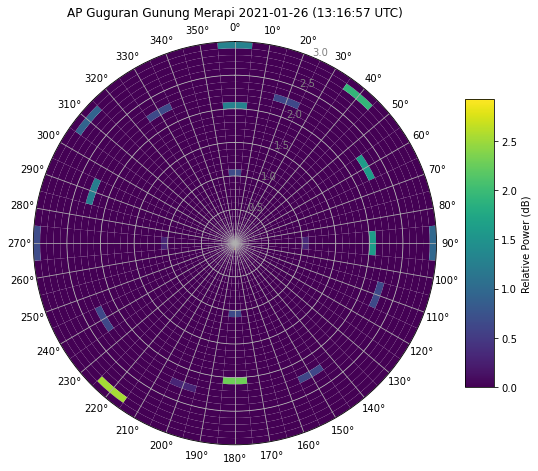

In [125]:
# plotting array

cmap = obspy_sequential

#adjust BAZ into range 0 - 360 degree
t, rel_power, abs_power, baz, slow = out.T
baz[baz<0.0] += 360

df5 = pd.DataFrame({"Time":t, "Backazimuth":baz, "Slowness":slow, 
                    "Relative Power":rel_power
                    
                    })

N=36
N2=30
abins = np.arange(N+1) *360./N
sbins = np.linspace(0, 3, N2+1)

# sum relative power in bins
hist, baz_edges, sl_edges = \
    np.histogram2d(baz, slow, bins=[abins, sbins], weights=rel_power)

# get radians
baz_edges = np.radians(baz_edges)


# polar diagram
fig = plt.figure(figsize=(8,8))
cax = fig.add_axes([0.85, 0.2, 0.05, 0.5])
ax = fig.add_axes([0.10, 0.1, 0.70, 0.70], polar=True)
ax.set_theta_direction(-1)
ax.set_theta_zero_location('N')

dh = abs(sl_edges[1]-sl_edges[0])
dw = abs(baz_edges[1]-baz_edges[0])

for i, row in enumerate(hist):
    bars = ax.bar((i*dw) * np.ones(N2),
                   height=dh*np.ones(N2),
                   width=dw, bottom=dh*np.arange(N2),
                   color=cmap(row/hist.max()))
    
ax.set_xticks(np.linspace(0, 2*np.pi, 36, endpoint=False))
ax.set_title('AP Guguran Gunung Merapi %s' %(start.strftime('%Y-%m-%d (%H:%M:%S UTC)'),))

# slowness limit
ax.set_ylim(0,3)
[i.set_color('grey') for i in ax.get_yticklabels()]
ColorbarBase(cax, cmap=cmap, norm=Normalize(vmin=hist.min(), vmax=hist.max()), label='Relative Power (dB)')

plt.savefig('Polar Plot - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white')
plt.show()

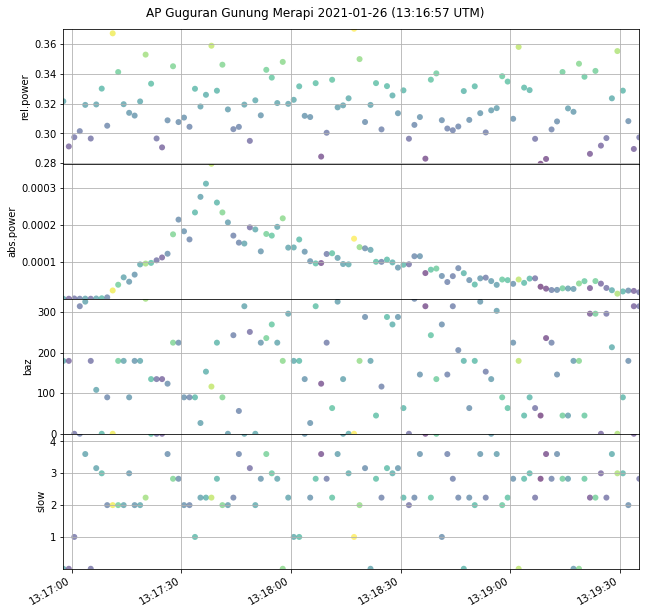

In [ ]:
# plot
labels = ['rel.power', 'abs.power', 'baz', 'slow']
xlocator = mdates.AutoDateLocator()
fig = plt.figure(figsize=(10,10))
for i, lab in enumerate(labels):
    ax = fig.add_subplot(4, 1, i + 1)
    ax.scatter(out[:, 0], out[:, i + 1], c=out[:, 1], alpha=0.6,
               edgecolors='none', cmap=obspy_sequential)
    ax.set_ylabel(lab)
    ax.set_xlim(out[0, 0], out[-1, 0])
    ax.set_ylim(out[:, i + 1].min(), out[:, i + 1].max())
    ax.xaxis.set_major_locator(xlocator)
    ax.xaxis.set_major_formatter(mdates.AutoDateFormatter(xlocator))
    ax.grid()
    
fig.suptitle('AP Guguran Gunung Merapi %s' % (start.strftime('%Y-%m-%d (%H:%M:%S UTC)'), ))
fig.autofmt_xdate()
fig.subplots_adjust(left=0.15, top=0.95, right=0.95, bottom=0.2, hspace=0)

plt.savefig('Plot - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white')
plt.show()

## 6 | (2021-01-26| | 16:29:12) | SW

In [126]:
direction = 'SW'
event = '2021-01-26(16.29.12)'
data_type = 'MSEED'
path = 'data/'+direction+'/'+event

st = read(path+'.'+data_type)
st = st.sort()
st0 = st.copy()

### MEPAS

In [127]:
station = 'mepas'
mepas = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

mepas = mepas.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
mepas

3 Trace(s) in Stream:
VG.MEPAS.00.HHE | 2021-01-26T16:29:10.460000Z - 2021-01-26T16:32:11.040000Z | 100.0 Hz, 18059 samples
VG.MEPAS.00.HHN | 2021-01-26T16:29:10.830000Z - 2021-01-26T16:32:10.180000Z | 100.0 Hz, 17936 samples
VG.MEPAS.00.HHZ | 2021-01-26T16:29:11.990000Z - 2021-01-26T16:32:10.900000Z | 100.0 Hz, 17892 samples

In [128]:
for i in range(len(mepas)):
    mepas[i].stats.coordinates = AttribDict({'latitude':-7.535567,
                                             'longitude':110.449185,
                                             'elevation':2679})

### MELAB

In [129]:
station = 'melab'
melab = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

melab = melab.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
melab

3 Trace(s) in Stream:
VG.MELAB.00.HHE | 2021-01-26T16:29:10.910000Z - 2021-01-26T16:32:09.140000Z | 100.0 Hz, 17824 samples
VG.MELAB.00.HHN | 2021-01-26T16:29:11.600000Z - 2021-01-26T16:30:56.990000Z | 100.0 Hz, 10540 samples
VG.MELAB.00.HHZ | 2021-01-26T16:29:11.380000Z - 2021-01-26T16:29:33.990000Z | 100.0 Hz, 2262 samples

In [130]:
for i in range(len(melab)):
    melab[i].stats.coordinates = AttribDict({'latitude':-7.557044,
                                         'longitude':110.445038,
                                         'elevation':1730})

### MEJRO


In [131]:
station = 'mejro'
mejro = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

mejro = mejro.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
mejro

3 Trace(s) in Stream:
VG.MEJRO.00.HHE | 2021-01-26T16:29:10.030000Z - 2021-01-26T16:32:09.030000Z | 100.0 Hz, 17901 samples
VG.MEJRO.00.HHN | 2021-01-26T16:29:11.660000Z - 2021-01-26T16:32:10.590000Z | 100.0 Hz, 17894 samples
VG.MEJRO.00.HHZ | 2021-01-26T16:29:10.250000Z - 2021-01-26T16:32:09.830000Z | 100.0 Hz, 17959 samples

In [132]:
for i in range(len(mejro)):
    mejro[i].stats.coordinates = AttribDict({'latitude':-7.555357,
                                         'longitude':110.419287,
                                         'elevation':1335})

### MEGRA

In [133]:
station = 'megra'
megra = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

megra = megra.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
megra

3 Trace(s) in Stream:
VG.MEGRA.00.HHE | 2021-01-26T16:29:11.190000Z - 2021-01-26T16:32:09.390000Z | 100.0 Hz, 17821 samples
VG.MEGRA.00.HHN | 2021-01-26T16:29:10.990000Z - 2021-01-26T16:32:09.580000Z | 100.0 Hz, 17860 samples
VG.MEGRA.00.HHZ | 2021-01-26T16:29:09.850000Z - 2021-01-26T16:32:10.280000Z | 100.0 Hz, 18044 samples

In [134]:
for i in range(len(megra)):
    megra[i].stats.coordinates = AttribDict({'latitude':-7.52163,
                                         'longitude':110.45149,
                                         'elevation':2045})

### Signal Analysis

#### Spectrogram Before Filter

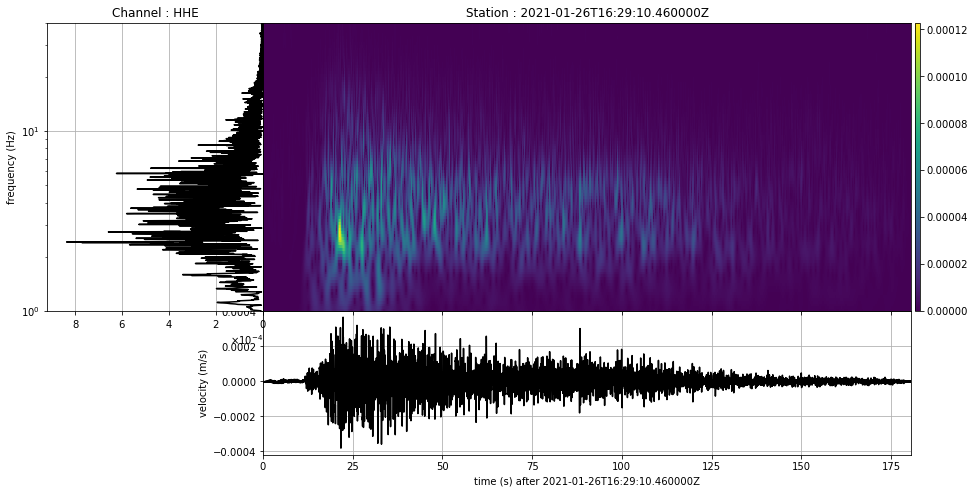

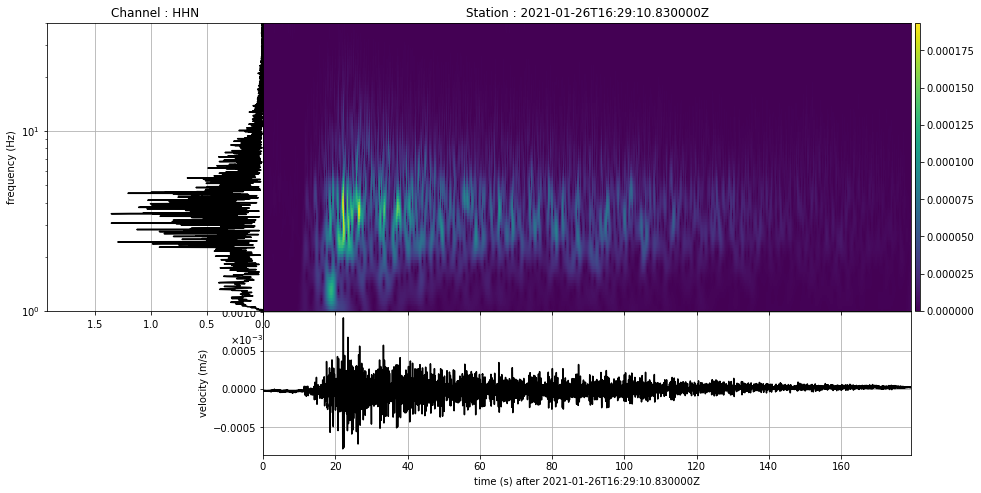

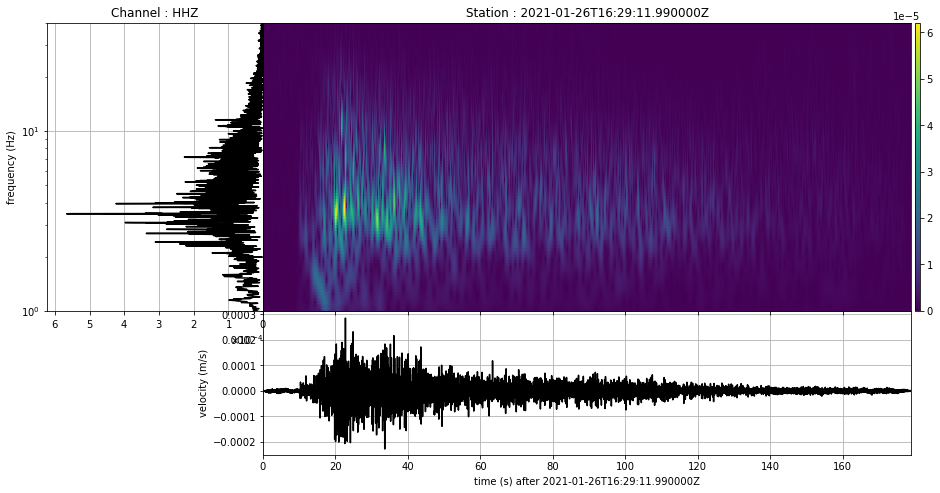

In [ ]:
# MEPAS
for i in range(len(mepas)):
    mc.plot_tfr(
    mepas[i].data, 
    tr=mepas[i],
    fmin=1.0,
    fmax=40.0,
    dt=mepas[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

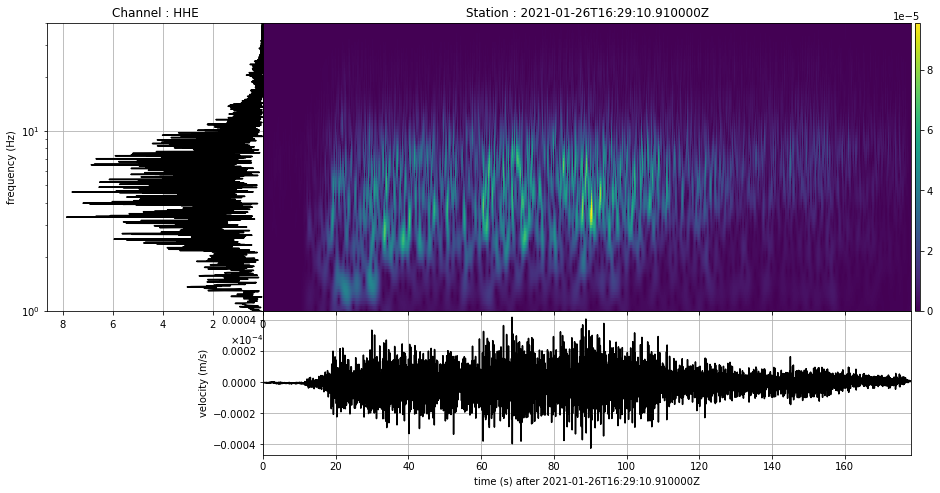

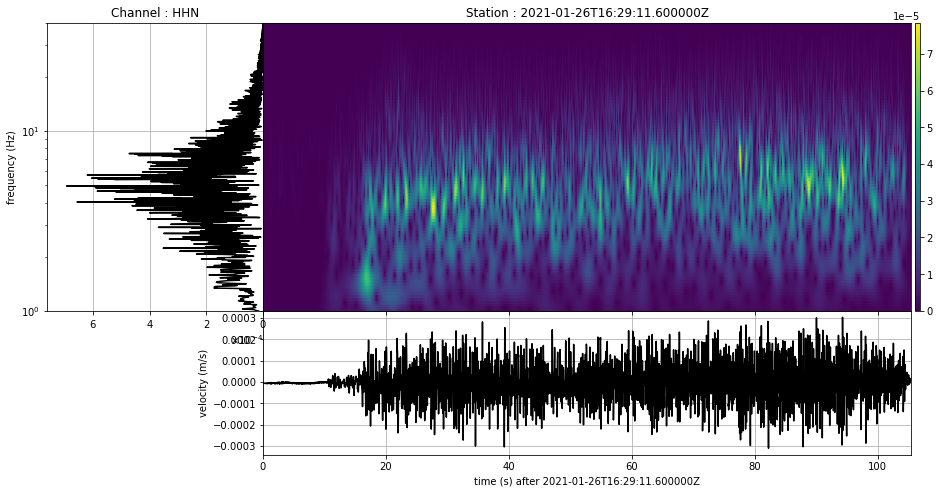

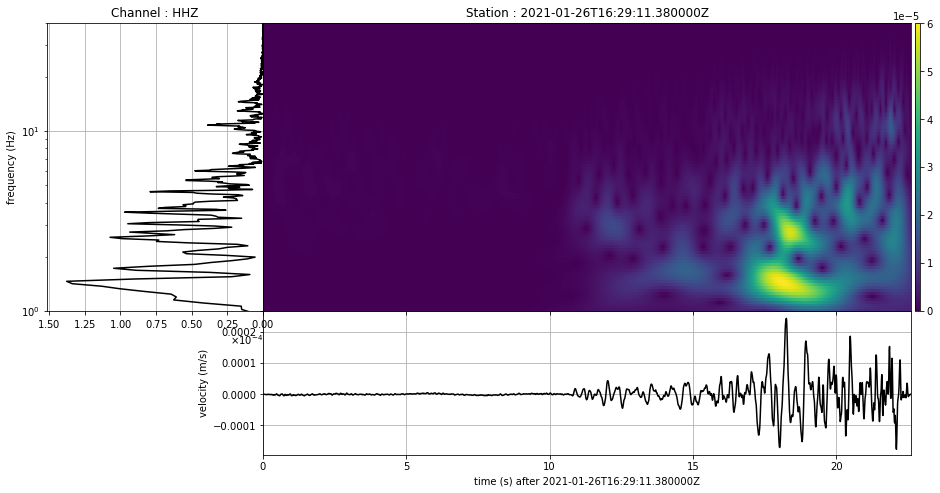

In [ ]:
# MELAB
for i in range(len(melab)):
    mc.plot_tfr(
    melab[i].data, 
    tr=melab[i],
    fmin=1.0,
    fmax=40.0,
    dt=melab[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

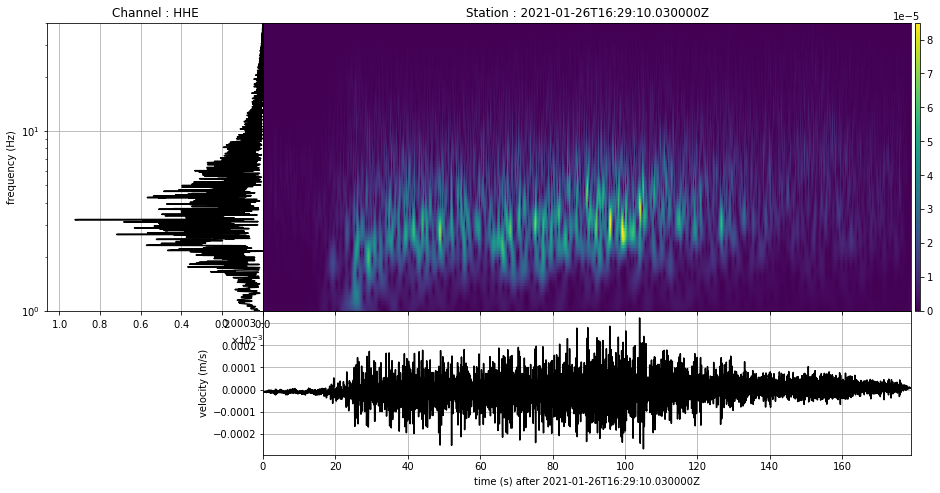

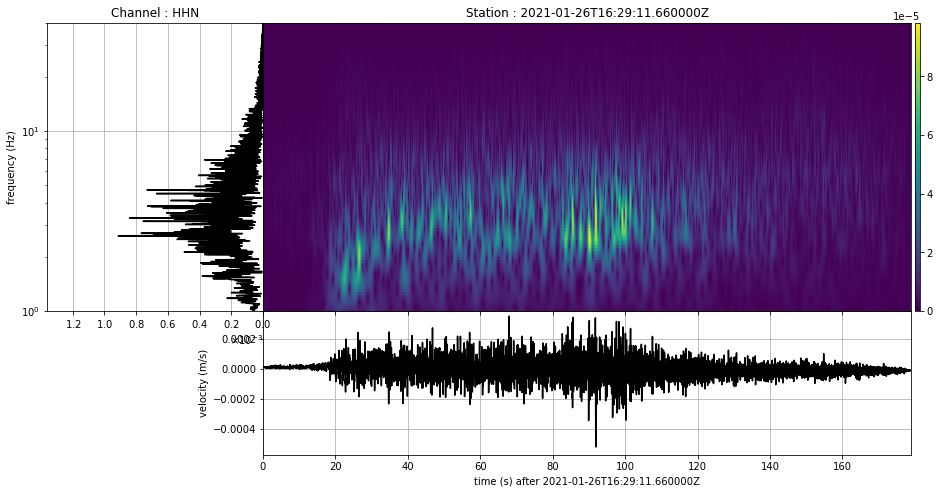

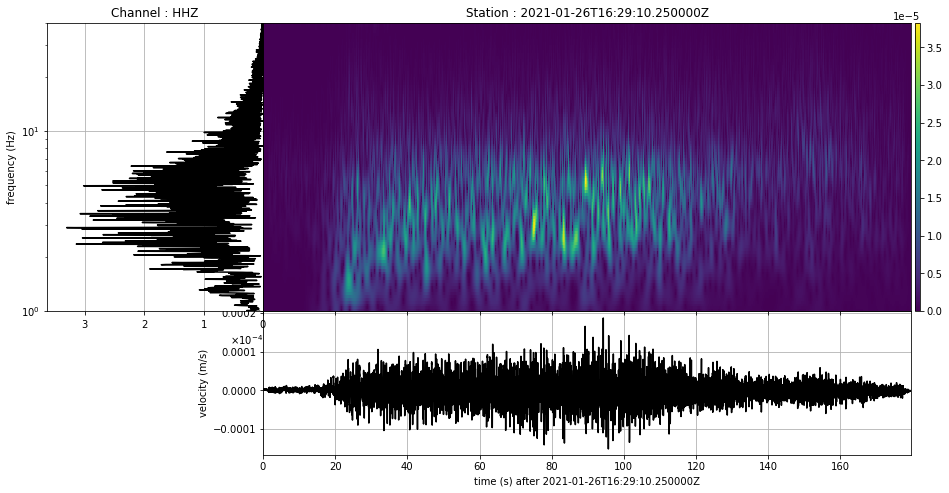

In [ ]:
# MEJRO
for i in range(len(mejro)):
    mc.plot_tfr(
    mejro[i].data, 
    tr=mejro[i],
    fmin=1.0,
    fmax=40.0,
    dt=mejro[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

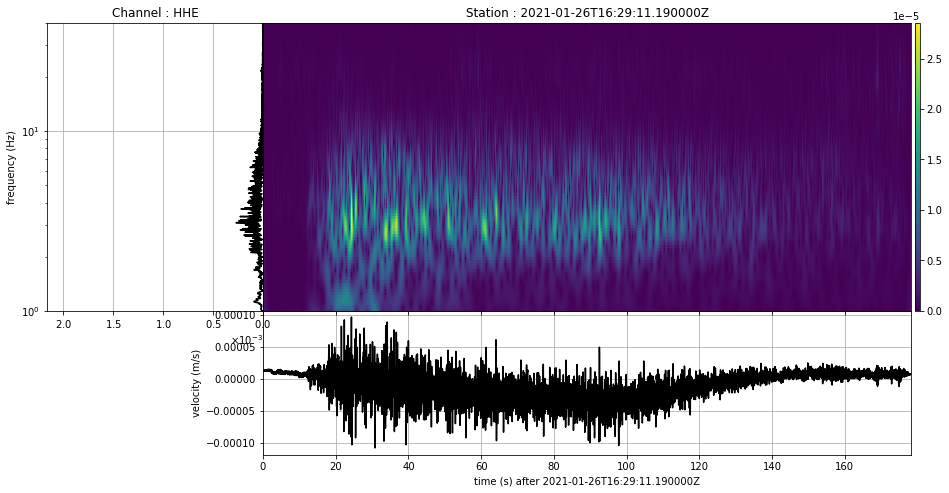

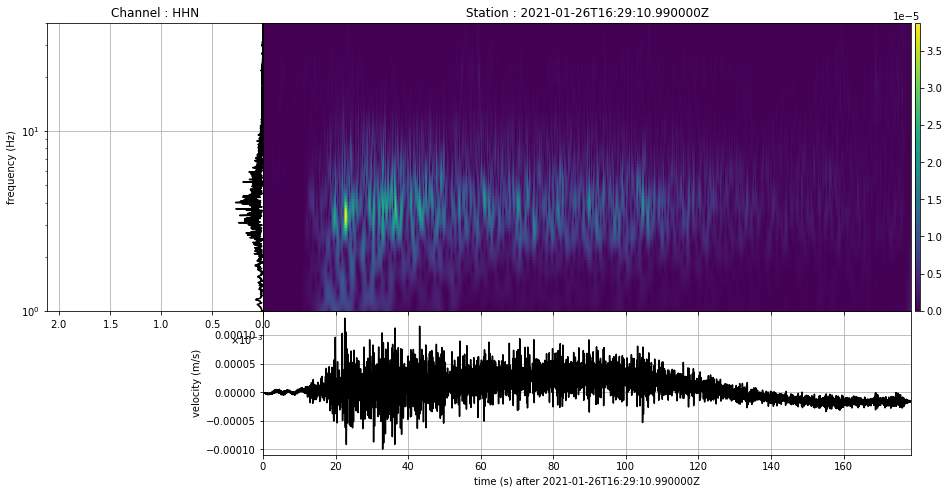

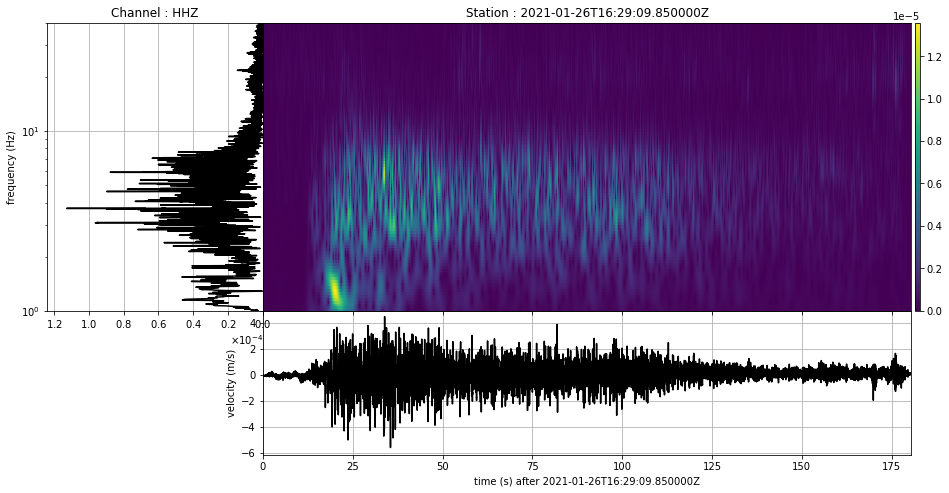

In [ ]:
# MEGRA
for i in range(len(megra)):
    mc.plot_tfr(
    megra[i].data, 
    tr=megra[i],
    fmin=1.0,
    fmax=40.0,
    dt=megra[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

#### Data Filter

In [135]:
mepas = mepas.filter('bandpass', freqmin = 1.0, freqmax=12.0)
melab = melab.filter('bandpass', freqmin = 1.0, freqmax=12.0)
mejro = mejro.filter('bandpass', freqmin = 1.0, freqmax=12.0)
megra = megra.filter('bandpass', freqmin = 1.0, freqmax=12.0)

#### Spectrogram After Filter

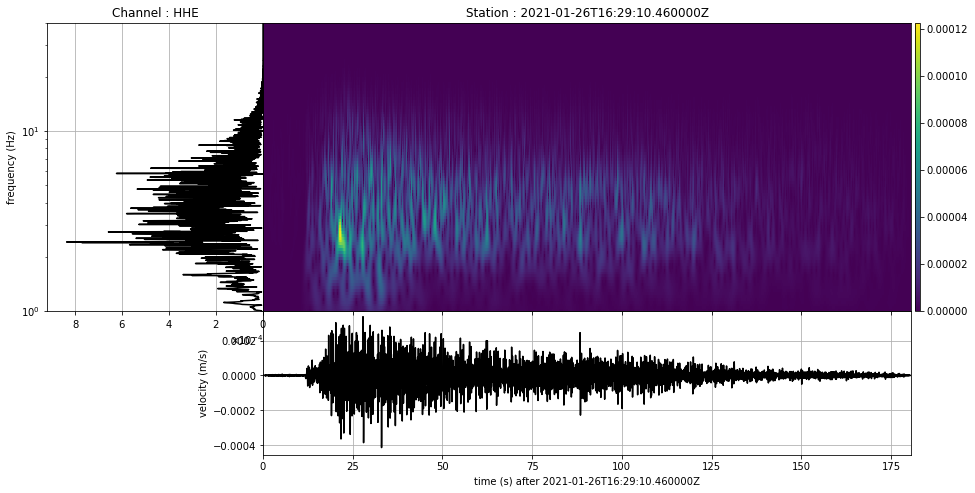

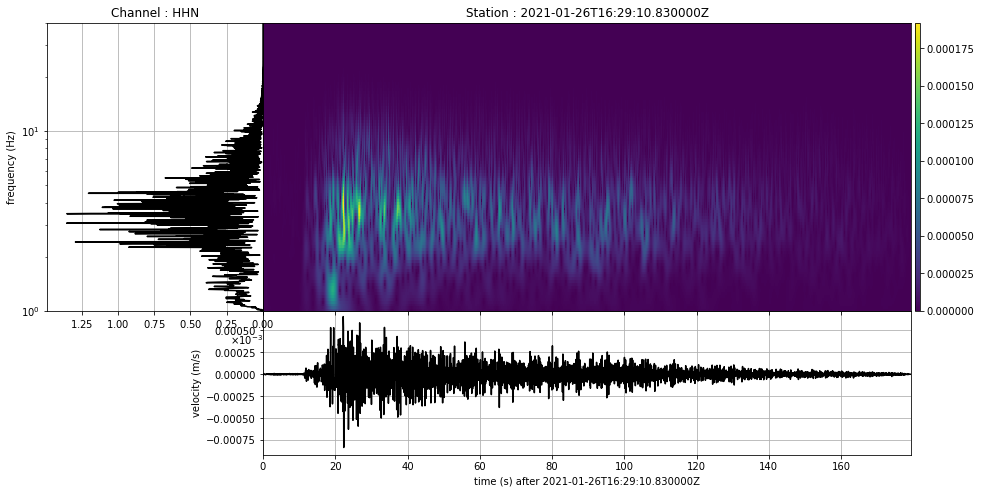

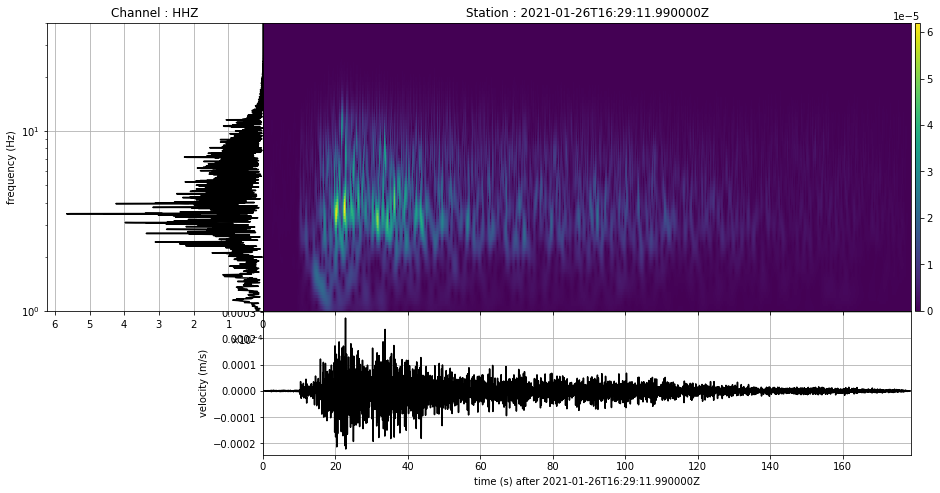

In [ ]:
# MEPAS
for i in range(len(mepas)):
    mc.plot_tfr(
    mepas[i].data, 
    tr=mepas[i],
    fmin=1.0,
    fmax=40.0,
    dt=mepas[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

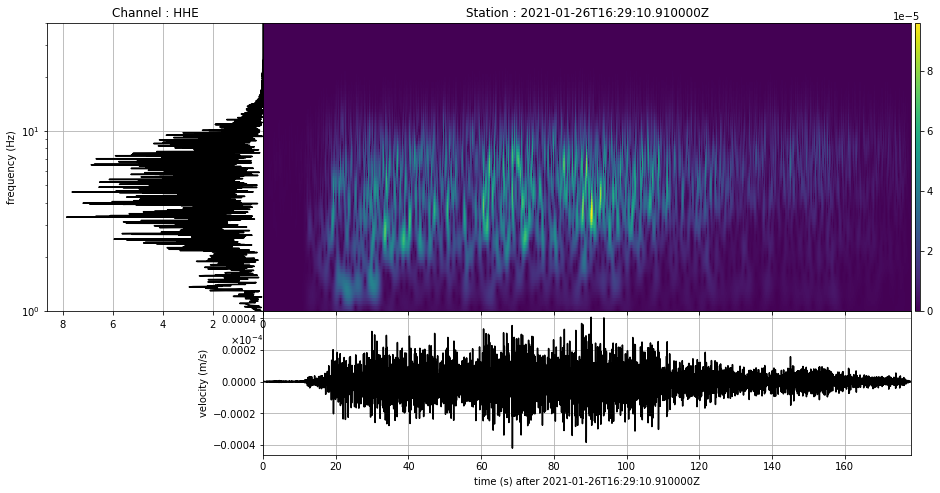

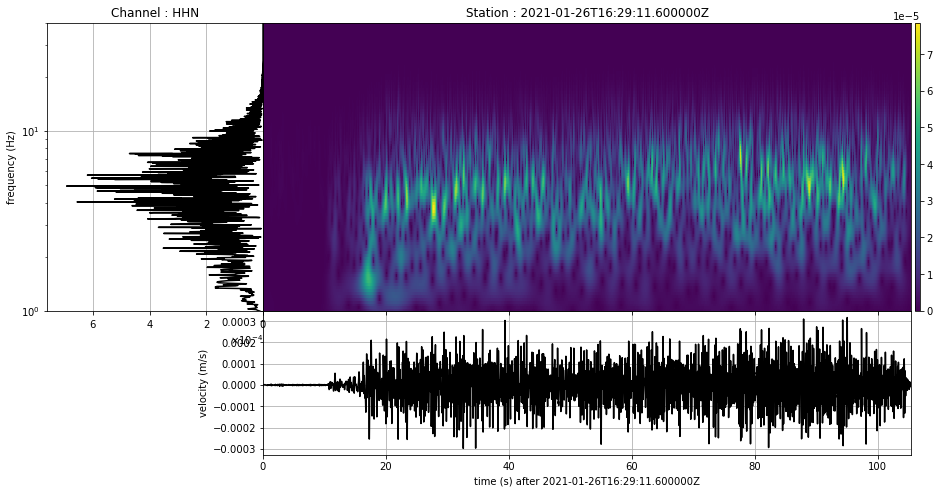

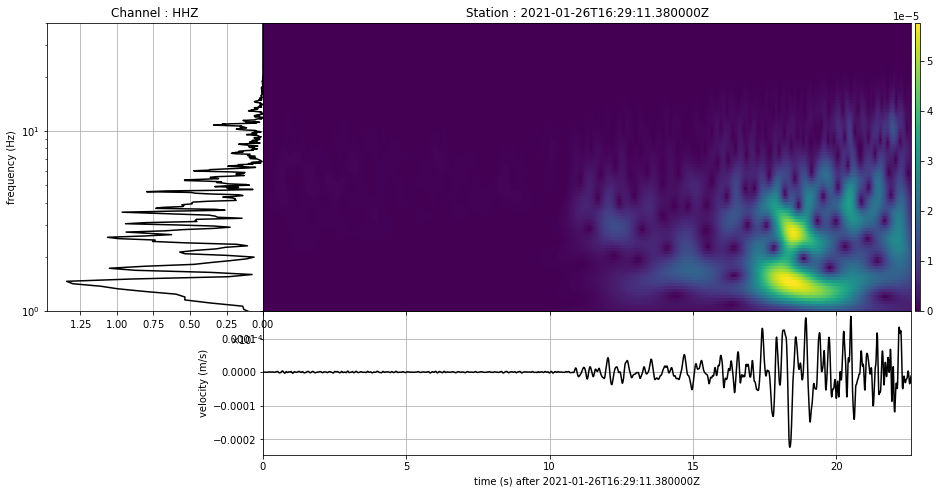

In [ ]:
# MELAB
for i in range(len(melab)):
    mc.plot_tfr(
    melab[i].data, 
    tr=melab[i],
    fmin=1.0,
    fmax=40.0,
    dt=melab[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

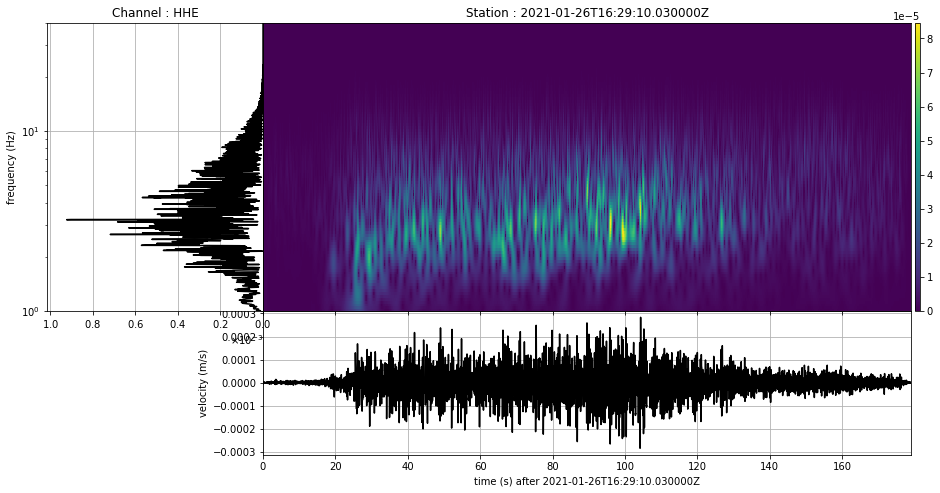

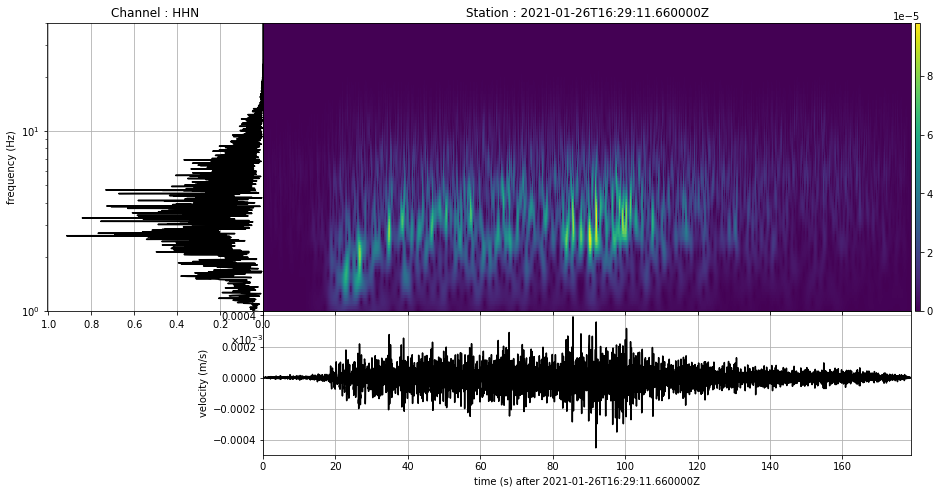

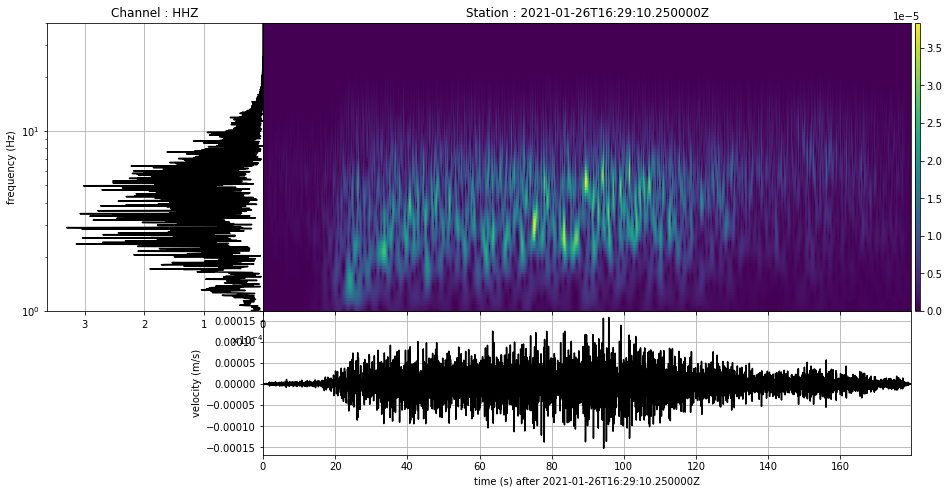

In [ ]:
# MEJRO
for i in range(len(mejro)):
    mc.plot_tfr(
    mejro[i].data, 
    tr=mejro[i],
    fmin=1.0,
    fmax=40.0,
    dt=mejro[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

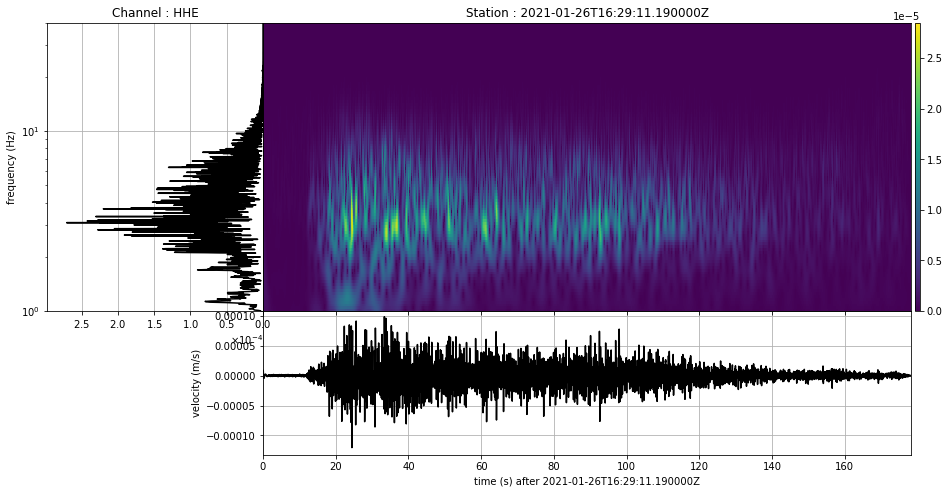

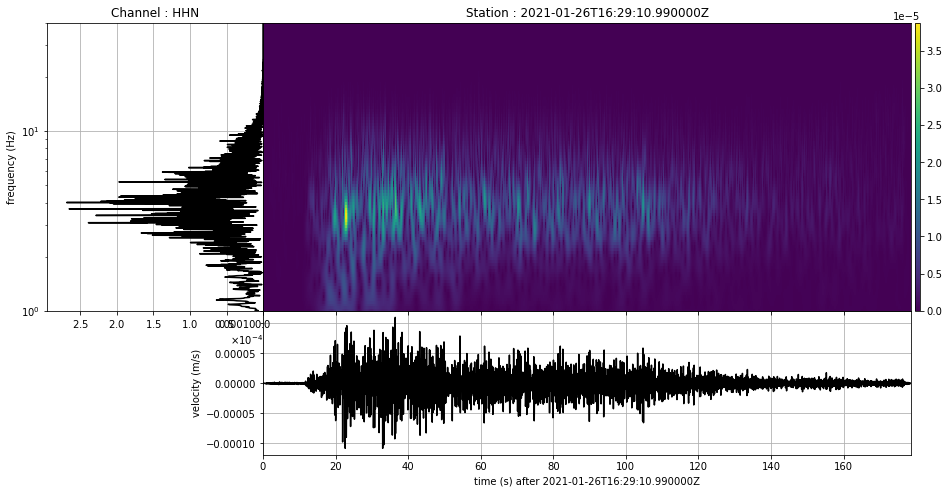

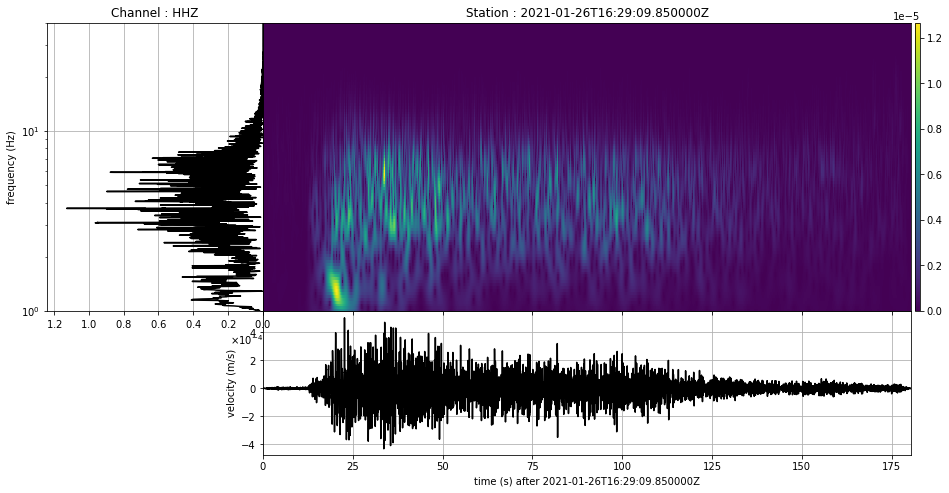

In [ ]:
# MEGRA
for i in range(len(megra)):
    mc.plot_tfr(
    megra[i].data, 
    tr=megra[i],
    fmin=1.0,
    fmax=40.0,
    dt=megra[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

### Particle Motion

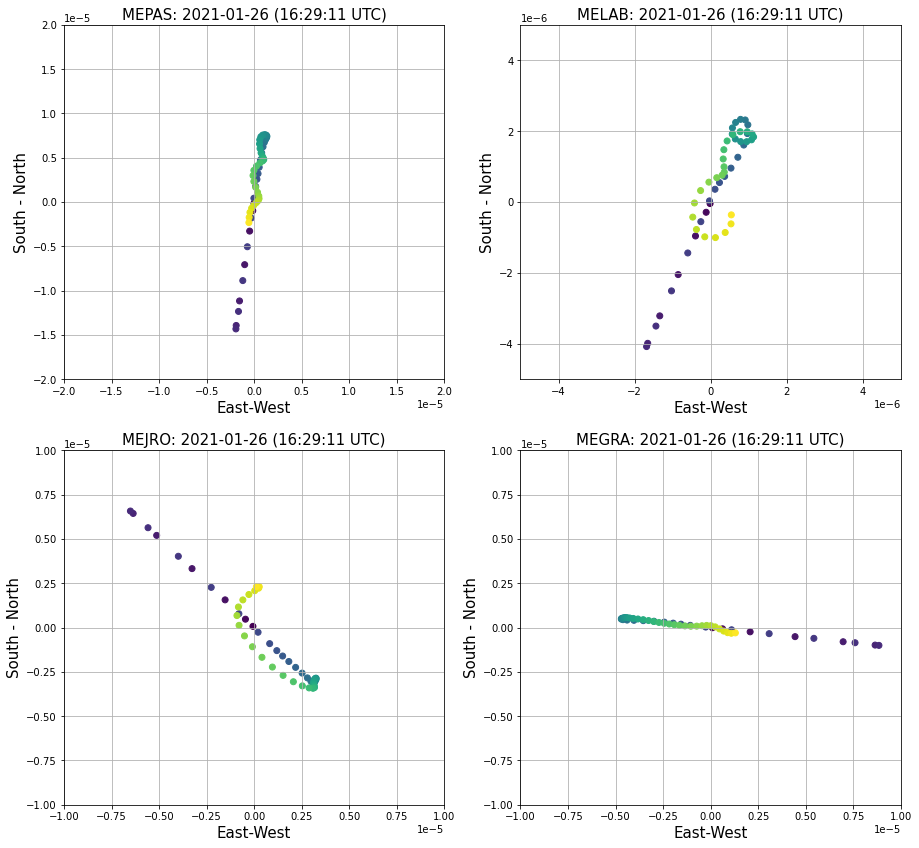

In [136]:
mepas_pm = mepas.copy()
melab_pm = melab.copy()
mejro_pm = mejro.copy()
megra_pm = megra.copy()

st_pm = mepas_pm+melab_pm+mejro_pm+megra_pm
for i in range(len(st_pm)):
  st_pm[i].trim(starttime=st_pm[i].stats.starttime, endtime=st_pm[i].stats.starttime+0.5)
for tr in st_pm.select(channel='HHZ'):
  st_pm.remove(tr)

start = mepas_pm[2].stats.starttime

mepas_pm = st_pm.select(station = 'mepas')
mepas_ctime = np.array(mepas_pm[0].times())
melab_pm = st_pm.select(station = 'melab')
melab_ctime = np.array(melab_pm[0].times())
mejro_pm = st_pm.select(station = 'mejro')
mejro_ctime = np.array(mejro_pm[0].times())
megra_pm = st_pm.select(station = 'megra')
megra_ctime = np.array(megra_pm[0].times())

lim = 0.000010

fig = plt.figure(figsize=(15, 30))
ax=fig.add_subplot(421)
ax.set_title('MEPAS: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax.set_xlabel('East-West', fontsize = 15)
ax.set_ylabel('South - North', fontsize = 15)
ax.set_xlim(-0.000020, 0.000020)
ax.set_ylim(-0.000020, 0.000020)
ax.scatter(mepas_pm[0].data, mepas_pm[1].data, marker='o', c=mepas_ctime)

ax1=fig.add_subplot(422)
ax1.set_title('MELAB: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax1.set_xlabel('East-West', fontsize = 15)
ax1.set_ylabel('South - North', fontsize = 15)
ax1.set_xlim(-0.000005, 0.000005)
ax1.set_ylim(-0.000005, 0.000005)
ax1.scatter(melab_pm[0].data, melab_pm[1].data, marker='o', c=melab_ctime)

ax2=fig.add_subplot(423)
ax2.set_title('MEJRO: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax2.set_xlabel('East-West', fontsize = 15)
ax2.set_ylabel('South - North', fontsize = 15)
ax2.set_xlim(-lim, lim)
ax2.set_ylim(-lim, lim)
ax2.scatter(mejro_pm[0].data, mejro_pm[1].data, marker='o', c=mejro_ctime)

ax3=fig.add_subplot(424)
ax3.set_title('MEGRA: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax3.set_xlabel('East-West', fontsize = 15)
ax3.set_ylabel('South - North', fontsize = 15)
ax3.set_xlim(-lim, lim)
ax3.set_ylim(-lim, lim)
ax3.scatter(megra_pm[0].data, megra_pm[1].data, marker='o', c=megra_ctime)

ax.grid()
ax1.grid()
ax2.grid()
ax3.grid()

plt.savefig('Particle Motion - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white', transparent=False)
ax = plt.gca


### Beamforming ⭕

In [137]:
mepas_fk = mepas.copy()
melab_fk = melab.copy()
mejro_fk = mejro.copy()
megra_fk = megra.copy()



st_ = mepas_fk+melab_fk+mejro_fk+megra_fk
st_fk = st_.copy()
st_fk = st_fk.select(channel='HHZ')

In [138]:
fmin = 1.0
fmax = 12.0
slw = 3.0
sl_s = 1.0
win_len = 1.0
win_frac = 0.5

start = []
for i in range(len(st_fk)):
    start.append(st_fk[i].stats.starttime)
end = []
for i in range(len(st_fk)):
    end.append(st_fk[i].stats.endtime)

t0 = max(start)
t1 = min(end)

st_fk = st_fk.trim(t0, t1)

start = st_fk[0].stats.starttime
end = st_fk[0].stats.endtime

kwargs = dict(
    # slowness grid (x,y) and slow step
    sll_x=-slw, slm_x=slw, sll_y=-slw, slm_y=slw, sl_s=sl_s,
    #sliding window
    win_len=win_len, win_frac=win_frac,
    # frequency for bandpass
    frqlow=fmin, frqhigh=fmax, prewhiten=0,
    # semblance
    semb_thres=-1e9, vel_thres=-1e9,
    stime=start, etime=end, method=0)

out = array_processing(stream=st_fk, **kwargs)


# return = timestamp, realtive relpow, abs relpow, baz, slowness

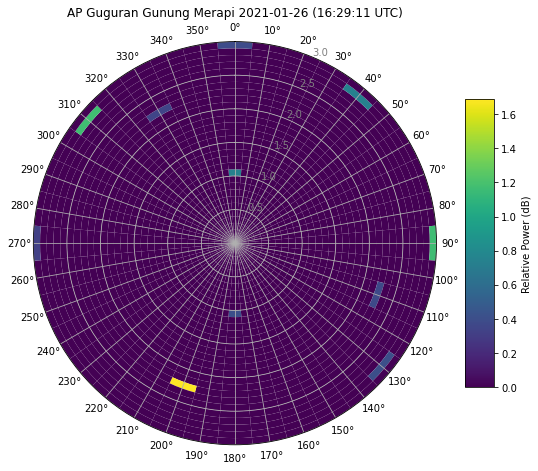

In [139]:
# plotting array

cmap = obspy_sequential

#adjust BAZ into range 0 - 360 degree
t, rel_power, abs_power, baz, slow = out.T
baz[baz<0.0] += 360

df6 = pd.DataFrame({"Time":t, "Backazimuth":baz, "Slowness":slow, 
                    "Relative Power":rel_power
                    
                    })

N=36
N2=30
abins = np.arange(N+1) *360./N
sbins = np.linspace(0, 3, N2+1)

# sum relative power in bins
hist, baz_edges, sl_edges = \
    np.histogram2d(baz, slow, bins=[abins, sbins], weights=rel_power)

# get radians
baz_edges = np.radians(baz_edges)


# polar diagram
fig = plt.figure(figsize=(8,8))
cax = fig.add_axes([0.85, 0.2, 0.05, 0.5])
ax = fig.add_axes([0.10, 0.1, 0.70, 0.70], polar=True)
ax.set_theta_direction(-1)
ax.set_theta_zero_location('N')

dh = abs(sl_edges[1]-sl_edges[0])
dw = abs(baz_edges[1]-baz_edges[0])

for i, row in enumerate(hist):
    bars = ax.bar((i*dw) * np.ones(N2),
                   height=dh*np.ones(N2),
                   width=dw, bottom=dh*np.arange(N2),
                   color=cmap(row/hist.max()))
    
ax.set_xticks(np.linspace(0, 2*np.pi, 36, endpoint=False))
ax.set_title('AP Guguran Gunung Merapi %s' %(start.strftime('%Y-%m-%d (%H:%M:%S UTC)'),))

# slowness limit
ax.set_ylim(0,3)
[i.set_color('grey') for i in ax.get_yticklabels()]
ColorbarBase(cax, cmap=cmap, norm=Normalize(vmin=hist.min(), vmax=hist.max()), label='Relative Power (dB)')

plt.savefig('Polar Plot - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white')
plt.show()

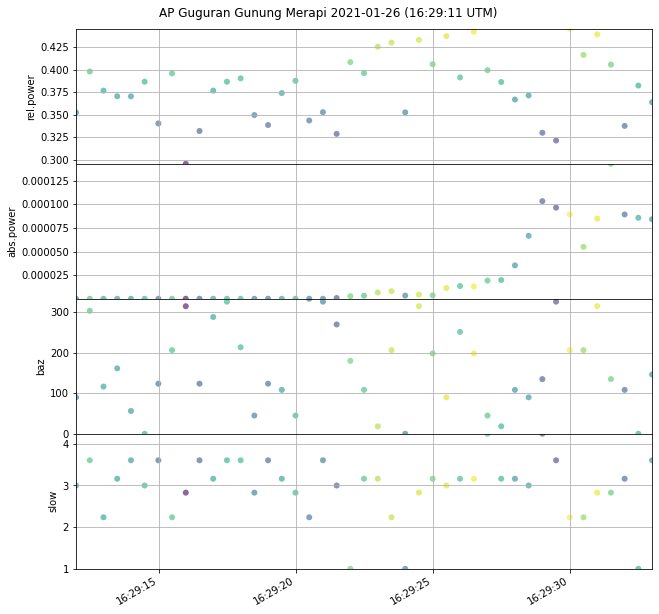

In [ ]:
# plot
labels = ['rel.power', 'abs.power', 'baz', 'slow']
xlocator = mdates.AutoDateLocator()
fig = plt.figure(figsize=(10,10))
for i, lab in enumerate(labels):
    ax = fig.add_subplot(4, 1, i + 1)
    ax.scatter(out[:, 0], out[:, i + 1], c=out[:, 1], alpha=0.6,
               edgecolors='none', cmap=obspy_sequential)
    ax.set_ylabel(lab)
    ax.set_xlim(out[0, 0], out[-1, 0])
    ax.set_ylim(out[:, i + 1].min(), out[:, i + 1].max())
    ax.xaxis.set_major_locator(xlocator)
    ax.xaxis.set_major_formatter(mdates.AutoDateFormatter(xlocator))
    ax.grid()
    
fig.suptitle('AP Guguran Gunung Merapi %s' % (start.strftime('%Y-%m-%d (%H:%M:%S UTC)'), ))
fig.autofmt_xdate()
fig.subplots_adjust(left=0.15, top=0.95, right=0.95, bottom=0.2, hspace=0)

plt.savefig('Plot - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white')
plt.show()

# **Southeast Event**

In [22]:
data_se = pd.read_excel(r'data_event.xlsx', 
                     sheet_name="SE", converters={'TIme':int},
                     convert_float=False, dtype='str')
data_se

,Time,Duration,Direction
0,2021-07-04T04:44:32.000000Z,87.0,SE
1,2021-07-04T09:26:55.000000Z,108.0,SE
2,2021-07-04T09:51:20.000000Z,76.0,SE
3,2021-07-04T11:14:45.000000Z,107.0,W
4,2021-07-04T13:21:35.000000Z,92.0,SE
5,2021-07-04T15:19:05.000000Z,74.0,SE


In [23]:
data_time = data_se['Time'].tolist()
data_duration = data_se['Duration'].tolist()
data_direction = data_se['Direction'].tolist()

In [24]:
# TIME FOR EVENT 185
time0 = utc(data_time[0])
time1 = utc(data_time[1])
time2 = utc(data_time[2])
time3 = utc(data_time[3])
time4 = utc(data_time[4])
time5 = utc(data_time[5])

# DURATION
time00 = int(float(data_duration[0]))
time01 = int(float(data_duration[1]))
time02 = int(float(data_duration[2]))
time03 = int(float(data_duration[3]))
time04 = int(float(data_duration[4]))
time05 = int(float(data_duration[5]))


## 1 | (2021-07-04 | 04:44:00) | SE

In [143]:
chID = 'ENZ'
direction = 'SE'
path = 'data/'+direction

st=read(path+"/VG.*"+".D.20*"+".MSEED", type='MSEED')

st = st.sort()
st


125 Trace(s) in Stream:

VG.MEGRA.00.HHE | 2021-07-04T00:00:03.530000Z - 2021-07-04T21:28:32.990000Z | 100.0 Hz, 7730947 samples
...
(123 other traces)
...
VG.MEPAS.00.HHZ | 2021-07-04T10:14:31.000000Z - 2021-07-05T00:00:01.510000Z | 100.0 Hz, 4953052 samples

[Use "print(Stream.__str__(extended=True))" to print all Traces]

In [144]:
time_s = time0
time_e = time_s + time00
print('duration:', time00)

st0 = st.copy()
st0 = st0.trim(starttime=time_s, endtime=time_e)

duration: 87


### MEPAS

In [145]:
station = 'mepas'
mepas = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

mepas = mepas.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
mepas

3 Trace(s) in Stream:
VG.MEPAS.00.HHE | 2021-07-04T04:44:32.000000Z - 2021-07-04T04:45:59.000000Z | 100.0 Hz, 8701 samples
VG.MEPAS.00.HHN | 2021-07-04T04:44:32.000000Z - 2021-07-04T04:45:59.000000Z | 100.0 Hz, 8701 samples
VG.MEPAS.00.HHZ | 2021-07-04T04:44:32.000000Z - 2021-07-04T04:45:59.000000Z | 100.0 Hz, 8701 samples

In [146]:
for i in range(len(mepas)):
    mepas[i].stats.coordinates = AttribDict({'latitude':-7.535567,
                                             'longitude':110.449185,
                                             'elevation':2679})

### MELAB

In [147]:
station = 'melab'
melab = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

melab = melab.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
melab

3 Trace(s) in Stream:
VG.MELAB.00.HHE | 2021-07-04T04:44:32.000000Z - 2021-07-04T04:45:59.000000Z | 100.0 Hz, 8701 samples
VG.MELAB.00.HHN | 2021-07-04T04:44:32.000000Z - 2021-07-04T04:45:59.000000Z | 100.0 Hz, 8701 samples
VG.MELAB.00.HHZ | 2021-07-04T04:44:32.000000Z - 2021-07-04T04:45:59.000000Z | 100.0 Hz, 8701 samples

In [148]:
for i in range(len(melab)):
    melab[i].stats.coordinates = AttribDict({'latitude':-7.557044,
                                         'longitude':110.445038,
                                         'elevation':1730})

### MEJRO

In [149]:
station = 'mejro'
mejro = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

mejro = mejro.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
mejro

3 Trace(s) in Stream:
VG.MEJRO.00.HHE | 2021-07-04T04:44:32.000000Z - 2021-07-04T04:45:59.000000Z | 100.0 Hz, 8701 samples
VG.MEJRO.00.HHN | 2021-07-04T04:44:32.000000Z - 2021-07-04T04:45:59.000000Z | 100.0 Hz, 8701 samples
VG.MEJRO.00.HHZ | 2021-07-04T04:44:32.000000Z - 2021-07-04T04:45:59.000000Z | 100.0 Hz, 8701 samples

In [150]:
for i in range(len(mejro)):
    mejro[i].stats.coordinates = AttribDict({'latitude':-7.555357,
                                         'longitude':110.419287,
                                         'elevation':1335})

### MEGRA

In [151]:
station = 'megra'
megra = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

megra = megra.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
megra

3 Trace(s) in Stream:
VG.MEGRA.00.HHE | 2021-07-04T04:44:32.000000Z - 2021-07-04T04:45:59.000000Z | 100.0 Hz, 8701 samples
VG.MEGRA.00.HHN | 2021-07-04T04:44:32.000000Z - 2021-07-04T04:45:59.000000Z | 100.0 Hz, 8701 samples
VG.MEGRA.00.HHZ | 2021-07-04T04:44:32.000000Z - 2021-07-04T04:45:59.000000Z | 100.0 Hz, 8701 samples

In [152]:
for i in range(len(megra)):
    megra[i].stats.coordinates = AttribDict({'latitude':-7.52163,
                                         'longitude':110.45149,
                                         'elevation':2045})

### Signal Analysis

#### Spectrogram Before Filter

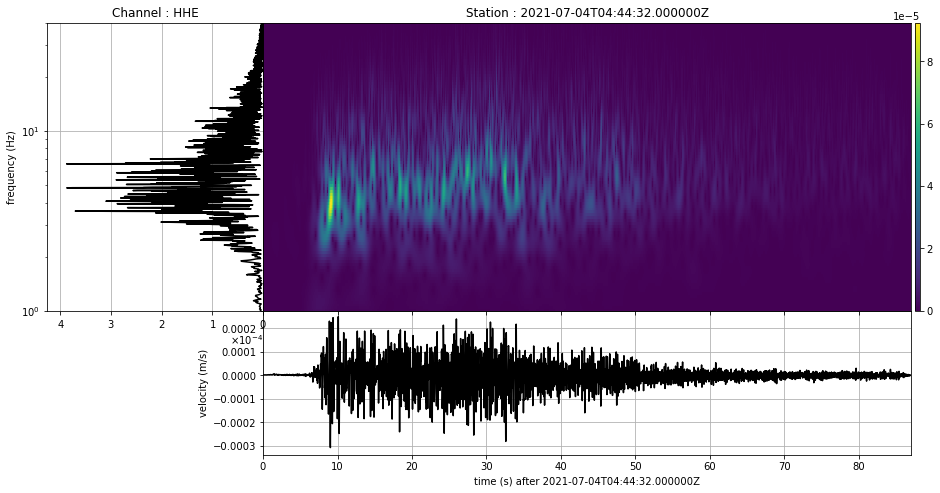

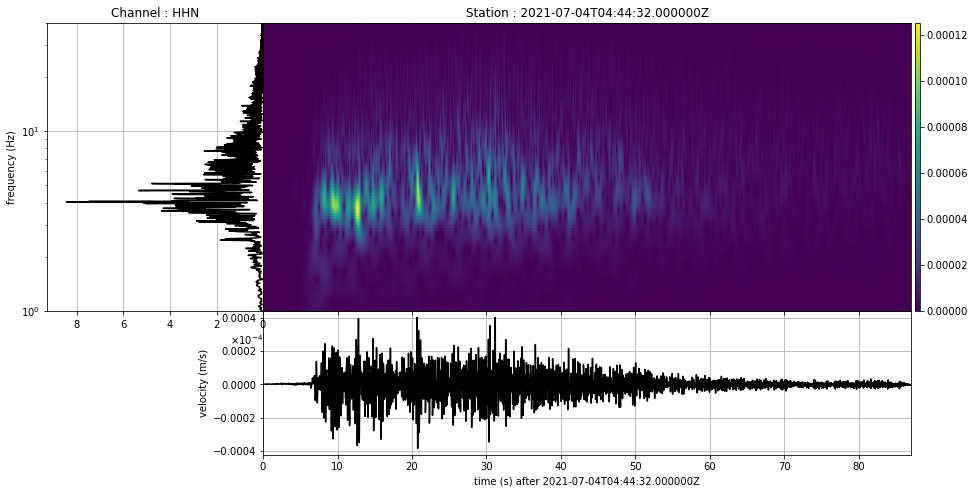

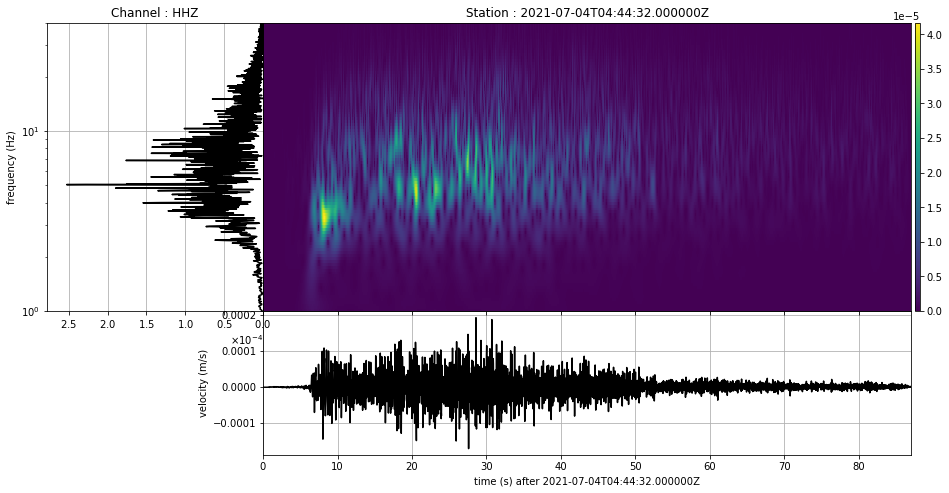

In [ ]:
# MEPAS
for i in range(len(mepas)):
    mc.plot_tfr(
    mepas[i].data, 
    tr=mepas[i],
    fmin=1.0,
    fmax=40.0,
    dt=mepas[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

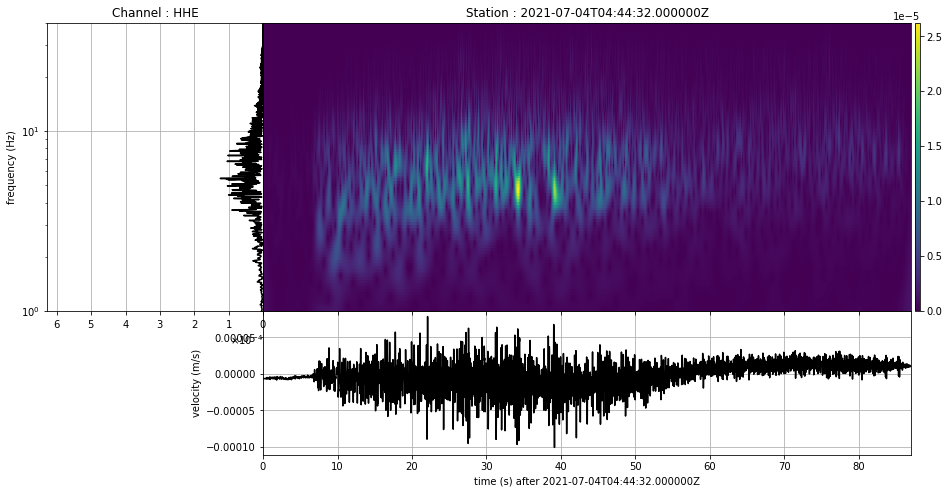

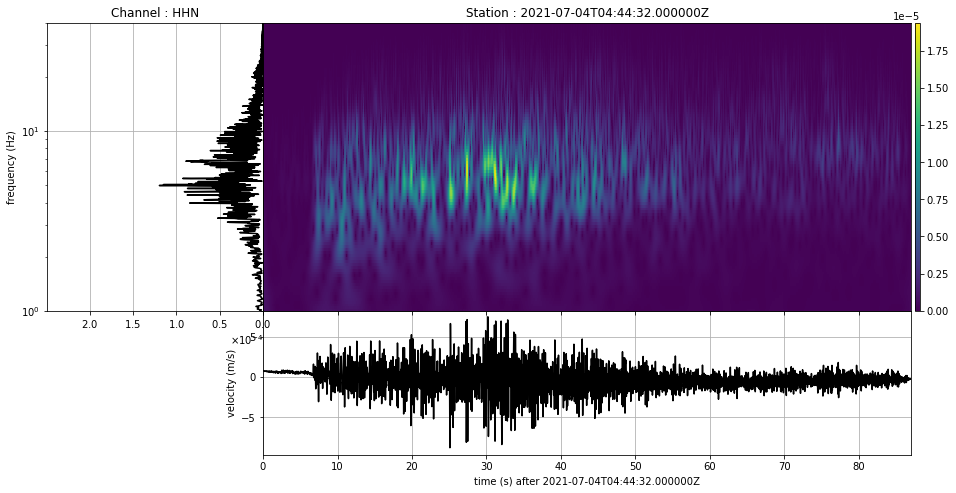

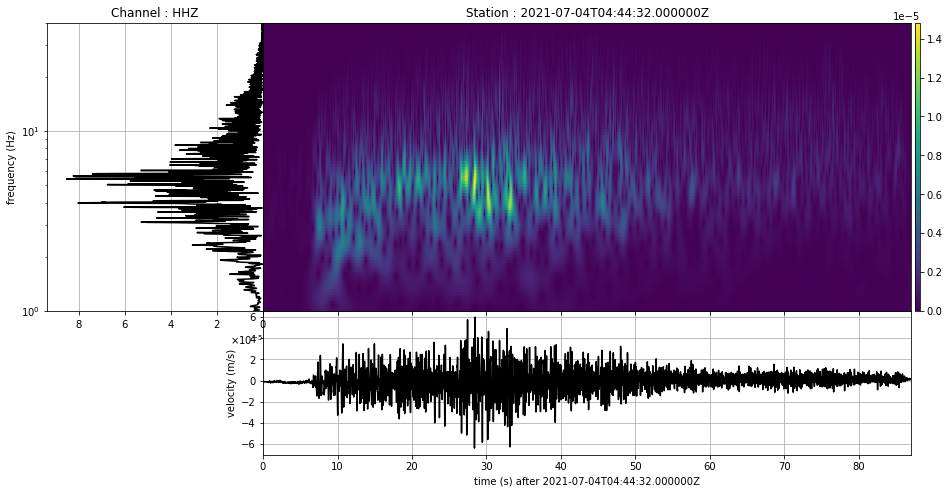

In [ ]:
# MELAB
for i in range(len(melab)):
    mc.plot_tfr(
    melab[i].data, 
    tr=melab[i],
    fmin=1.0,
    fmax=40.0,
    dt=melab[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

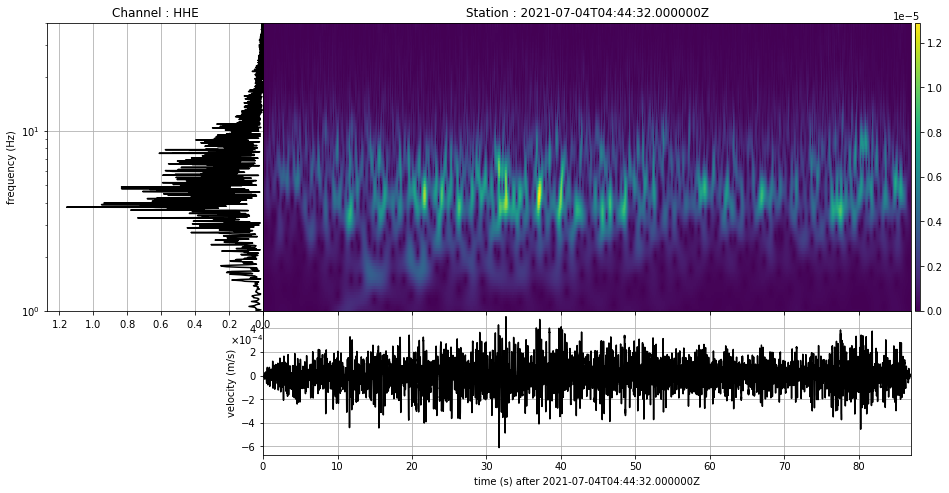

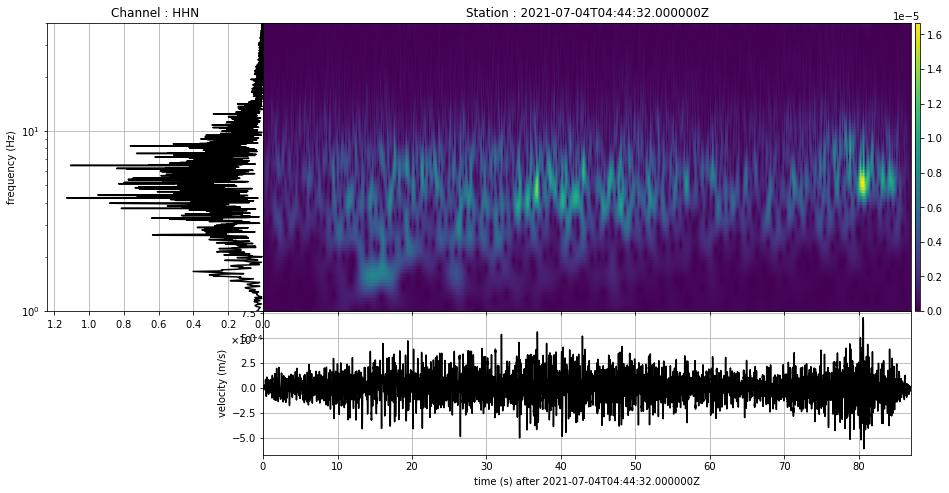

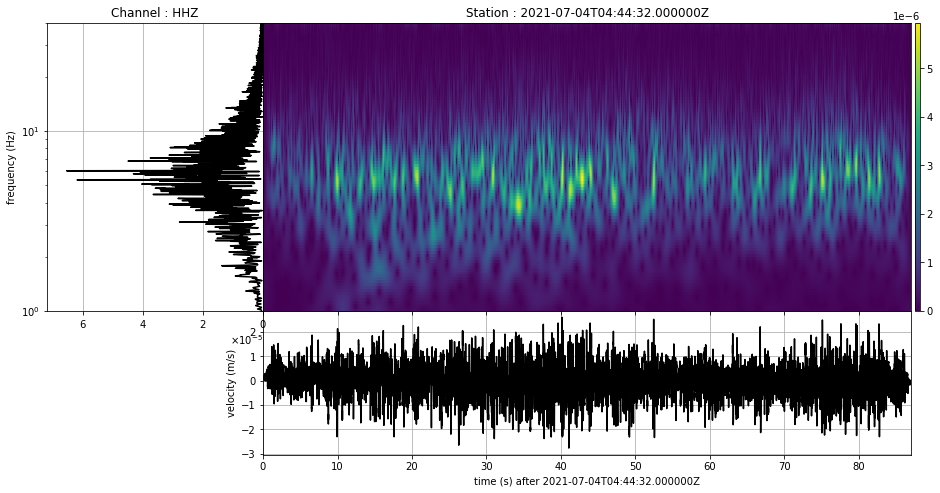

In [ ]:
# MEJRO
for i in range(len(mejro)):
    mc.plot_tfr(
    mejro[i].data, 
    tr=mejro[i],
    fmin=1.0,
    fmax=40.0,
    dt=mejro[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

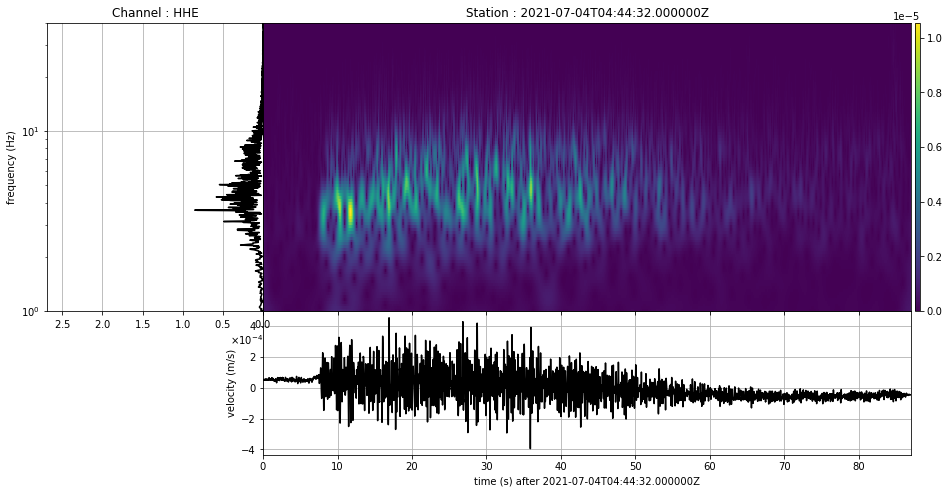

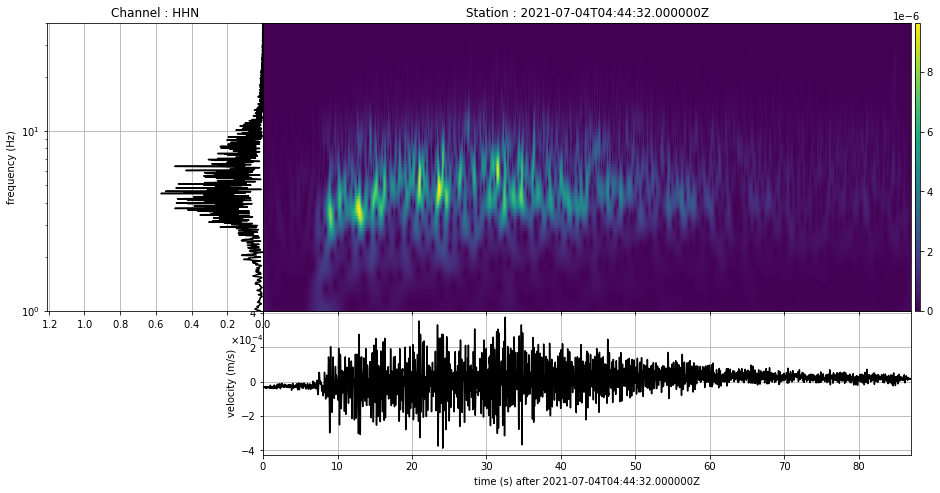

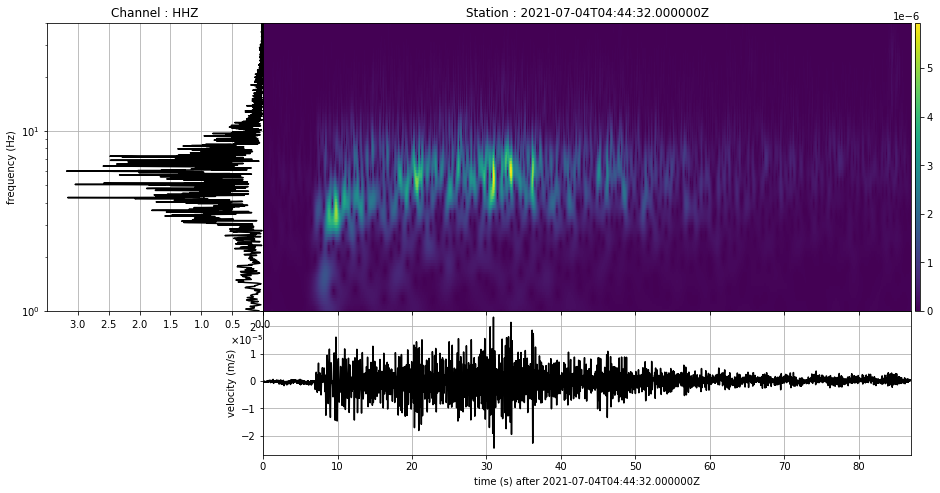

In [ ]:
# MEGRA
for i in range(len(megra)):
    mc.plot_tfr(
    megra[i].data, 
    tr=megra[i],
    fmin=1.0,
    fmax=40.0,
    dt=megra[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

#### Data Filter

In [154]:
mepas = mepas.filter('bandpass', freqmin = 1.0, freqmax=12.0)
melab = melab.filter('bandpass', freqmin = 1.0, freqmax=12.0)
mejro = mejro.filter('bandpass', freqmin = 1.0, freqmax=12.0)
megra = megra.filter('bandpass', freqmin = 1.0, freqmax=12.0)

#### Spectrogram After Filter

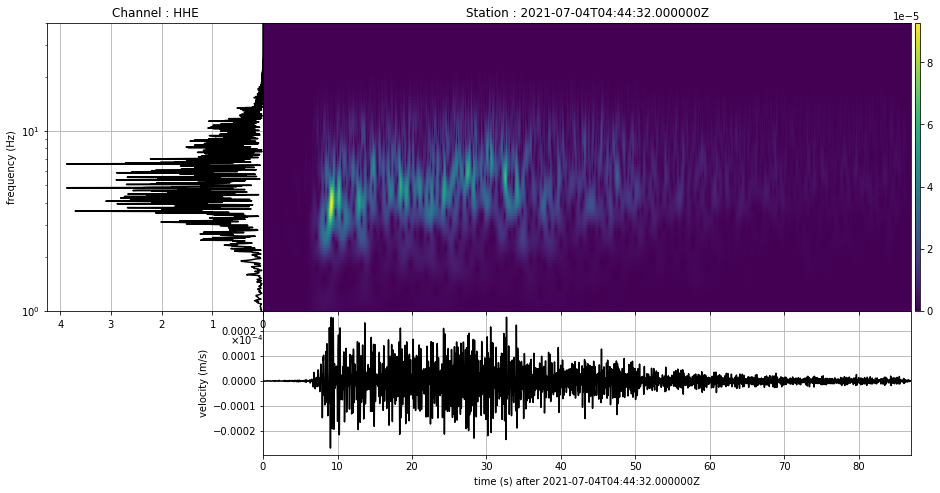

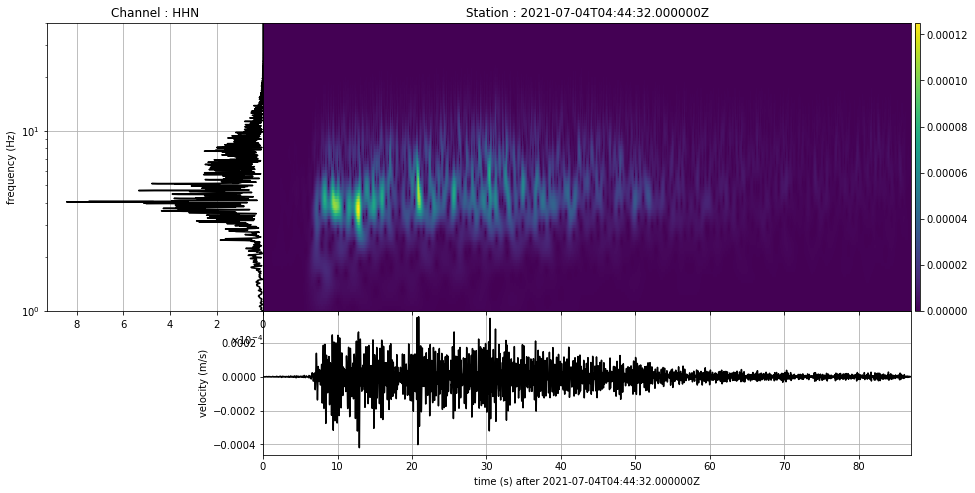

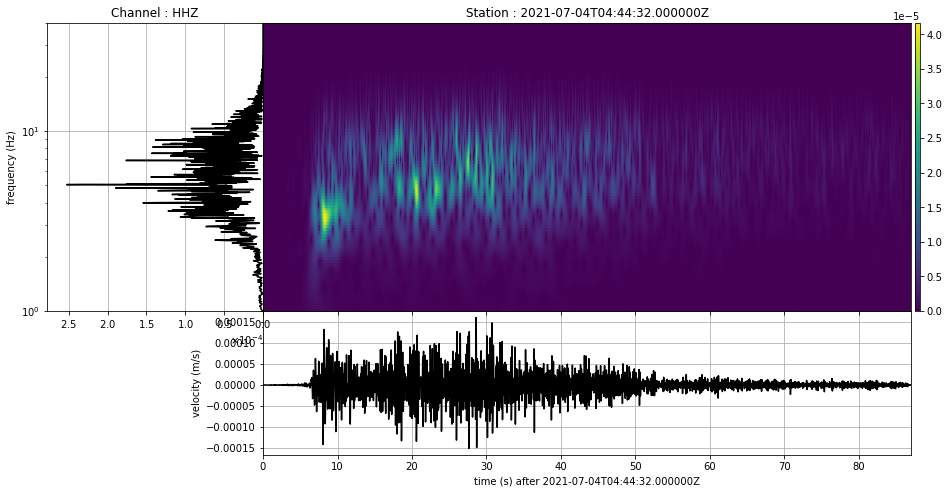

In [ ]:
# MEPAS
for i in range(len(mepas)):
    mc.plot_tfr(
    mepas[i].data, 
    tr=mepas[i],
    fmin=1.0,
    fmax=40.0,
    dt=mepas[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

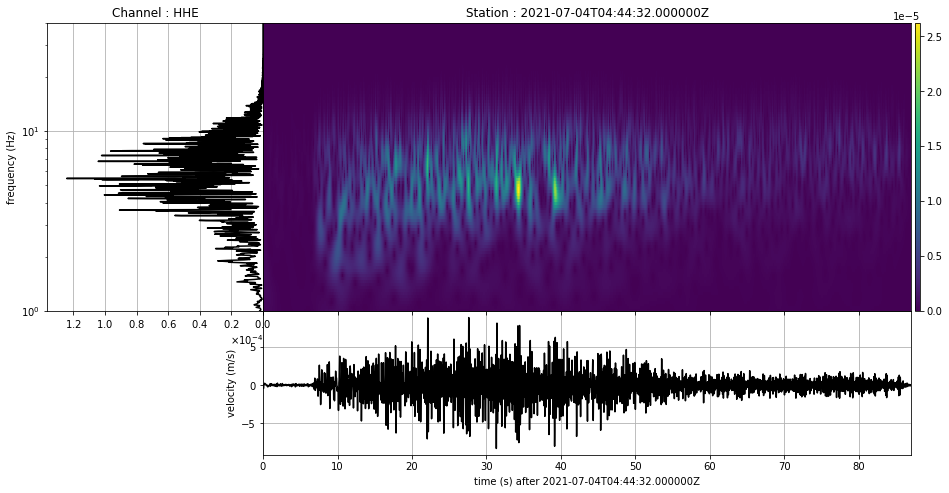

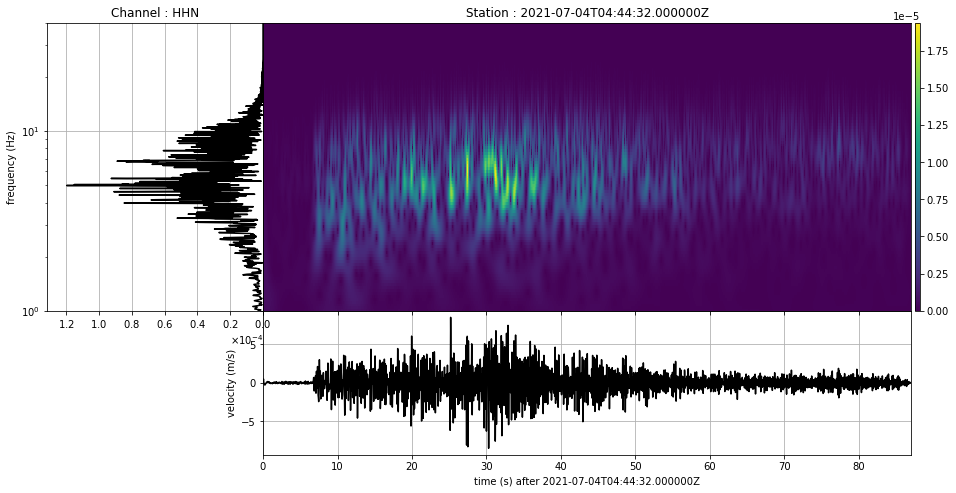

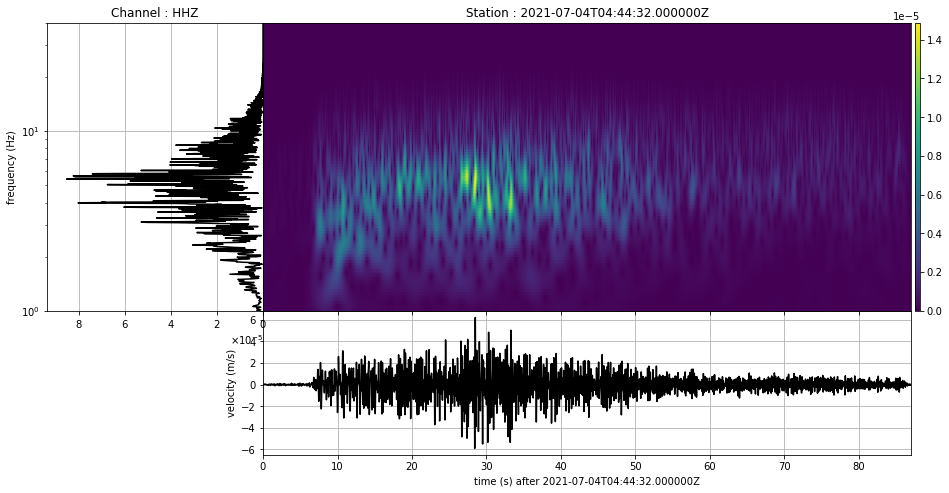

In [ ]:
# MELAB
for i in range(len(melab)):
    mc.plot_tfr(
    melab[i].data, 
    tr=melab[i],
    fmin=1.0,
    fmax=40.0,
    dt=melab[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

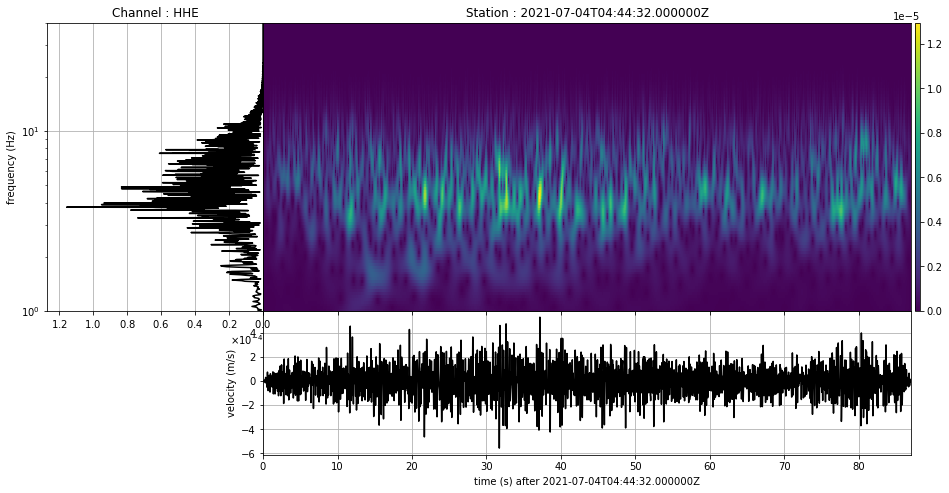

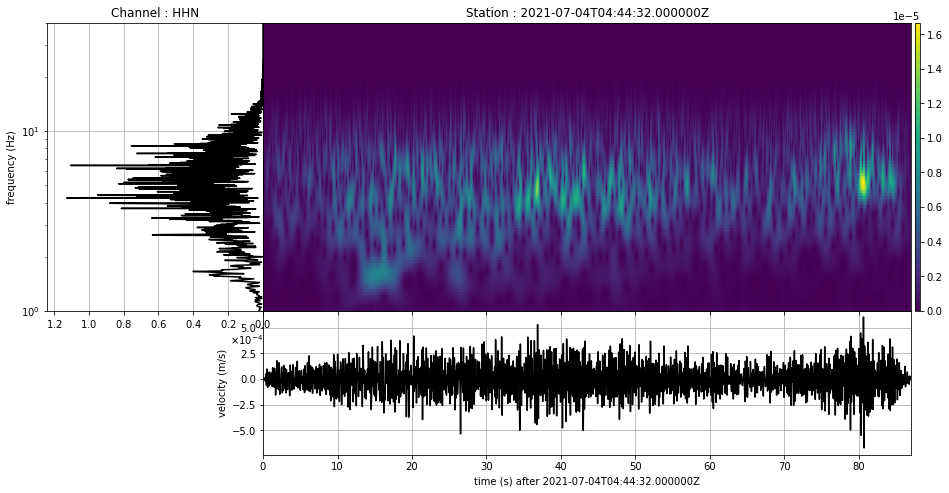

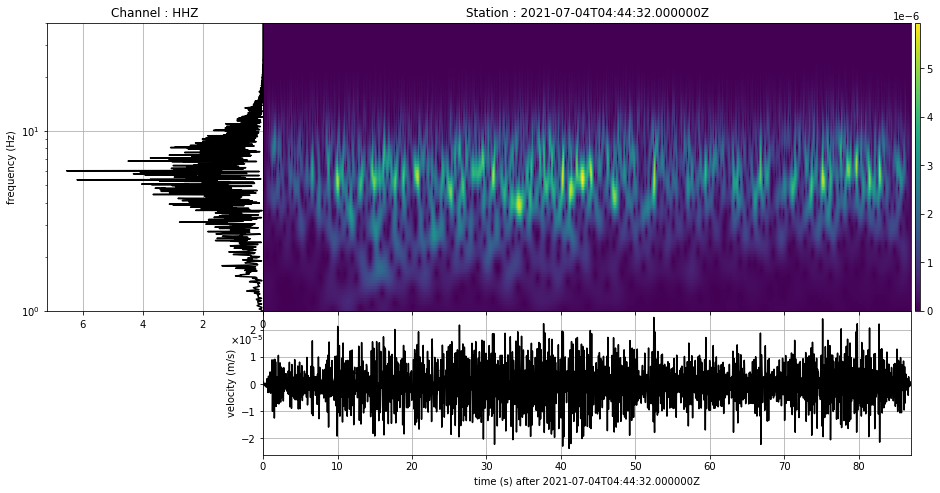

In [ ]:
# MEJRO
for i in range(len(mejro)):
    mc.plot_tfr(
    mejro[i].data, 
    tr=mejro[i],
    fmin=1.0,
    fmax=40.0,
    dt=mejro[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

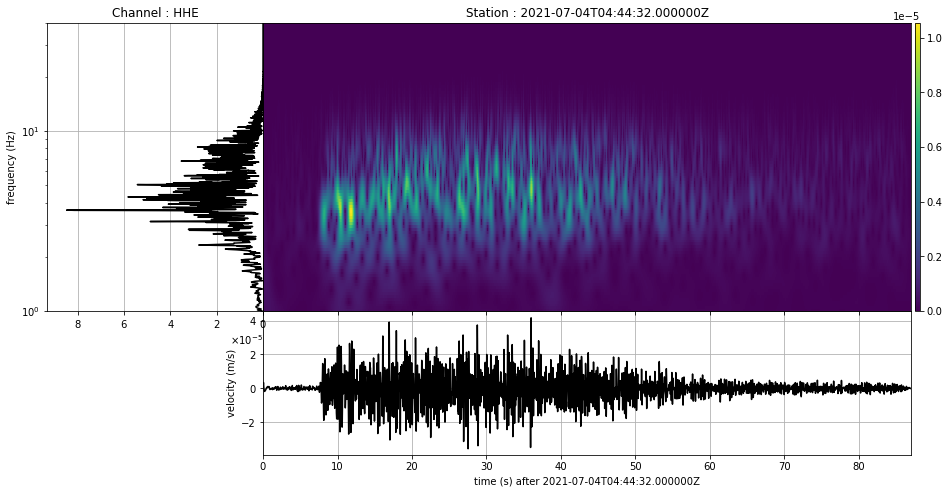

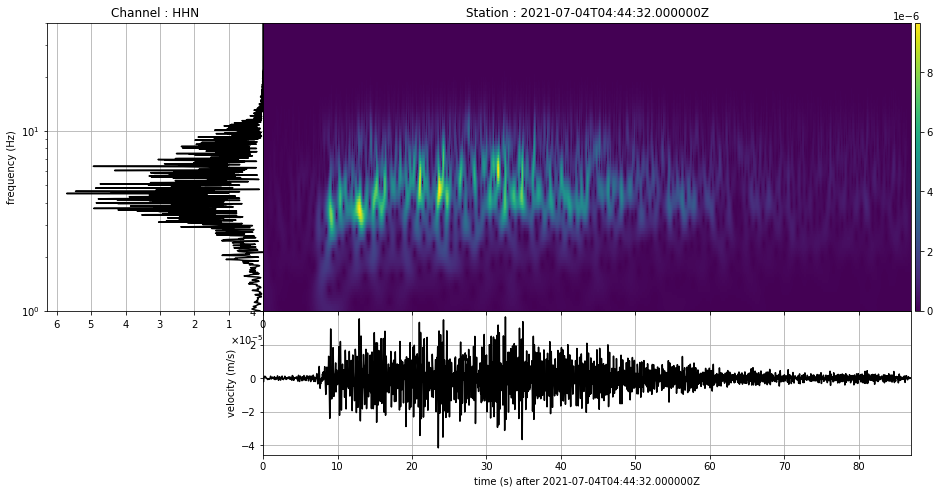

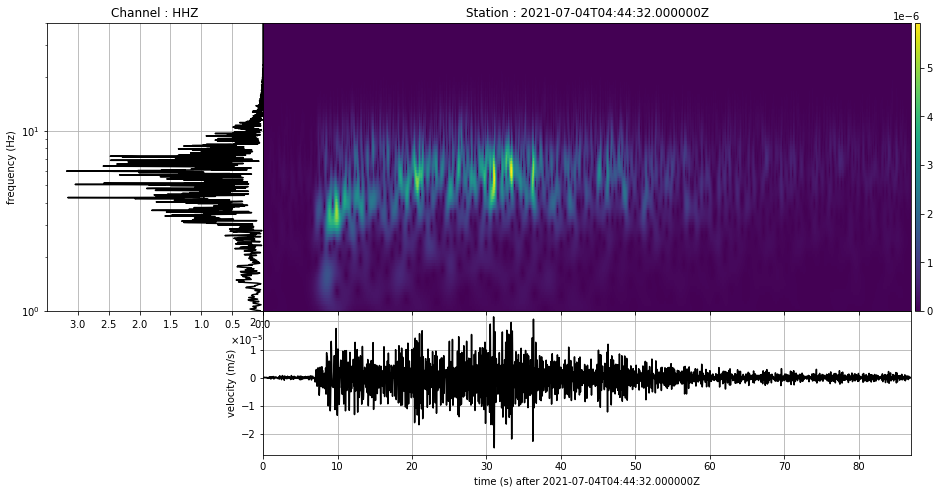

In [ ]:
# MEGRA
for i in range(len(megra)):
    mc.plot_tfr(
    megra[i].data, 
    tr=megra[i],
    fmin=1.0,
    fmax=40.0,
    dt=megra[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

### Particle Motion

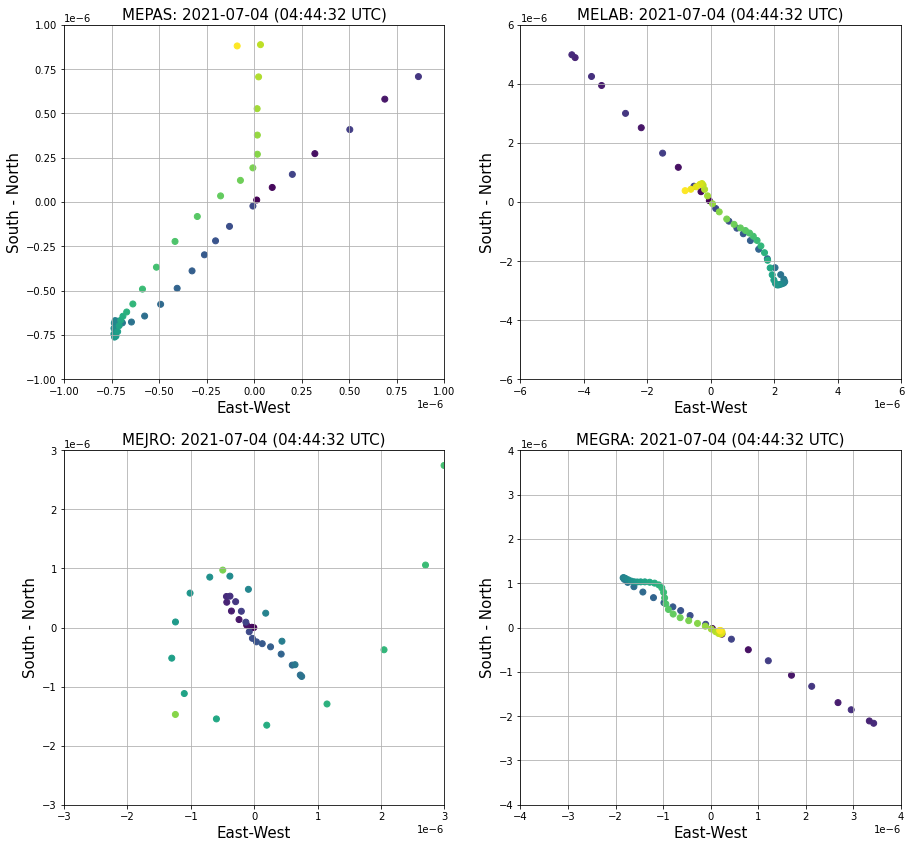

In [155]:
mepas_pm = mepas.copy()
melab_pm = melab.copy()
mejro_pm = mejro.copy()
megra_pm = megra.copy()

st_pm = mepas_pm+melab_pm+mejro_pm+megra_pm

start = st_pm[0].stats.starttime
end_pm = start + 0.5
st_pm = st_pm.trim(starttime=start, endtime=end_pm)

for tr in st_pm.select(channel='HHZ'):
  st_pm.remove(tr)

mepas_pm = st_pm.select(station = 'mepas')
mepas_ctime = np.array(mepas_pm[0].times())
melab_pm = st_pm.select(station = 'melab')
melab_ctime = np.array(melab_pm[0].times())
mejro_pm = st_pm.select(station = 'mejro')
mejro_ctime = np.array(mejro_pm[0].times())
megra_pm = st_pm.select(station = 'megra')
megra_ctime = np.array(megra_pm[0].times())

lim = 0.000004

fig = plt.figure(figsize=(15, 30))
ax=fig.add_subplot(421)
ax.set_title('MEPAS: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax.set_xlabel('East-West', fontsize = 15)
ax.set_ylabel('South - North', fontsize = 15)
ax.set_xlim(-0.000001, 0.000001)
ax.set_ylim(-0.000001, 0.000001)
ax.scatter(mepas_pm[0].data, mepas_pm[1].data, marker='o', c=mepas_ctime)

ax1=fig.add_subplot(422)
ax1.set_title('MELAB: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax1.set_xlabel('East-West', fontsize = 15)
ax1.set_ylabel('South - North', fontsize = 15)
ax1.set_xlim(-0.000006, 0.000006)
ax1.set_ylim(-0.000006, 0.000006)
ax1.scatter(melab_pm[0].data, melab_pm[1].data, marker='o', c=melab_ctime)

ax2=fig.add_subplot(423)
ax2.set_title('MEJRO: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax2.set_xlabel('East-West', fontsize = 15)
ax2.set_ylabel('South - North', fontsize = 15)
ax2.set_xlim(-0.000003, 0.000003)
ax2.set_ylim(-0.000003, 0.000003)
ax2.scatter(mejro_pm[0].data, mejro_pm[1].data, marker='o', c=mejro_ctime)

ax3=fig.add_subplot(424)
ax3.set_title('MEGRA: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax3.set_xlabel('East-West', fontsize = 15)
ax3.set_ylabel('South - North', fontsize = 15)
ax3.set_xlim(-lim, lim)
ax3.set_ylim(-lim, lim)
ax3.scatter(megra_pm[0].data, megra_pm[1].data, marker='o', c=megra_ctime)

ax.grid()
ax1.grid()
ax2.grid()
ax3.grid()

plt.savefig('Particle Motion - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white', transparent=False)
ax = plt.gca


### Beamforming ⭕

In [156]:
mepas_fk = mepas.copy()
melab_fk = melab.copy()
mejro_fk = mejro.copy()
megra_fk = megra.copy()

st_ = mepas_fk+melab_fk+mejro_fk+megra_fk
st_fk = st_.copy()
st_fk = st_fk.select(channel='HHZ')

In [157]:
fmin = 1.0
fmax = 12.0
slw = 3.0
sl_s = 1.0
win_len = 1.0
win_frac = 0.5

start = []
for i in range(len(st_fk)):
    start.append(st_fk[i].stats.starttime)
end = []
for i in range(len(st_fk)):
    end.append(st_fk[i].stats.endtime)

t0 = max(start)
t1 = min(end)

st_fk = st_fk.trim(t0, t1)

start = st_fk[0].stats.starttime
end = st_fk[0].stats.endtime

kwargs = dict(
    # slowness grid (x,y) and slow step
    sll_x=-slw, slm_x=slw, sll_y=-slw, slm_y=slw, sl_s=sl_s,
    #sliding window
    win_len=win_len, win_frac=win_frac,
    # frequency for bandpass
    frqlow=fmin, frqhigh=fmax, prewhiten=0,
    # semblance
    semb_thres=-1e9, vel_thres=-1e9,
    stime=start, etime=end, method=0)

out = array_processing(stream=st_fk, **kwargs)


# return = timestamp, realtive relpow, abs relpow, baz, slowness

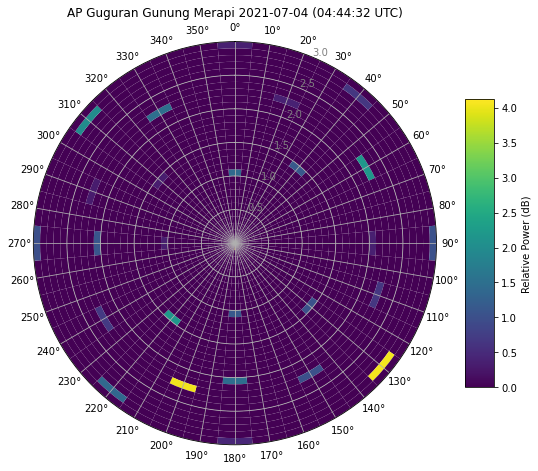

In [158]:
# plotting array

cmap = obspy_sequential

#adjust BAZ into range 0 - 360 degree
t, rel_power, abs_power, baz, slow = out.T
baz[baz<0.0] += 360

df7 = pd.DataFrame({"Time":t, "Backazimuth":baz, "Slowness":slow, 
                    "Relative Power":rel_power
                    
                    })

N=36
N2=30
abins = np.arange(N+1) *360./N
sbins = np.linspace(0, 3, N2+1)

# sum relative power in bins
hist, baz_edges, sl_edges = \
    np.histogram2d(baz, slow, bins=[abins, sbins], weights=rel_power)

# get radians
baz_edges = np.radians(baz_edges)


# polar diagram
fig = plt.figure(figsize=(8,8))
cax = fig.add_axes([0.85, 0.2, 0.05, 0.5])
ax = fig.add_axes([0.10, 0.1, 0.70, 0.70], polar=True)
ax.set_theta_direction(-1)
ax.set_theta_zero_location('N')

dh = abs(sl_edges[1]-sl_edges[0])
dw = abs(baz_edges[1]-baz_edges[0])

for i, row in enumerate(hist):
    bars = ax.bar((i*dw) * np.ones(N2),
                   height=dh*np.ones(N2),
                   width=dw, bottom=dh*np.arange(N2),
                   color=cmap(row/hist.max()))
    
ax.set_xticks(np.linspace(0, 2*np.pi, 36, endpoint=False))
ax.set_title('AP Guguran Gunung Merapi %s' %(start.strftime('%Y-%m-%d (%H:%M:%S UTC)'),))

# slowness limit
ax.set_ylim(0,3)
[i.set_color('grey') for i in ax.get_yticklabels()]
ColorbarBase(cax, cmap=cmap, norm=Normalize(vmin=hist.min(), vmax=hist.max()), label='Relative Power (dB)')

plt.savefig('Polar Plot - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white')
plt.show()

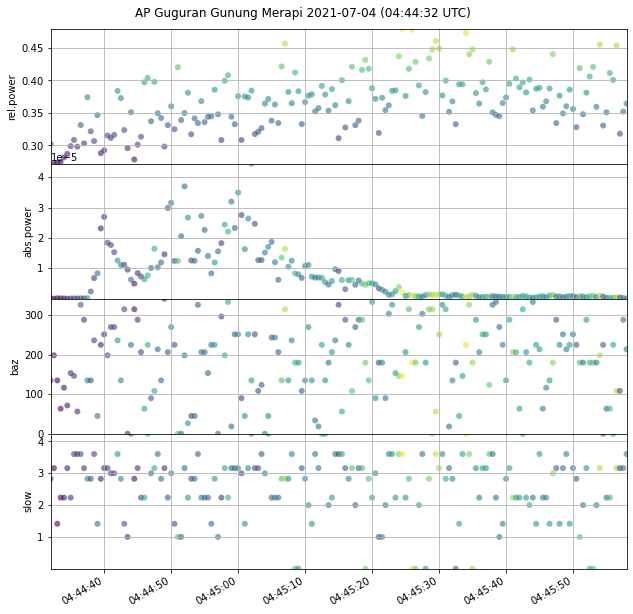

In [159]:
# plot
labels = ['rel.power', 'abs.power', 'baz', 'slow']
xlocator = mdates.AutoDateLocator()
fig = plt.figure(figsize=(10,10))
for i, lab in enumerate(labels):
    ax = fig.add_subplot(4, 1, i + 1)
    ax.scatter(out[:, 0], out[:, i + 1], c=out[:, 1], alpha=0.6,
               edgecolors='none', cmap=obspy_sequential)
    ax.set_ylabel(lab)
    ax.set_xlim(out[0, 0], out[-1, 0])
    ax.set_ylim(out[:, i + 1].min(), out[:, i + 1].max())
    ax.xaxis.set_major_locator(xlocator)
    ax.xaxis.set_major_formatter(mdates.AutoDateFormatter(xlocator))
    ax.grid()
    
fig.suptitle('AP Guguran Gunung Merapi %s' % (start.strftime('%Y-%m-%d (%H:%M:%S UTC)'), ))
fig.autofmt_xdate()
fig.subplots_adjust(left=0.15, top=0.95, right=0.95, bottom=0.2, hspace=0)
plt.savefig('Plot - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white')
plt.show()

## 2 | (2021-07-04 | 09:27:00) | SE

In [92]:
chID = 'ENZ'
direction = 'SE'
path = 'data/'+direction

st=read(path+"/VG.*"+".D.20*"+".MSEED", type='MSEED')

st = st.sort()

In [93]:
time_s = time1
time_e = time_s + time01
print('duration:', time01)
st0 = st.copy()
st0 = st0.trim(starttime=time_s, endtime=time_e)

duration: 108


### MEPAS

In [94]:
station = 'mepas'
mepas = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

mepas = mepas.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
mepas

3 Trace(s) in Stream:
VG.MEPAS.00.HHE | 2021-07-04T09:26:55.000000Z - 2021-07-04T09:28:43.000000Z | 100.0 Hz, 10801 samples
VG.MEPAS.00.HHN | 2021-07-04T09:26:55.000000Z - 2021-07-04T09:28:43.000000Z | 100.0 Hz, 10801 samples
VG.MEPAS.00.HHZ | 2021-07-04T09:26:55.000000Z - 2021-07-04T09:28:43.000000Z | 100.0 Hz, 10801 samples

In [95]:
for i in range(len(mepas)):
    mepas[i].stats.coordinates = AttribDict({'latitude':-7.535567,
                                             'longitude':110.449185,
                                             'elevation':2679})

### MELAB

In [96]:
station = 'melab'
melab = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

melab = melab.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
melab

3 Trace(s) in Stream:
VG.MELAB.00.HHE | 2021-07-04T09:26:55.000000Z - 2021-07-04T09:28:43.000000Z | 100.0 Hz, 10801 samples
VG.MELAB.00.HHN | 2021-07-04T09:26:55.000000Z - 2021-07-04T09:28:43.000000Z | 100.0 Hz, 10801 samples
VG.MELAB.00.HHZ | 2021-07-04T09:26:55.000000Z - 2021-07-04T09:28:43.000000Z | 100.0 Hz, 10801 samples

In [97]:
for i in range(len(melab)):
    melab[i].stats.coordinates = AttribDict({'latitude':-7.557044,
                                         'longitude':110.445038,
                                         'elevation':1730})

### MEJRO

In [98]:
station = 'mejro'
mejro = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

mejro = mejro.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
mejro

3 Trace(s) in Stream:
VG.MEJRO.00.HHE | 2021-07-04T09:26:55.000000Z - 2021-07-04T09:28:43.000000Z | 100.0 Hz, 10801 samples
VG.MEJRO.00.HHN | 2021-07-04T09:26:55.000000Z - 2021-07-04T09:28:43.000000Z | 100.0 Hz, 10801 samples
VG.MEJRO.00.HHZ | 2021-07-04T09:26:55.000000Z - 2021-07-04T09:28:43.000000Z | 100.0 Hz, 10801 samples

In [99]:
for i in range(len(mejro)):
    mejro[i].stats.coordinates = AttribDict({'latitude':-7.555357,
                                         'longitude':110.419287,
                                         'elevation':1335})

### MEGRA

In [100]:
station = 'megra'
megra = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

megra = megra.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
megra

3 Trace(s) in Stream:
VG.MEGRA.00.HHE | 2021-07-04T09:26:55.000000Z - 2021-07-04T09:28:43.000000Z | 100.0 Hz, 10801 samples
VG.MEGRA.00.HHN | 2021-07-04T09:26:55.000000Z - 2021-07-04T09:28:43.000000Z | 100.0 Hz, 10801 samples
VG.MEGRA.00.HHZ | 2021-07-04T09:26:55.000000Z - 2021-07-04T09:28:43.000000Z | 100.0 Hz, 10801 samples

In [101]:
for i in range(len(megra)):
    megra[i].stats.coordinates = AttribDict({'latitude':-7.52163,
                                         'longitude':110.45149,
                                         'elevation':2045})

### Signal Analysis

#### Spectrogram Before Filter

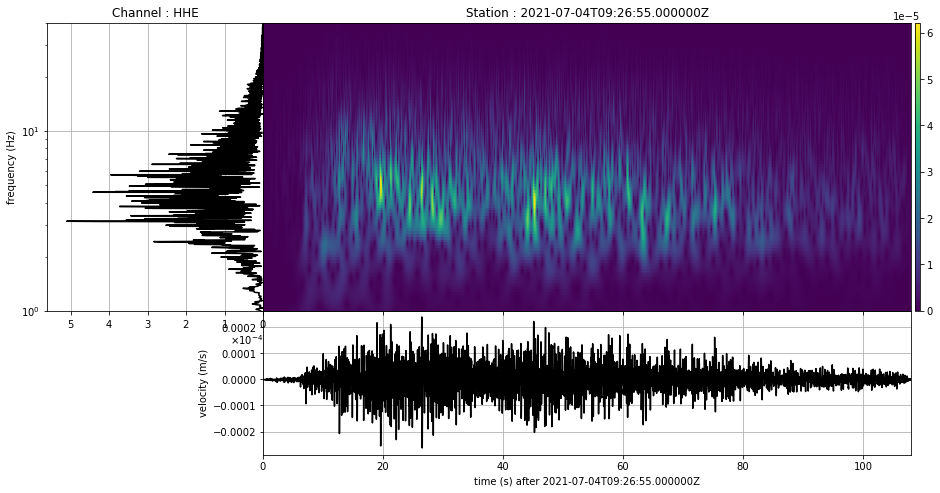

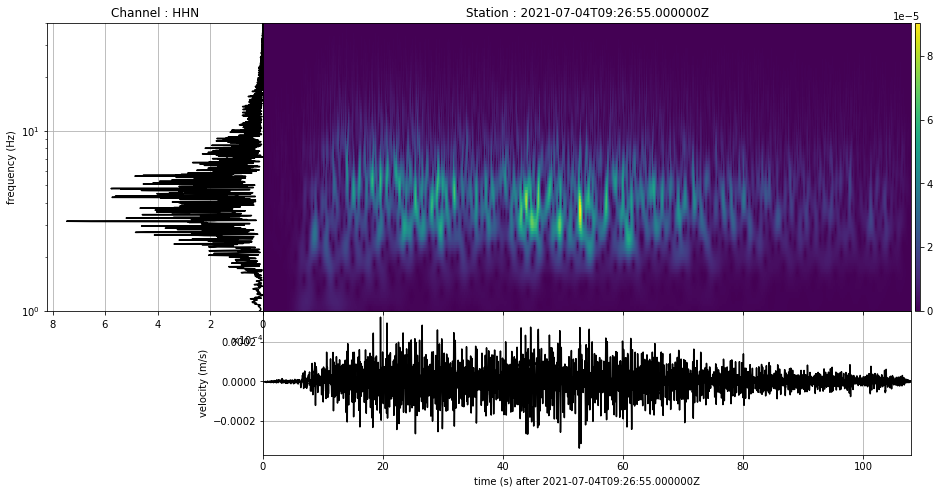

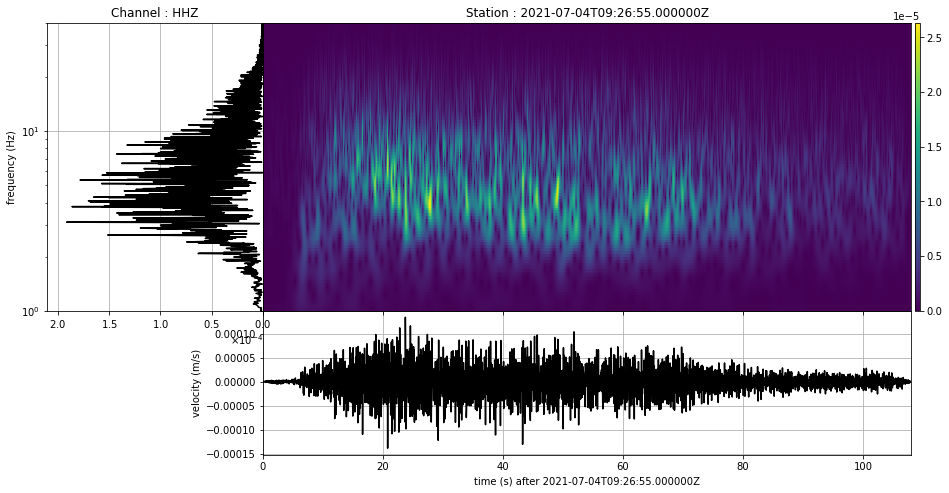

In [ ]:
# MEPAS
for i in range(len(mepas)):
    mc.plot_tfr(
    mepas[i].data, 
    tr=mepas[i],
    fmin=1.0,
    fmax=40.0,
    dt=mepas[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

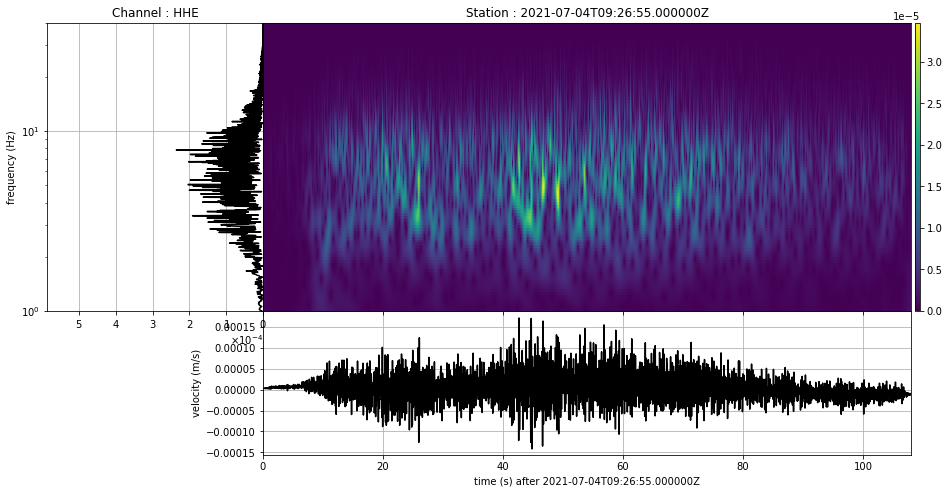

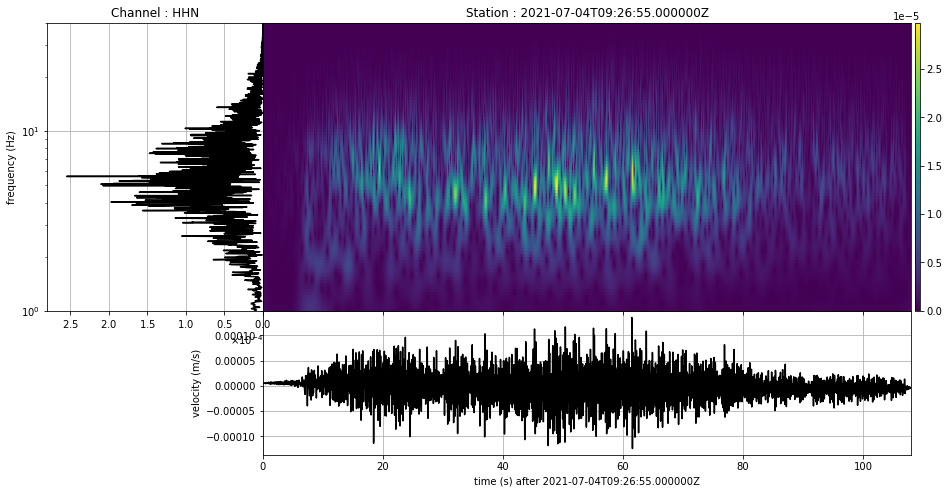

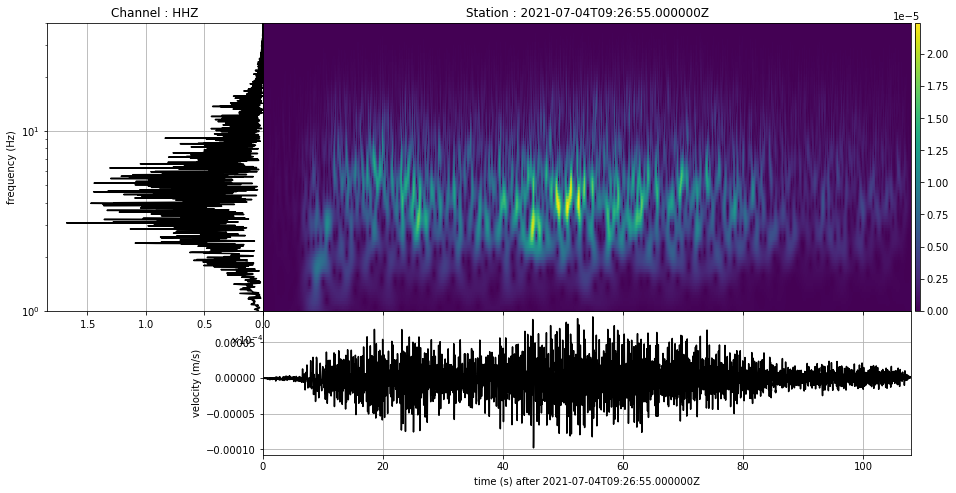

In [ ]:
# MELAB
for i in range(len(melab)):
    mc.plot_tfr(
    melab[i].data, 
    tr=melab[i],
    fmin=1.0,
    fmax=40.0,
    dt=melab[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

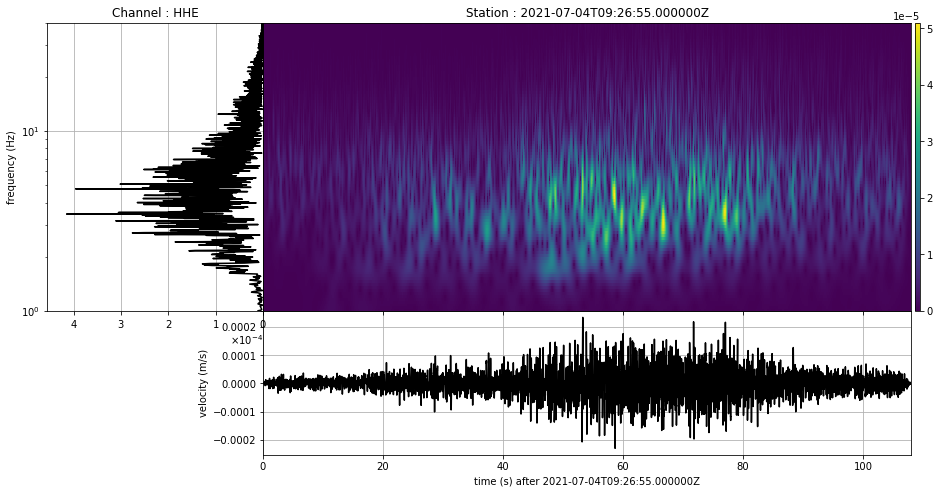

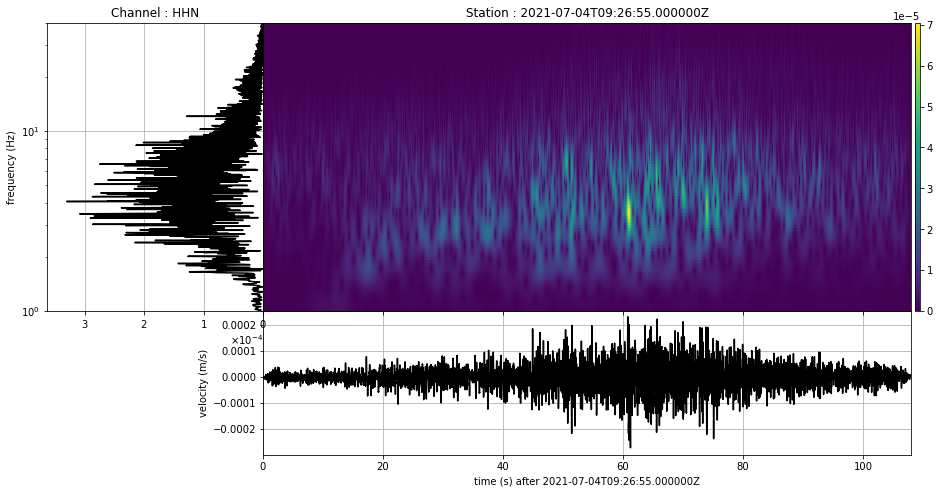

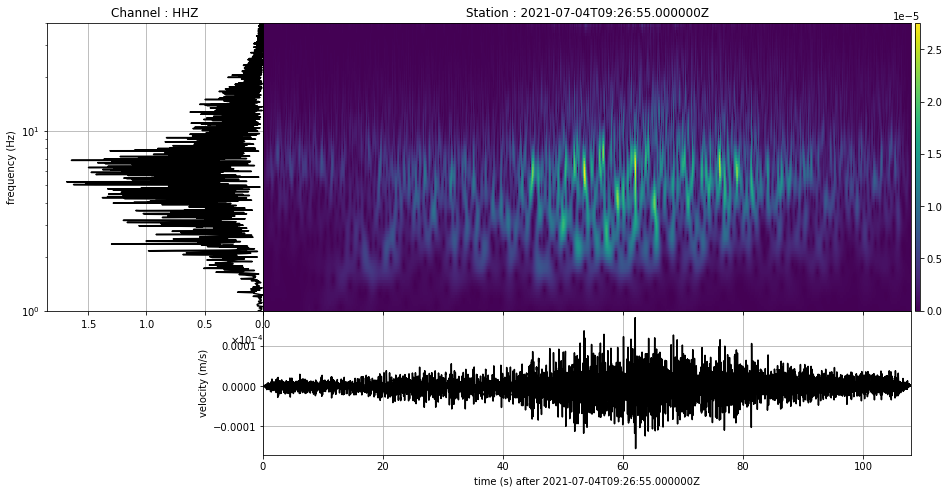

In [ ]:
# MEJRO
for i in range(len(mejro)):
    mc.plot_tfr(
    mejro[i].data, 
    tr=mejro[i],
    fmin=1.0,
    fmax=40.0,
    dt=mejro[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

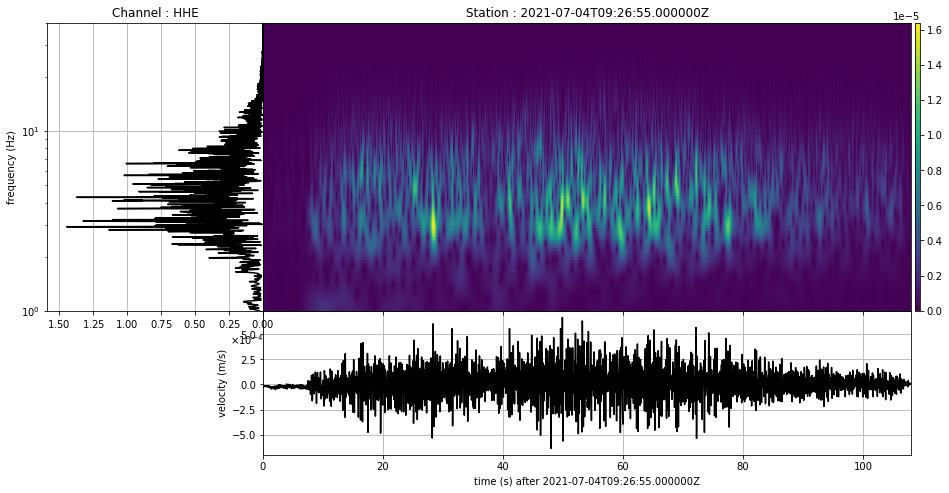

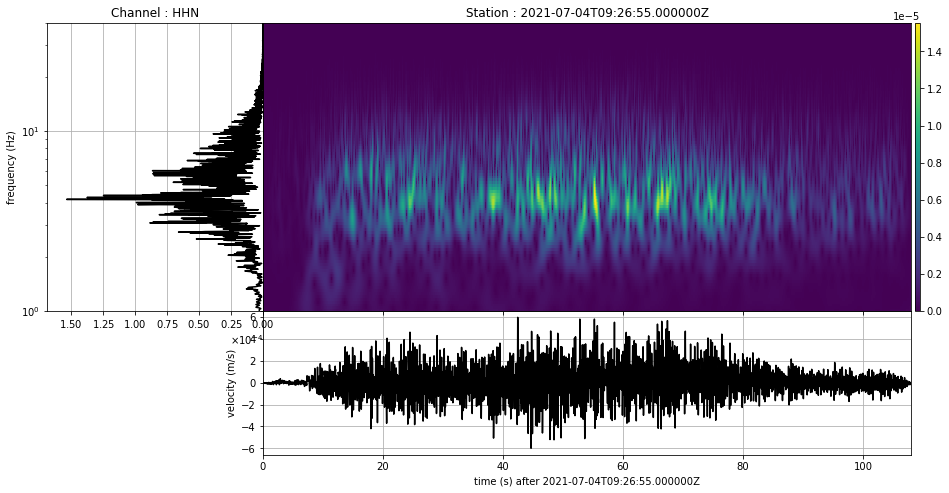

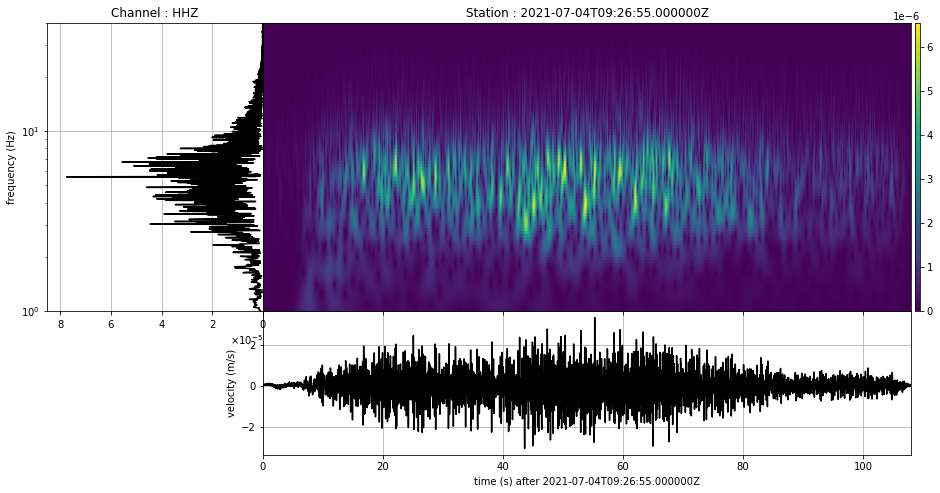

In [ ]:
# MEGRA
for i in range(len(megra)):
    mc.plot_tfr(
    megra[i].data, 
    tr=megra[i],
    fmin=1.0,
    fmax=40.0,
    dt=megra[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

#### Data Filter

In [102]:
mepas = mepas.filter('bandpass', freqmin = 1.0, freqmax=12.0)
melab = melab.filter('bandpass', freqmin = 1.0, freqmax=12.0)
mejro = mejro.filter('bandpass', freqmin = 1.0, freqmax=12.0)
megra = megra.filter('bandpass', freqmin = 1.0, freqmax=12.0)

#### Spectrogram After Filter

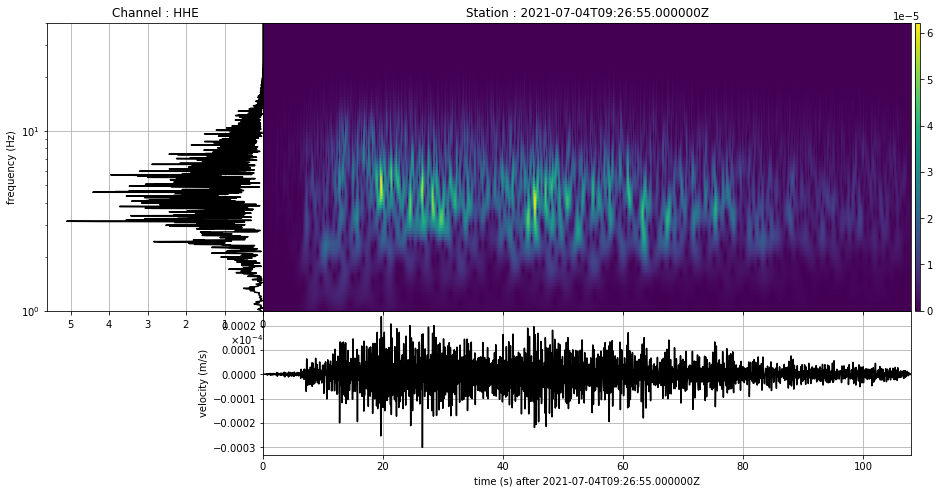

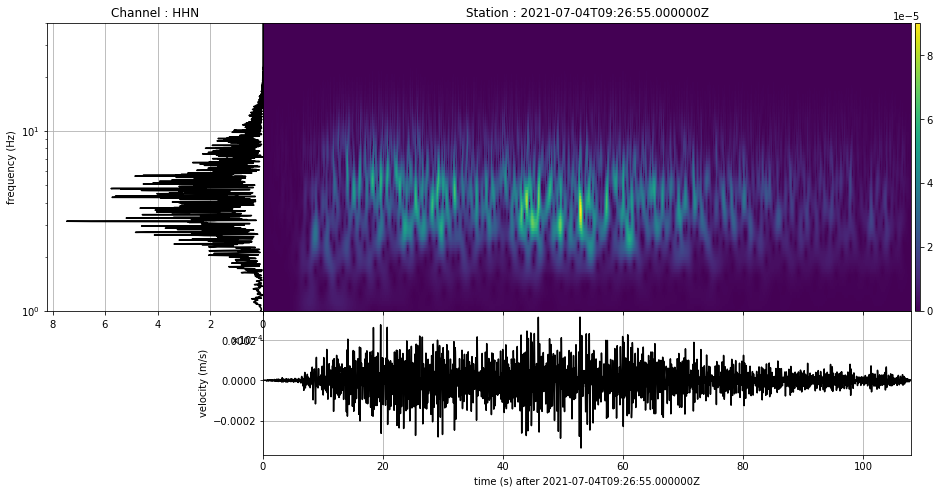

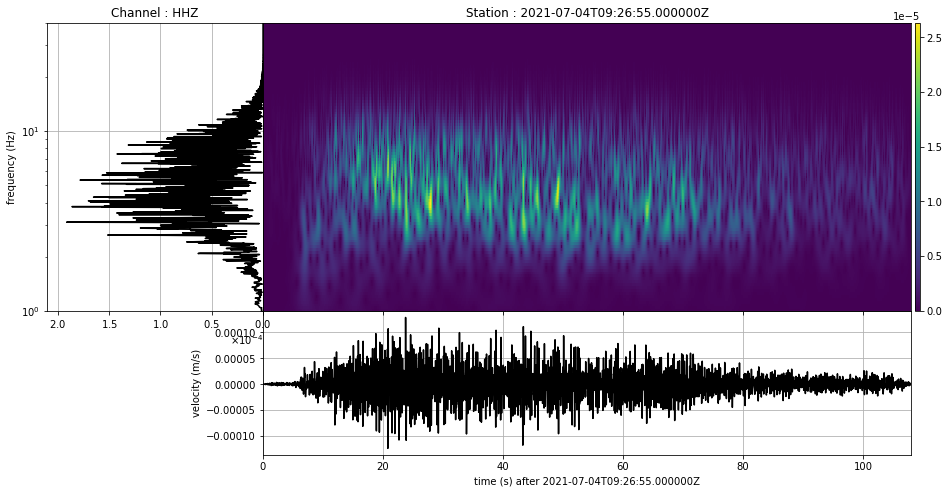

In [ ]:
# MEPAS
for i in range(len(mepas)):
    mc.plot_tfr(
    mepas[i].data, 
    tr=mepas[i],
    fmin=1.0,
    fmax=40.0,
    dt=mepas[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

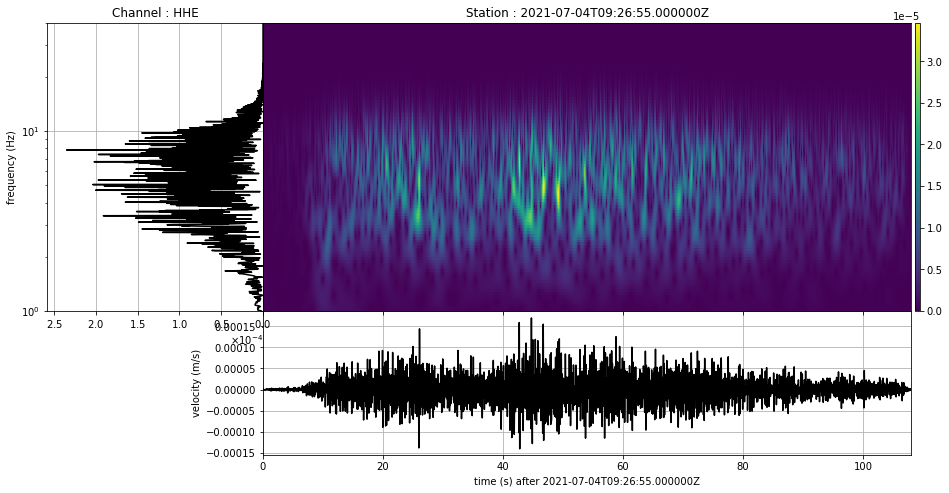

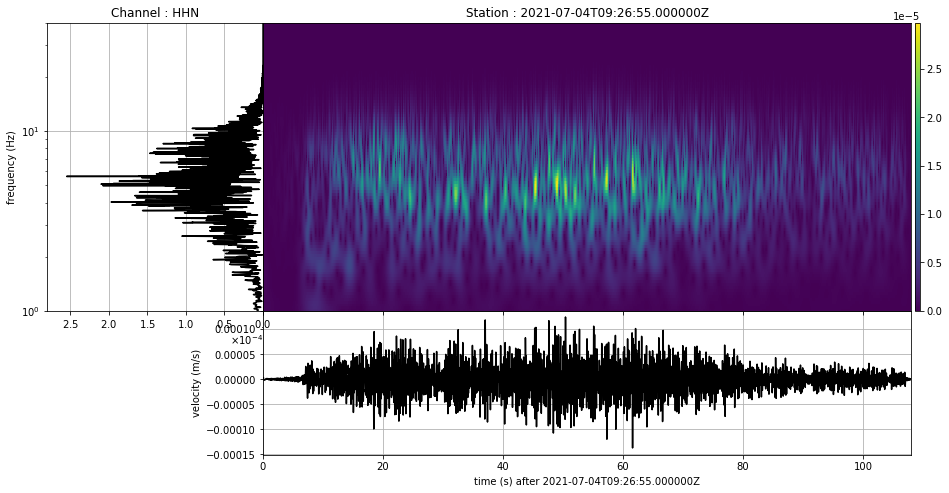

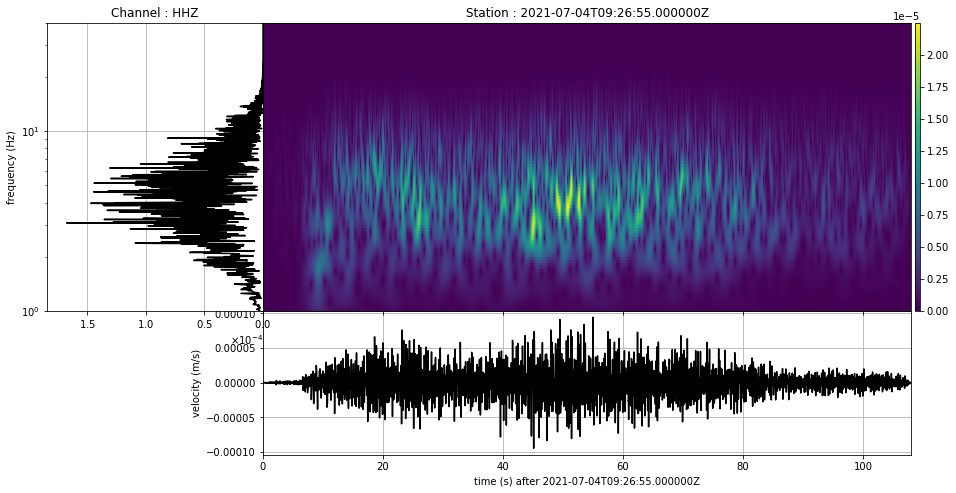

In [ ]:
# MELAB
for i in range(len(melab)):
    mc.plot_tfr(
    melab[i].data, 
    tr=melab[i],
    fmin=1.0,
    fmax=40.0,
    dt=melab[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

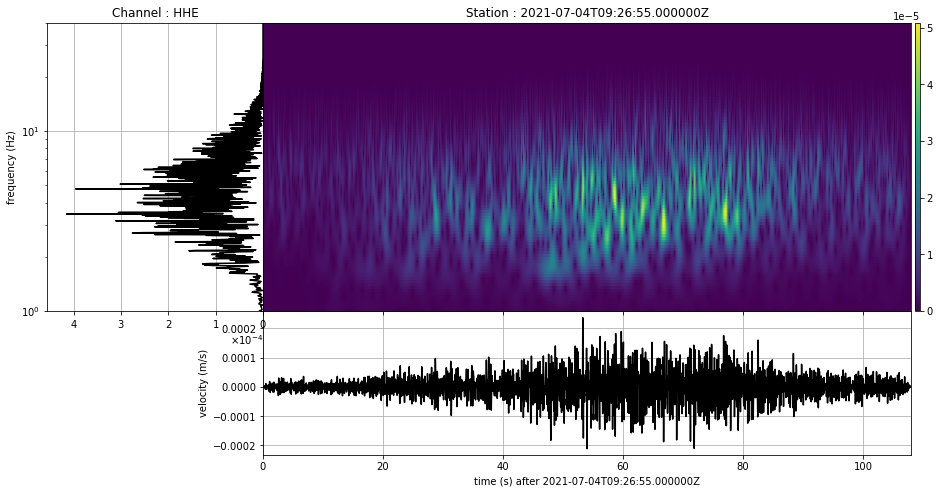

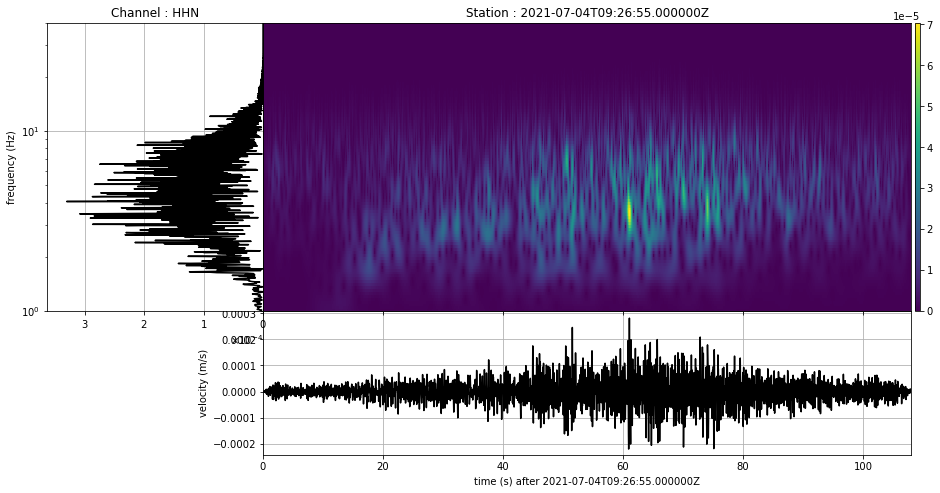

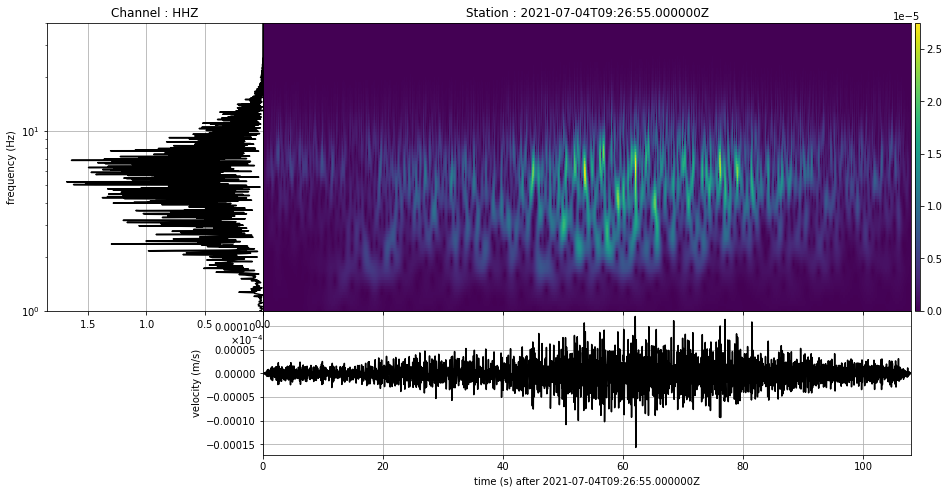

In [ ]:
# MEJRO
for i in range(len(mejro)):
    mc.plot_tfr(
    mejro[i].data, 
    tr=mejro[i],
    fmin=1.0,
    fmax=40.0,
    dt=mejro[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

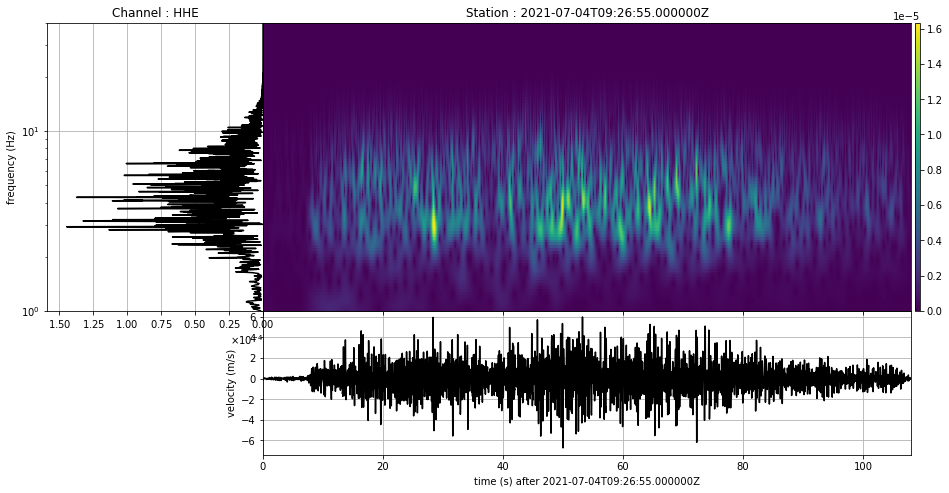

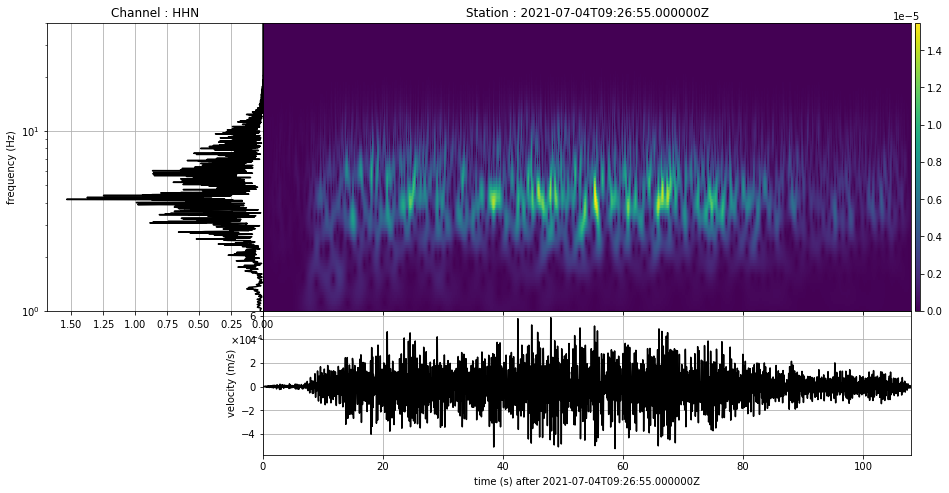

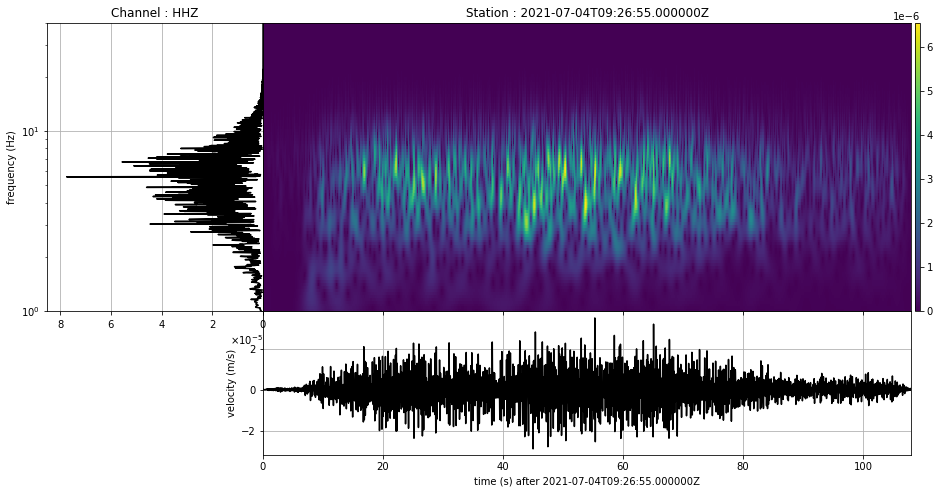

In [ ]:
# MEGRA
for i in range(len(megra)):
    mc.plot_tfr(
    megra[i].data, 
    tr=megra[i],
    fmin=1.0,
    fmax=40.0,
    dt=megra[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

### Particle Motion

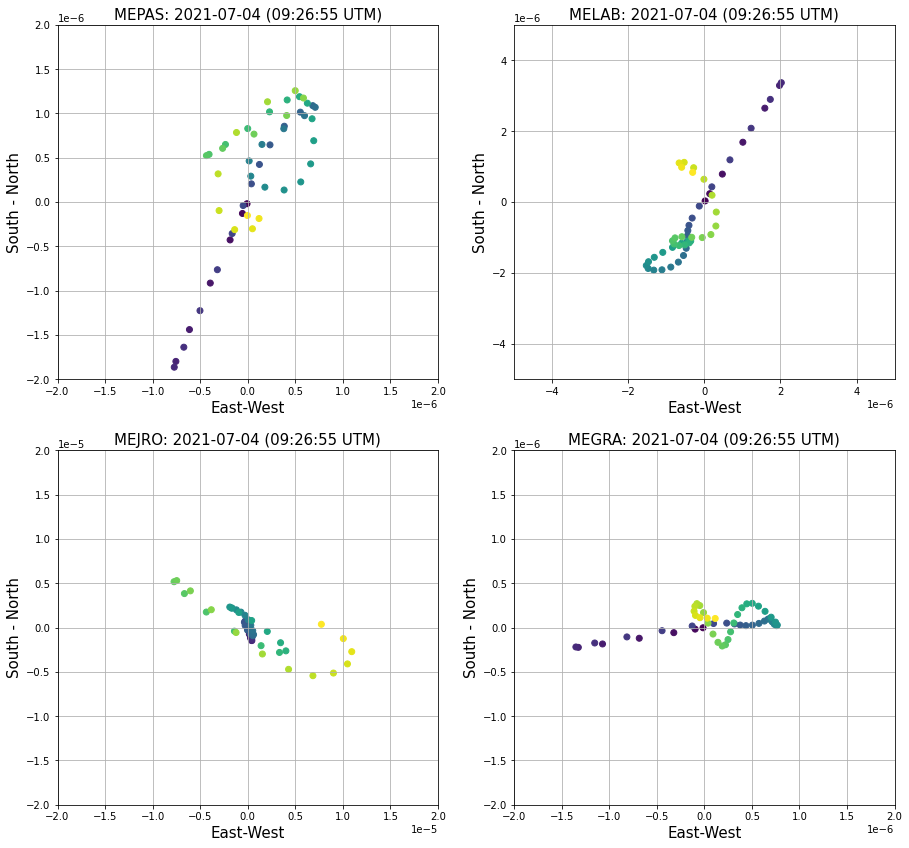

In [103]:
mepas_pm = mepas.copy()
melab_pm = melab.copy()
mejro_pm = mejro.copy()
megra_pm = megra.copy()

st_pm = mepas_pm+melab_pm+mejro_pm+megra_pm

start = st_pm[0].stats.starttime
end_pm = start + 0.5
st_pm = st_pm.trim(starttime=start, endtime=end_pm)

for tr in st_pm.select(channel='HHZ'):
  st_pm.remove(tr)

mepas_pm = st_pm.select(station = 'mepas')
mepas_ctime = np.array(mepas_pm[0].times())
melab_pm = st_pm.select(station = 'melab')
melab_ctime = np.array(melab_pm[0].times())
mejro_pm = st_pm.select(station = 'mejro')
mejro_ctime = np.array(mejro_pm[0].times())
megra_pm = st_pm.select(station = 'megra')
megra_ctime = np.array(megra_pm[0].times())

lim = 0.000005

fig = plt.figure(figsize=(15, 30))
ax=fig.add_subplot(421)
ax.set_title('MEPAS: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax.set_xlabel('East-West', fontsize = 15)
ax.set_ylabel('South - North', fontsize = 15)
ax.set_xlim(-0.000002, 0.000002)
ax.set_ylim(-0.000002, 0.000002)
ax.scatter(mepas_pm[0].data, mepas_pm[1].data, marker='o', c=mepas_ctime)

ax1=fig.add_subplot(422)
ax1.set_title('MELAB: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax1.set_xlabel('East-West', fontsize = 15)
ax1.set_ylabel('South - North', fontsize = 15)
ax1.set_xlim(-lim, lim)
ax1.set_ylim(-lim, lim)
ax1.scatter(melab_pm[0].data, melab_pm[1].data, marker='o', c=melab_ctime)

ax2=fig.add_subplot(423)
ax2.set_title('MEJRO: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax2.set_xlabel('East-West', fontsize = 15)
ax2.set_ylabel('South - North', fontsize = 15)
ax2.set_xlim(-0.00002, 0.00002)
ax2.set_ylim(-0.00002, 0.00002)
ax2.scatter(mejro_pm[0].data, mejro_pm[1].data, marker='o', c=mejro_ctime)

ax3=fig.add_subplot(424)
ax3.set_title('MEGRA: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax3.set_xlabel('East-West', fontsize = 15)
ax3.set_ylabel('South - North', fontsize = 15)
ax3.set_xlim(-0.000002, 0.000002)
ax3.set_ylim(-0.000002, 0.000002)
ax3.scatter(megra_pm[0].data, megra_pm[1].data, marker='o', c=megra_ctime)

ax.grid()
ax1.grid()
ax2.grid()
ax3.grid()

plt.savefig('Particle Motion - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white', transparent=False)
ax = plt.gca


### Beamforming 

In [ ]:
mepas_fk = mepas.copy()
melab_fk = melab.copy()
mejro_fk = mejro.copy()
megra_fk = megra.copy()


st_ = mepas_fk+melab_fk+megra_fk
st_fk = st_.copy()
st_fk = st_fk.select(channel='HHZ')

In [ ]:
fmin = 1.0
fmax = 12.0
slw = 3.0
sl_s = 1.0
win_len = 1.0
win_frac = 0.5

start = []
for i in range(len(st_fk)):
    start.append(st_fk[i].stats.starttime)
end = []
for i in range(len(st_fk)):
    end.append(st_fk[i].stats.endtime)

t0 = max(start)
t1 = min(end)

st_fk = st_fk.trim(t0, t1)

start = st_fk[0].stats.starttime
end = st_fk[0].stats.endtime

kwargs = dict(
    # slowness grid (x,y) and slow step
    sll_x=-slw, slm_x=slw, sll_y=-slw, slm_y=slw, sl_s=sl_s,
    #sliding window
    win_len=win_len, win_frac=win_frac,
    # frequency for bandpass
    frqlow=fmin, frqhigh=fmax, prewhiten=0,
    # semblance
    semb_thres=-1e9, vel_thres=-1e9,
    stime=start, etime=end, method=0)

out = array_processing(stream=st_fk, **kwargs)


# return = timestamp, realtive relpow, abs relpow, baz, slowness

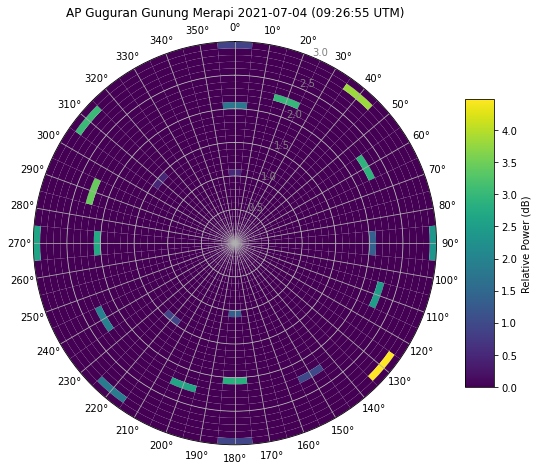

In [ ]:
# plotting array

cmap = obspy_sequential

#adjust BAZ into range 0 - 360 degree
t, rel_power, abs_power, baz, slow = out.T
baz[baz<0.0] += 360

df8 = pd.DataFrame({"Time":t, "Backazimuth":baz, "Slowness":slow, 
                    "Relative Power":rel_power
                    
                    })

N=36
N2=30
abins = np.arange(N+1) *360./N
sbins = np.linspace(0, 3, N2+1)

# sum relative power in bins
hist, baz_edges, sl_edges = \
    np.histogram2d(baz, slow, bins=[abins, sbins], weights=rel_power)

# get radians
baz_edges = np.radians(baz_edges)


# polar diagram
fig = plt.figure(figsize=(8,8))
cax = fig.add_axes([0.85, 0.2, 0.05, 0.5])
ax = fig.add_axes([0.10, 0.1, 0.70, 0.70], polar=True)
ax.set_theta_direction(-1)
ax.set_theta_zero_location('N')

dh = abs(sl_edges[1]-sl_edges[0])
dw = abs(baz_edges[1]-baz_edges[0])

for i, row in enumerate(hist):
    bars = ax.bar((i*dw) * np.ones(N2),
                   height=dh*np.ones(N2),
                   width=dw, bottom=dh*np.arange(N2),
                   color=cmap(row/hist.max()))
    
ax.set_xticks(np.linspace(0, 2*np.pi, 36, endpoint=False))
ax.set_title('AP Guguran Gunung Merapi %s' %(start.strftime('%Y-%m-%d (%H:%M:%S UTC)'),))

# slowness limit
ax.set_ylim(0,3)
[i.set_color('grey') for i in ax.get_yticklabels()]
ColorbarBase(cax, cmap=cmap, norm=Normalize(vmin=hist.min(), vmax=hist.max()), label='Relative Power (dB)')

plt.savefig('Polar Plot - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white')
plt.show()

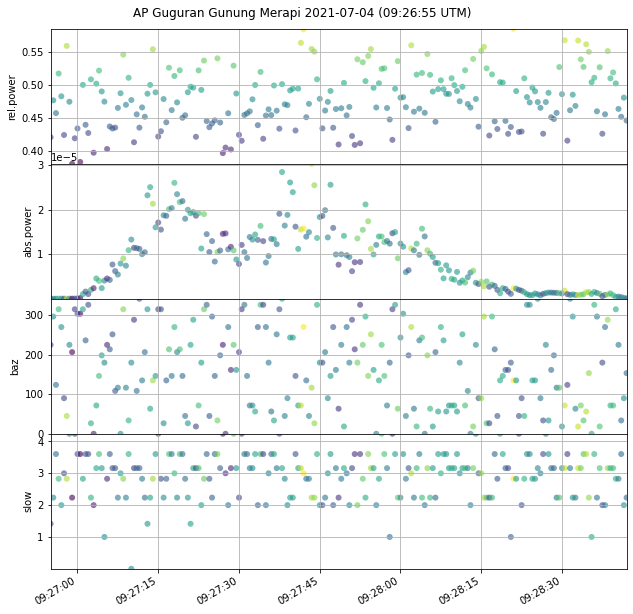

In [ ]:
# plot
labels = ['rel.power', 'abs.power', 'baz', 'slow']
xlocator = mdates.AutoDateLocator()
fig = plt.figure(figsize=(10,10))
for i, lab in enumerate(labels):
    ax = fig.add_subplot(4, 1, i + 1)
    ax.scatter(out[:, 0], out[:, i + 1], c=out[:, 1], alpha=0.6,
               edgecolors='none', cmap=obspy_sequential)
    ax.set_ylabel(lab)
    ax.set_xlim(out[0, 0], out[-1, 0])
    ax.set_ylim(out[:, i + 1].min(), out[:, i + 1].max())
    ax.xaxis.set_major_locator(xlocator)
    ax.xaxis.set_major_formatter(mdates.AutoDateFormatter(xlocator))
    ax.grid()

fig.suptitle('AP Guguran Gunung Merapi %s' % (start.strftime('%Y-%m-%d (%H:%M:%S UTC)'), ))
fig.autofmt_xdate()
fig.subplots_adjust(left=0.15, top=0.95, right=0.95, bottom=0.2, hspace=0)

plt.savefig('Plot - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white')
plt.show()

## 3 | (2021-07-04 | 09:51:00) | SE

In [ ]:
chID = 'ENZ'
direction = 'SE'
path = 'data/'+direction

st=read(path+"/VG.*"+".D.20*"+".MSEED", type='MSEED')

st = st.sort()

In [ ]:
time_s = time2
time_e = time_s + time02
print('duration:', time02)

st0 = st.copy()
st0 = st0.trim(starttime=time_s, endtime=time_e)

duration: 76


### MEPAS

In [ ]:
station = 'mepas'
mepas = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

mepas = mepas.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
mepas

3 Trace(s) in Stream:
VG.MEPAS.00.HHE | 2021-07-04T09:51:20.000000Z - 2021-07-04T09:52:36.000000Z | 100.0 Hz, 7601 samples
VG.MEPAS.00.HHN | 2021-07-04T09:51:20.000000Z - 2021-07-04T09:52:36.000000Z | 100.0 Hz, 7601 samples
VG.MEPAS.00.HHZ | 2021-07-04T09:51:20.000000Z - 2021-07-04T09:52:36.000000Z | 100.0 Hz, 7601 samples

In [ ]:
for i in range(len(mepas)):
    mepas[i].stats.coordinates = AttribDict({'latitude':-7.535567,
                                             'longitude':110.449185,
                                             'elevation':2679})

### MELAB

In [ ]:
station = 'melab'
melab = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

melab = melab.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
melab

3 Trace(s) in Stream:
VG.MELAB.00.HHE | 2021-07-04T09:51:20.000000Z - 2021-07-04T09:52:36.000000Z | 100.0 Hz, 7601 samples
VG.MELAB.00.HHN | 2021-07-04T09:51:20.000000Z - 2021-07-04T09:52:36.000000Z | 100.0 Hz, 7601 samples
VG.MELAB.00.HHZ | 2021-07-04T09:51:20.000000Z - 2021-07-04T09:52:36.000000Z | 100.0 Hz, 7601 samples

In [ ]:
for i in range(len(melab)):
    melab[i].stats.coordinates = AttribDict({'latitude':-7.557044,
                                         'longitude':110.445038,
                                         'elevation':1730})

### MEJRO

In [ ]:
station = 'mejro'
mejro = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

mejro = mejro.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
mejro

3 Trace(s) in Stream:
VG.MEJRO.00.HHE | 2021-07-04T09:51:20.000000Z - 2021-07-04T09:52:36.000000Z | 100.0 Hz, 7601 samples
VG.MEJRO.00.HHN | 2021-07-04T09:51:20.000000Z - 2021-07-04T09:52:36.000000Z | 100.0 Hz, 7601 samples
VG.MEJRO.00.HHZ | 2021-07-04T09:51:20.000000Z - 2021-07-04T09:52:36.000000Z | 100.0 Hz, 7601 samples

In [ ]:
for i in range(len(mejro)):
    mejro[i].stats.coordinates = AttribDict({'latitude':-7.555357,
                                         'longitude':110.419287,
                                         'elevation':1335})

### MEGRA

In [ ]:
station = 'megra'
megra = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

megra = megra.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
megra

3 Trace(s) in Stream:
VG.MEGRA.00.HHE | 2021-07-04T09:51:20.000000Z - 2021-07-04T09:52:36.000000Z | 100.0 Hz, 7601 samples
VG.MEGRA.00.HHN | 2021-07-04T09:51:20.000000Z - 2021-07-04T09:52:36.000000Z | 100.0 Hz, 7601 samples
VG.MEGRA.00.HHZ | 2021-07-04T09:51:20.000000Z - 2021-07-04T09:52:36.000000Z | 100.0 Hz, 7601 samples

In [ ]:
for i in range(len(megra)):
    megra[i].stats.coordinates = AttribDict({'latitude':-7.52163,
                                         'longitude':110.45149,
                                         'elevation':2045})

### Signal Analysis

#### Spectrogram Before Filter

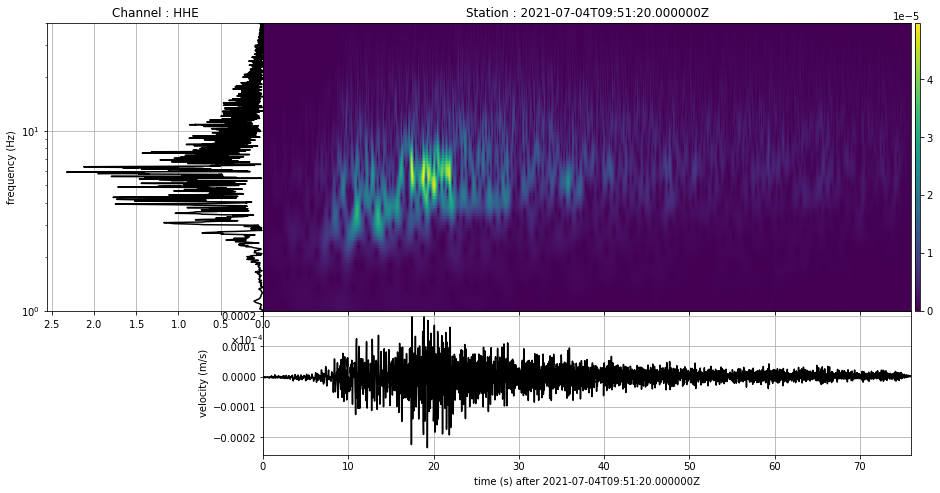

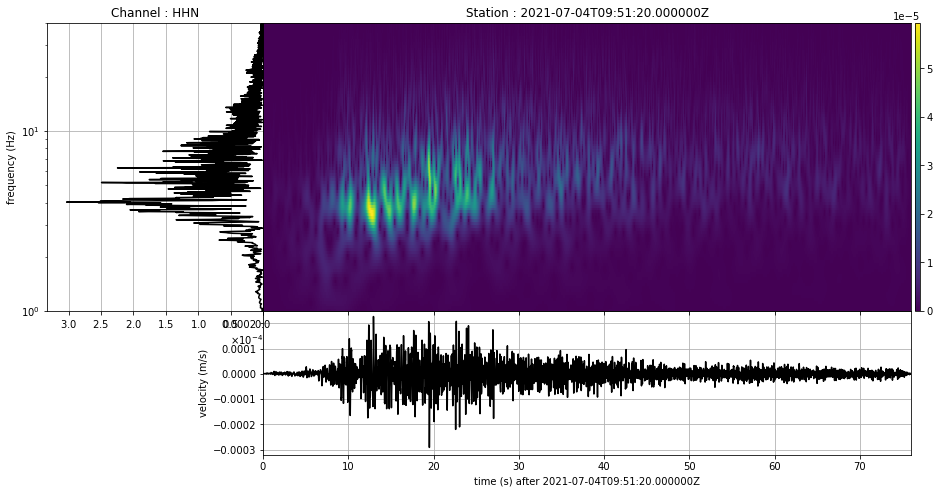

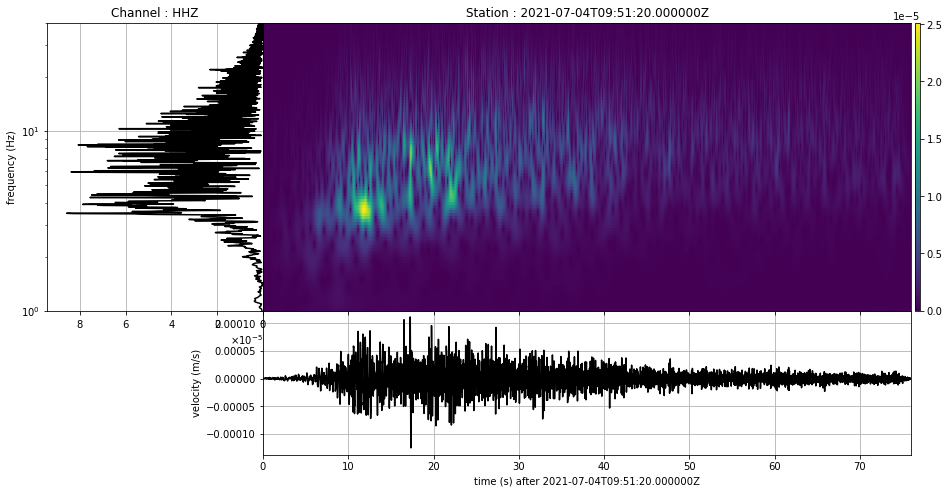

In [ ]:
# MEPAS
for i in range(len(mepas)):
    mc.plot_tfr(
    mepas[i].data, 
    tr=mepas[i],
    fmin=1.0,
    fmax=40.0,
    dt=mepas[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

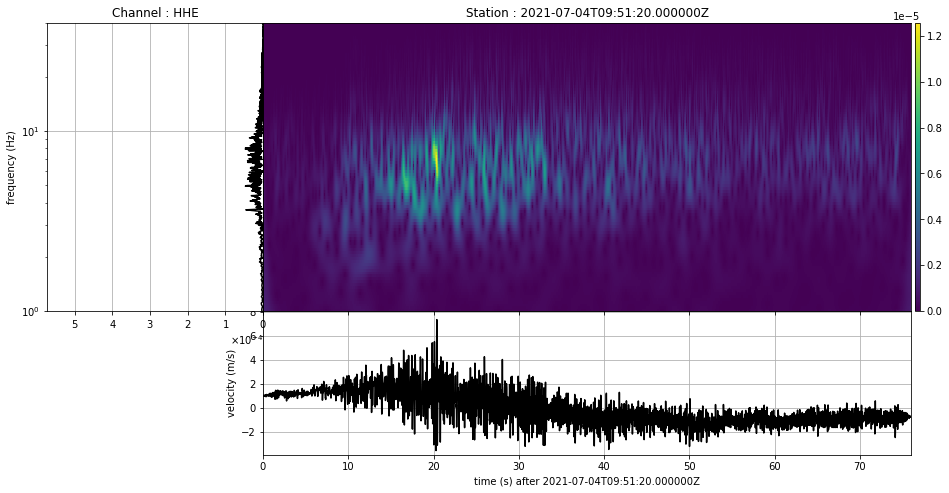

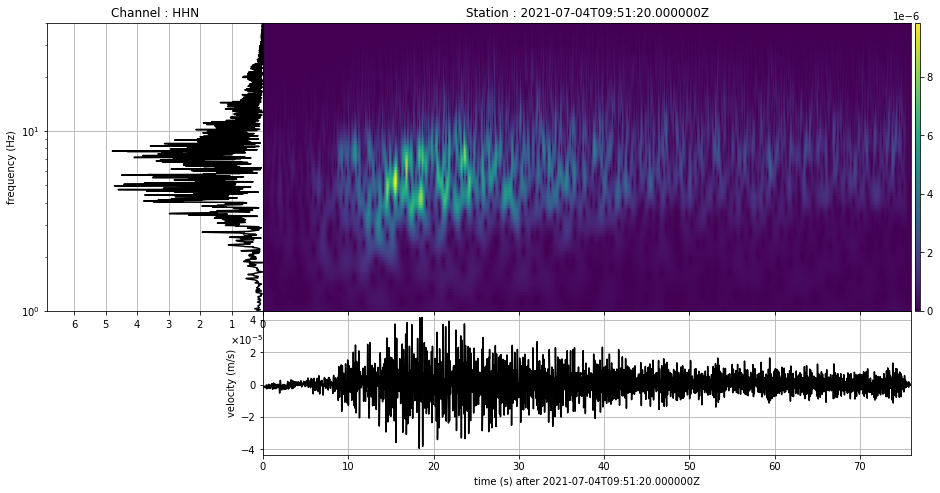

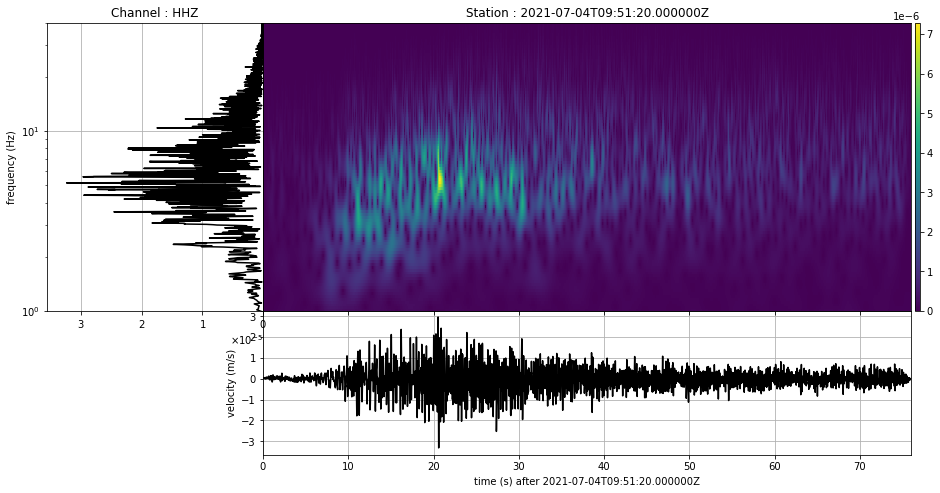

In [ ]:
# MELAB
for i in range(len(melab)):
    mc.plot_tfr(
    melab[i].data, 
    tr=melab[i],
    fmin=1.0,
    fmax=40.0,
    dt=melab[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

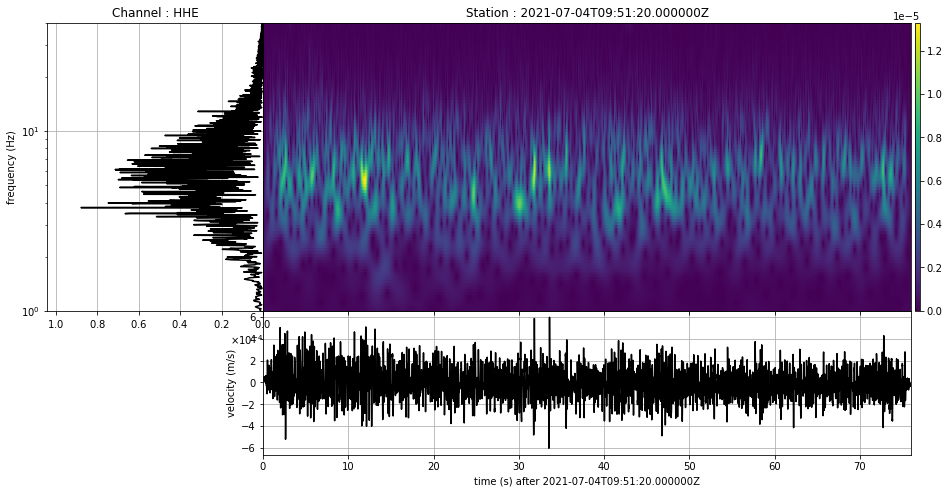

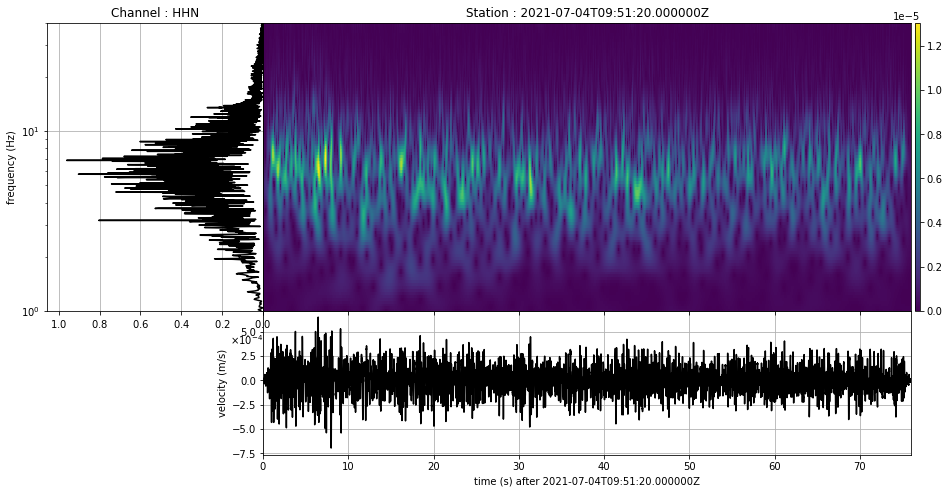

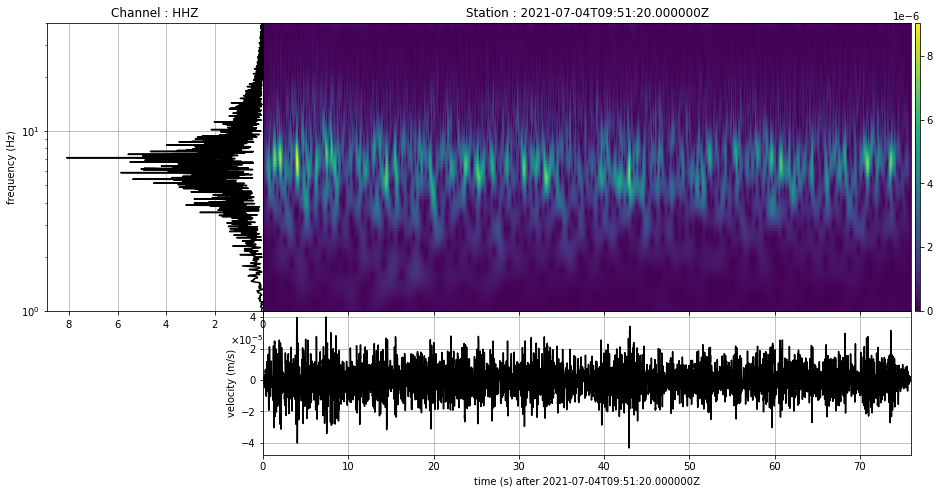

In [ ]:
# MEJRO
for i in range(len(mejro)):
    mc.plot_tfr(
    mejro[i].data, 
    tr=mejro[i],
    fmin=1.0,
    fmax=40.0,
    dt=mejro[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

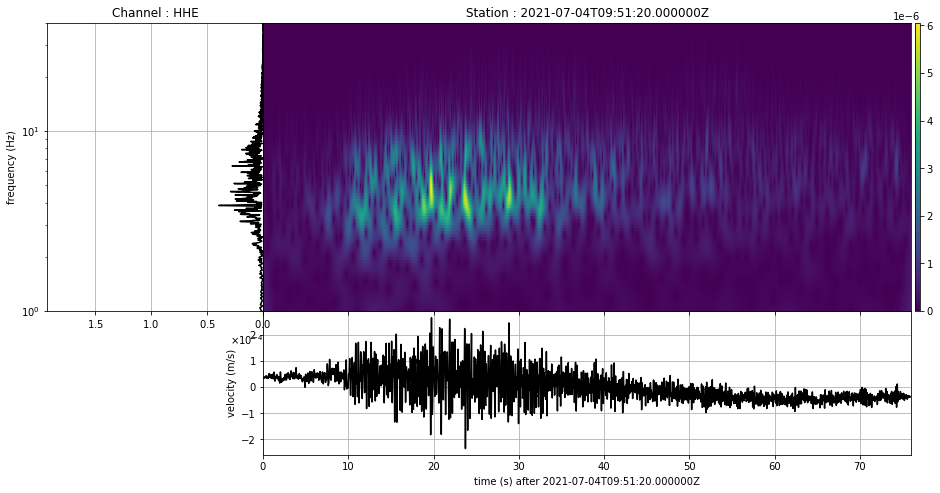

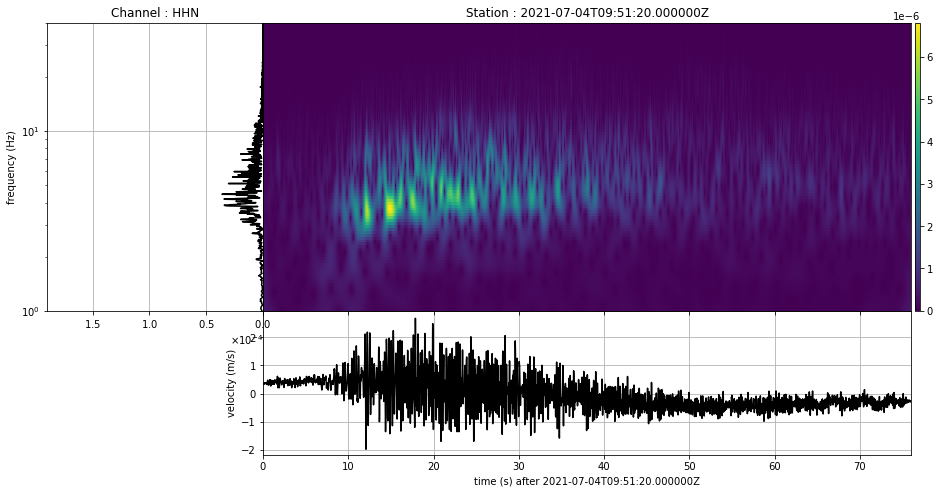

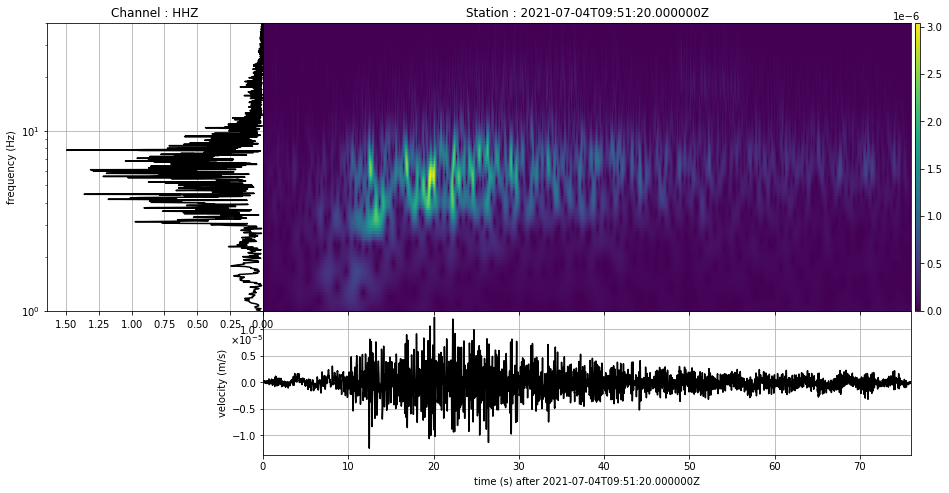

In [ ]:
# MEGRA
for i in range(len(megra)):
    mc.plot_tfr(
    megra[i].data, 
    tr=megra[i],
    fmin=1.0,
    fmax=40.0,
    dt=megra[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

#### Data Filter

In [ ]:
mepas = mepas.filter('bandpass', freqmin = 1.0, freqmax=12.0)
melab = melab.filter('bandpass', freqmin = 1.0, freqmax=12.0)
mejro = mejro.filter('bandpass', freqmin = 1.0, freqmax=12.0)
megra = megra.filter('bandpass', freqmin = 1.0, freqmax=12.0)

#### Spectrogram After Filter

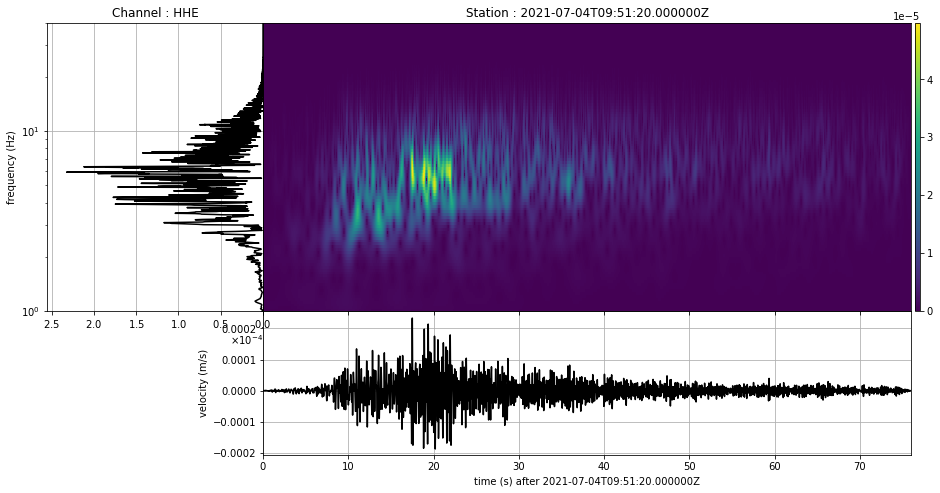

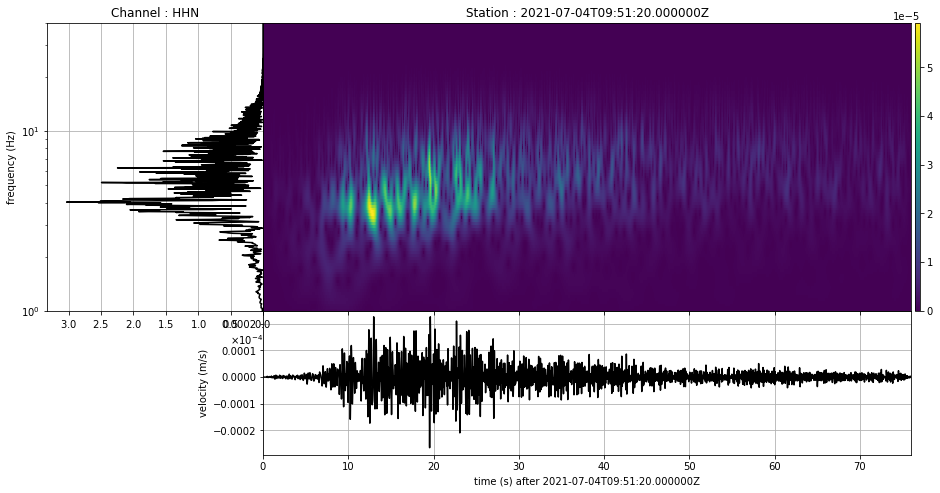

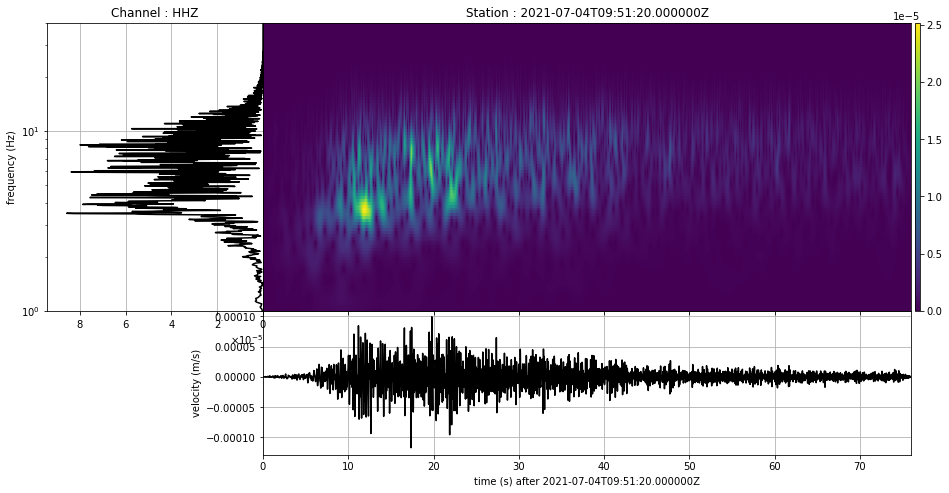

In [ ]:
# MEPAS
for i in range(len(mepas)):
    mc.plot_tfr(
    mepas[i].data, 
    tr=mepas[i],
    fmin=1.0,
    fmax=40.0,
    dt=mepas[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

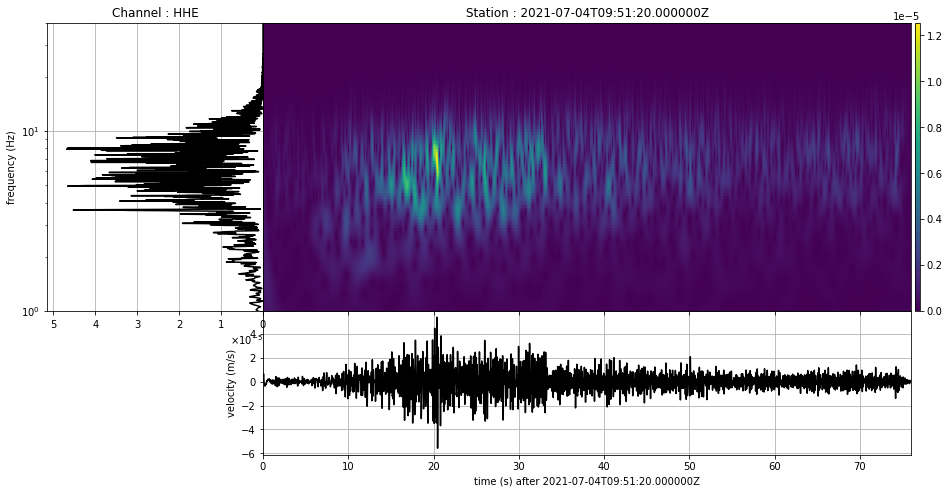

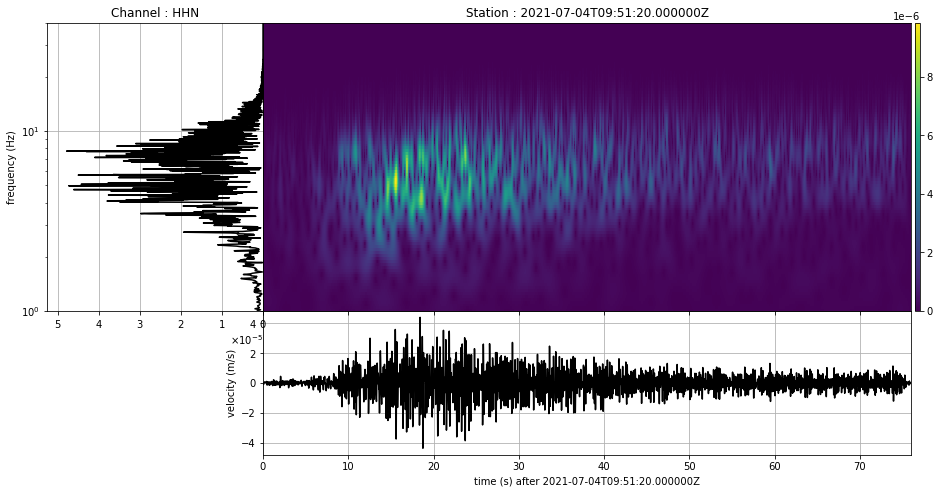

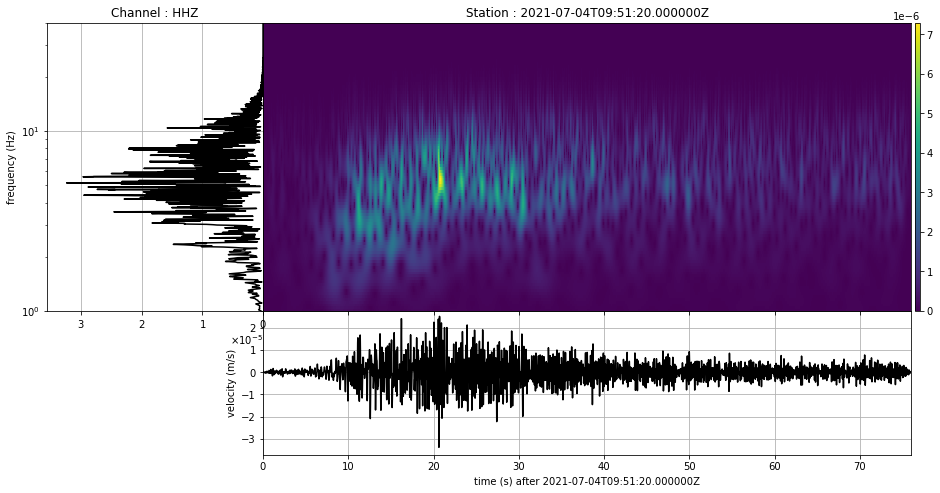

In [ ]:
# MELAB
for i in range(len(melab)):
    mc.plot_tfr(
    melab[i].data, 
    tr=melab[i],
    fmin=1.0,
    fmax=40.0,
    dt=melab[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

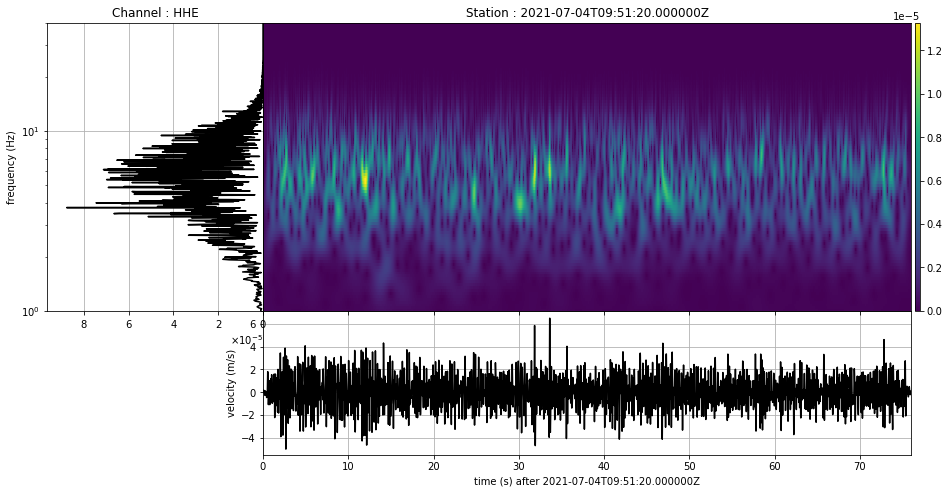

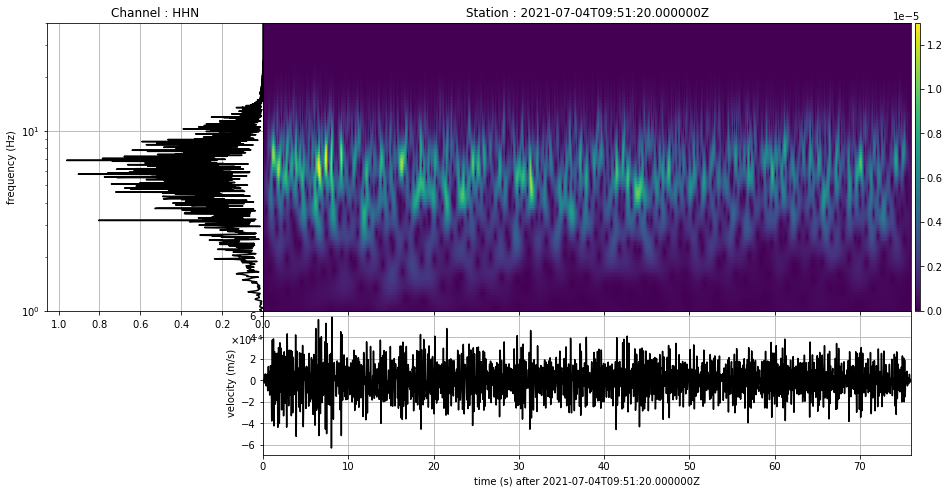

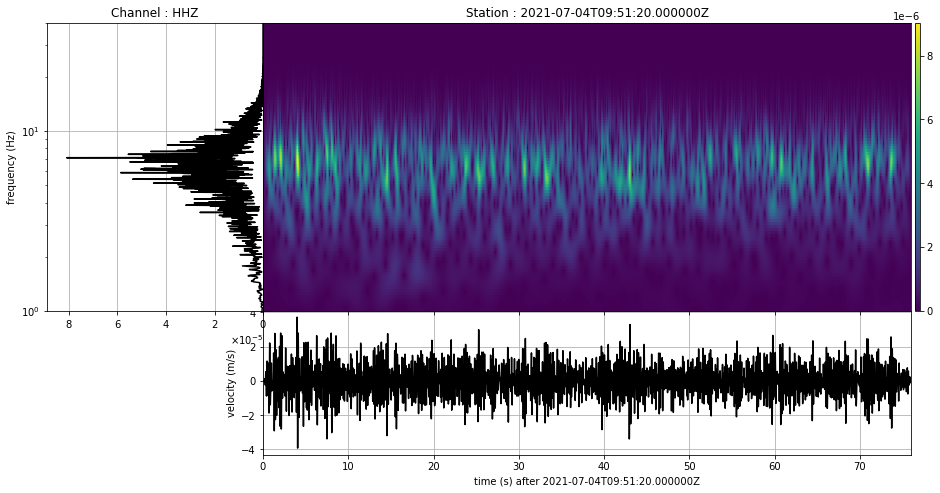

In [ ]:
# MEJRO
for i in range(len(mejro)):
    mc.plot_tfr(
    mejro[i].data, 
    tr=mejro[i],
    fmin=1.0,
    fmax=40.0,
    dt=mejro[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

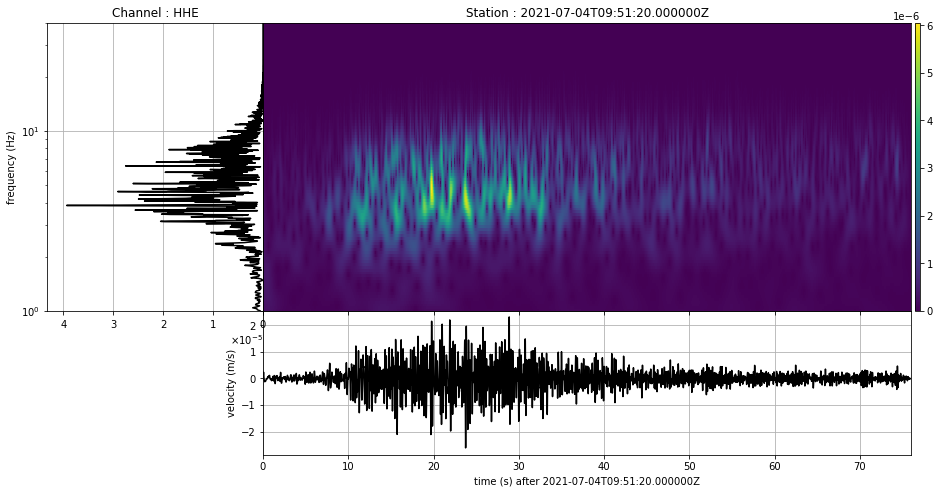

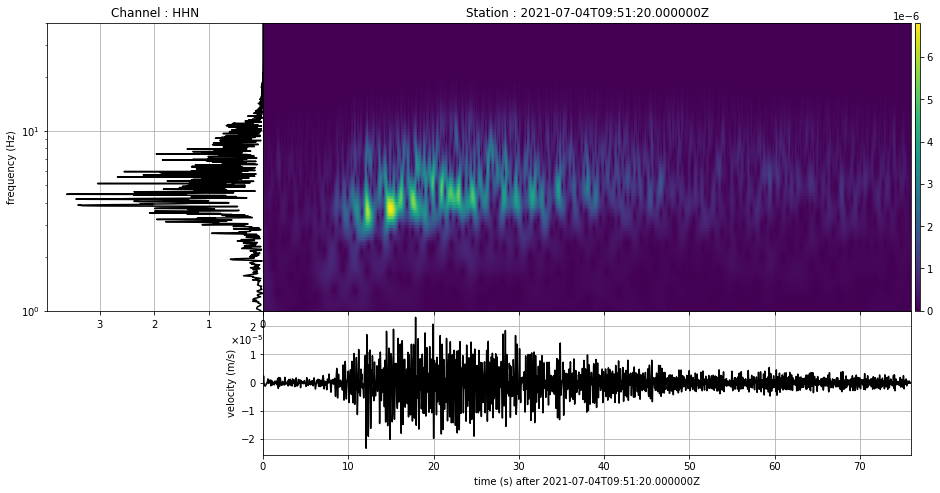

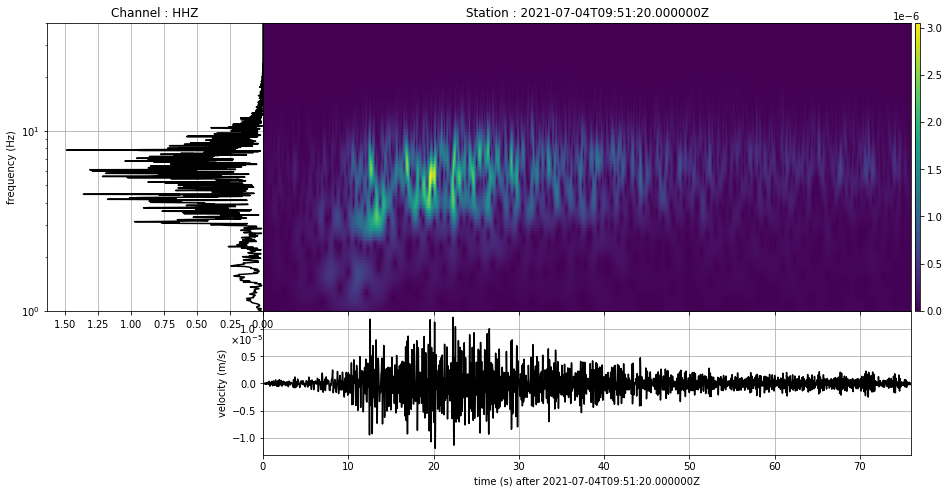

In [ ]:
# MEGRA
for i in range(len(megra)):
    mc.plot_tfr(
    megra[i].data, 
    tr=megra[i],
    fmin=1.0,
    fmax=40.0,
    dt=megra[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

### Particle Motion

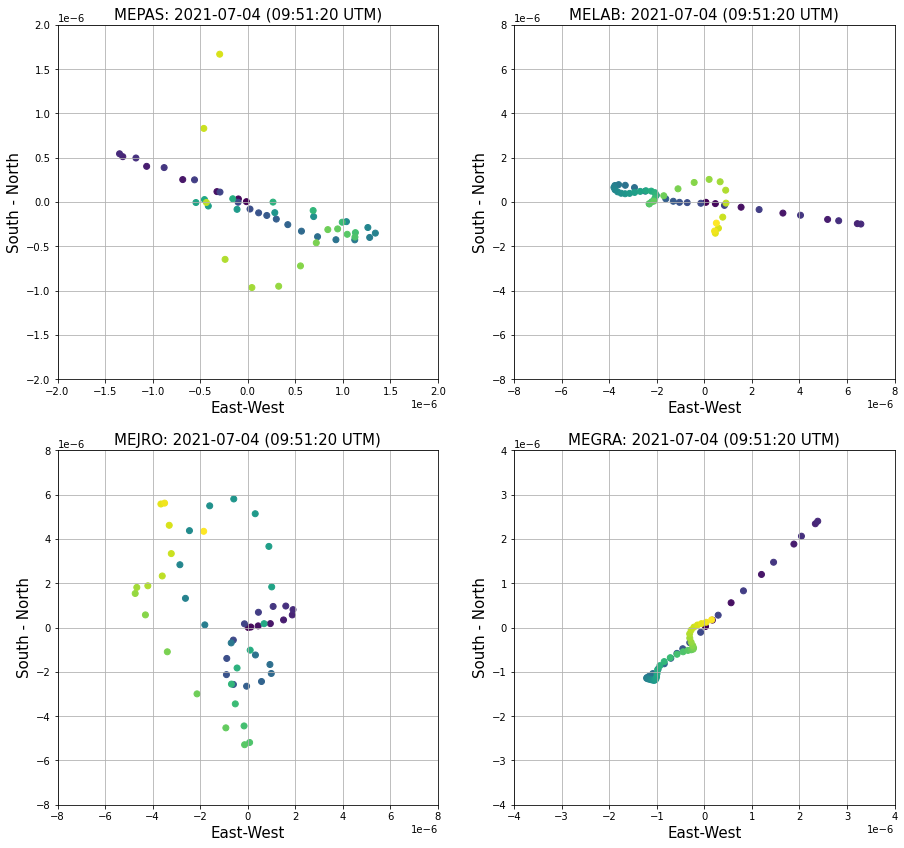

In [ ]:
mepas_pm = mepas.copy()
melab_pm = melab.copy()
mejro_pm = mejro.copy()
megra_pm = megra.copy()

st_pm = mepas_pm+melab_pm+mejro_pm+megra_pm

start = st_pm[0].stats.starttime
end_pm = start + 0.5
st_pm = st_pm.trim(starttime=start, endtime=end_pm)

for tr in st_pm.select(channel='HHZ'):
  st_pm.remove(tr)

mepas_pm = st_pm.select(station = 'mepas')
mepas_ctime = np.array(mepas_pm[0].times())
melab_pm = st_pm.select(station = 'melab')
melab_ctime = np.array(melab_pm[0].times())
mejro_pm = st_pm.select(station = 'mejro')
mejro_ctime = np.array(mejro_pm[0].times())
megra_pm = st_pm.select(station = 'megra')
megra_ctime = np.array(megra_pm[0].times())

lim = 0.000008

fig = plt.figure(figsize=(15, 30))
ax=fig.add_subplot(421)
ax.set_title('MEPAS: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax.set_xlabel('East-West', fontsize = 15)
ax.set_ylabel('South - North', fontsize = 15)
ax.set_xlim(-0.000002, 0.000002)
ax.set_ylim(-0.000002, 0.000002)
ax.scatter(mepas_pm[0].data, mepas_pm[1].data, marker='o', c=mepas_ctime)

ax1=fig.add_subplot(422)
ax1.set_title('MELAB: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax1.set_xlabel('East-West', fontsize = 15)
ax1.set_ylabel('South - North', fontsize = 15)
ax1.set_xlim(-lim, lim)
ax1.set_ylim(-lim, lim)
ax1.scatter(melab_pm[0].data, melab_pm[1].data, marker='o', c=melab_ctime)

ax2=fig.add_subplot(423)
ax2.set_title('MEJRO: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax2.set_xlabel('East-West', fontsize = 15)
ax2.set_ylabel('South - North', fontsize = 15)
ax2.set_xlim(-lim, lim)
ax2.set_ylim(-lim, lim)
ax2.scatter(mejro_pm[0].data, mejro_pm[1].data, marker='o', c=mejro_ctime)

ax3=fig.add_subplot(424)
ax3.set_title('MEGRA: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax3.set_xlabel('East-West', fontsize = 15)
ax3.set_ylabel('South - North', fontsize = 15)
ax3.set_xlim(-0.000004, 0.000004)
ax3.set_ylim(-0.000004, 0.000004)
ax3.scatter(megra_pm[0].data, megra_pm[1].data, marker='o', c=megra_ctime)

ax.grid()
ax1.grid()
ax2.grid()
ax3.grid()

plt.savefig('Particle Motion - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white', transparent=False)
ax = plt.gca


### Beamforming 

In [ ]:
mepas_fk = mepas.copy()
melab_fk = melab.copy()
mejro_fk = mejro.copy()
megra_fk = megra.copy()


st_ = mepas_fk+melab_fk+megra_fk
st_fk = st_.copy()
st_fk = st_fk.select(channel='HHZ')

In [ ]:
fmin = 1.0
fmax = 12.0
slw = 3.0
sl_s = 1.0
win_len = 1.0
win_frac = 0.5

start = []
for i in range(len(st_fk)):
    start.append(st_fk[i].stats.starttime)
end = []
for i in range(len(st_fk)):
    end.append(st_fk[i].stats.endtime)

t0 = max(start)
t1 = min(end)

st_fk = st_fk.trim(t0, t1)

start = st_fk[0].stats.starttime
end = st_fk[0].stats.endtime

kwargs = dict(
    # slowness grid (x,y) and slow step
    sll_x=-slw, slm_x=slw, sll_y=-slw, slm_y=slw, sl_s=sl_s,
    #sliding window
    win_len=win_len, win_frac=win_frac,
    # frequency for bandpass
    frqlow=fmin, frqhigh=fmax, prewhiten=0,
    # semblance
    semb_thres=-1e9, vel_thres=-1e9,
    stime=start, etime=end, method=0)

out = array_processing(stream=st_fk, **kwargs)


# return = timestamp, realtive relpow, abs relpow, baz, slowness

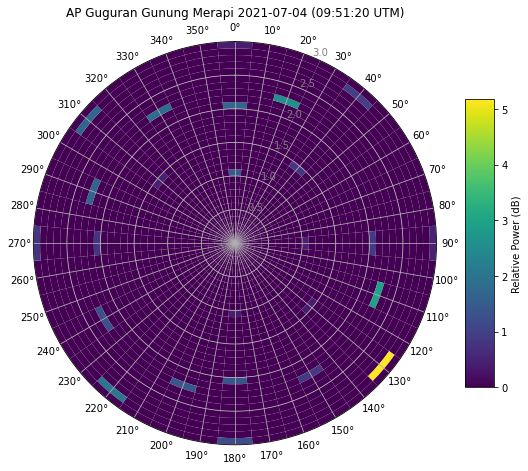

In [ ]:
# plotting array

cmap = obspy_sequential

#adjust BAZ into range 0 - 360 degree
t, rel_power, abs_power, baz, slow = out.T
baz[baz<0.0] += 360

df9 = pd.DataFrame({"Time":t, "Backazimuth":baz, "Slowness":slow, 
                    "Relative Power":rel_power
                    
                    })

N=36
N2=30
abins = np.arange(N+1) *360./N
sbins = np.linspace(0, 3, N2+1)

# sum relative power in bins
hist, baz_edges, sl_edges = \
    np.histogram2d(baz, slow, bins=[abins, sbins], weights=rel_power)

# get radians
baz_edges = np.radians(baz_edges)


# polar diagram
fig = plt.figure(figsize=(8,8))
cax = fig.add_axes([0.85, 0.2, 0.05, 0.5])
ax = fig.add_axes([0.10, 0.1, 0.70, 0.70], polar=True)
ax.set_theta_direction(-1)
ax.set_theta_zero_location('N')

dh = abs(sl_edges[1]-sl_edges[0])
dw = abs(baz_edges[1]-baz_edges[0])

for i, row in enumerate(hist):
    bars = ax.bar((i*dw) * np.ones(N2),
                   height=dh*np.ones(N2),
                   width=dw, bottom=dh*np.arange(N2),
                   color=cmap(row/hist.max()))
    
ax.set_xticks(np.linspace(0, 2*np.pi, 36, endpoint=False))
ax.set_title('AP Guguran Gunung Merapi %s' %(start.strftime('%Y-%m-%d (%H:%M:%S UTC)'),))

# slowness limit
ax.set_ylim(0,3)
[i.set_color('grey') for i in ax.get_yticklabels()]
ColorbarBase(cax, cmap=cmap, norm=Normalize(vmin=hist.min(), vmax=hist.max()), label='Relative Power (dB)')

plt.savefig('Polar Plot - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white')
plt.show()

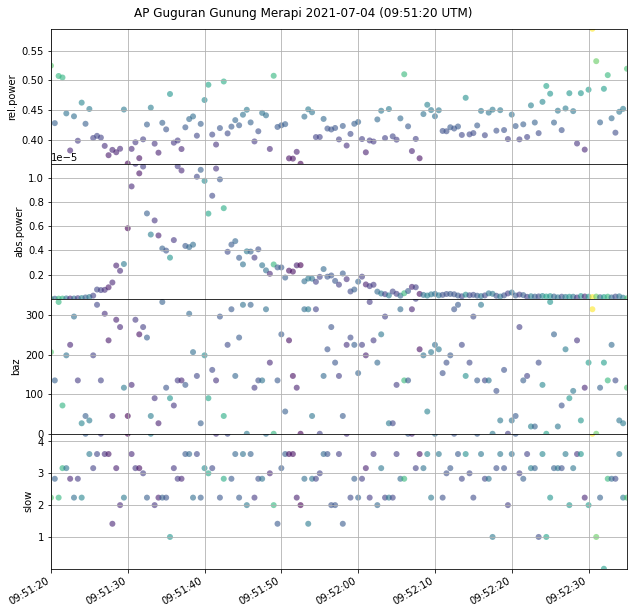

In [ ]:
# plot
labels = ['rel.power', 'abs.power', 'baz', 'slow']
xlocator = mdates.AutoDateLocator()
fig = plt.figure(figsize=(10,10))
for i, lab in enumerate(labels):
    ax = fig.add_subplot(4, 1, i + 1)
    ax.scatter(out[:, 0], out[:, i + 1], c=out[:, 1], alpha=0.6,
               edgecolors='none', cmap=obspy_sequential)
    ax.set_ylabel(lab)
    ax.set_xlim(out[0, 0], out[-1, 0])
    ax.set_ylim(out[:, i + 1].min(), out[:, i + 1].max())
    ax.xaxis.set_major_locator(xlocator)
    ax.xaxis.set_major_formatter(mdates.AutoDateFormatter(xlocator))
    ax.grid()

fig.suptitle('AP Guguran Gunung Merapi %s' % (start.strftime('%Y-%m-%d (%H:%M:%S UTC)'), ))
fig.autofmt_xdate()
fig.subplots_adjust(left=0.15, top=0.95, right=0.95, bottom=0.2, hspace=0)

plt.savefig('Plot - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white')
plt.show()

## 4 | (2021-07-04 | 11:15:00) | W

In [54]:
chID = 'ENZ'
direction = 'SE'
path = 'data/'+direction

st=read(path+"/VG.*"+".D.20*"+".MSEED", type='MSEED')

st = st.sort()


In [55]:
time_s = time3
time_e = time_s + time03
print(time03)
st0 = st.copy()
st0 = st0.trim(starttime=time_s, endtime=time_e)

107


### MEPAS

In [56]:
station = 'mepas'
mepas = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

mepas = mepas.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
mepas

3 Trace(s) in Stream:
VG.MEPAS.00.HHE | 2021-07-04T11:14:45.000000Z - 2021-07-04T11:16:32.000000Z | 100.0 Hz, 10701 samples
VG.MEPAS.00.HHN | 2021-07-04T11:14:45.000000Z - 2021-07-04T11:16:32.000000Z | 100.0 Hz, 10701 samples
VG.MEPAS.00.HHZ | 2021-07-04T11:14:45.000000Z - 2021-07-04T11:16:32.000000Z | 100.0 Hz, 10701 samples

In [57]:
for i in range(len(mepas)):
    mepas[i].stats.coordinates = AttribDict({'latitude':-7.535567,
                                             'longitude':110.449185,
                                             'elevation':2679})

### MELAB

In [58]:
station = 'melab'
melab = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

melab = melab.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
melab

3 Trace(s) in Stream:
VG.MELAB.00.HHE | 2021-07-04T11:14:45.000000Z - 2021-07-04T11:16:32.000000Z | 100.0 Hz, 10701 samples
VG.MELAB.00.HHN | 2021-07-04T11:14:45.000000Z - 2021-07-04T11:16:32.000000Z | 100.0 Hz, 10701 samples
VG.MELAB.00.HHZ | 2021-07-04T11:14:45.000000Z - 2021-07-04T11:16:32.000000Z | 100.0 Hz, 10701 samples

In [59]:
for i in range(len(melab)):
    melab[i].stats.coordinates = AttribDict({'latitude':-7.557044,
                                         'longitude':110.445038,
                                         'elevation':1730})

### MEJRO

In [60]:
station = 'mejro'
mejro = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

mejro = mejro.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
mejro

3 Trace(s) in Stream:
VG.MEJRO.00.HHE | 2021-07-04T11:14:45.000000Z - 2021-07-04T11:16:32.000000Z | 100.0 Hz, 10701 samples
VG.MEJRO.00.HHN | 2021-07-04T11:14:45.000000Z - 2021-07-04T11:16:32.000000Z | 100.0 Hz, 10701 samples
VG.MEJRO.00.HHZ | 2021-07-04T11:14:45.000000Z - 2021-07-04T11:16:32.000000Z | 100.0 Hz, 10701 samples

In [61]:
for i in range(len(mejro)):
    mejro[i].stats.coordinates = AttribDict({'latitude':-7.555357,
                                         'longitude':110.419287,
                                         'elevation':1335})

### MEGRA

In [62]:
station = 'megra'
megra = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

megra = megra.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
megra

3 Trace(s) in Stream:
VG.MEGRA.00.HHE | 2021-07-04T11:14:45.000000Z - 2021-07-04T11:16:32.000000Z | 100.0 Hz, 10701 samples
VG.MEGRA.00.HHN | 2021-07-04T11:14:45.000000Z - 2021-07-04T11:16:32.000000Z | 100.0 Hz, 10701 samples
VG.MEGRA.00.HHZ | 2021-07-04T11:14:45.000000Z - 2021-07-04T11:16:32.000000Z | 100.0 Hz, 10701 samples

In [63]:
for i in range(len(megra)):
    megra[i].stats.coordinates = AttribDict({'latitude':-7.52163,
                                         'longitude':110.45149,
                                         'elevation':2045})

### Signal Analysis

#### Spectrogram Before Filter

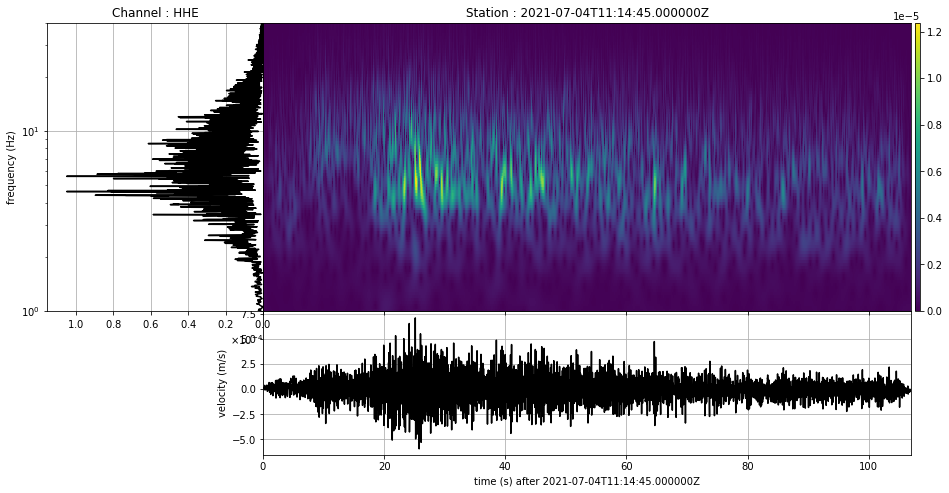

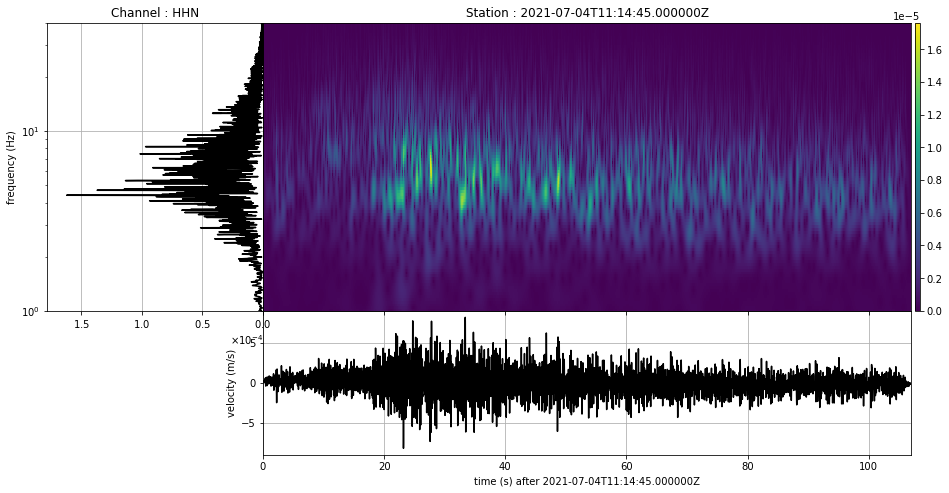

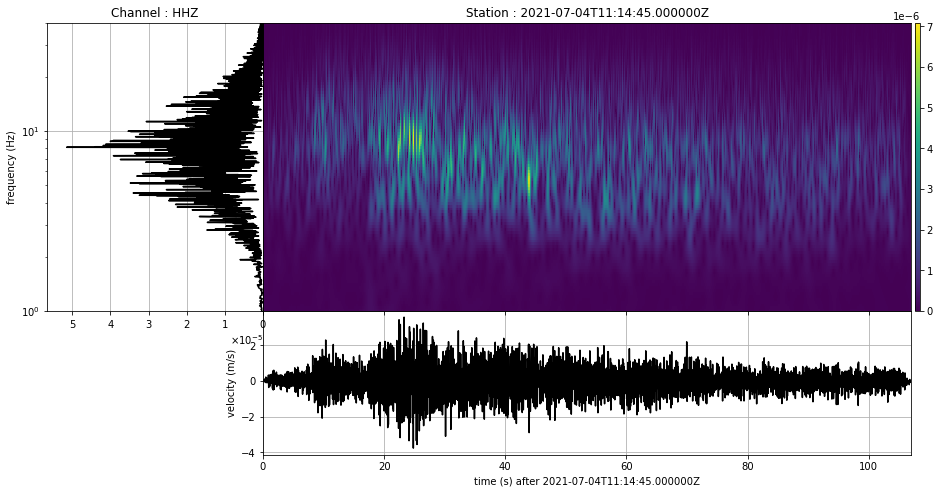

In [ ]:
# MEPAS
for i in range(len(mepas)):
    mc.plot_tfr(
    mepas[i].data, 
    tr=mepas[i],
    fmin=1.0,
    fmax=40.0,
    dt=mepas[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

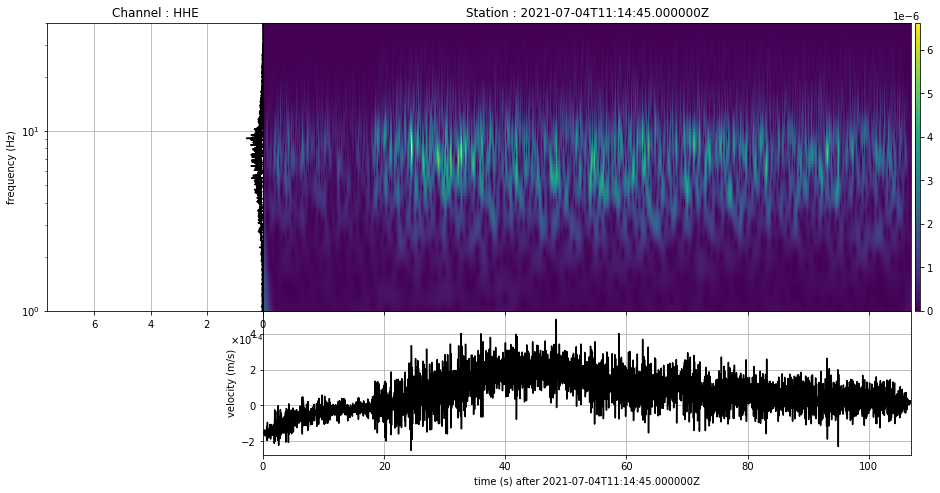

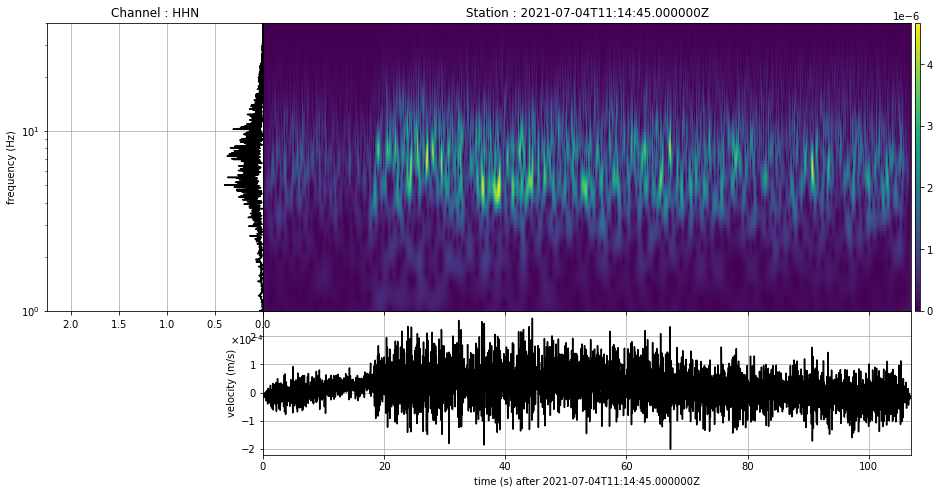

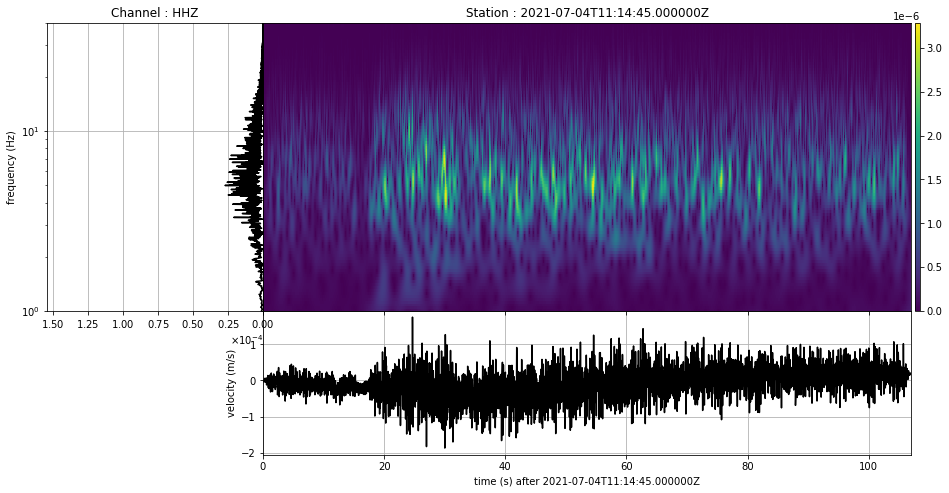

In [ ]:
# MELAB
for i in range(len(melab)):
    mc.plot_tfr(
    melab[i].data, 
    tr=melab[i],
    fmin=1.0,
    fmax=40.0,
    dt=melab[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

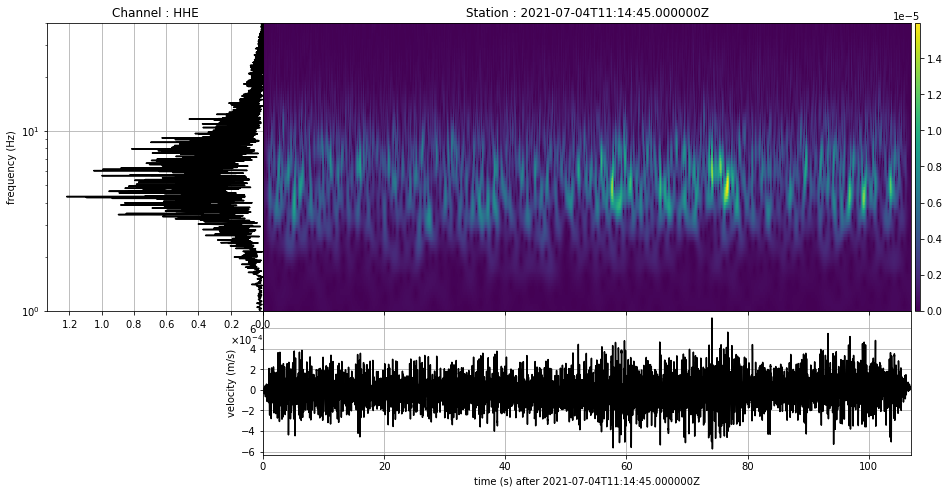

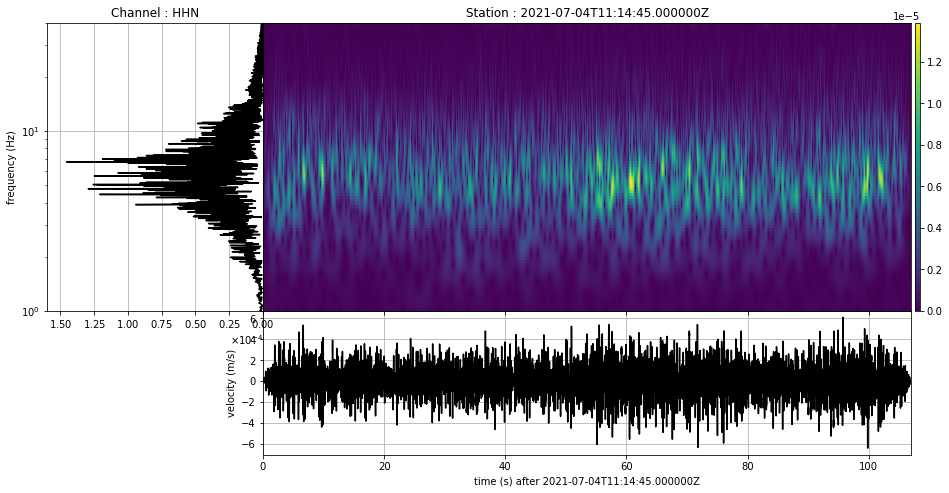

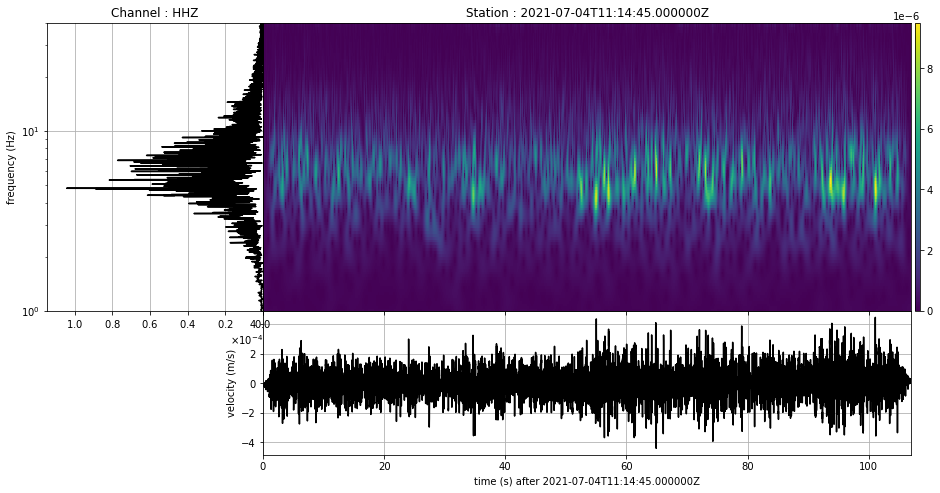

In [ ]:
# MEJRO
for i in range(len(mejro)):
    mc.plot_tfr(
    mejro[i].data, 
    tr=mejro[i],
    fmin=1.0,
    fmax=40.0,
    dt=mejro[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

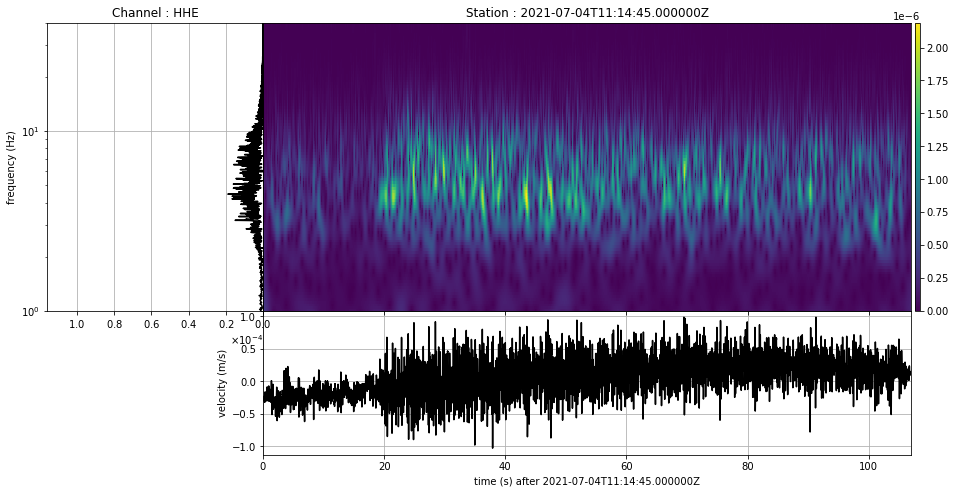

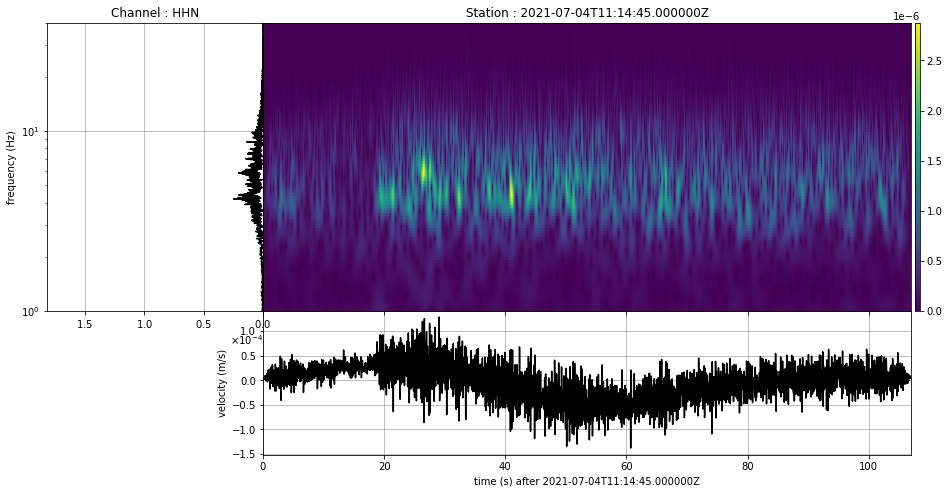

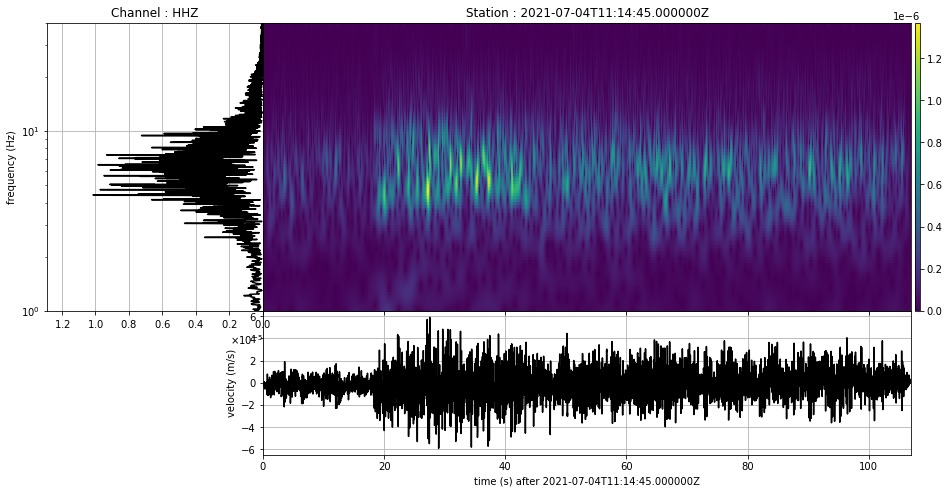

In [ ]:
# MEGRA
for i in range(len(megra)):
    mc.plot_tfr(
    megra[i].data, 
    tr=megra[i],
    fmin=1.0,
    fmax=40.0,
    dt=megra[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

#### Data Filter

In [64]:
mepas = mepas.filter('bandpass', freqmin = 1.0, freqmax=12.0)
melab = melab.filter('bandpass', freqmin = 1.0, freqmax=12.0)
mejro = mejro.filter('bandpass', freqmin = 1.0, freqmax=12.0)
megra = megra.filter('bandpass', freqmin = 1.0, freqmax=12.0)

#### Spectrogram After Filter

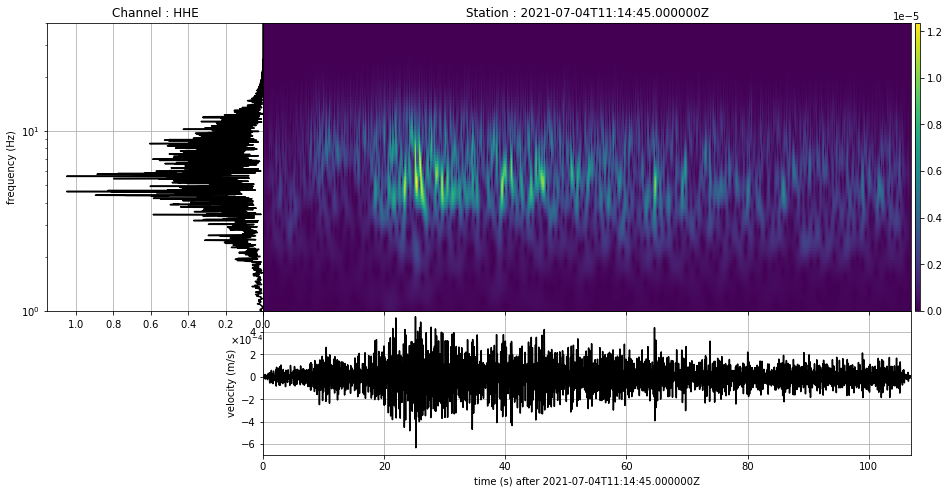

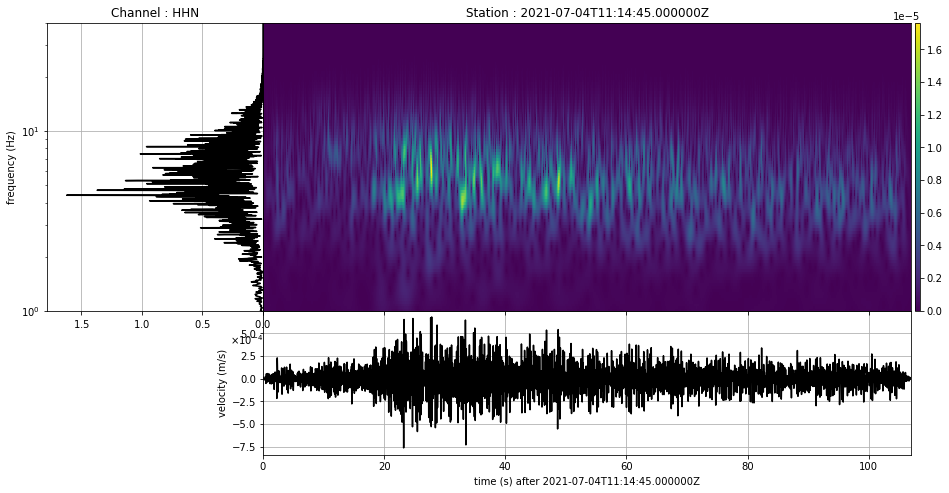

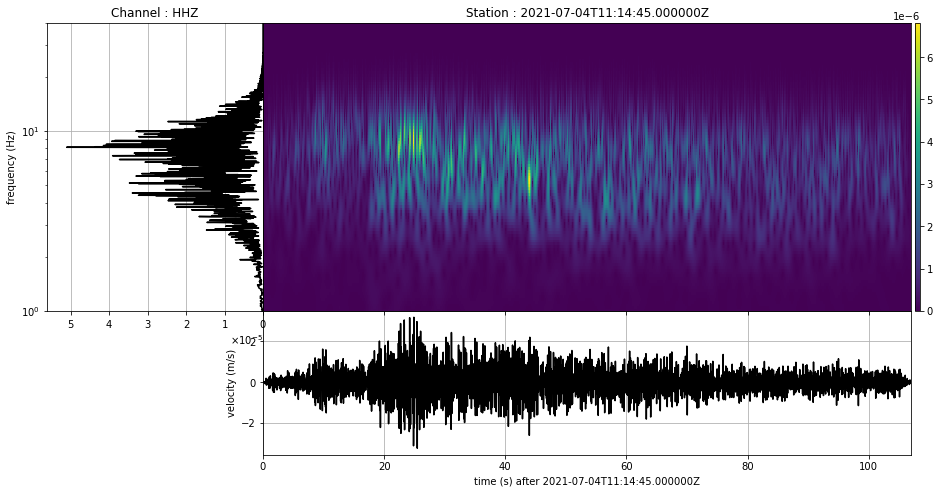

In [ ]:
# MEPAS
for i in range(len(mepas)):
    mc.plot_tfr(
    mepas[i].data, 
    tr=mepas[i],
    fmin=1.0,
    fmax=40.0,
    dt=mepas[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

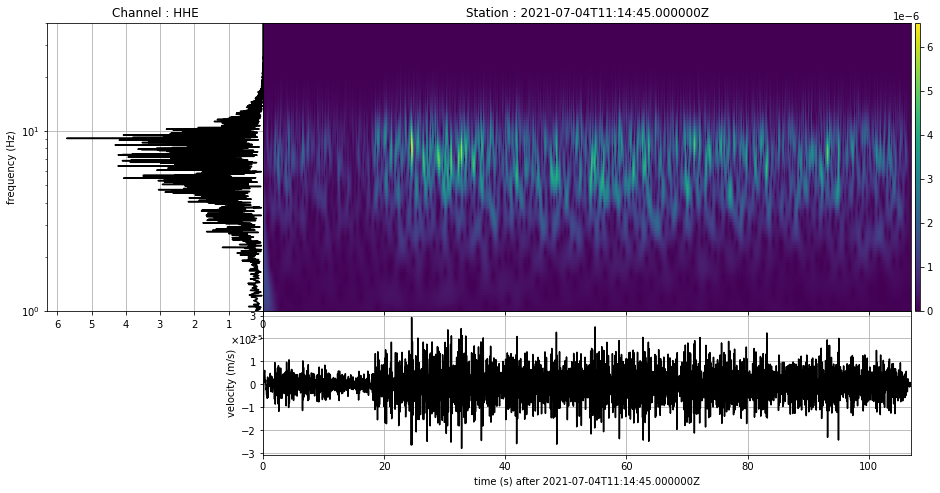

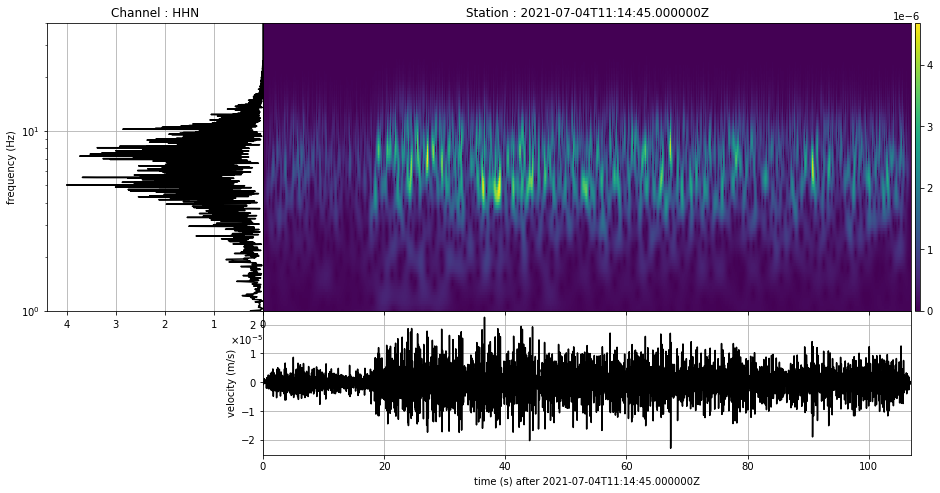

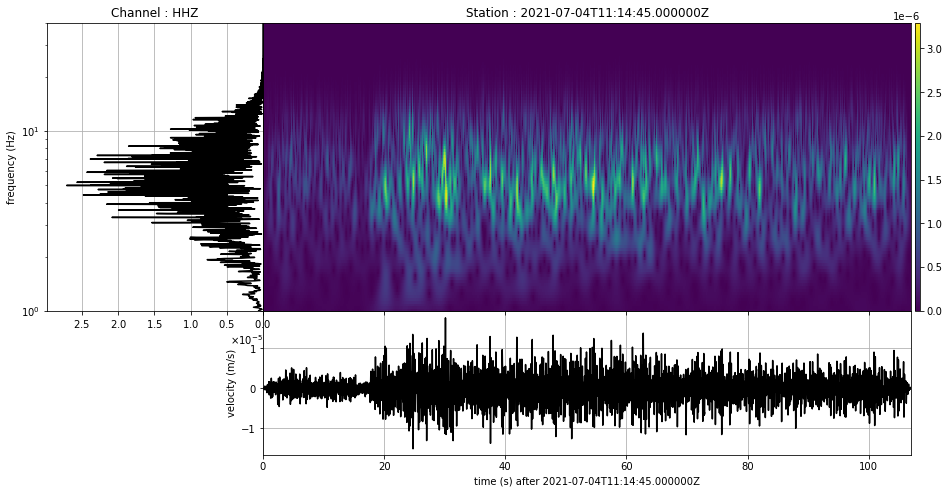

In [ ]:
# MELAB
for i in range(len(melab)):
    mc.plot_tfr(
    melab[i].data, 
    tr=melab[i],
    fmin=1.0,
    fmax=40.0,
    dt=melab[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

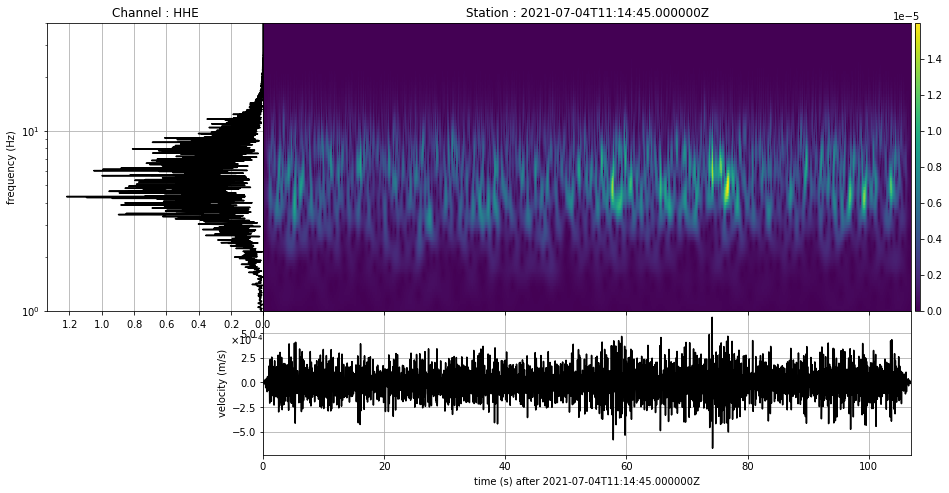

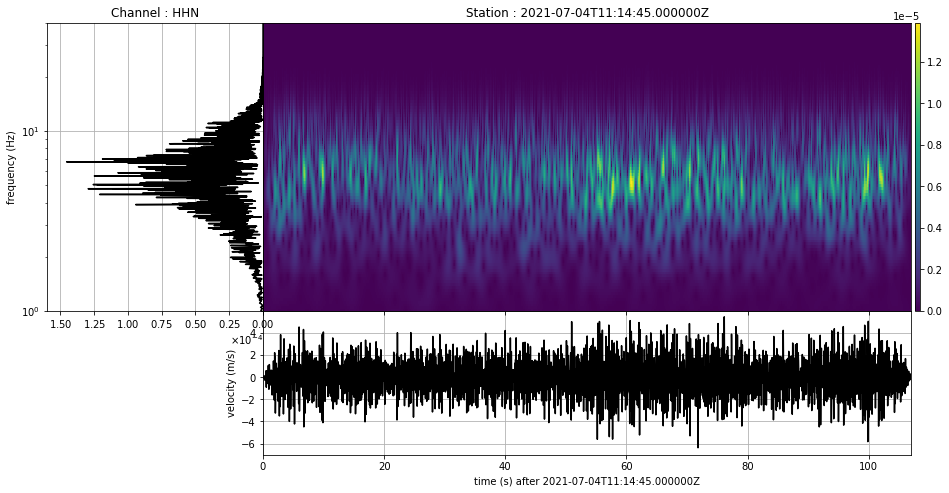

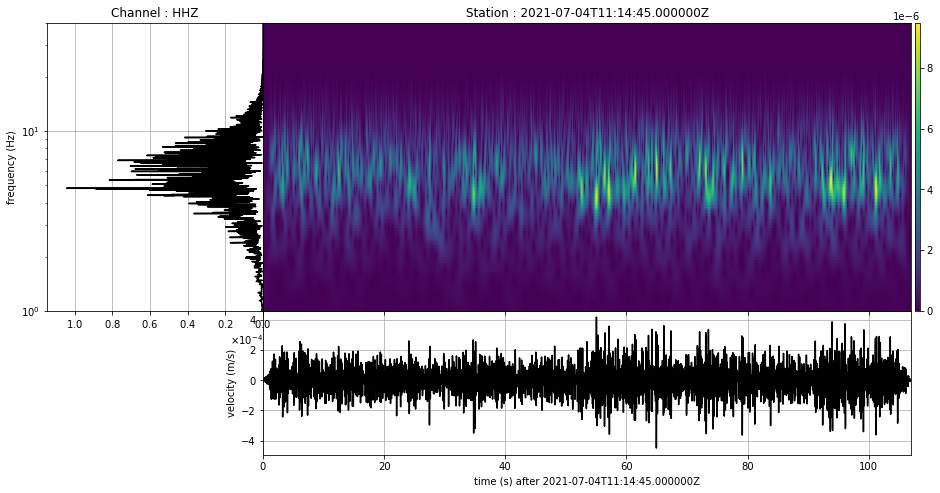

In [ ]:
# MEJRO
for i in range(len(mejro)):
    mc.plot_tfr(
    mejro[i].data, 
    tr=mejro[i],
    fmin=1.0,
    fmax=40.0,
    dt=mejro[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

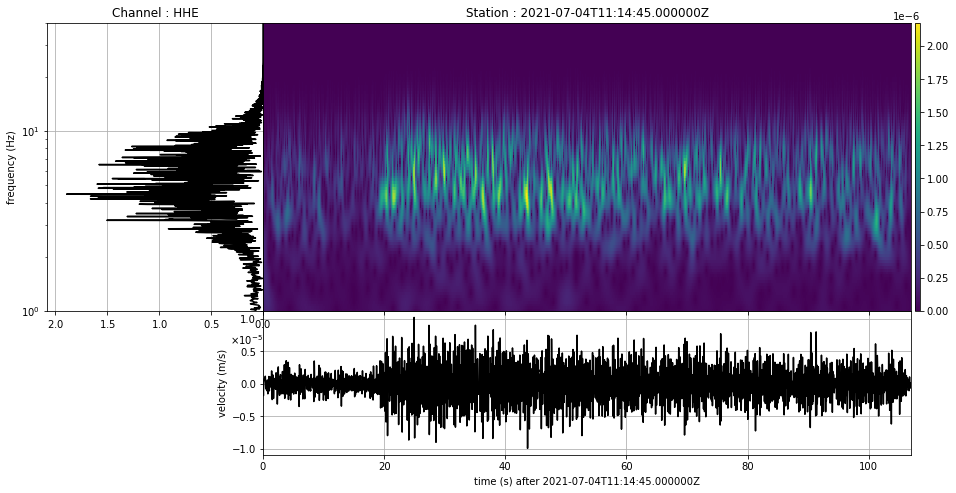

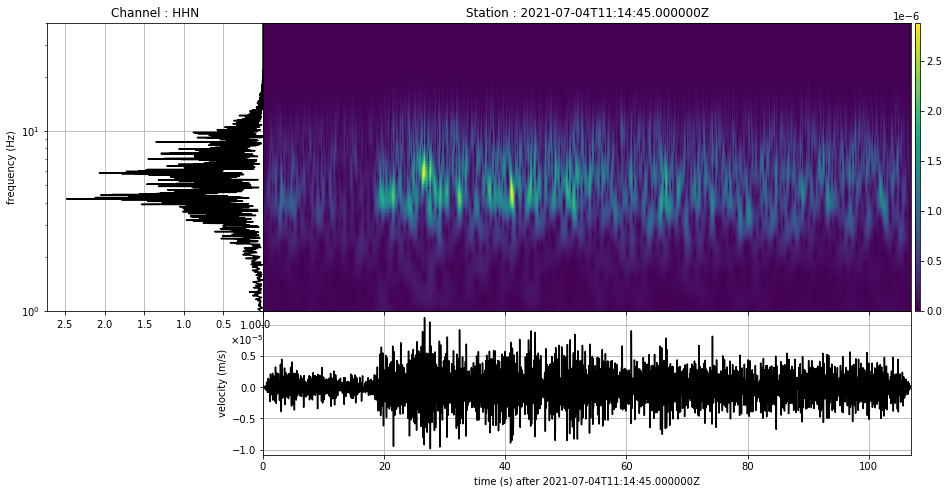

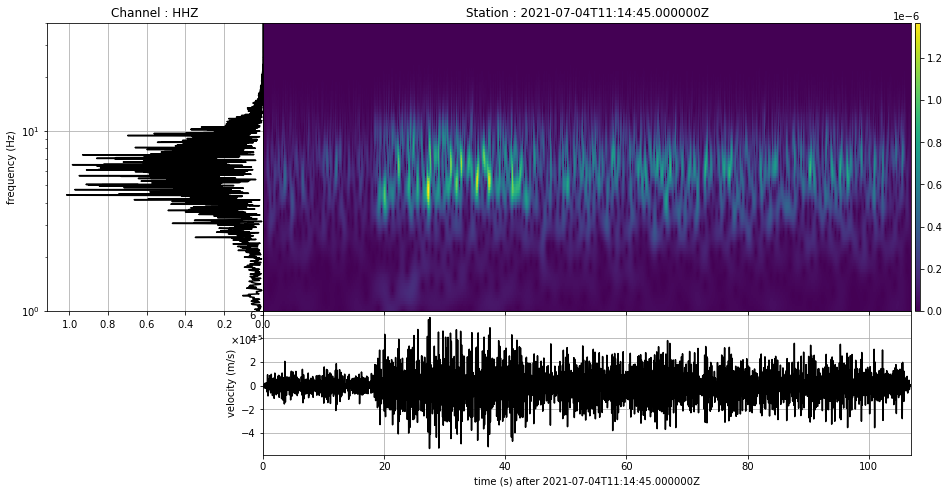

In [ ]:
# MEGRA
for i in range(len(megra)):
    mc.plot_tfr(
    megra[i].data, 
    tr=megra[i],
    fmin=1.0,
    fmax=40.0,
    dt=megra[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

### Particle Motion

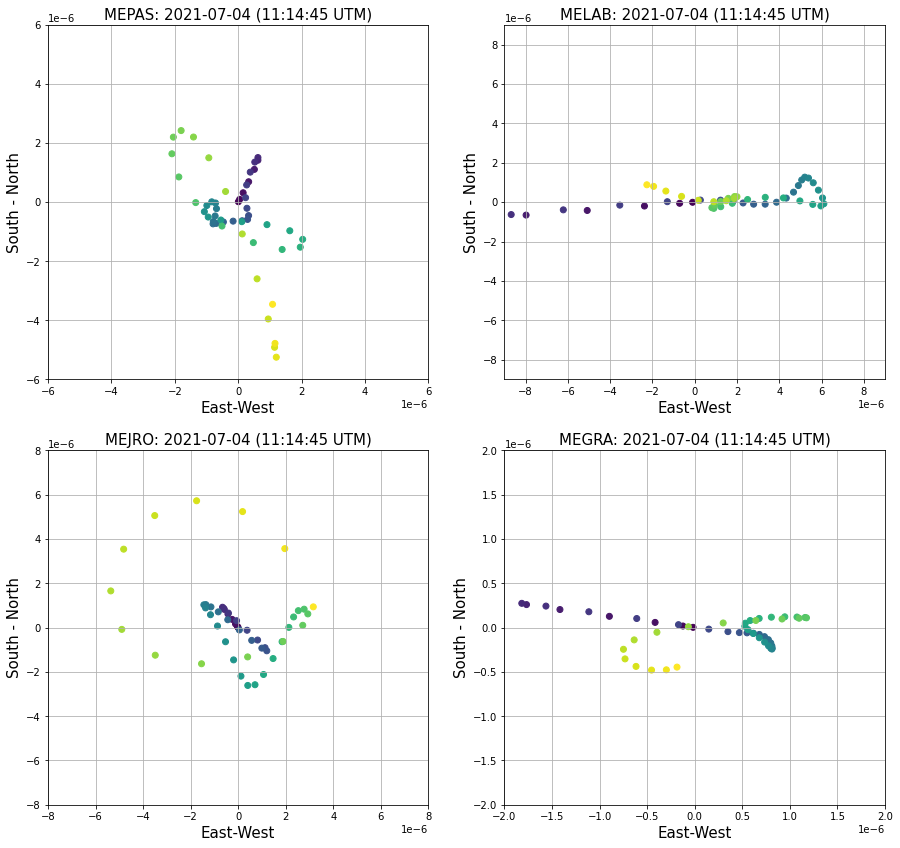

In [65]:
mepas_pm = mepas.copy()
melab_pm = melab.copy()
mejro_pm = mejro.copy()
megra_pm = megra.copy()

st_pm = mepas_pm+melab_pm+mejro_pm+megra_pm

start = st_pm[0].stats.starttime
end_pm = start + 0.5
st_pm = st_pm.trim(starttime=start, endtime=end_pm)

for tr in st_pm.select(channel='HHZ'):
  st_pm.remove(tr)

mepas_pm = st_pm.select(station = 'mepas')
mepas_ctime = np.array(mepas_pm[0].times())
melab_pm = st_pm.select(station = 'melab')
melab_ctime = np.array(melab_pm[0].times())
mejro_pm = st_pm.select(station = 'mejro')
mejro_ctime = np.array(mejro_pm[0].times())
megra_pm = st_pm.select(station = 'megra')
megra_ctime = np.array(megra_pm[0].times())


lim = 0.000008


fig = plt.figure(figsize=(15, 30))
ax=fig.add_subplot(421)
ax.set_title('MEPAS: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax.set_xlabel('East-West', fontsize = 15)
ax.set_ylabel('South - North', fontsize = 15)
ax.set_xlim(-0.000006, 0.000006)
ax.set_ylim(-0.000006, 0.000006)
ax.scatter(mepas_pm[0].data, mepas_pm[1].data, marker='o', c=mepas_ctime)

ax1=fig.add_subplot(422)
ax1.set_title('MELAB: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax1.set_xlabel('East-West', fontsize = 15)
ax1.set_ylabel('South - North', fontsize = 15)
ax1.set_xlim(-0.000009, 0.000009)
ax1.set_ylim(-0.000009, 0.000009)
ax1.scatter(melab_pm[0].data, melab_pm[1].data, marker='o', c=melab_ctime)

ax2=fig.add_subplot(423)
ax2.set_title('MEJRO: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax2.set_xlabel('East-West', fontsize = 15)
ax2.set_ylabel('South - North', fontsize = 15)
ax2.set_xlim(-lim, lim)
ax2.set_ylim(-lim, lim)
ax2.scatter(mejro_pm[0].data, mejro_pm[1].data, marker='o', c=mejro_ctime)

ax3=fig.add_subplot(424)
ax3.set_title('MEGRA: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax3.set_xlabel('East-West', fontsize = 15)
ax3.set_ylabel('South - North', fontsize = 15)
ax3.set_xlim(-0.000002, 0.000002)
ax3.set_ylim(-0.000002, 0.000002)
ax3.scatter(megra_pm[0].data, megra_pm[1].data, marker='o', c=megra_ctime)

ax.grid()
ax1.grid()
ax2.grid()
ax3.grid()

plt.savefig('Particle Motion - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white', transparent=False)
ax = plt.gca


### Beamforming ⭕

In [ ]:
mepas_fk = mepas.copy()
melab_fk = melab.copy()
mejro_fk = mejro.copy()
megra_fk = megra.copy()


st_ = mepas_fk+melab_fk+mejro_fk+megra_fk
st_fk = st_.copy()
st_fk = st_fk.select(channel = 'HHZ')

In [ ]:
fmin = 1.0
fmax = 12.0
slw = 3.0
sl_s = 1.0
win_len = 1.0
win_frac = 0.5

start = []
for i in range(len(st_fk)):
    start.append(st_fk[i].stats.starttime)
end = []
for i in range(len(st_fk)):
    end.append(st_fk[i].stats.endtime)

t0 = max(start)
t1 = min(end)

st_fk = st_fk.trim(t0, t1)

start = st_fk[0].stats.starttime
end = st_fk[0].stats.endtime

kwargs = dict(
    # slowness grid (x,y) and slow step
    sll_x=-slw, slm_x=slw, sll_y=-slw, slm_y=slw, sl_s=sl_s,
    #sliding window
    win_len=win_len, win_frac=win_frac,
    # frequency for bandpass
    frqlow=fmin, frqhigh=fmax, prewhiten=0,
    # semblance
    semb_thres=-1e9, vel_thres=-1e9,
    stime=start, etime=end, method=0)

out = array_processing(stream=st_fk, **kwargs)


# return = timestamp, realtive relpow, abs relpow, baz, slowness

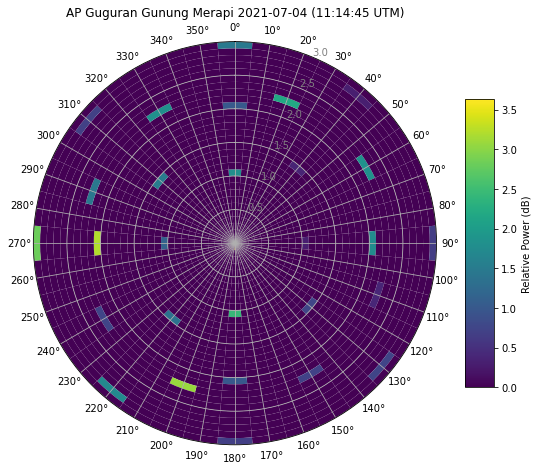

In [ ]:
# plotting array

cmap = obspy_sequential

#adjust BAZ into range 0 - 360 degree
t, rel_power, abs_power, baz, slow = out.T
baz[baz<0.0] += 360

df10 = pd.DataFrame({"Time":t, "Backazimuth":baz, "Slowness":slow, 
                    "Relative Power":rel_power
                    
                    })

N=36
N2=30
abins = np.arange(N+1) *360./N
sbins = np.linspace(0, 3, N2+1)

# sum relative power in bins
hist, baz_edges, sl_edges = \
    np.histogram2d(baz, slow, bins=[abins, sbins], weights=rel_power)

# get radians
baz_edges = np.radians(baz_edges)


# polar diagram
fig = plt.figure(figsize=(8,8))
cax = fig.add_axes([0.85, 0.2, 0.05, 0.5])
ax = fig.add_axes([0.10, 0.1, 0.70, 0.70], polar=True)
ax.set_theta_direction(-1)
ax.set_theta_zero_location('N')

dh = abs(sl_edges[1]-sl_edges[0])
dw = abs(baz_edges[1]-baz_edges[0])

for i, row in enumerate(hist):
    bars = ax.bar((i*dw) * np.ones(N2),
                   height=dh*np.ones(N2),
                   width=dw, bottom=dh*np.arange(N2),
                   color=cmap(row/hist.max()))
    
ax.set_xticks(np.linspace(0, 2*np.pi, 36, endpoint=False))
ax.set_title('AP Guguran Gunung Merapi %s' %(start.strftime('%Y-%m-%d (%H:%M:%S UTC)'),))

# slowness limit
ax.set_ylim(0,3)
[i.set_color('grey') for i in ax.get_yticklabels()]
ColorbarBase(cax, cmap=cmap, norm=Normalize(vmin=hist.min(), vmax=hist.max()), label='Relative Power (dB)')

plt.savefig('Polar Plot - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white')
plt.show()

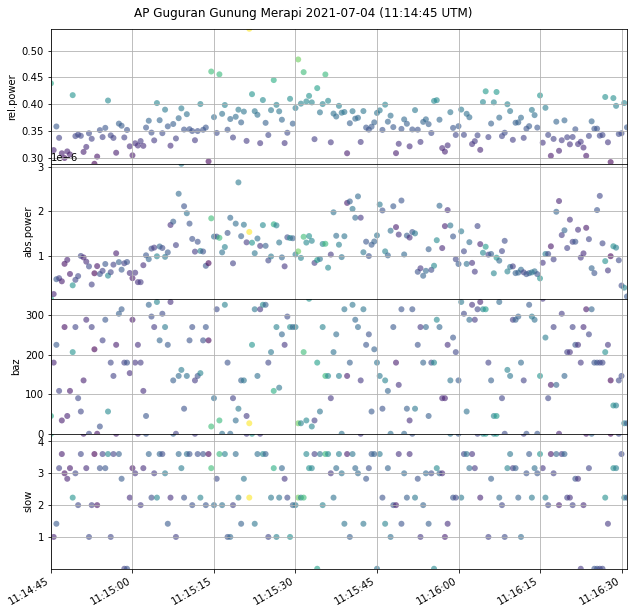

In [ ]:
# plot
labels = ['rel.power', 'abs.power', 'baz', 'slow']
xlocator = mdates.AutoDateLocator()
fig = plt.figure(figsize=(10,10))
for i, lab in enumerate(labels):
    ax = fig.add_subplot(4, 1, i + 1)
    ax.scatter(out[:, 0], out[:, i + 1], c=out[:, 1], alpha=0.6,
               edgecolors='none', cmap=obspy_sequential)
    ax.set_ylabel(lab)
    ax.set_xlim(out[0, 0], out[-1, 0])
    ax.set_ylim(out[:, i + 1].min(), out[:, i + 1].max())
    ax.xaxis.set_major_locator(xlocator)
    ax.xaxis.set_major_formatter(mdates.AutoDateFormatter(xlocator))
    ax.grid()
    
fig.suptitle('AP Guguran Gunung Merapi %s' % (start.strftime('%Y-%m-%d (%H:%M:%S UTC)'), ))
fig.autofmt_xdate()
fig.subplots_adjust(left=0.15, top=0.95, right=0.95, bottom=0.2, hspace=0)

plt.savefig('Plot - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white')
plt.show()

## 5 | (2021-07-04 | 13:21:00) | SE

In [25]:
chID = 'ENZ'
direction = 'SE'
path = 'data/'+direction

st=read(path+"/VG.*"+".D.20*"+".MSEED", type='MSEED')

st = st.sort()


In [26]:
time_s = time4
time_e = time_s + time04

st0 = st.copy()
st0 = st0.trim(starttime=time_s, endtime=time_e)

### MEPAS

In [28]:
station = 'mepas'
mepas = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

mepas = mepas.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
mepas

3 Trace(s) in Stream:
VG.MEPAS.00.HHE | 2021-07-04T13:21:35.000000Z - 2021-07-04T13:23:07.000000Z | 100.0 Hz, 9201 samples
VG.MEPAS.00.HHN | 2021-07-04T13:21:35.000000Z - 2021-07-04T13:23:07.000000Z | 100.0 Hz, 9201 samples
VG.MEPAS.00.HHZ | 2021-07-04T13:21:35.000000Z - 2021-07-04T13:23:07.000000Z | 100.0 Hz, 9201 samples

In [29]:
for i in range(len(mepas)):
    mepas[i].stats.coordinates = AttribDict({'latitude':-7.535567,
                                             'longitude':110.449185,
                                             'elevation':2679})

### MELAB

In [30]:
station = 'melab'
melab = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

melab = melab.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
melab

3 Trace(s) in Stream:
VG.MELAB.00.HHE | 2021-07-04T13:21:35.000000Z - 2021-07-04T13:23:07.000000Z | 100.0 Hz, 9201 samples
VG.MELAB.00.HHN | 2021-07-04T13:21:35.000000Z - 2021-07-04T13:23:07.000000Z | 100.0 Hz, 9201 samples
VG.MELAB.00.HHZ | 2021-07-04T13:21:35.000000Z - 2021-07-04T13:23:07.000000Z | 100.0 Hz, 9201 samples

In [31]:
for i in range(len(melab)):
    melab[i].stats.coordinates = AttribDict({'latitude':-7.557044,
                                         'longitude':110.445038,
                                         'elevation':1730})

### MEJRO

In [32]:
station = 'mejro'
mejro = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

mejro = mejro.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
mejro

3 Trace(s) in Stream:
VG.MEJRO.00.HHE | 2021-07-04T13:21:35.000000Z - 2021-07-04T13:23:07.000000Z | 100.0 Hz, 9201 samples
VG.MEJRO.00.HHN | 2021-07-04T13:21:35.000000Z - 2021-07-04T13:23:07.000000Z | 100.0 Hz, 9201 samples
VG.MEJRO.00.HHZ | 2021-07-04T13:21:35.000000Z - 2021-07-04T13:23:07.000000Z | 100.0 Hz, 9201 samples

In [33]:
for i in range(len(mejro)):
    mejro[i].stats.coordinates = AttribDict({'latitude':-7.555357,
                                         'longitude':110.419287,
                                         'elevation':1335})

### MEGRA

In [34]:
station = 'megra'
megra = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

megra = megra.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
megra

3 Trace(s) in Stream:
VG.MEGRA.00.HHE | 2021-07-04T13:21:35.000000Z - 2021-07-04T13:23:07.000000Z | 100.0 Hz, 9201 samples
VG.MEGRA.00.HHN | 2021-07-04T13:21:35.000000Z - 2021-07-04T13:23:07.000000Z | 100.0 Hz, 9201 samples
VG.MEGRA.00.HHZ | 2021-07-04T13:21:35.000000Z - 2021-07-04T13:23:07.000000Z | 100.0 Hz, 9201 samples

In [35]:
for i in range(len(megra)):
    megra[i].stats.coordinates = AttribDict({'latitude':-7.52163,
                                         'longitude':110.45149,
                                         'elevation':2045})

### Signal Analysis

#### Spectrogram Before Filter

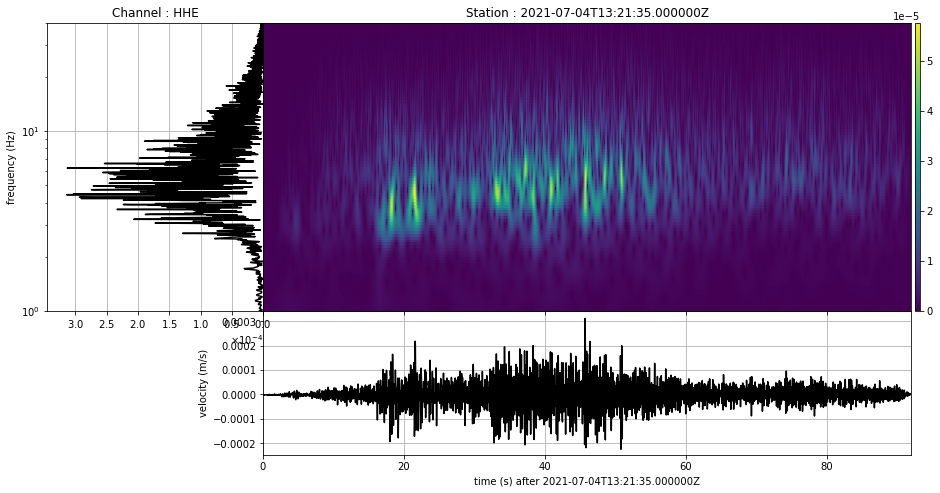

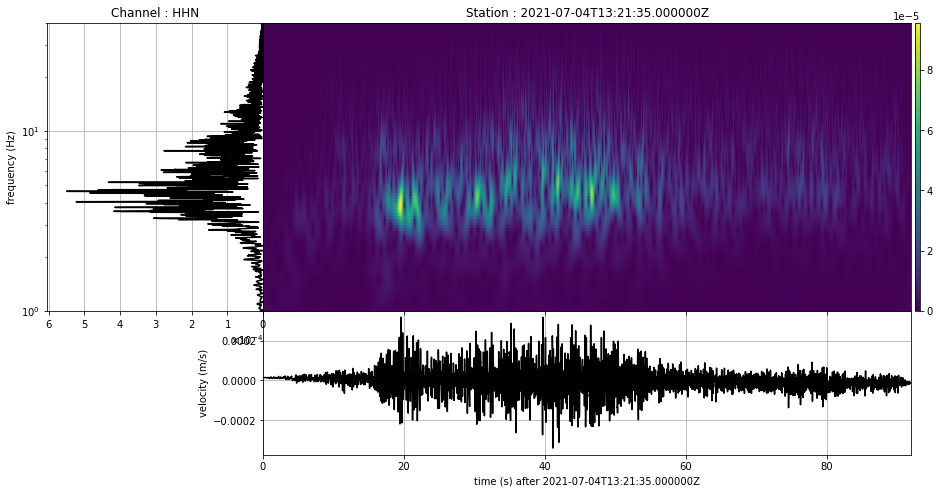

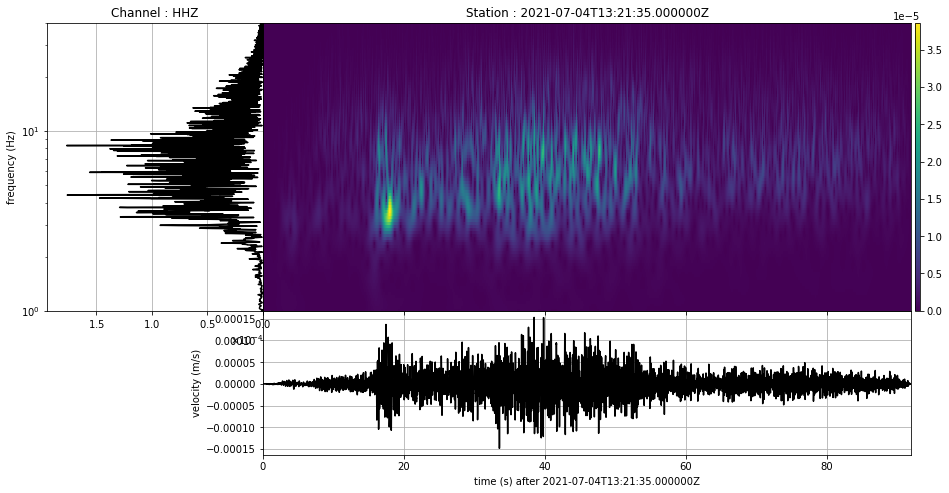

In [ ]:
# MEPAS
for i in range(len(mepas)):
    mc.plot_tfr(
    mepas[i].data, 
    tr=mepas[i],
    fmin=1.0,
    fmax=40.0,
    dt=mepas[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

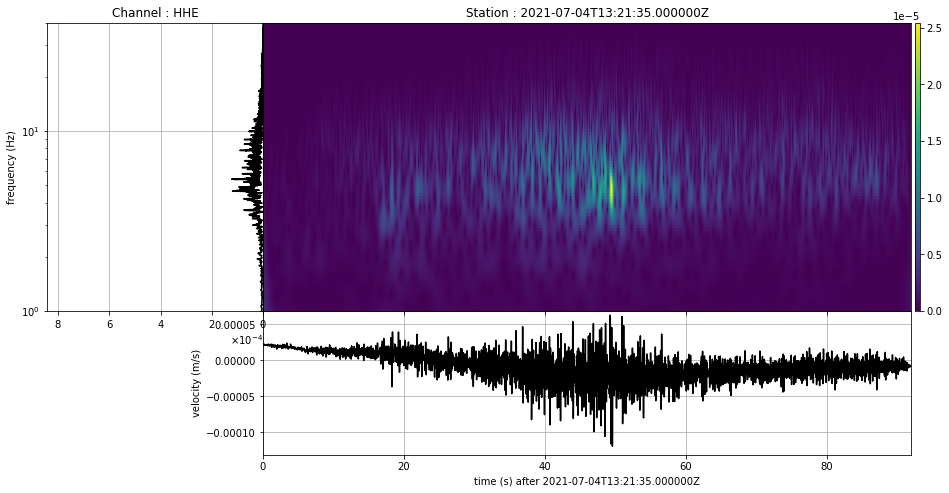

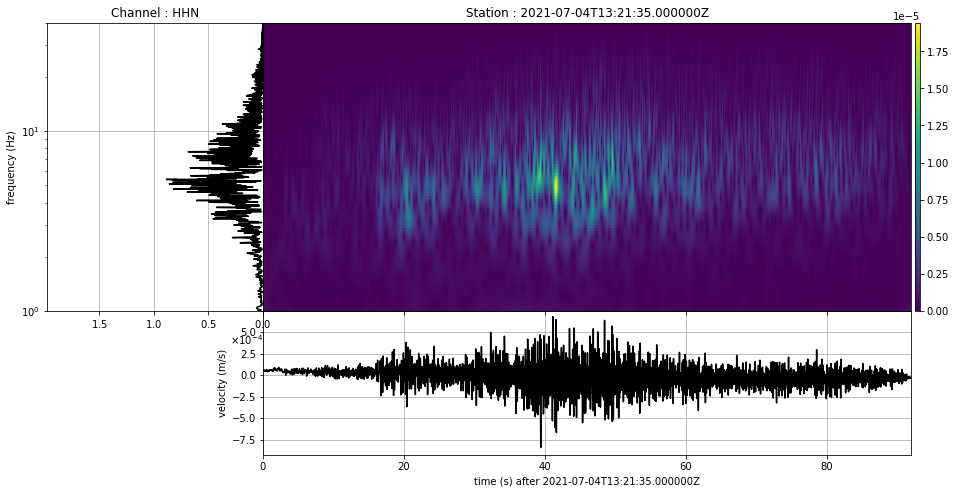

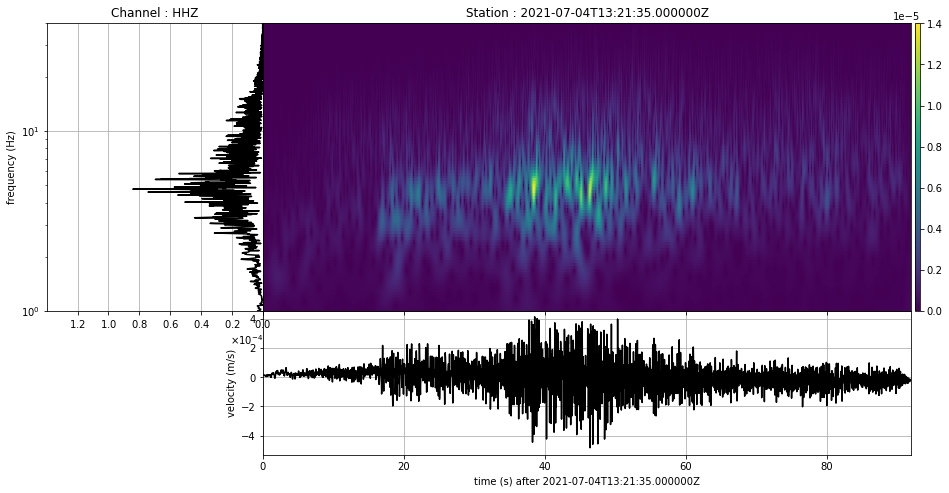

In [ ]:
# MELAB
for i in range(len(melab)):
    mc.plot_tfr(
    melab[i].data, 
    tr=melab[i],
    fmin=1.0,
    fmax=40.0,
    dt=melab[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

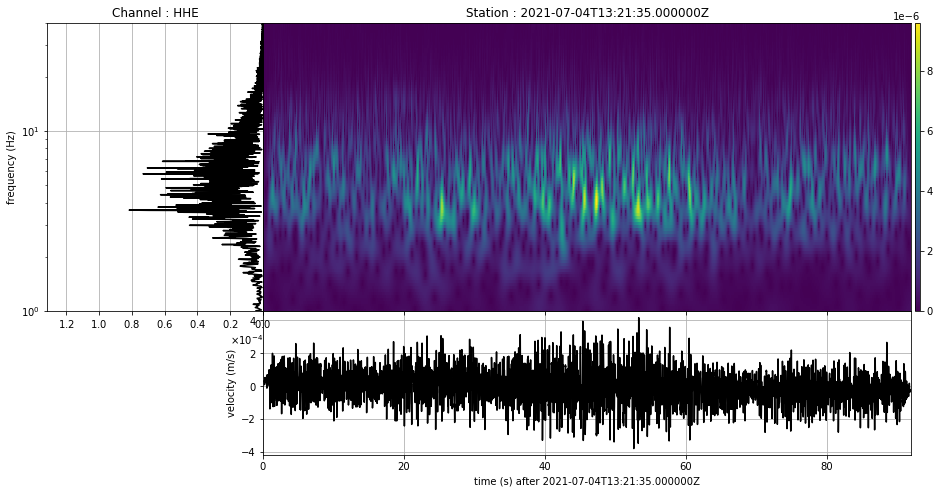

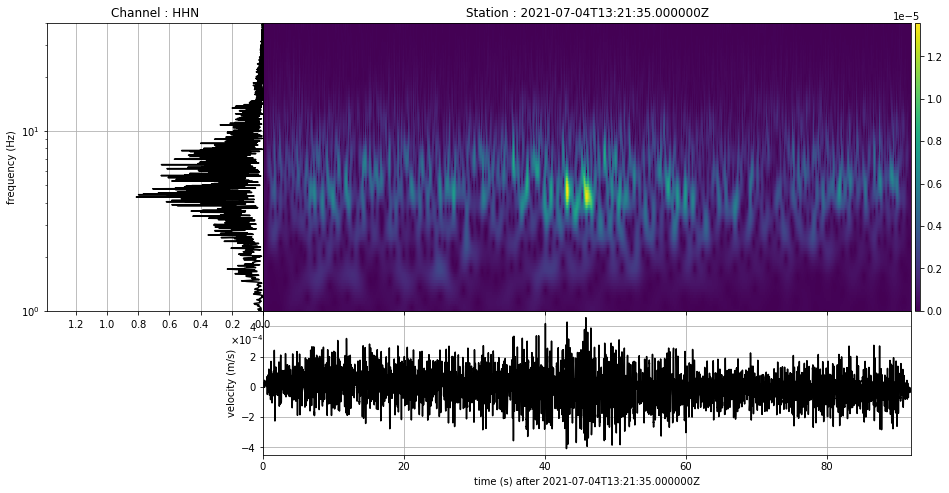

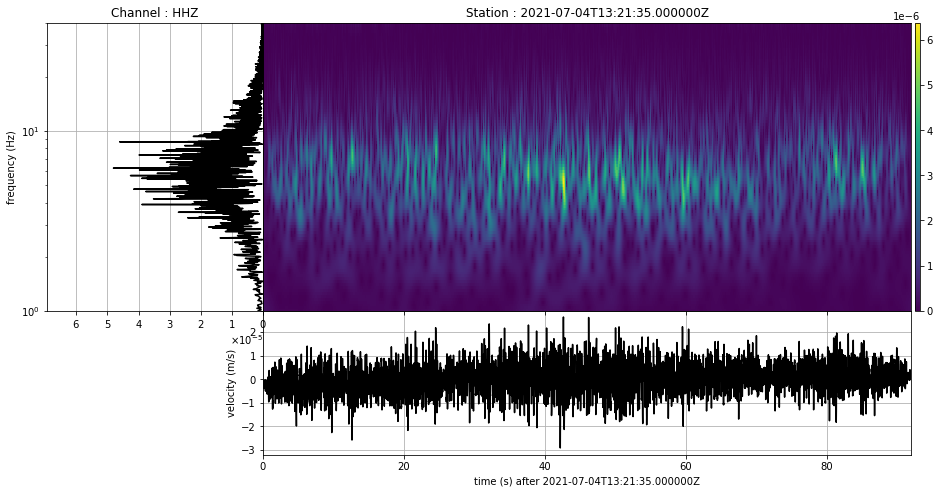

In [ ]:
# MEJRO
for i in range(len(mejro)):
    mc.plot_tfr(
    mejro[i].data, 
    tr=mejro[i],
    fmin=1.0,
    fmax=40.0,
    dt=mejro[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

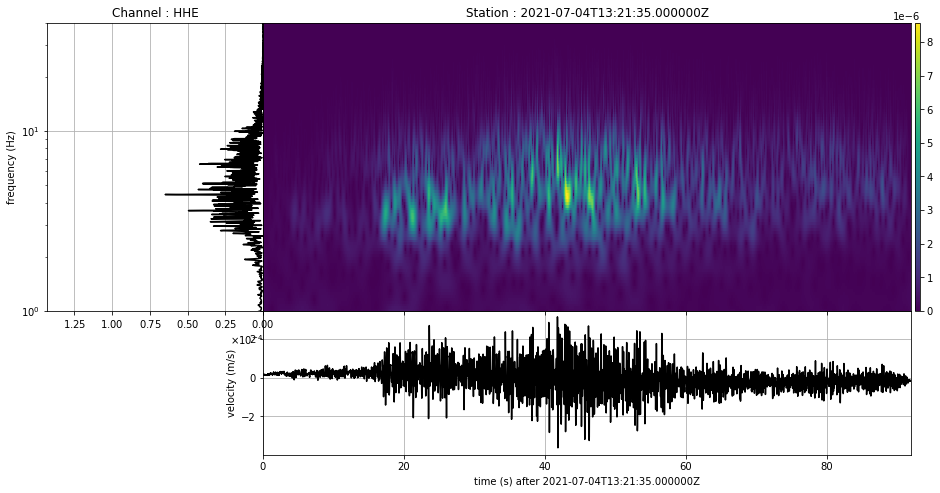

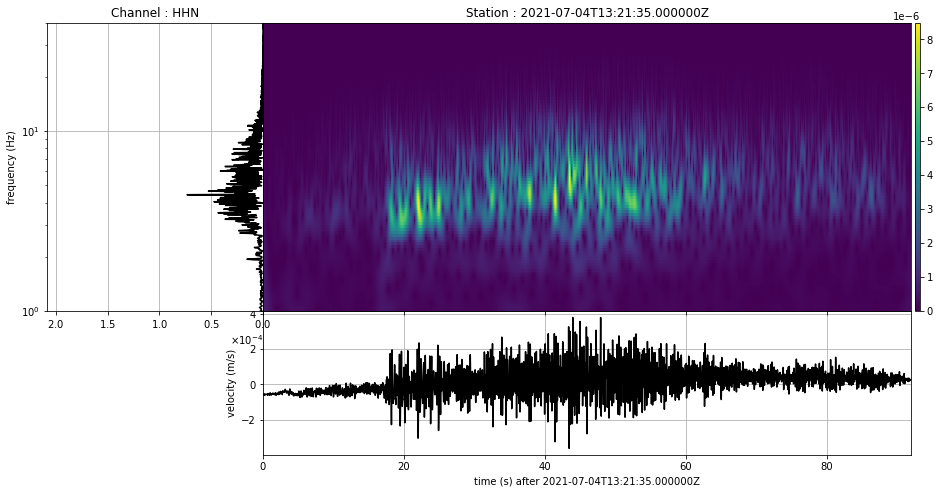

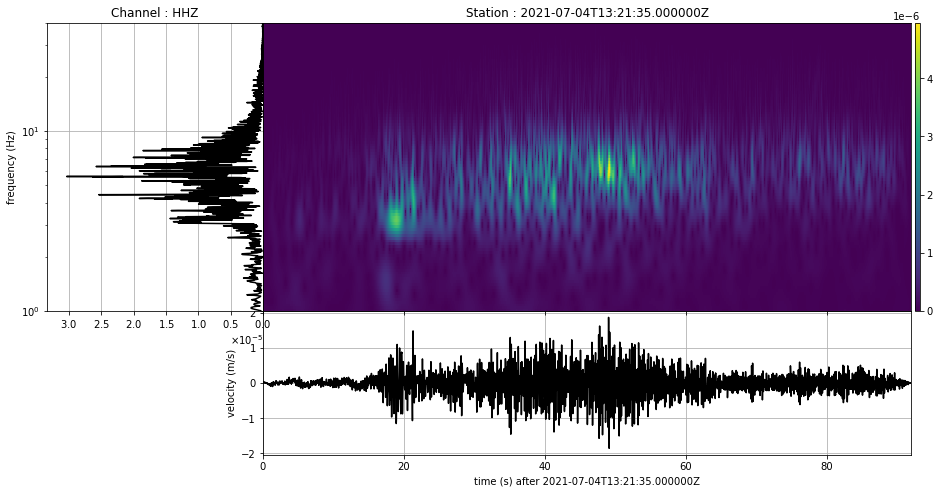

In [ ]:
# MEGRA
for i in range(len(megra)):
    mc.plot_tfr(
    megra[i].data, 
    tr=megra[i],
    fmin=1.0,
    fmax=40.0,
    dt=megra[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

#### Data Filter

In [36]:
mepas = mepas.filter('bandpass', freqmin = 1.0, freqmax=12.0)
melab = melab.filter('bandpass', freqmin = 1.0, freqmax=12.0)
mejro = mejro.filter('bandpass', freqmin = 1.0, freqmax=12.0)
megra = megra.filter('bandpass', freqmin = 1.0, freqmax=12.0)

#### Spectrogram After Filter

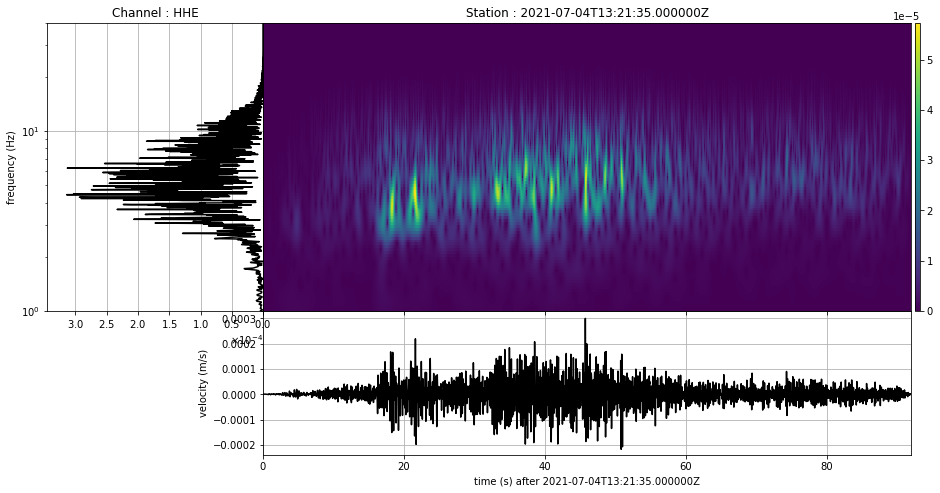

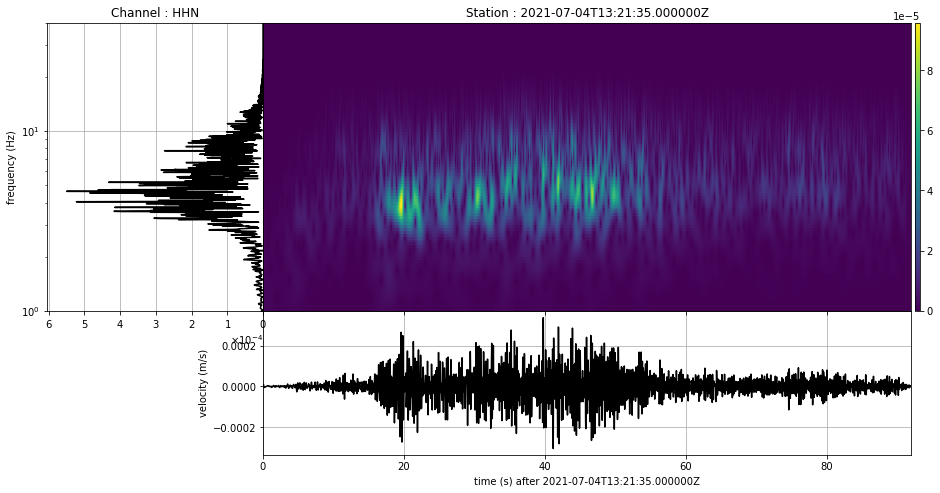

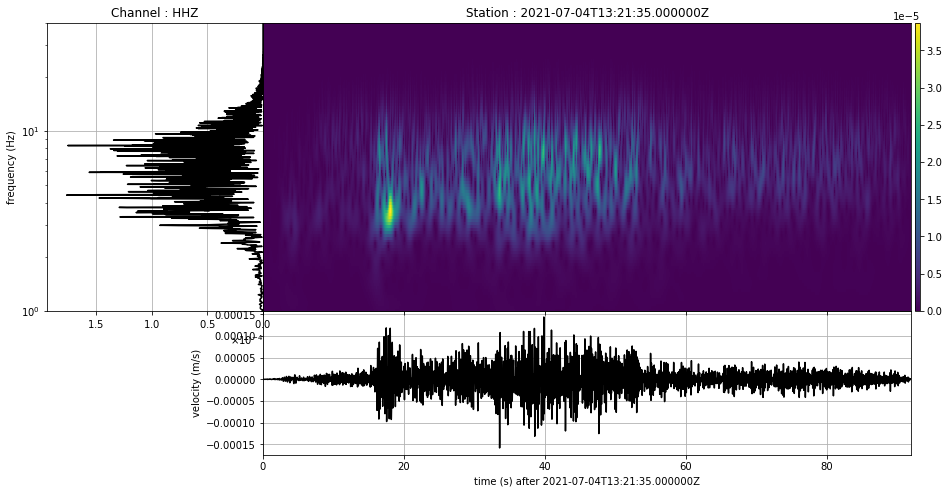

In [ ]:
# MEPAS
for i in range(len(mepas)):
    mc.plot_tfr(
    mepas[i].data, 
    tr=mepas[i],
    fmin=1.0,
    fmax=40.0,
    dt=mepas[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

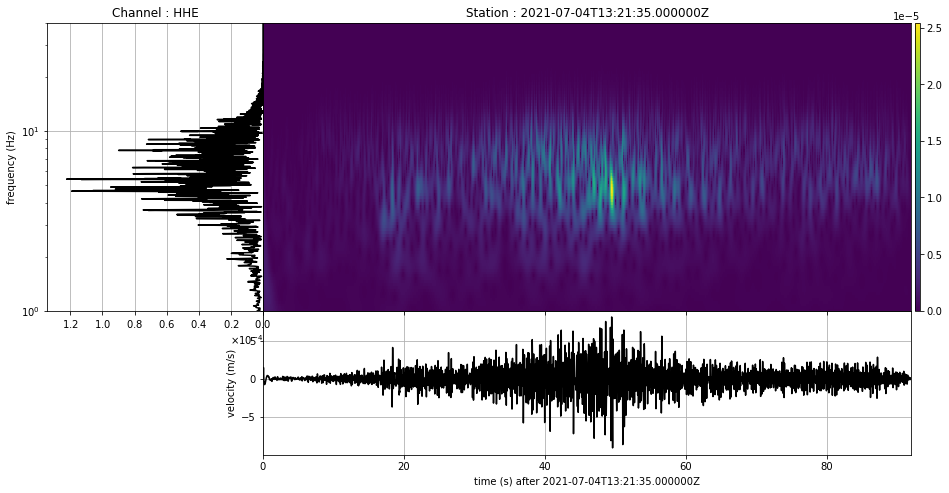

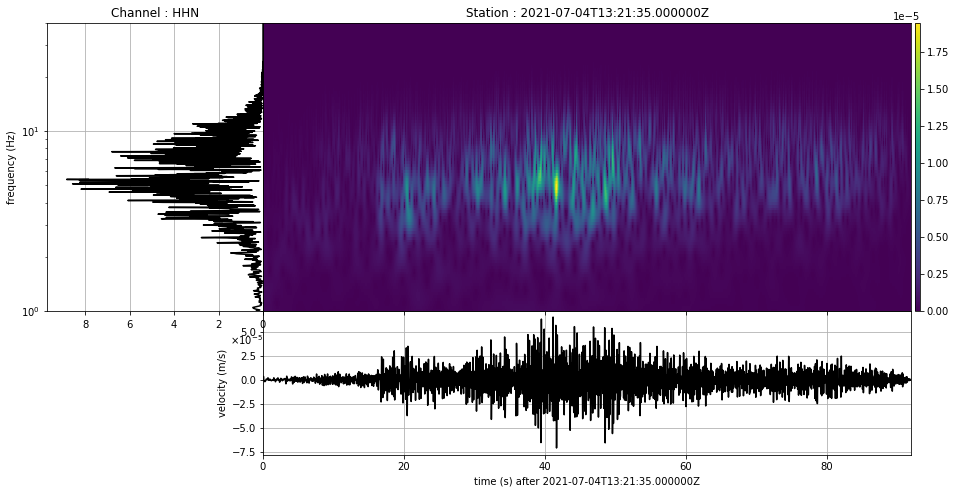

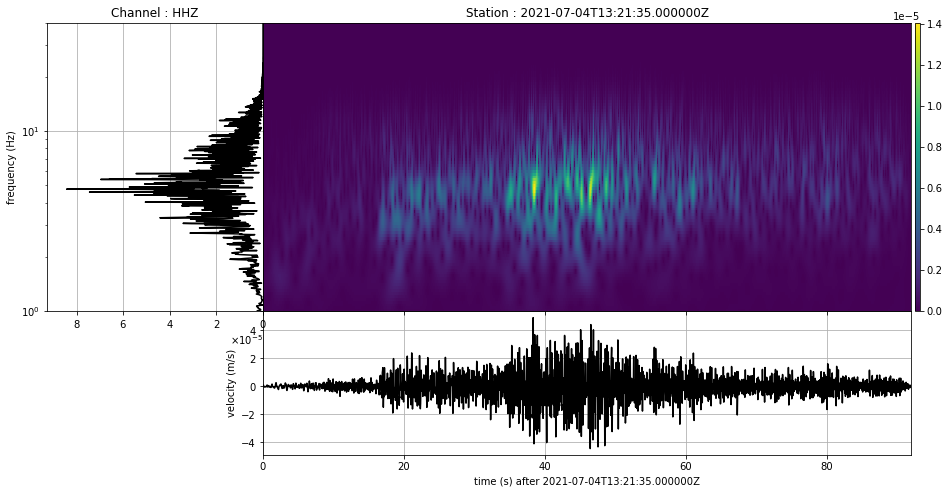

In [ ]:
# MELAB
for i in range(len(melab)):
    mc.plot_tfr(
    melab[i].data, 
    tr=melab[i],
    fmin=1.0,
    fmax=40.0,
    dt=melab[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

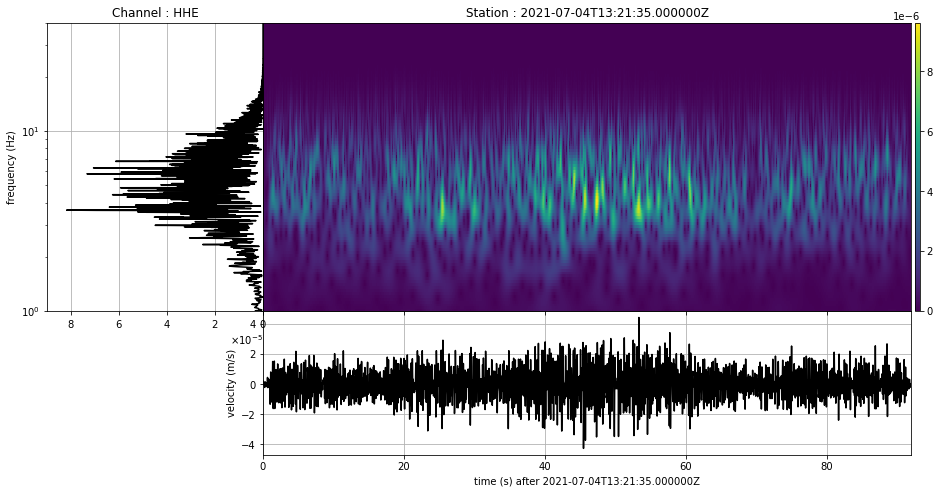

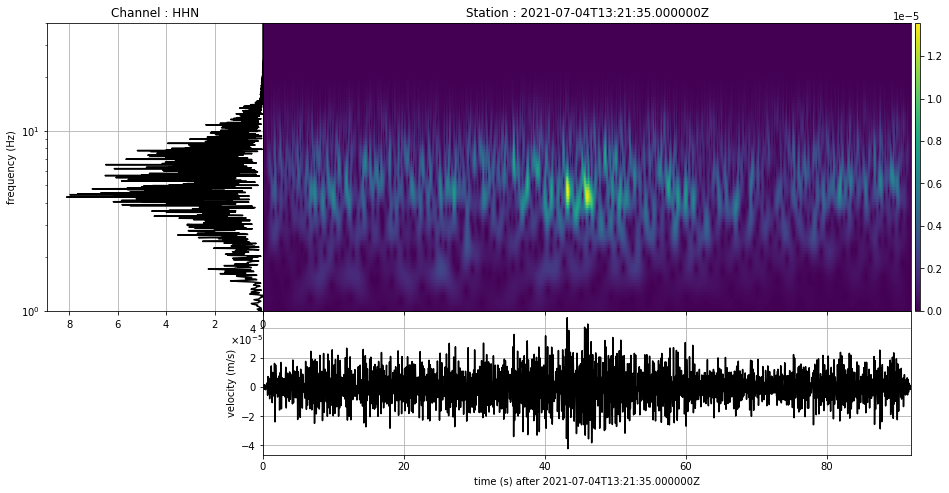

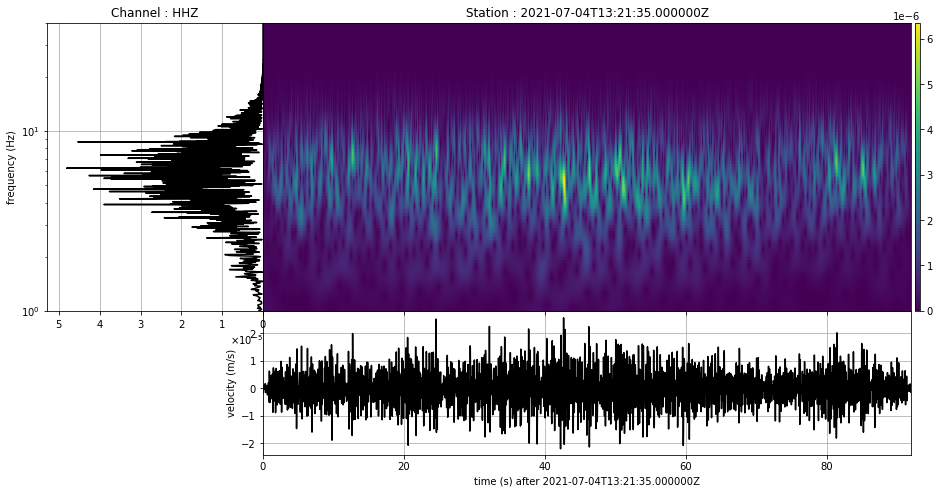

In [ ]:
# MEJRO
for i in range(len(mejro)):
    mc.plot_tfr(
    mejro[i].data, 
    tr=mejro[i],
    fmin=1.0,
    fmax=40.0,
    dt=mejro[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

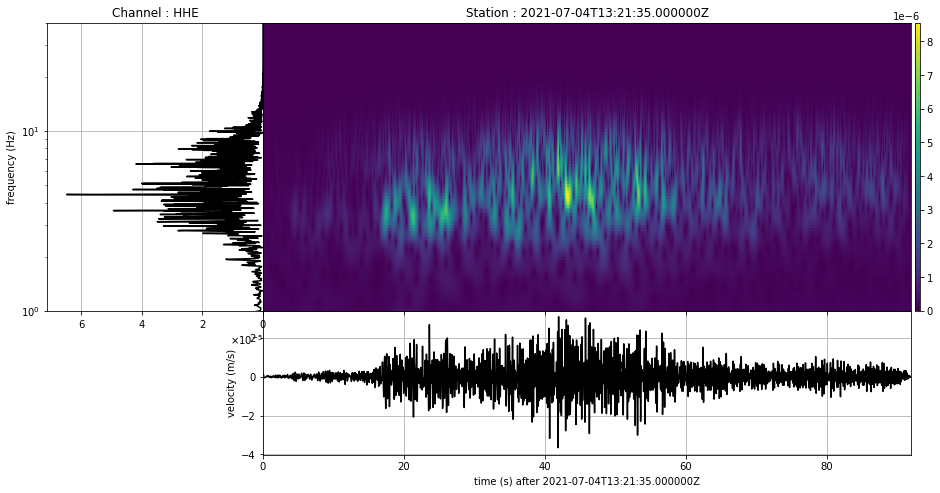

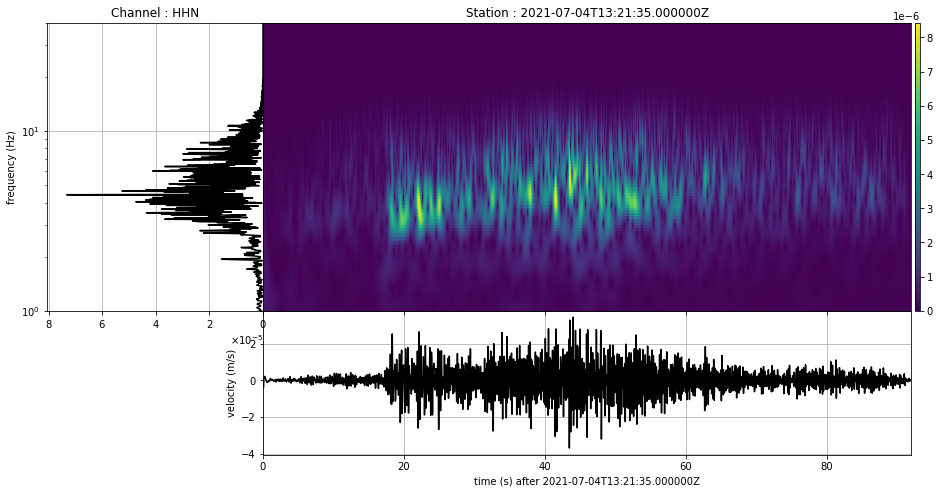

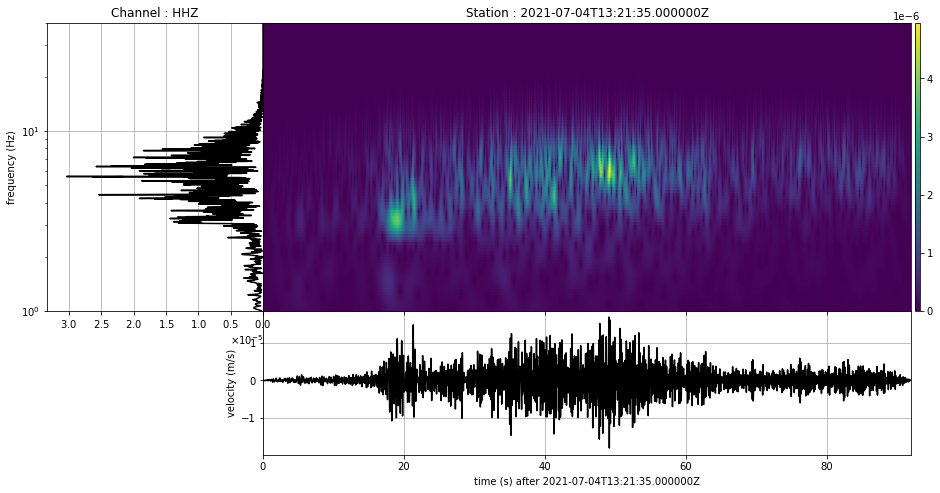

In [ ]:
# MEGRA
for i in range(len(megra)):
    mc.plot_tfr(
    megra[i].data, 
    tr=megra[i],
    fmin=1.0,
    fmax=40.0,
    dt=megra[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

### Particle Motion

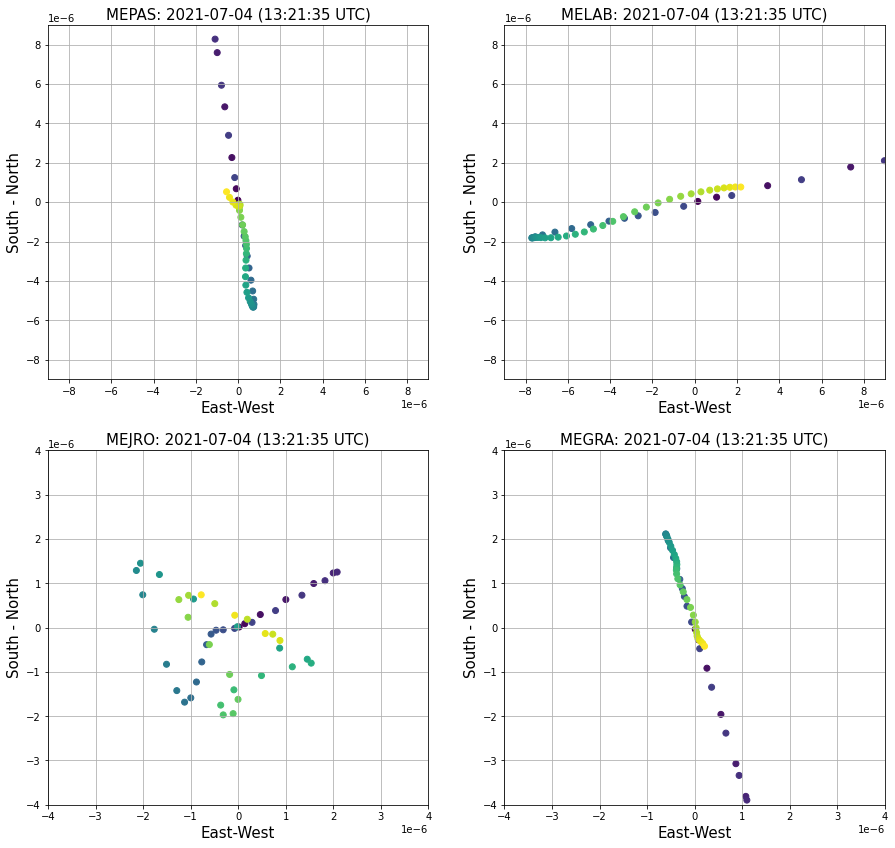

In [68]:
mepas_pm = mepas.copy()
melab_pm = melab.copy()
mejro_pm = mejro.copy()
megra_pm = megra.copy()

st_pm = mepas_pm+melab_pm+mejro_pm+megra_pm

start = st_pm[0].stats.starttime
end_pm = start + 0.5
st_pm = st_pm.trim(starttime=start, endtime=end_pm)

for tr in st_pm.select(channel='HHZ'):
  st_pm.remove(tr)

mepas_pm = st_pm.select(station = 'mepas')
mepas_ctime = np.array(mepas_pm[0].times())
melab_pm = st_pm.select(station = 'melab')
melab_ctime = np.array(melab_pm[0].times())
mejro_pm = st_pm.select(station = 'mejro')
mejro_ctime = np.array(mejro_pm[0].times())
megra_pm = st_pm.select(station = 'megra')
megra_ctime = np.array(megra_pm[0].times())

lim = 0.000009

fig = plt.figure(figsize=(15, 30))
ax=fig.add_subplot(421)
ax.set_title('MEPAS: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax.set_xlabel('East-West', fontsize = 15)
ax.set_ylabel('South - North', fontsize = 15)
ax.set_xlim(-lim, lim)
ax.set_ylim(-lim, lim)
ax.scatter(mepas_pm[0].data, mepas_pm[1].data, marker='o', c=mepas_ctime)

ax1=fig.add_subplot(422)
ax1.set_title('MELAB: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax1.set_xlabel('East-West', fontsize = 15)
ax1.set_ylabel('South - North', fontsize = 15)
ax1.set_xlim(-lim, lim)
ax1.set_ylim(-lim, lim)
ax1.scatter(melab_pm[0].data, melab_pm[1].data, marker='o', c=melab_ctime)

ax2=fig.add_subplot(423)
ax2.set_title('MEJRO: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax2.set_xlabel('East-West', fontsize = 15)
ax2.set_ylabel('South - North', fontsize = 15)
ax2.set_xlim(-0.000004, 0.000004)
ax2.set_ylim(-0.000004, 0.000004)
ax2.scatter(mejro_pm[0].data, mejro_pm[1].data, marker='o', c=mejro_ctime)

ax3=fig.add_subplot(424)
ax3.set_title('MEGRA: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax3.set_xlabel('East-West', fontsize = 15)
ax3.set_ylabel('South - North', fontsize = 15)
ax3.set_xlim(-0.000004, 0.000004)
ax3.set_ylim(-0.000004, 0.000004)
ax3.scatter(megra_pm[0].data, megra_pm[1].data, marker='o', c=megra_ctime)

ax.grid()
ax1.grid()
ax2.grid()
ax3.grid()

plt.savefig('Particle Motion - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white', transparent=False)
ax = plt.gca


### Beamforming 

In [ ]:
mepas_fk = mepas.copy()
melab_fk = melab.copy()
mejro_fk = mejro.copy()
megra_fk = megra.copy()


st_ = mepas_fk+melab_fk+megra_fk
st_fk = st_.copy()
st_fk = st_fk.select(channel='HHZ')

In [ ]:
fmin = 1.0
fmax = 12.0
slw = 3.0
sl_s = 1.0
win_len = 1.0
win_frac = 0.5

start = []
for i in range(len(st_fk)):
    start.append(st_fk[i].stats.starttime)
end = []
for i in range(len(st_fk)):
    end.append(st_fk[i].stats.endtime)

t0 = max(start)
t1 = min(end)

st_fk = st_fk.trim(t0, t1)

start = st_fk[0].stats.starttime
end = st_fk[0].stats.endtime

kwargs = dict(
    # slowness grid (x,y) and slow step
    sll_x=-slw, slm_x=slw, sll_y=-slw, slm_y=slw, sl_s=sl_s,
    #sliding window
    win_len=win_len, win_frac=win_frac,
    # frequency for bandpass
    frqlow=fmin, frqhigh=fmax, prewhiten=0,
    # semblance
    semb_thres=-1e9, vel_thres=-1e9,
    stime=start, etime=end, method=0)

out = array_processing(stream=st_fk, **kwargs)


# return = timestamp, realtive relpow, abs relpow, baz, slowness

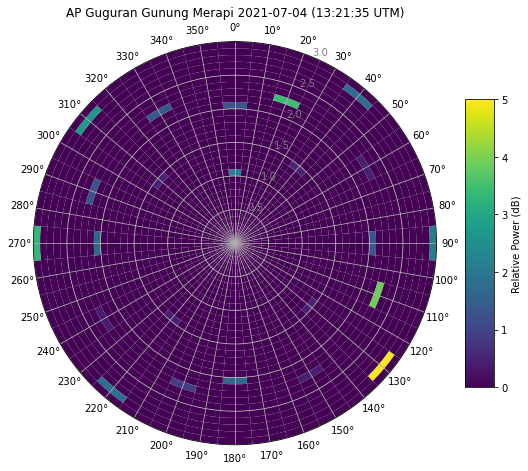

In [ ]:
# plotting array

cmap = obspy_sequential

#adjust BAZ into range 0 - 360 degree
t, rel_power, abs_power, baz, slow = out.T
baz[baz<0.0] += 360

df11 = pd.DataFrame({"Time":t, "Backazimuth":baz, "Slowness":slow, 
                    "Relative Power":rel_power
                    
                    })

N=36
N2=30
abins = np.arange(N+1) *360./N
sbins = np.linspace(0, 3, N2+1)

# sum relative power in bins
hist, baz_edges, sl_edges = \
    np.histogram2d(baz, slow, bins=[abins, sbins], weights=rel_power)

# get radians
baz_edges = np.radians(baz_edges)


# polar diagram
fig = plt.figure(figsize=(8,8))
cax = fig.add_axes([0.85, 0.2, 0.05, 0.5])
ax = fig.add_axes([0.10, 0.1, 0.70, 0.70], polar=True)
ax.set_theta_direction(-1)
ax.set_theta_zero_location('N')

dh = abs(sl_edges[1]-sl_edges[0])
dw = abs(baz_edges[1]-baz_edges[0])

for i, row in enumerate(hist):
    bars = ax.bar((i*dw) * np.ones(N2),
                   height=dh*np.ones(N2),
                   width=dw, bottom=dh*np.arange(N2),
                   color=cmap(row/hist.max()))
    
ax.set_xticks(np.linspace(0, 2*np.pi, 36, endpoint=False))
ax.set_title('AP Guguran Gunung Merapi %s' %(start.strftime('%Y-%m-%d (%H:%M:%S UTC)'),))

# slowness limit
ax.set_ylim(0,3)
[i.set_color('grey') for i in ax.get_yticklabels()]
ColorbarBase(cax, cmap=cmap, norm=Normalize(vmin=hist.min(), vmax=hist.max()), label='Relative Power (dB)')

plt.savefig('Polar Plot - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white')
plt.show()

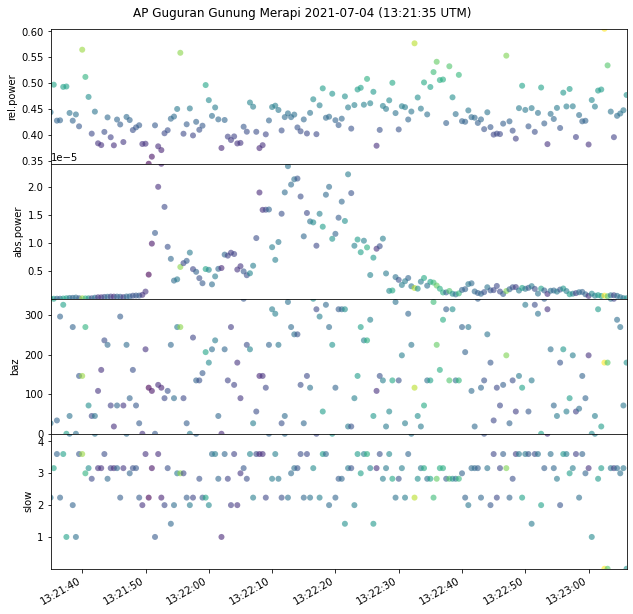

In [ ]:
# plot
labels = ['rel.power', 'abs.power', 'baz', 'slow']
xlocator = mdates.AutoDateLocator()
fig = plt.figure(figsize=(10,10))
for i, lab in enumerate(labels):
    ax = fig.add_subplot(4, 1, i + 1)
    ax.scatter(out[:, 0], out[:, i + 1], c=out[:, 1], alpha=0.6,
               edgecolors='none', cmap=obspy_sequential)
    ax.set_ylabel(lab)
    ax.set_xlim(out[0, 0], out[-1, 0])
    ax.set_ylim(out[:, i + 1].min(), out[:, i + 1].max())
    ax.xaxis.set_major_locator(xlocator)
    ax.xaxis.set_major_formatter(mdates.AutoDateFormatter(xlocator))

fig.suptitle('AP Guguran Gunung Merapi %s' % (start.strftime('%Y-%m-%d (%H:%M:%S UTC)'), ))
fig.autofmt_xdate()
fig.subplots_adjust(left=0.15, top=0.95, right=0.95, bottom=0.2, hspace=0)

plt.savefig('Plot - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white')
plt.show()

## 6 | (2021-07-04 | 15:21:00) | SE

In [117]:
chID = 'ENZ'
direction = 'SE'
path = 'data/'+direction

st=read(path+"/VG.*"+".D.20*"+".MSEED", type='MSEED')

st = st.sort()

In [118]:
time_s = time5
time_e = time_s + time05

st0 = st.copy()
st0 = st0.trim(starttime=time_s, endtime=time_e)


### MEPAS

In [119]:
station = 'mepas'
mepas = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

mepas = mepas.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
mepas

3 Trace(s) in Stream:
VG.MEPAS.00.HHE | 2021-07-04T15:19:05.000000Z - 2021-07-04T15:20:19.000000Z | 100.0 Hz, 7401 samples
VG.MEPAS.00.HHN | 2021-07-04T15:19:05.000000Z - 2021-07-04T15:20:19.000000Z | 100.0 Hz, 7401 samples
VG.MEPAS.00.HHZ | 2021-07-04T15:19:05.000000Z - 2021-07-04T15:20:19.000000Z | 100.0 Hz, 7401 samples

In [120]:
for i in range(len(mepas)):
    mepas[i].stats.coordinates = AttribDict({'latitude':-7.535567,
                                             'longitude':110.449185,
                                             'elevation':2679})

### MELAB

In [121]:
station = 'melab'
melab = st0.select(station=station)
inv = 'inv/'+ station + '.xml'
inv = read_inventory(inv)

melab = melab.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
melab

3 Trace(s) in Stream:
VG.MELAB.00.HHE | 2021-07-04T15:19:05.000000Z - 2021-07-04T15:20:19.000000Z | 100.0 Hz, 7401 samples
VG.MELAB.00.HHN | 2021-07-04T15:19:05.000000Z - 2021-07-04T15:20:19.000000Z | 100.0 Hz, 7401 samples
VG.MELAB.00.HHZ | 2021-07-04T15:19:05.000000Z - 2021-07-04T15:20:19.000000Z | 100.0 Hz, 7401 samples

In [122]:
for i in range(len(melab)):
    melab[i].stats.coordinates = AttribDict({'latitude':-7.557044,
                                         'longitude':110.445038,
                                         'elevation':1730})

### MEJRO

In [123]:
station = 'mejro'
mejro = st0.select(station=station)
inv = 'inv/' + station + '.xml'
inv = read_inventory(inv)

mejro = mejro.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
mejro

3 Trace(s) in Stream:
VG.MEJRO.00.HHE | 2021-07-04T15:19:05.000000Z - 2021-07-04T15:20:19.000000Z | 100.0 Hz, 7401 samples
VG.MEJRO.00.HHN | 2021-07-04T15:19:05.000000Z - 2021-07-04T15:20:19.000000Z | 100.0 Hz, 7401 samples
VG.MEJRO.00.HHZ | 2021-07-04T15:19:05.000000Z - 2021-07-04T15:20:19.000000Z | 100.0 Hz, 7401 samples

In [124]:
for i in range(len(mejro)):
    mejro[i].stats.coordinates = AttribDict({'latitude':-7.555357,
                                         'longitude':110.419287,
                                         'elevation':1335})

### MEGRA

In [125]:
station = 'megra'
megra = st0.select(station=station)
inv = 'inv/'+ station + '.xml'
inv = read_inventory(inv)

megra = megra.remove_response(inventory=inv, 
                                  output='VEL',
                                  plot=False)
megra

3 Trace(s) in Stream:
VG.MEGRA.00.HHE | 2021-07-04T15:19:05.000000Z - 2021-07-04T15:20:19.000000Z | 100.0 Hz, 7401 samples
VG.MEGRA.00.HHN | 2021-07-04T15:19:05.000000Z - 2021-07-04T15:20:19.000000Z | 100.0 Hz, 7401 samples
VG.MEGRA.00.HHZ | 2021-07-04T15:19:05.000000Z - 2021-07-04T15:20:19.000000Z | 100.0 Hz, 7401 samples

In [126]:
for i in range(len(megra)):
    megra[i].stats.coordinates = AttribDict({'latitude':-7.52163,
                                         'longitude':110.45149,
                                         'elevation':2045})

### Signal Analysis

#### Spectrogram Before Filter

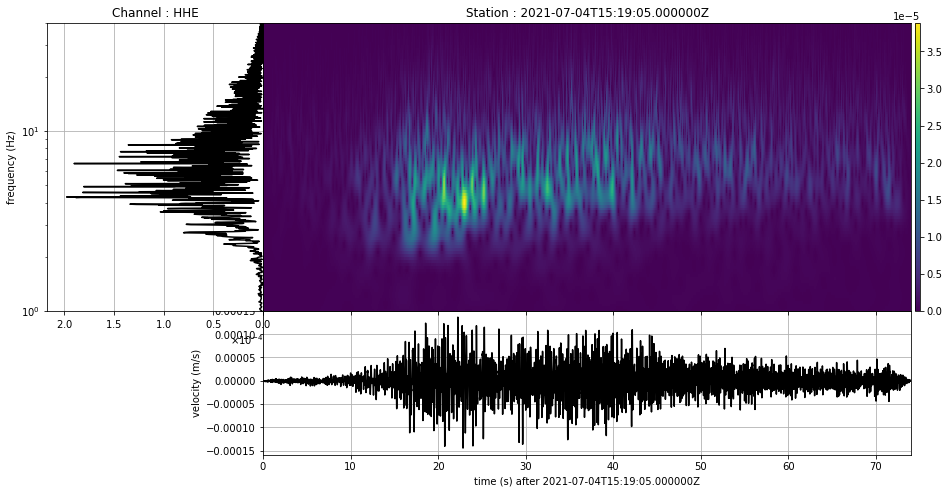

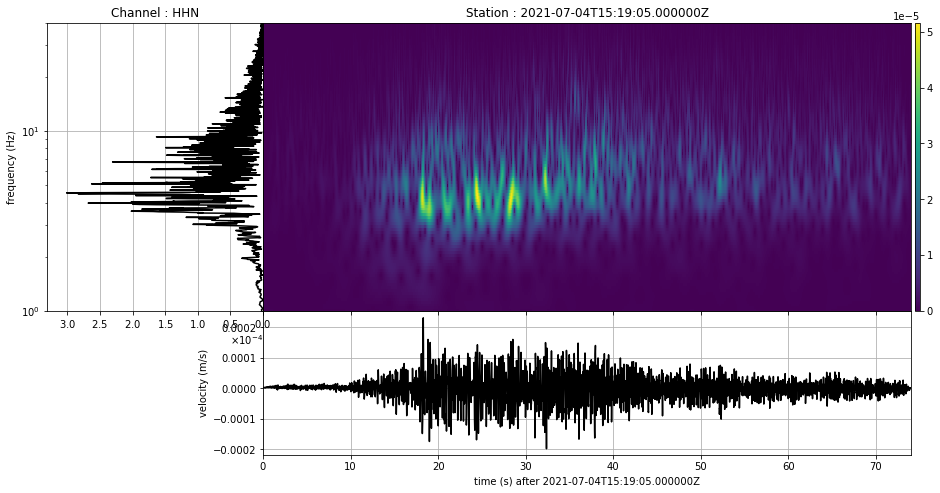

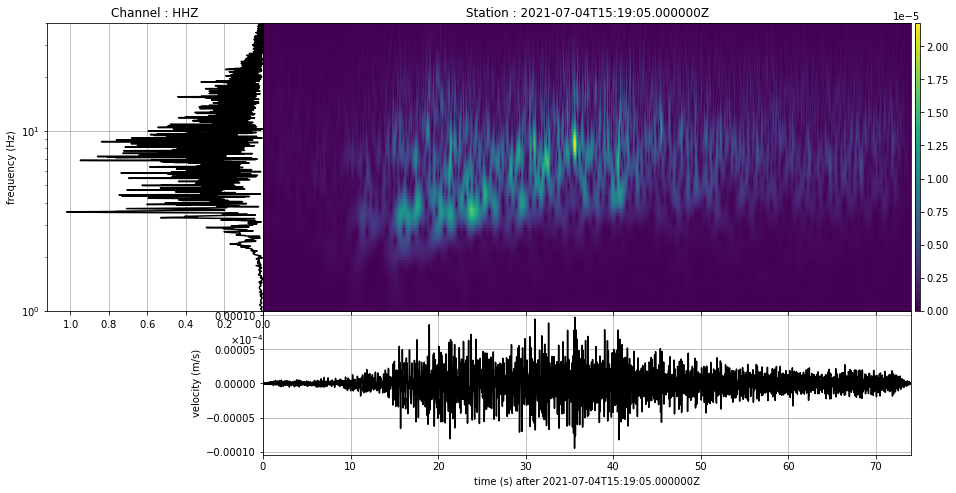

In [ ]:
# MEPAS
for i in range(len(mepas)):
    mc.plot_tfr(
    mepas[i].data, 
    tr=mepas[i],
    fmin=1.0,
    fmax=40.0,
    dt=mepas[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

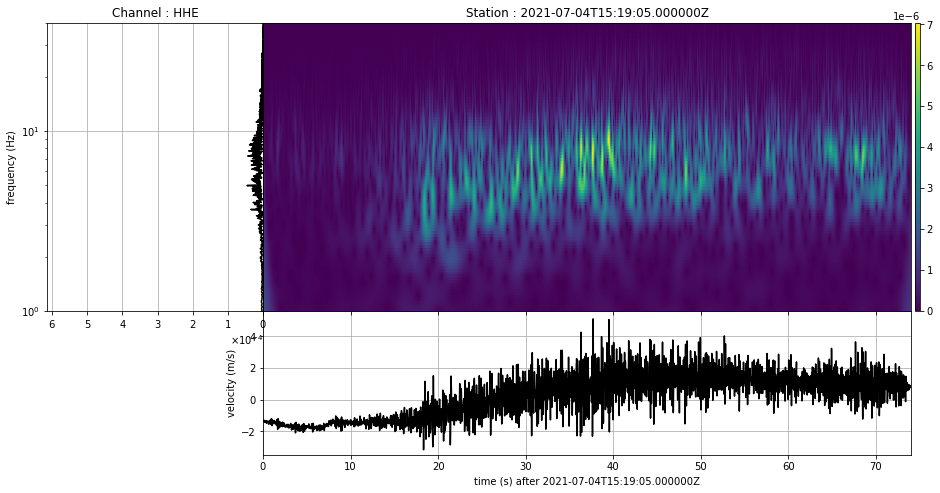

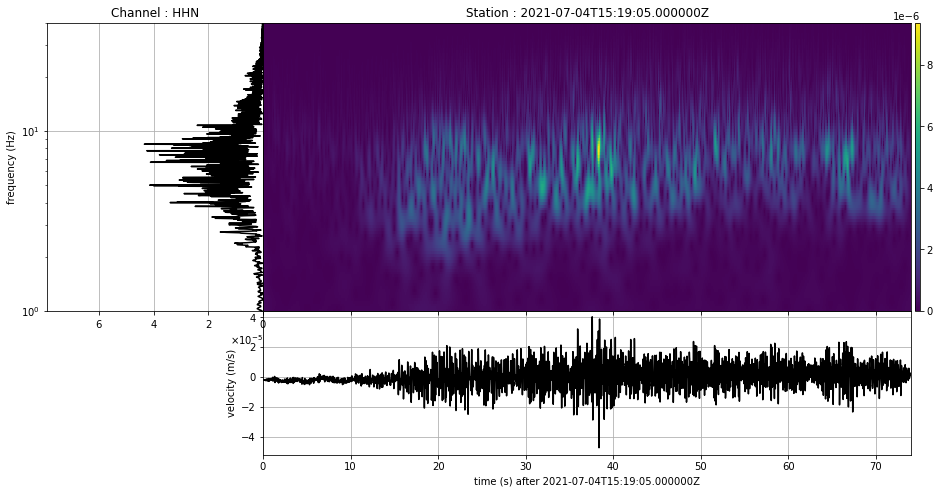

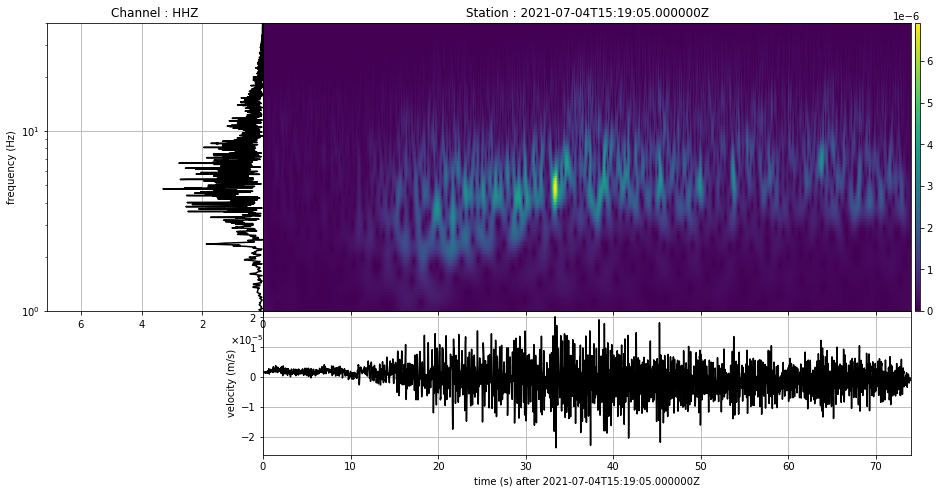

In [ ]:
# MELAB
for i in range(len(melab)):
    mc.plot_tfr(
    melab[i].data, 
    tr=melab[i],
    fmin=1.0,
    fmax=40.0,
    dt=melab[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

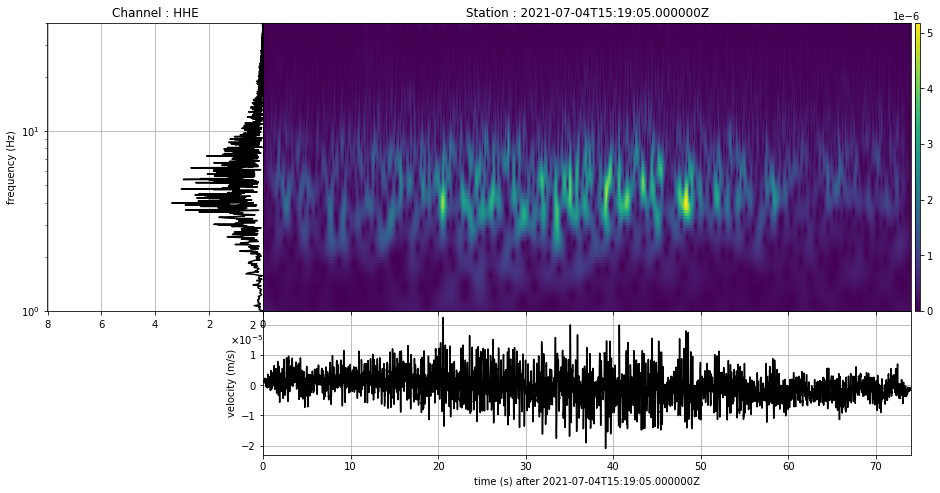

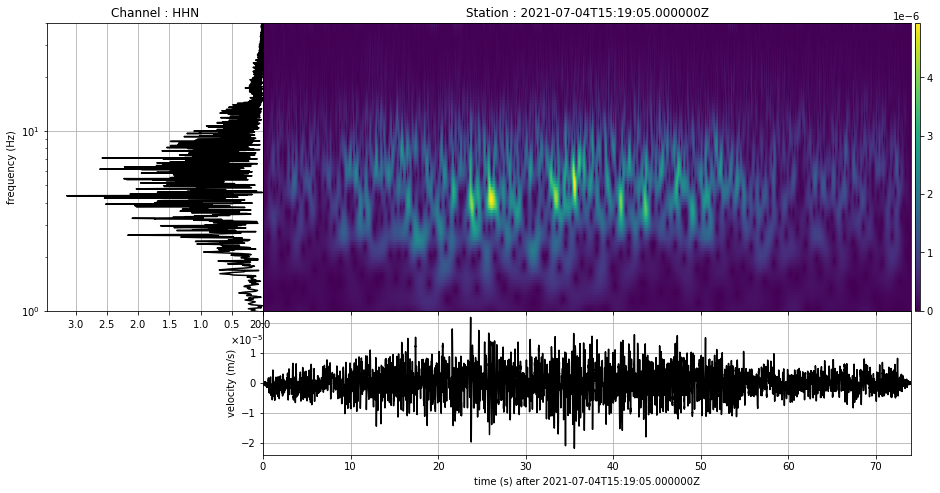

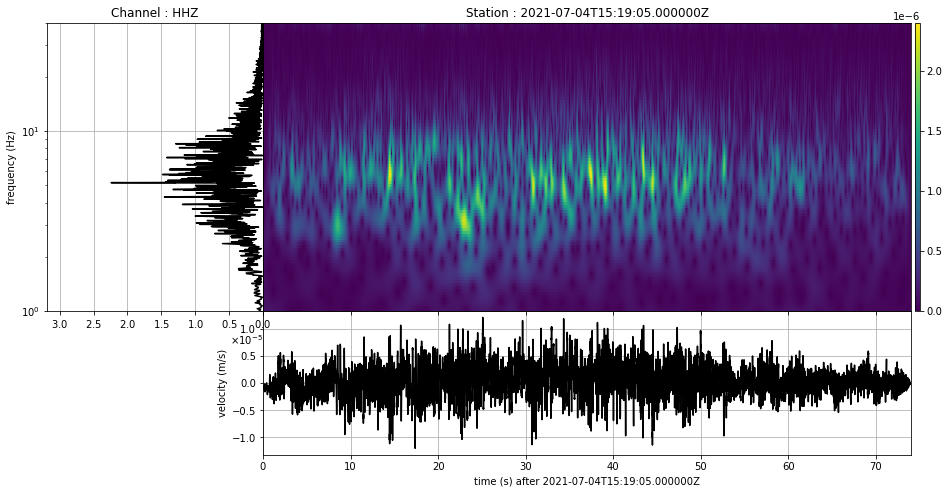

In [ ]:
# MEJRO
for i in range(len(mejro)):
    mc.plot_tfr(
    mejro[i].data, 
    tr=mejro[i],
    fmin=1.0,
    fmax=40.0,
    dt=mejro[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

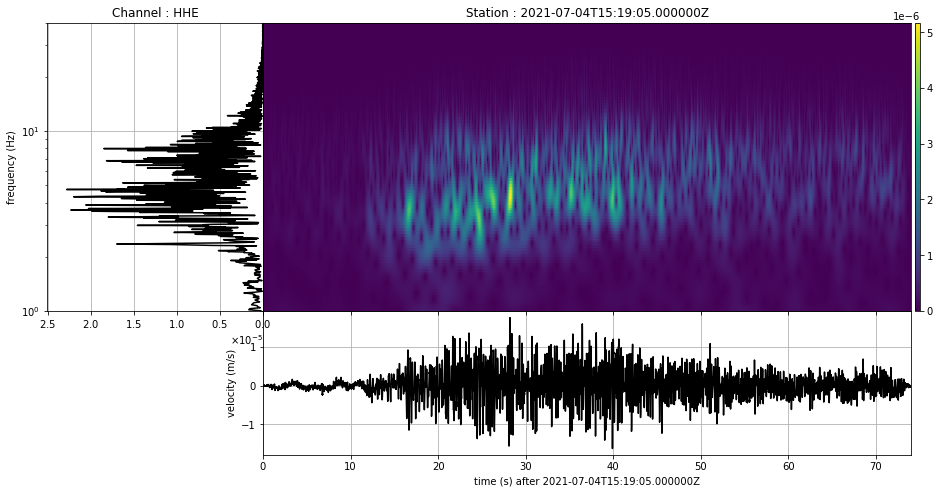

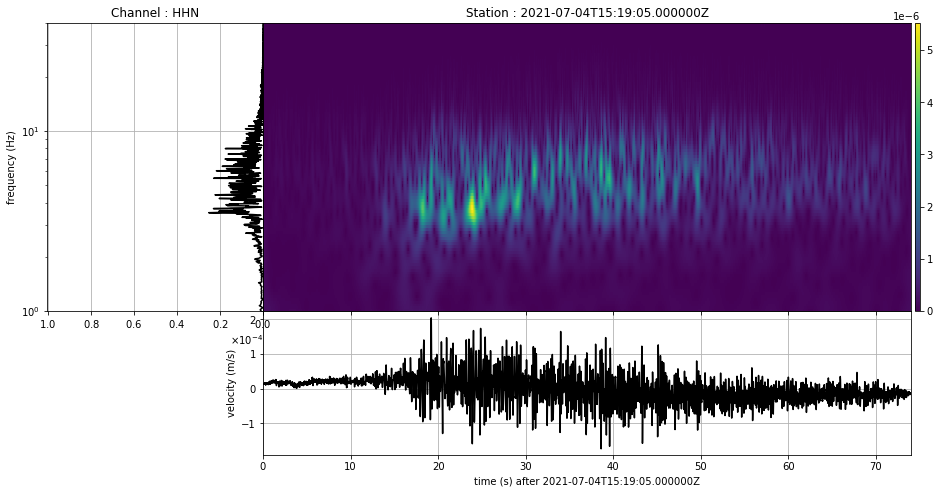

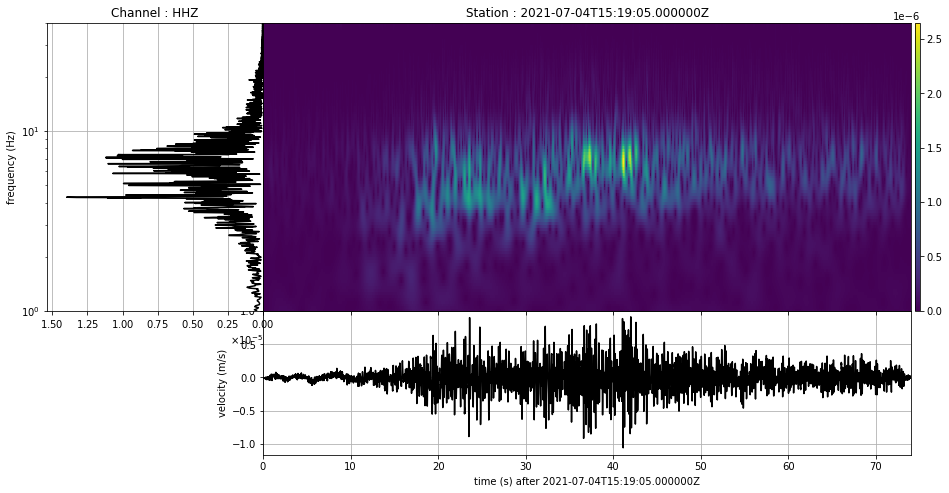

In [ ]:
# MEGRA
for i in range(len(megra)):
    mc.plot_tfr(
    megra[i].data, 
    tr=megra[i],
    fmin=1.0,
    fmax=40.0,
    dt=megra[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

#### Data Filter

In [127]:
mepas = mepas.filter('bandpass', freqmin = 1.0, freqmax=12.0)
melab = melab.filter('bandpass', freqmin = 1.0, freqmax=12.0)
mejro = mejro.filter('bandpass', freqmin = 1.0, freqmax=12.0)
megra = megra.filter('bandpass', freqmin = 1.0, freqmax=12.0)

#### Spectrogram After Filter

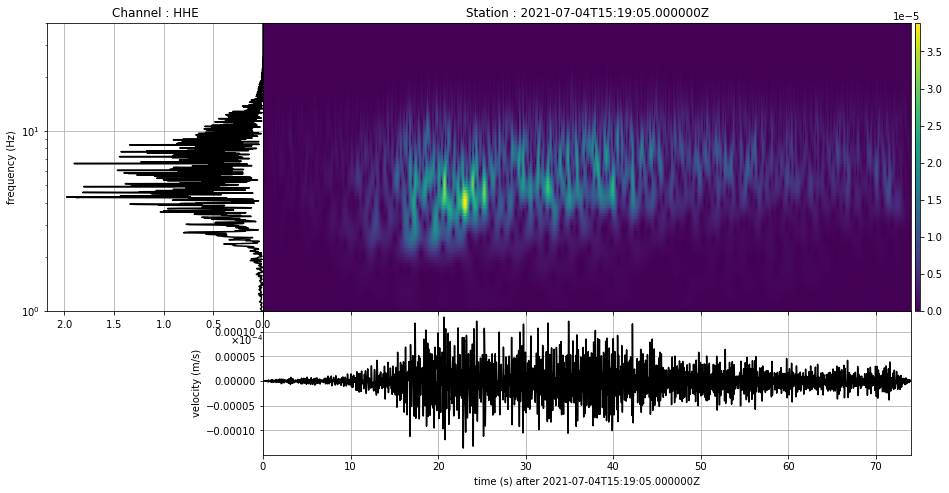

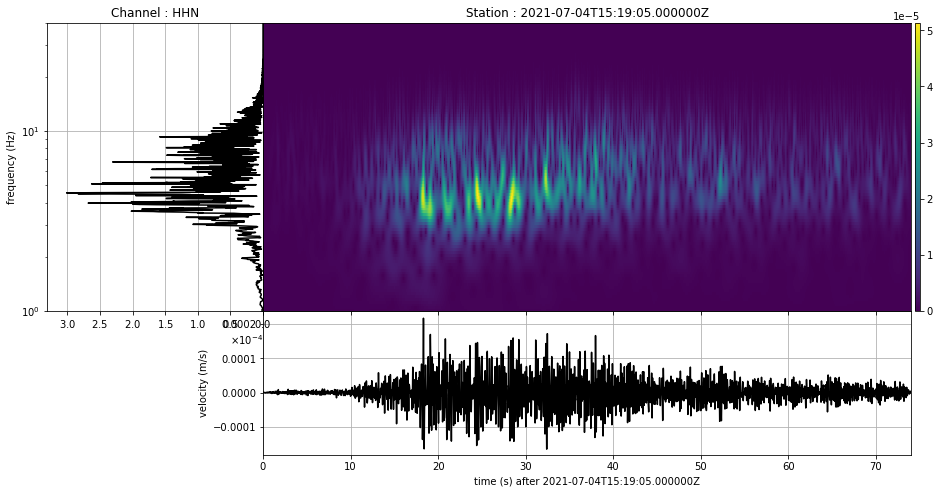

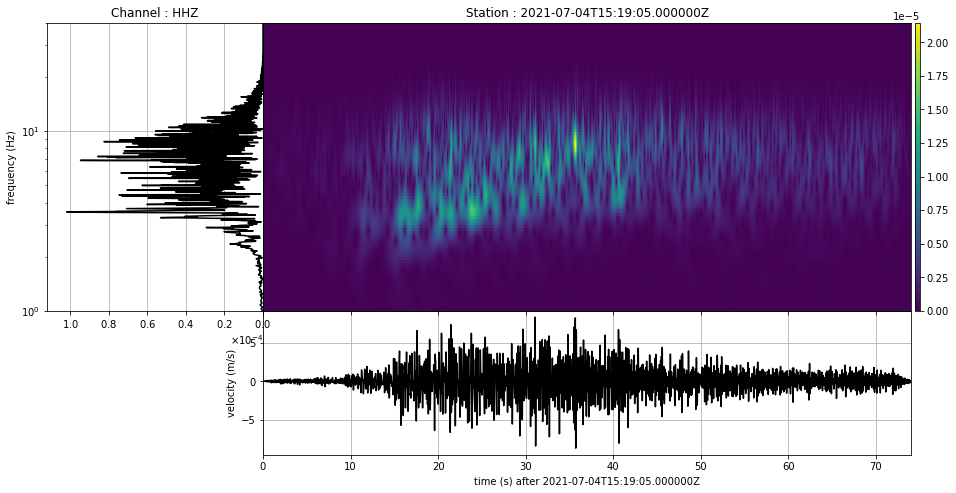

In [ ]:
# MEPAS
for i in range(len(mepas)):
    mc.plot_tfr(
    mepas[i].data, 
    tr=mepas[i],
    fmin=1.0,
    fmax=40.0,
    dt=mepas[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

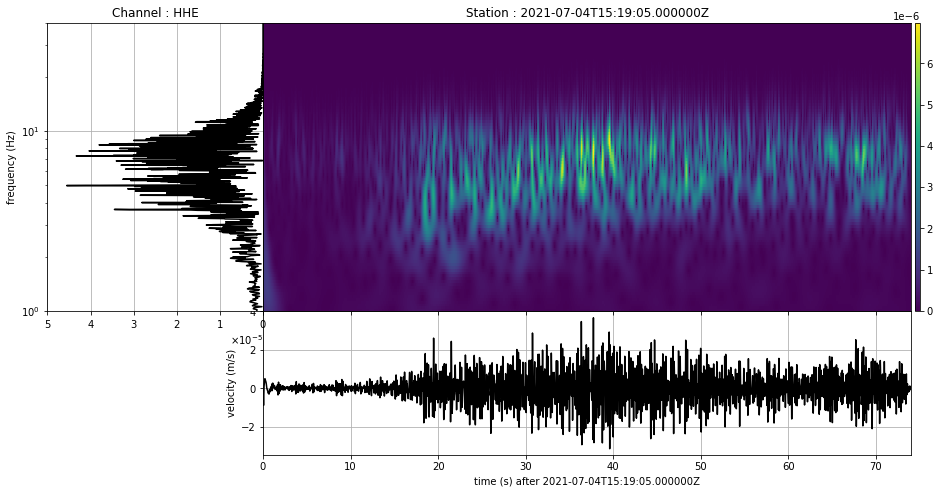

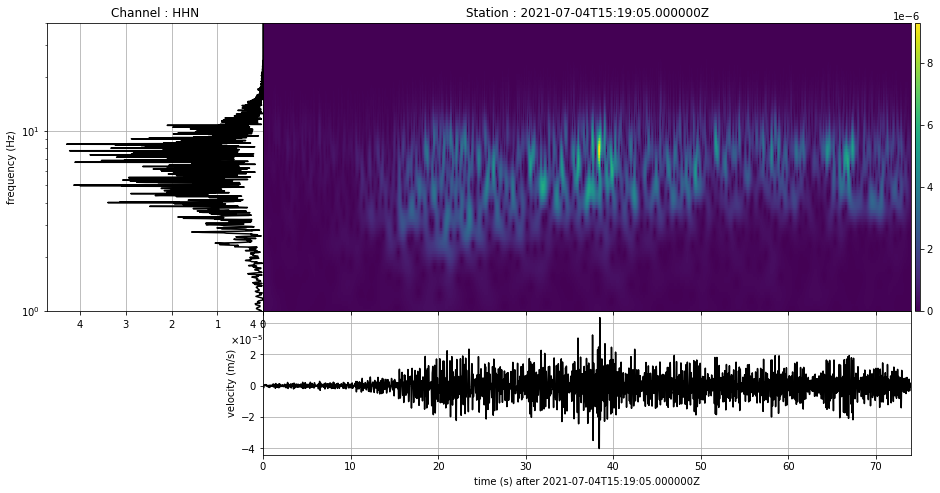

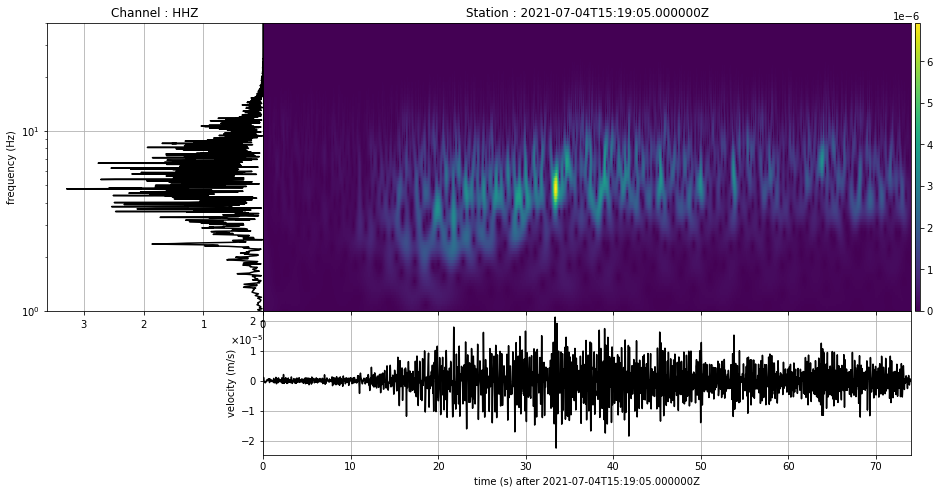

In [ ]:
# MELAB
for i in range(len(melab)):
    mc.plot_tfr(
    melab[i].data, 
    tr=melab[i],
    fmin=1.0,
    fmax=40.0,
    dt=melab[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

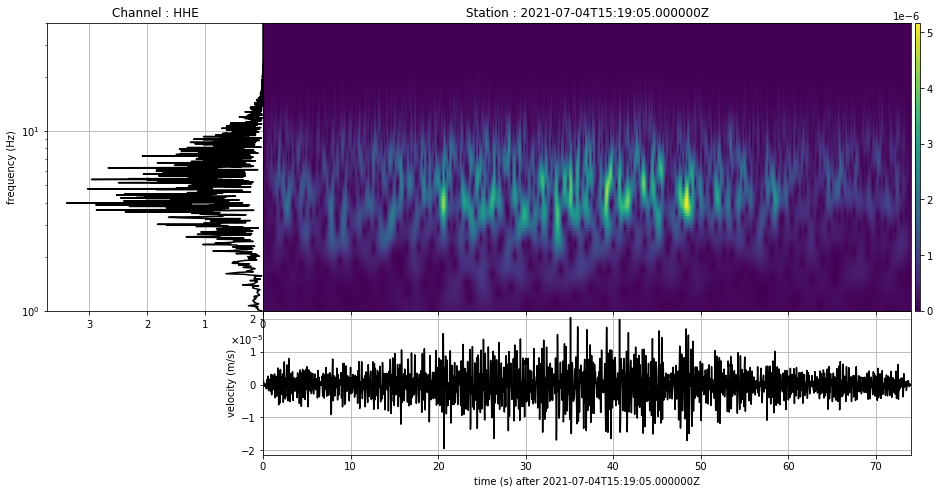

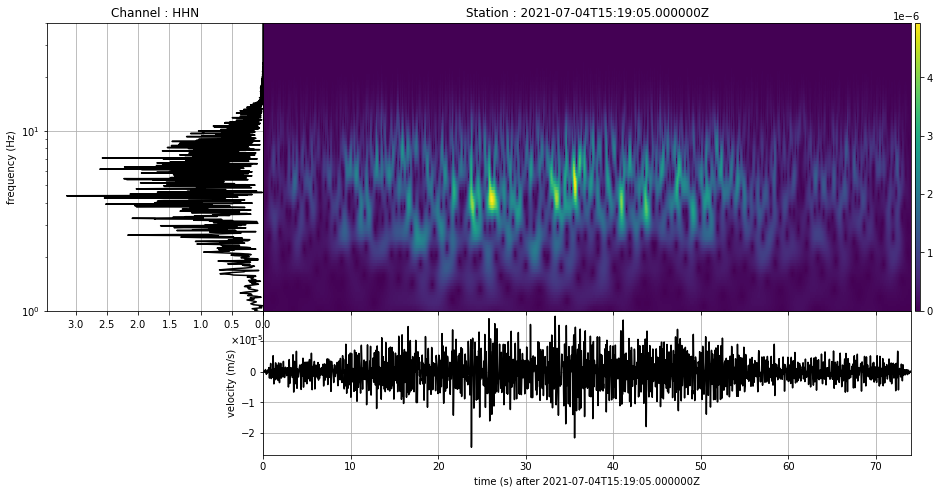

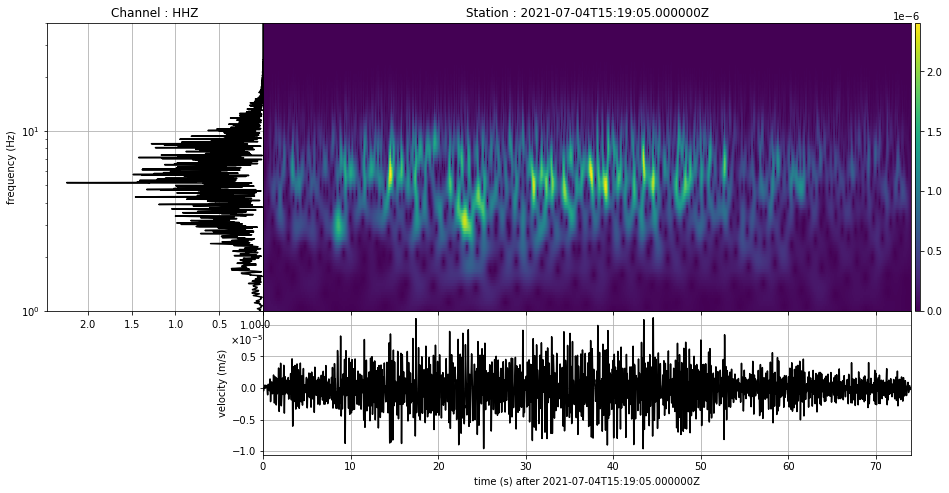

In [ ]:
# MEJRO
for i in range(len(mejro)):
    mc.plot_tfr(
    mejro[i].data, 
    tr=mejro[i],
    fmin=1.0,
    fmax=40.0,
    dt=mejro[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

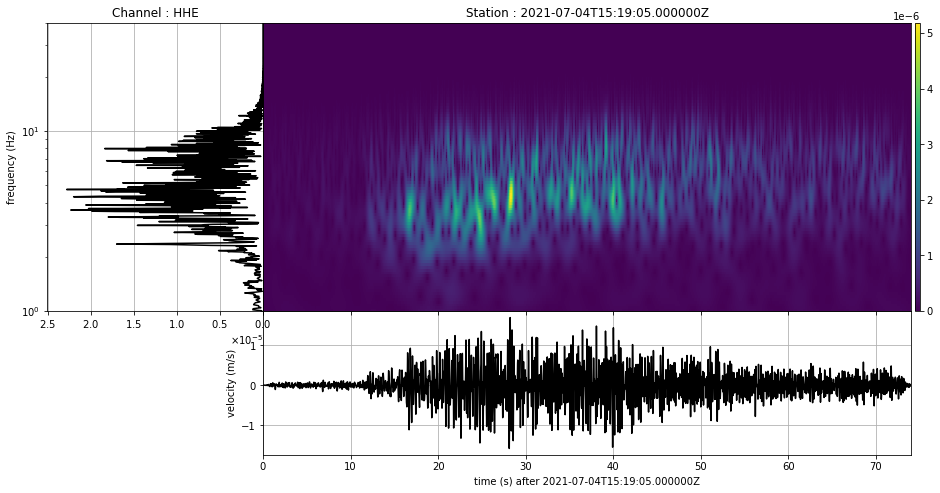

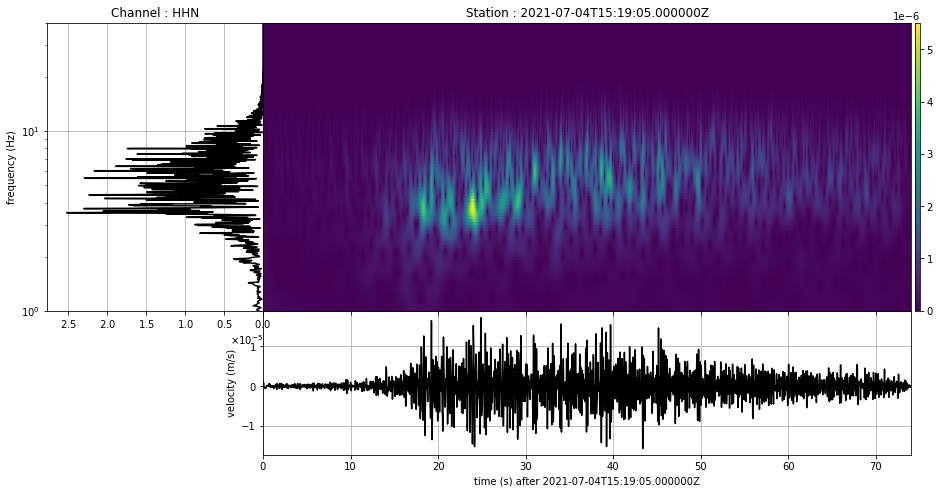

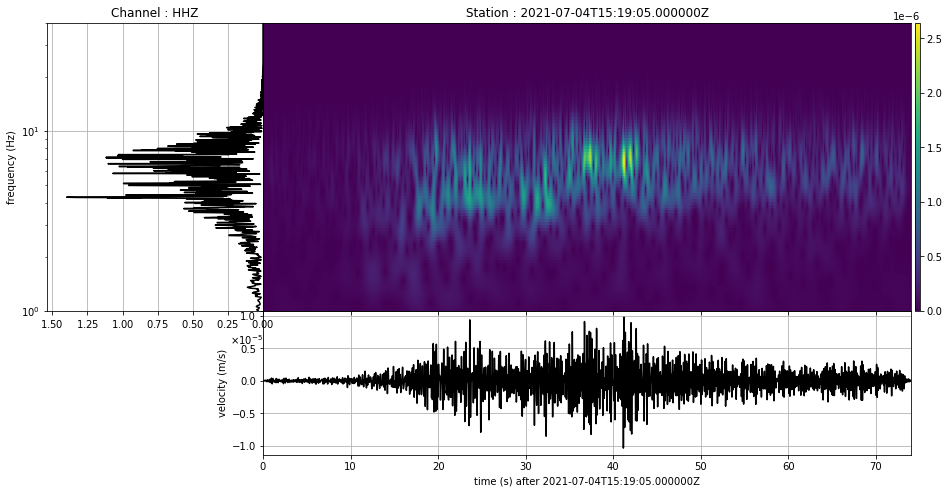

In [ ]:
# MEGRA
for i in range(len(megra)):
    mc.plot_tfr(
    megra[i].data, 
    tr=megra[i],
    fmin=1.0,
    fmax=40.0,
    dt=megra[i].stats.delta,
    w0=6, left=0.1,
    bottom=0.1,
    h_1=0.5, h_2=1.0, 
    w_1=0.5, w_2=1.5, 
    w_cb=0.01, d_cb=0.0
    )

### Particle Motion

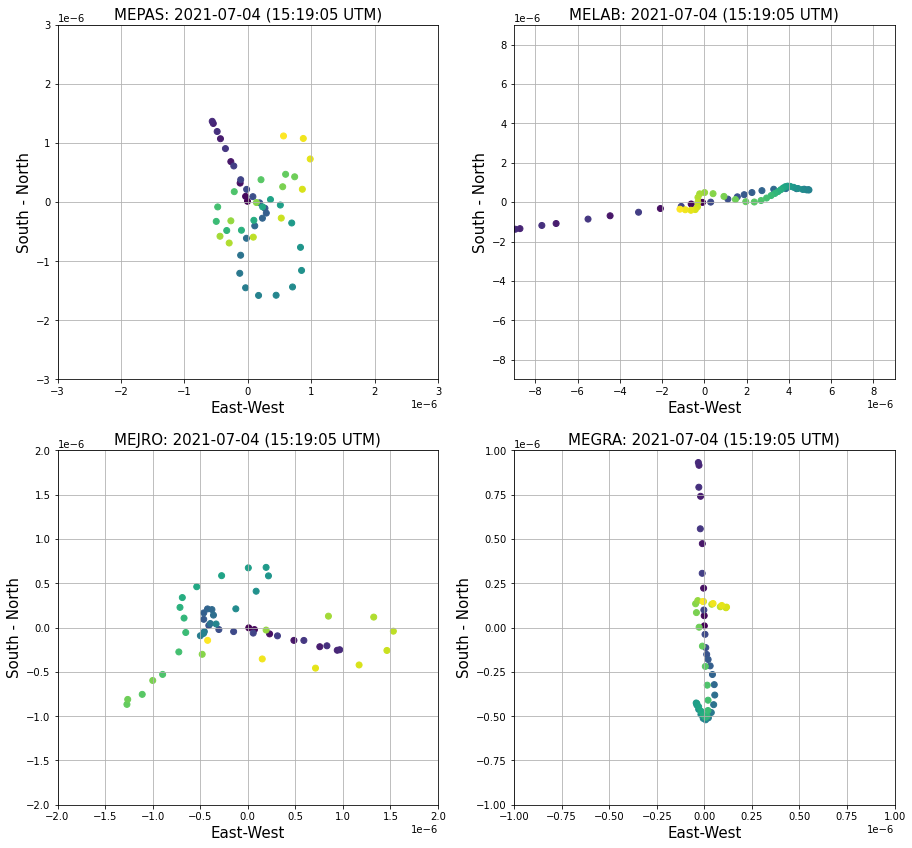

In [128]:
mepas_pm = mepas.copy()
melab_pm = melab.copy()
mejro_pm = mejro.copy()
megra_pm = megra.copy()

st_pm = mepas_pm+melab_pm+mejro_pm+megra_pm

start = st_pm[0].stats.starttime
end_pm = start + 0.5
st_pm = st_pm.trim(starttime=start, endtime=end_pm)

for tr in st_pm.select(channel='HHZ'):
  st_pm.remove(tr)

mepas_pm = st_pm.select(station = 'mepas')
mepas_ctime = np.array(mepas_pm[0].times())
melab_pm = st_pm.select(station = 'melab')
melab_ctime = np.array(melab_pm[0].times())
mejro_pm = st_pm.select(station = 'mejro')
mejro_ctime = np.array(mejro_pm[0].times())
megra_pm = st_pm.select(station = 'megra')
megra_ctime = np.array(megra_pm[0].times())

lim = 0.000003

fig = plt.figure(figsize=(15, 30))
ax=fig.add_subplot(421)
ax.set_title('MEPAS: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax.set_xlabel('East-West', fontsize = 15)
ax.set_ylabel('South - North', fontsize = 15)
ax.set_xlim(-lim, lim)
ax.set_ylim(-lim, lim)
ax.scatter(mepas_pm[0].data, mepas_pm[1].data, marker='o', c=mepas_ctime)

ax1=fig.add_subplot(422)
ax1.set_title('MELAB: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax1.set_xlabel('East-West', fontsize = 15)
ax1.set_ylabel('South - North', fontsize = 15)
ax1.set_xlim(-0.000009, 0.000009)
ax1.set_ylim(-0.000009, 0.000009)
ax1.scatter(melab_pm[0].data, melab_pm[1].data, marker='o', c=melab_ctime)

ax2=fig.add_subplot(423)
ax2.set_title('MEJRO: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax2.set_xlabel('East-West', fontsize = 15)
ax2.set_ylabel('South - North', fontsize = 15)
ax2.set_xlim(-0.000002, 0.000002)
ax2.set_ylim(-0.000002, 0.000002)
ax2.scatter(mejro_pm[0].data, mejro_pm[1].data, marker='o', c=mejro_ctime)

ax3=fig.add_subplot(424)
ax3.set_title('MEGRA: %s'%(start.strftime('%Y-%m-%d (%H:%M:%S UTC)')), fontsize=15)
ax3.set_xlabel('East-West', fontsize = 15)
ax3.set_ylabel('South - North', fontsize = 15)
ax3.set_xlim(-0.000001, 0.000001)
ax3.set_ylim(-0.000001, 0.000001)
ax3.scatter(megra_pm[0].data, megra_pm[1].data, marker='o', c=megra_ctime)

ax.grid()
ax1.grid()
ax2.grid()
ax3.grid()

plt.savefig('Particle Motion - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white', transparent=True)
ax = plt.gca


### Beamforming 

In [ ]:
mepas_fk = mepas.copy()
melab_fk = melab.copy()
mejro_fk = mejro.copy()
megra_fk = megra.copy()


st_ = mepas_fk+melab_fk+megra_fk
st_fk = st_.copy()
st_fk = st_fk.select(channel='HHZ')

In [ ]:
fmin = 1.0
fmax = 12.0
slw = 3.0
sl_s = 1.0
win_len = 1.0
win_frac = 0.5

start = []
for i in range(len(st_fk)):
    start.append(st_fk[i].stats.starttime)
end = []
for i in range(len(st_fk)):
    end.append(st_fk[i].stats.endtime)

t0 = max(start)
t1 = min(end)

st_fk = st_fk.trim(t0, t1)

start = st_fk[0].stats.starttime
end = st_fk[0].stats.endtime

kwargs = dict(
    # slowness grid (x,y) and slow step
    sll_x=-slw, slm_x=slw, sll_y=-slw, slm_y=slw, sl_s=sl_s,
    #sliding window
    win_len=win_len, win_frac=win_frac,
    # frequency for bandpass
    frqlow=fmin, frqhigh=fmax, prewhiten=0,
    # semblance
    semb_thres=-1e9, vel_thres=-1e9,
    stime=start, etime=end, method=0)

out = array_processing(stream=st_fk, **kwargs)


# return = timestamp, realtive relpow, abs relpow, baz, slowness

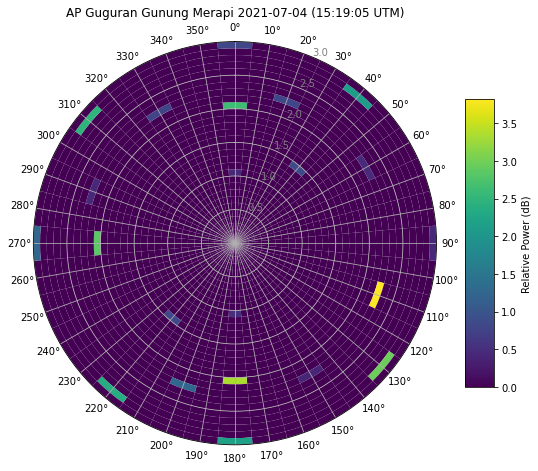

In [ ]:
# plotting array

cmap = obspy_sequential

#adjust BAZ into range 0 - 360 degree
t, rel_power, abs_power, baz, slow = out.T
baz[baz<0.0] += 360

df12 = pd.DataFrame({"Time":t, "Backazimuth":baz, "Slowness":slow, 
                    "Relative Power":rel_power
                    
                    })

N=36
N2=30
abins = np.arange(N+1) *360./N
sbins = np.linspace(0, 3, N2+1)

# sum relative power in bins
hist, baz_edges, sl_edges = \
    np.histogram2d(baz, slow, bins=[abins, sbins], weights=rel_power)

# get radians
baz_edges = np.radians(baz_edges)


# polar diagram
fig = plt.figure(figsize=(8,8))
cax = fig.add_axes([0.85, 0.2, 0.05, 0.5])
ax = fig.add_axes([0.10, 0.1, 0.70, 0.70], polar=True)
ax.set_theta_direction(-1)
ax.set_theta_zero_location('N')

dh = abs(sl_edges[1]-sl_edges[0])
dw = abs(baz_edges[1]-baz_edges[0])

for i, row in enumerate(hist):
    bars = ax.bar((i*dw) * np.ones(N2),
                   height=dh*np.ones(N2),
                   width=dw, bottom=dh*np.arange(N2),
                   color=cmap(row/hist.max()))
    
ax.set_xticks(np.linspace(0, 2*np.pi, 36, endpoint=False))
ax.set_title('AP Guguran Gunung Merapi %s' %(start.strftime('%Y-%m-%d (%H:%M:%S UTC)'),))

# slowness limit
ax.set_ylim(0,3)
[i.set_color('grey') for i in ax.get_yticklabels()]
ColorbarBase(cax, cmap=cmap, norm=Normalize(vmin=hist.min(), vmax=hist.max()), label='Relative Power (dB)')

plt.savefig('Polar Plot - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white')
plt.show()

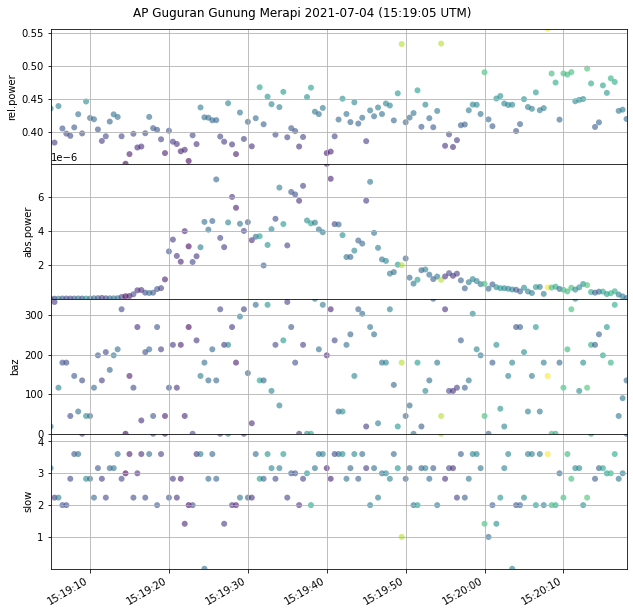

In [ ]:
# plot
labels = ['rel.power', 'abs.power', 'baz', 'slow']
xlocator = mdates.AutoDateLocator()
fig = plt.figure(figsize=(10,10))
for i, lab in enumerate(labels):
    ax = fig.add_subplot(4, 1, i + 1)
    ax.scatter(out[:, 0], out[:, i + 1], c=out[:, 1], alpha=0.6,
               edgecolors='none', cmap=obspy_sequential)
    ax.set_ylabel(lab)
    ax.set_xlim(out[0, 0], out[-1, 0])
    ax.set_ylim(out[:, i + 1].min(), out[:, i + 1].max())
    ax.xaxis.set_major_locator(xlocator)
    ax.xaxis.set_major_formatter(mdates.AutoDateFormatter(xlocator))
    ax.grid()
    
fig.suptitle('AP Guguran Gunung Merapi %s' % (start.strftime('%Y-%m-%d (%H:%M:%S UTC)'), ))
fig.autofmt_xdate()
fig.subplots_adjust(left=0.15, top=0.95, right=0.95, bottom=0.2, hspace=0)

plt.savefig('Plot - %s'%(start.strftime('%Y-%m-%d-%H-%M-%S.png')), facecolor='white')
plt.show()

# Turn DF into excel

In [ ]:
with pd.ExcelWriter("data_baz.xlsx") as writer:
    df1.to_excel(writer, sheet_name="Sheet1", index=False)
    df2.to_excel(writer, sheet_name="Sheet2", index=False)
    df3.to_excel(writer, sheet_name="Sheet3", index=False)
    df4.to_excel(writer, sheet_name="Sheet4", index=False)
    df5.to_excel(writer, sheet_name="Sheet5", index=False)
    df6.to_excel(writer, sheet_name="Sheet6", index=False)
    df7.to_excel(writer, sheet_name="Sheet7", index=False)
    df8.to_excel(writer, sheet_name="Sheet8", index=False)
    df9.to_excel(writer, sheet_name="Sheet9", index=False)
    df10.to_excel(writer, sheet_name="Sheet10", index=False)
    df11.to_excel(writer, sheet_name="Sheet11", index=False)
    df12.to_excel(writer, sheet_name="Sheet12", index=False)